## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-11 10:57:19.357019: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-11 10:57:19.357079: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-11 10:57:19.389021: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-11 10:57:19.456111: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-11 10:57:20.520451: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,1,2,1,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.33

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-1-2-1-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 73 scenes, the remaining 36 to test the model.

Training step. (73 scenes)
DataFrame n.1. Scene n.1/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [239.44,240.24]


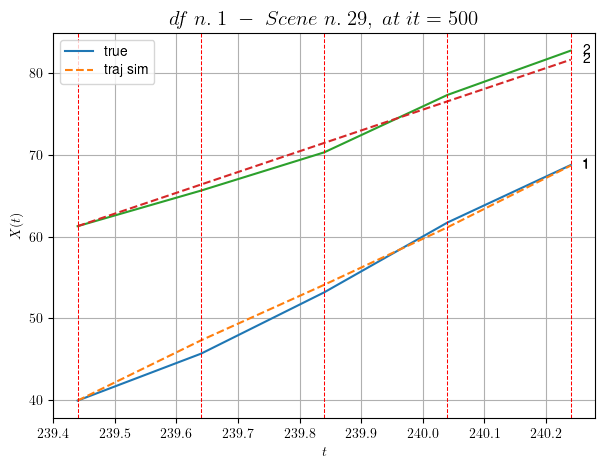

----------------------------------------------------------------------------------------------------
        For scene 1/73:
        * After LR finder: LR_NN=0.005 with mse=2.621509139447205 at it=24
        * v0 = 25.426381424530852
        * MSE = 0.7350081796796892
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [310.84,311.24]


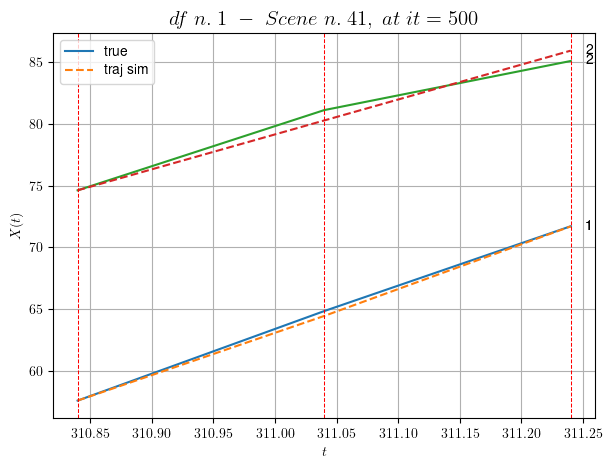

----------------------------------------------------------------------------------------------------
        For scene 2/73:
        * After LR finder: LR_NN=0.01 with mse=0.5092462925888213 at it=24
        * v0 = 28.339874463060763
        * MSE = 0.26170800562446866
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [52.84,53.84]


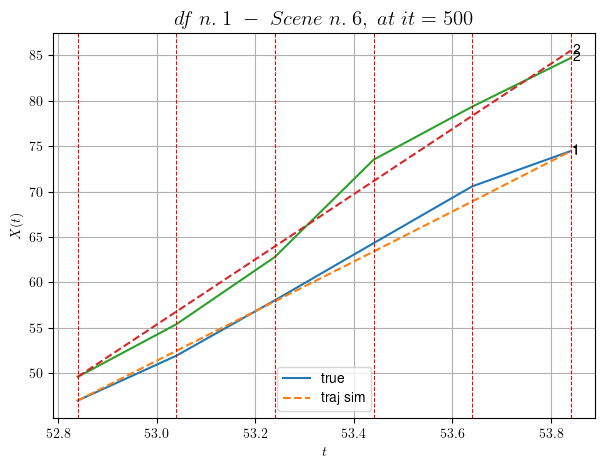

----------------------------------------------------------------------------------------------------
        For scene 3/73:
        * After LR finder: LR_NN=0.001 with mse=8.75044289748553 at it=24
        * v0 = 35.9128223540259
        * MSE = 1.1946435049831954
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [362.84,364.04]


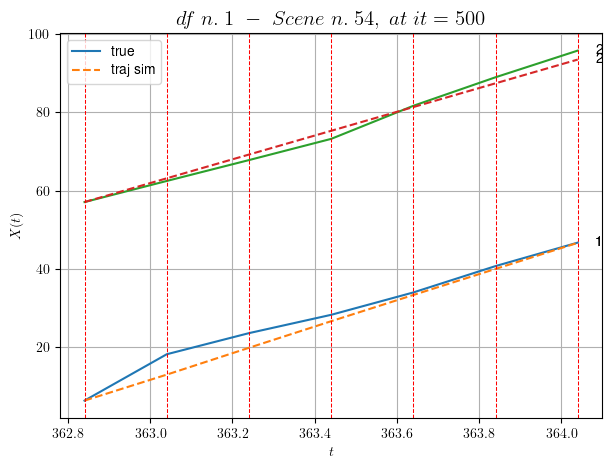

----------------------------------------------------------------------------------------------------
        For scene 4/73:
        * After LR finder: LR_NN=0.001 with mse=4.2730129057169375 at it=24
        * v0 = 30.31397642834164
        * MSE = 4.169370751130019
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [444.24,445.24]


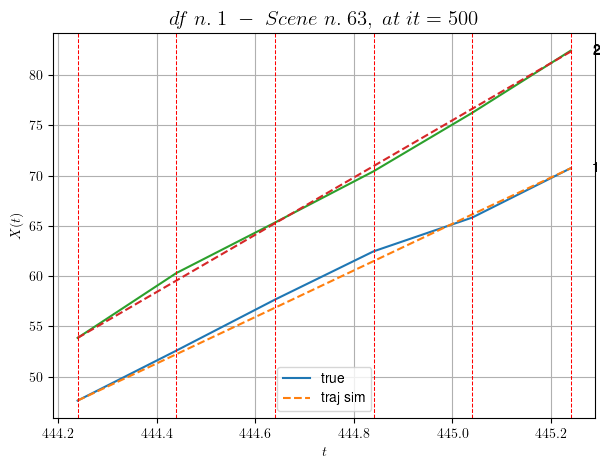

----------------------------------------------------------------------------------------------------
        For scene 5/73:
        * After LR finder: LR_NN=0.001 with mse=0.7702900195972023 at it=24
        * v0 = 28.494973095574913
        * MSE = 0.23532022927261326
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [307.24,307.64]


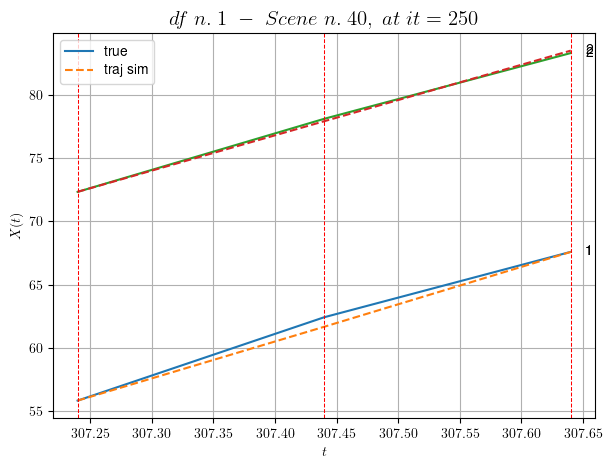

----------------------------------------------------------------------------------------------------
        For scene 6/73:
        * After LR finder: LR_NN=0.001 with mse=3.3163734793538944 at it=24
        * v0 = 27.873170103809976
        * MSE = 0.10538721874791783
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [294.64,295.24]


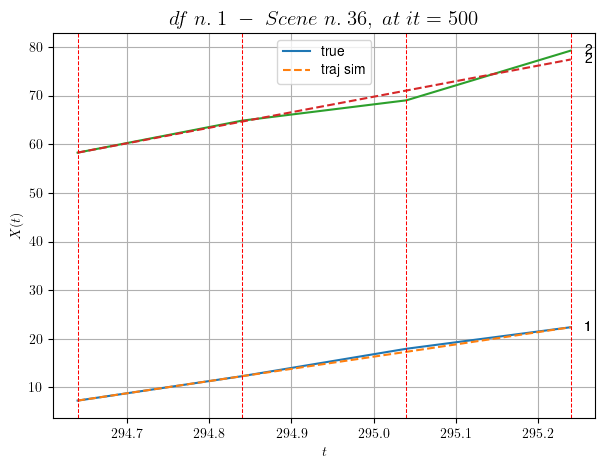

----------------------------------------------------------------------------------------------------
        For scene 7/73:
        * After LR finder: LR_NN=0.001 with mse=1.4183838142208054 at it=24
        * v0 = 31.91259141918894
        * MSE = 0.9734392524566751
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [130.64,131.44]


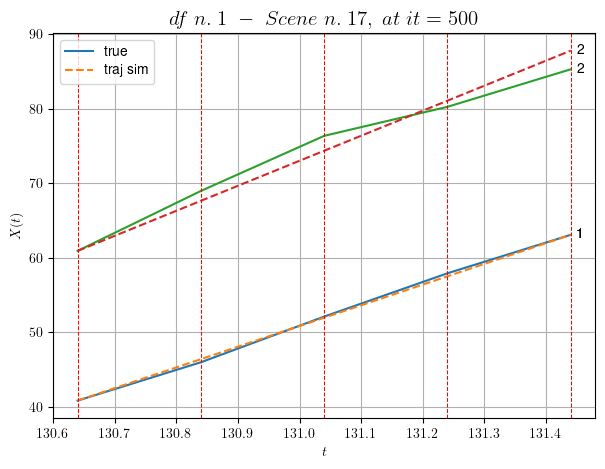

----------------------------------------------------------------------------------------------------
        For scene 8/73:
        * After LR finder: LR_NN=5e-05 with mse=1.8816777398349696 at it=24
        * v0 = 33.61924590429406
        * MSE = 1.3096831761261598
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [496.84,497.64]


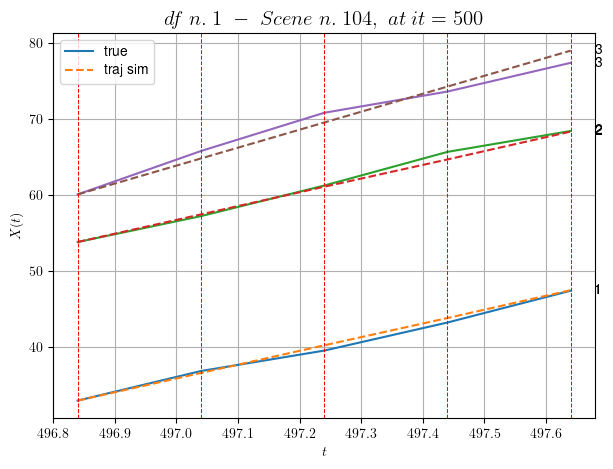

----------------------------------------------------------------------------------------------------
        For scene 9/73:
        * After LR finder: LR_NN=0.005 with mse=4.553450901219246 at it=24
        * v0 = 23.671022130115634
        * MSE = 0.5058864045444215
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [291.64,292.64]


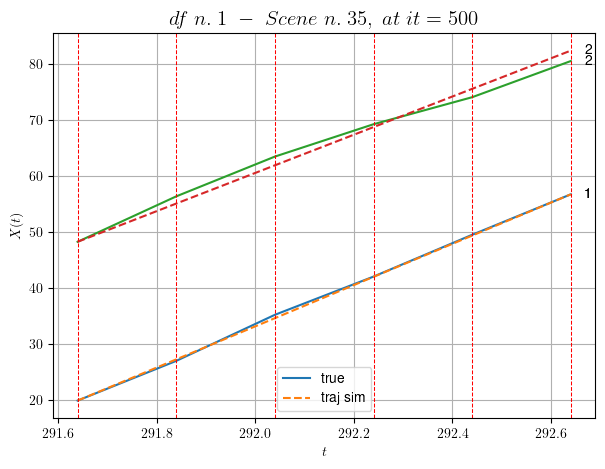

----------------------------------------------------------------------------------------------------
        For scene 10/73:
        * After LR finder: LR_NN=0.0005 with mse=2.7160772798747623 at it=24
        * v0 = 34.11909568874926
        * MSE = 0.7441679313426298
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [472.24,473.24]


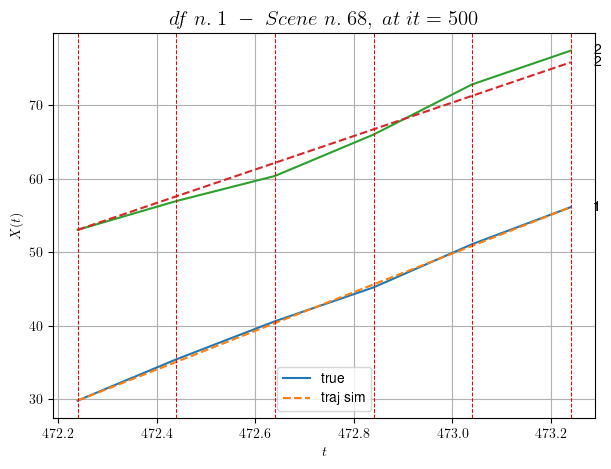

----------------------------------------------------------------------------------------------------
        For scene 11/73:
        * After LR finder: LR_NN=0.001 with mse=8.515419382487043 at it=24
        * v0 = 22.764702156057265
        * MSE = 0.6967686022568282
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [56.84,57.64]


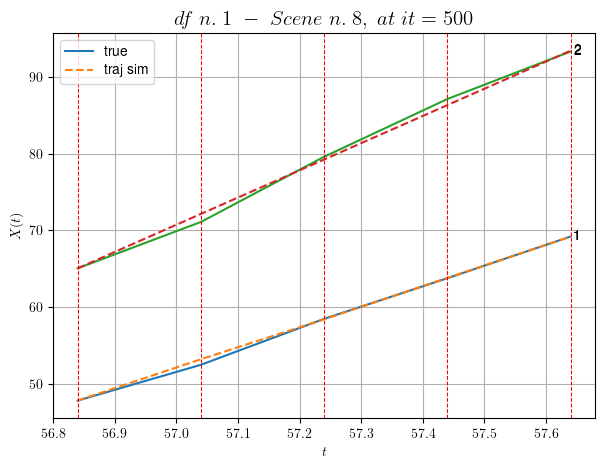

----------------------------------------------------------------------------------------------------
        For scene 12/73:
        * After LR finder: LR_NN=0.005 with mse=4.258194888340623 at it=24
        * v0 = 35.49695649017796
        * MSE = 0.23931962026615275
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [320.44,321.24]


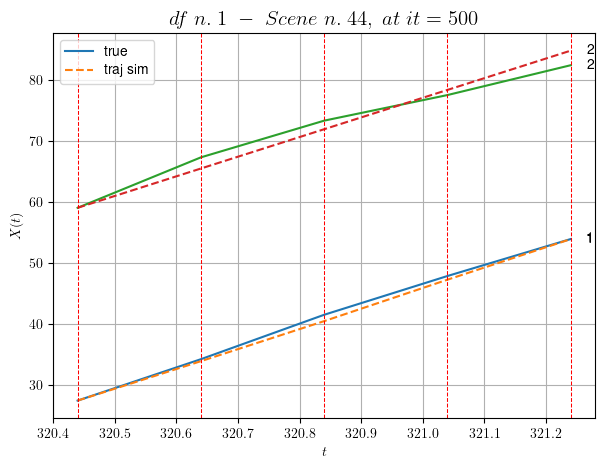

----------------------------------------------------------------------------------------------------
        For scene 13/73:
        * After LR finder: LR_NN=0.005 with mse=1.1956306636759746 at it=24
        * v0 = 32.193367249241334
        * MSE = 1.2032702870501428
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [463.04,463.64]


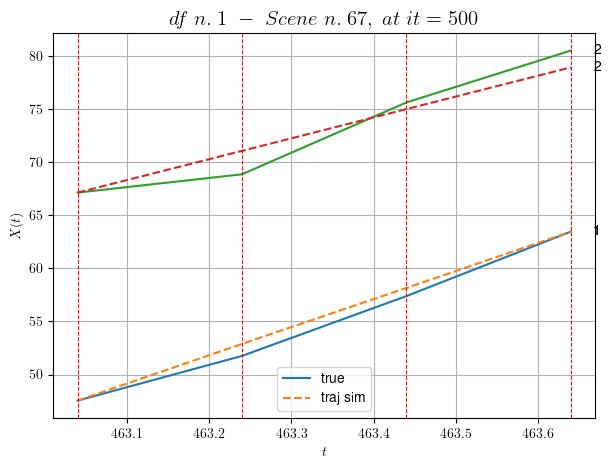

----------------------------------------------------------------------------------------------------
        For scene 14/73:
        * After LR finder: LR_NN=0.001 with mse=6.753207474579995 at it=24
        * v0 = 19.6620060476527
        * MSE = 1.0857603943542373
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [529.64,530.64]


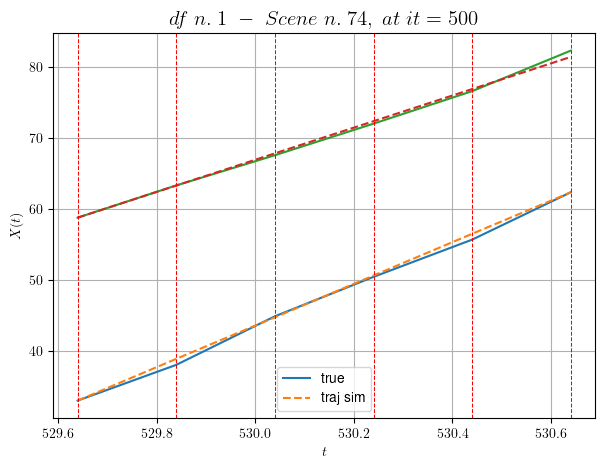

----------------------------------------------------------------------------------------------------
        For scene 15/73:
        * After LR finder: LR_NN=0.001 with mse=9.80050674666467 at it=24
        * v0 = 22.62899828503499
        * MSE = 0.20800866602049228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [230.04,230.64]


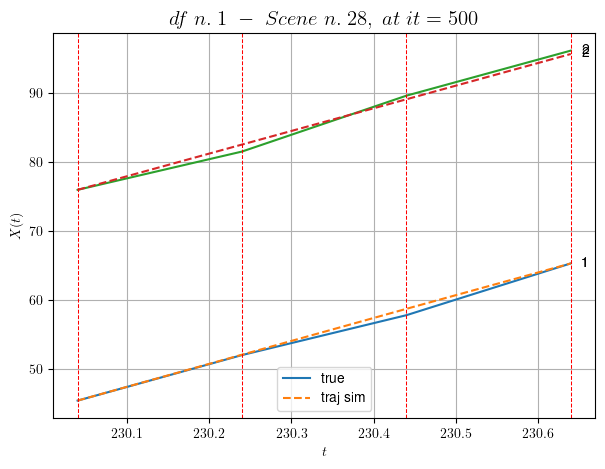

----------------------------------------------------------------------------------------------------
        For scene 16/73:
        * After LR finder: LR_NN=0.001 with mse=1.1412389614108758 at it=24
        * v0 = 32.80710231491831
        * MSE = 0.29766576126159244
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [146.24,146.64]


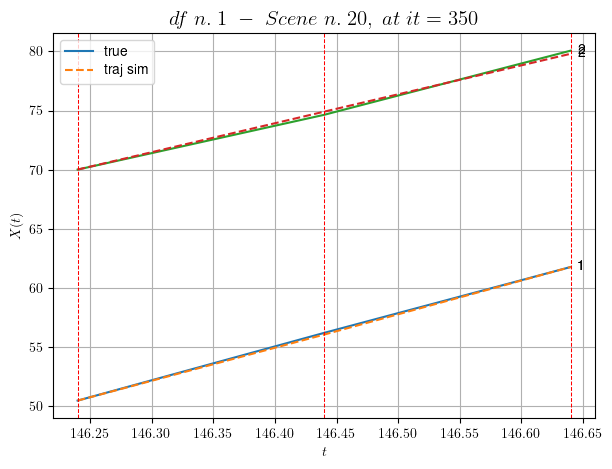

----------------------------------------------------------------------------------------------------
        For scene 17/73:
        * After LR finder: LR_NN=0.01 with mse=0.9666361930160565 at it=24
        * v0 = 24.481033392773565
        * MSE = 0.026428575118432183
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [164.04,164.64]


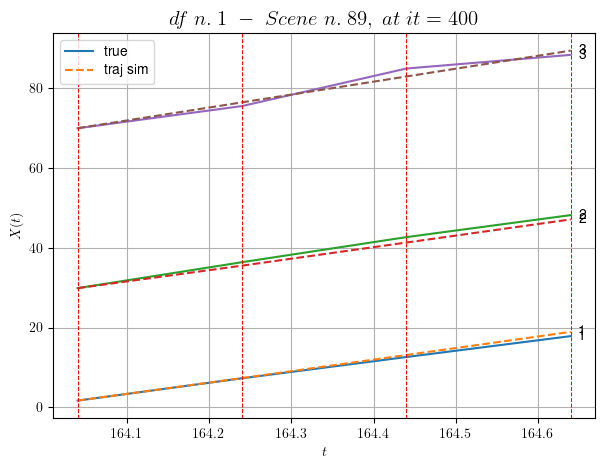

----------------------------------------------------------------------------------------------------
        For scene 18/73:
        * After LR finder: LR_NN=0.005 with mse=1.2064347572983456 at it=24
        * v0 = 32.43284780829202
        * MSE = 0.9249664009460993
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [262.64,263.64]


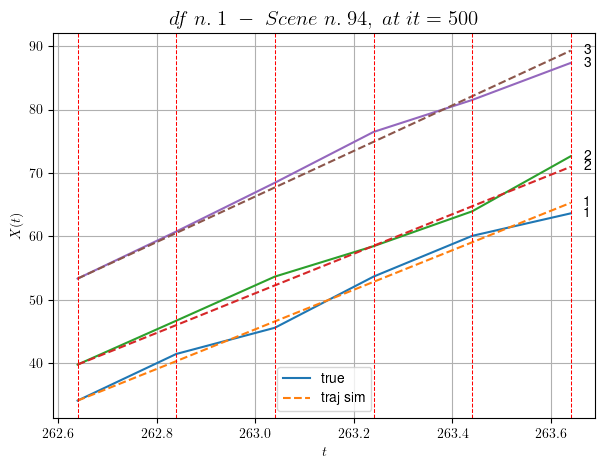

----------------------------------------------------------------------------------------------------
        For scene 19/73:
        * After LR finder: LR_NN=0.001 with mse=4.590568668446961 at it=24
        * v0 = 35.93109742746464
        * MSE = 1.064204586656379
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [209.64,210.24]


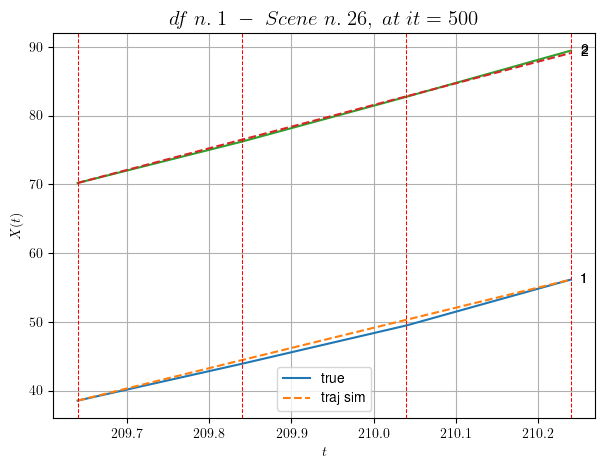

----------------------------------------------------------------------------------------------------
        For scene 20/73:
        * After LR finder: LR_NN=0.001 with mse=0.36203317664886747 at it=24
        * v0 = 31.50707137223962
        * MSE = 0.14744519191806654
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [60.04,60.84]


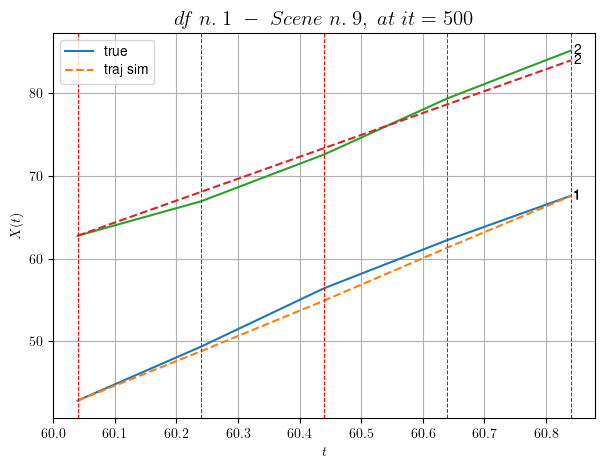

----------------------------------------------------------------------------------------------------
        For scene 21/73:
        * After LR finder: LR_NN=0.005 with mse=1.6690374588370571 at it=24
        * v0 = 26.521619591085837
        * MSE = 0.7202405609501873
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [447.44,448.04]


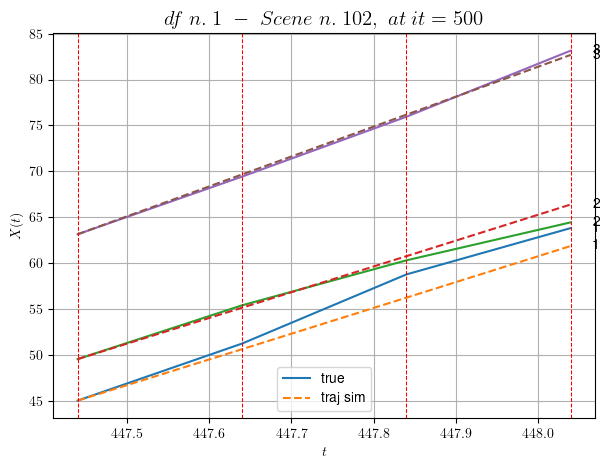

----------------------------------------------------------------------------------------------------
        For scene 22/73:
        * After LR finder: LR_NN=0.0005 with mse=1.6979626844150573 at it=24
        * v0 = 32.58486004517645
        * MSE = 1.2488839114966994
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [351.64,352.24]


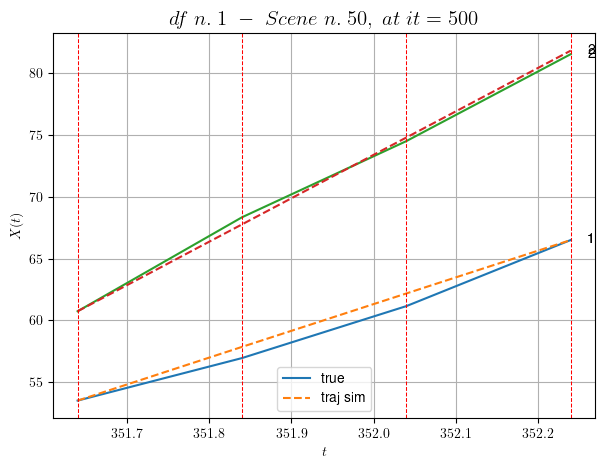

----------------------------------------------------------------------------------------------------
        For scene 23/73:
        * After LR finder: LR_NN=0.0005 with mse=9.617064446502038 at it=24
        * v0 = 35.128237730719775
        * MSE = 0.29301681979577626
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [109.24,109.84]


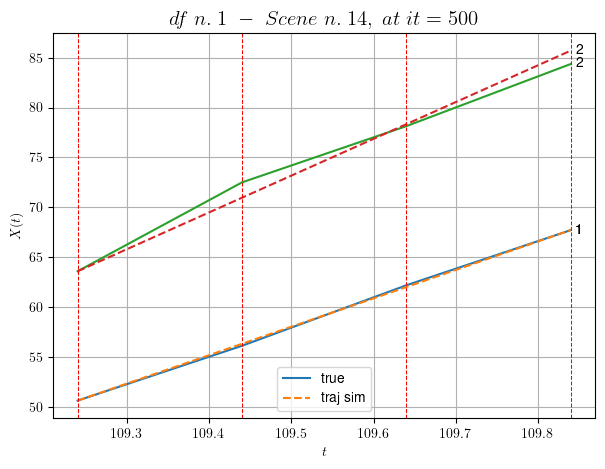

----------------------------------------------------------------------------------------------------
        For scene 24/73:
        * After LR finder: LR_NN=0.0005 with mse=2.851851725527051 at it=24
        * v0 = 36.87036026795266
        * MSE = 0.4596530835567176
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [571.04,572.64]


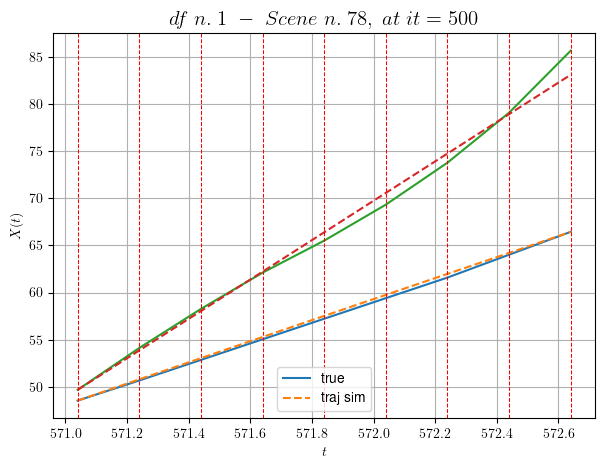

----------------------------------------------------------------------------------------------------
        For scene 25/73:
        * After LR finder: LR_NN=0.01 with mse=36.99934318637654 at it=24
        * v0 = 20.877122500554435
        * MSE = 0.5780120707917786
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [200.44,201.24]


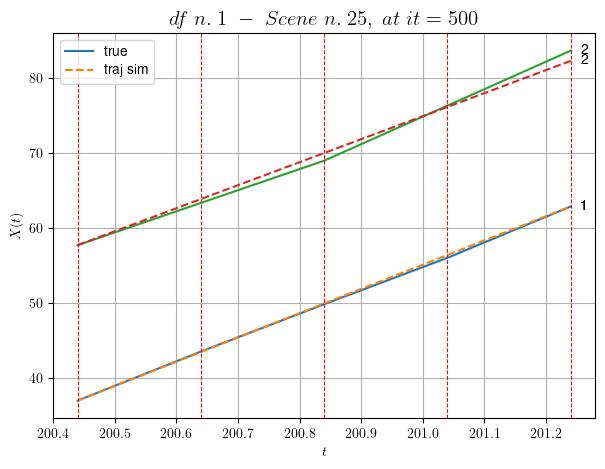

----------------------------------------------------------------------------------------------------
        For scene 26/73:
        * After LR finder: LR_NN=0.0005 with mse=0.4997903546970844 at it=24
        * v0 = 30.710273891218755
        * MSE = 0.3356899461092101
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [37.44,38.24]


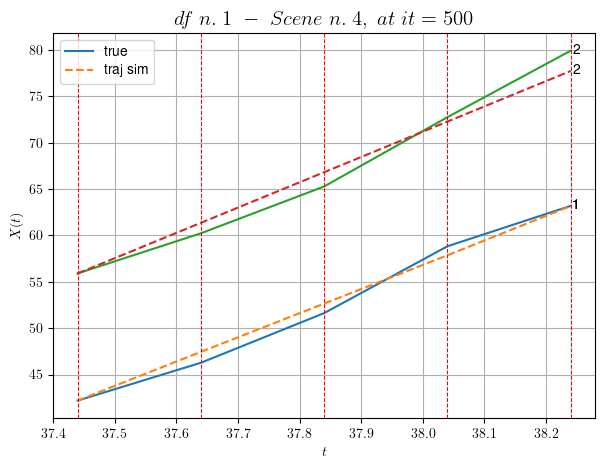

----------------------------------------------------------------------------------------------------
        For scene 27/73:
        * After LR finder: LR_NN=0.001 with mse=1.520244641214498 at it=24
        * v0 = 27.29525416582103
        * MSE = 1.0977066029979388
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [140.64,141.24]


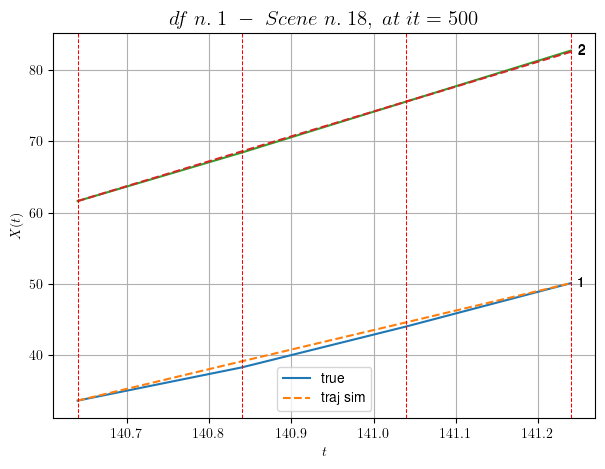

----------------------------------------------------------------------------------------------------
        For scene 28/73:
        * After LR finder: LR_NN=0.001 with mse=1.9620872030474314 at it=24
        * v0 = 34.928349100205686
        * MSE = 0.14007283906643223
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [301.44,302.44]


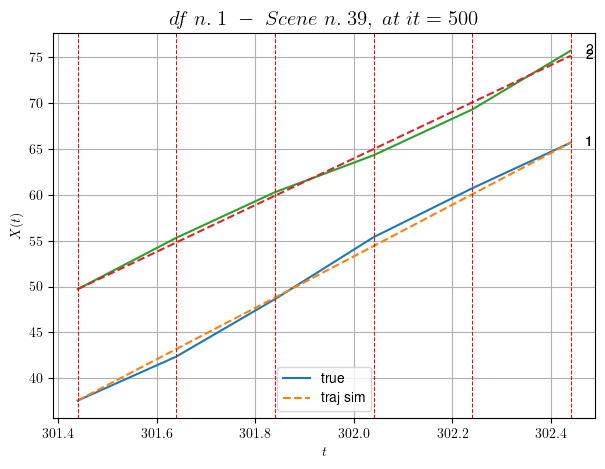

----------------------------------------------------------------------------------------------------
        For scene 29/73:
        * After LR finder: LR_NN=0.0005 with mse=4.342592266640518 at it=24
        * v0 = 25.44608174700899
        * MSE = 0.31903920634297006
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [131.64,132.04]


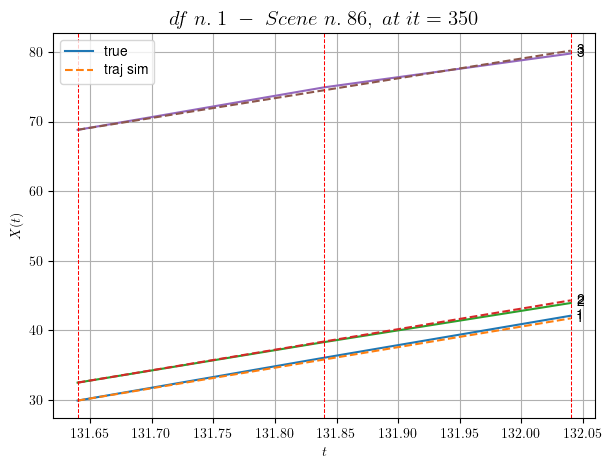

----------------------------------------------------------------------------------------------------
        For scene 30/73:
        * After LR finder: LR_NN=0.0005 with mse=17.437347267587874 at it=24
        * v0 = 28.44290395364301
        * MSE = 0.07839786953321014
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [54.84,55.24]


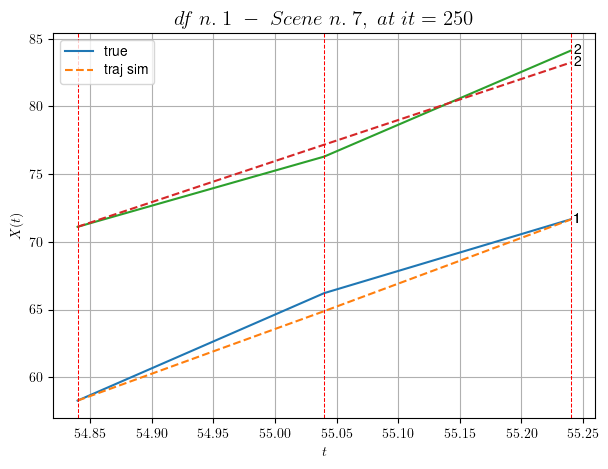

----------------------------------------------------------------------------------------------------
        For scene 31/73:
        * After LR finder: LR_NN=0.001 with mse=14.182906590864874 at it=24
        * v0 = 30.333443711615296
        * MSE = 0.5500948883138204
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [499.04,499.44]


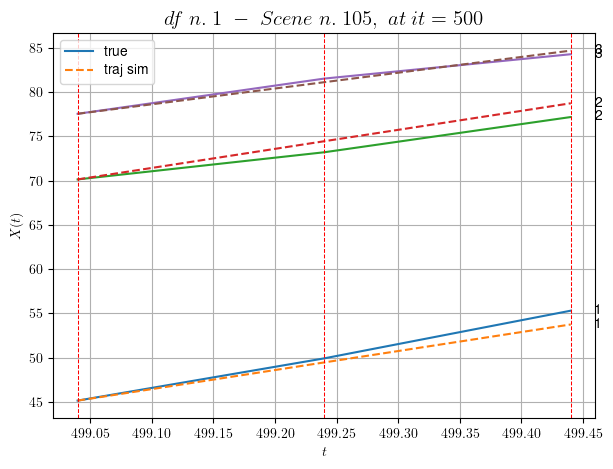

----------------------------------------------------------------------------------------------------
        For scene 32/73:
        * After LR finder: LR_NN=0.001 with mse=4.291404128146827 at it=24
        * v0 = 17.832163517132315
        * MSE = 0.769562664302789
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.24,326.44]


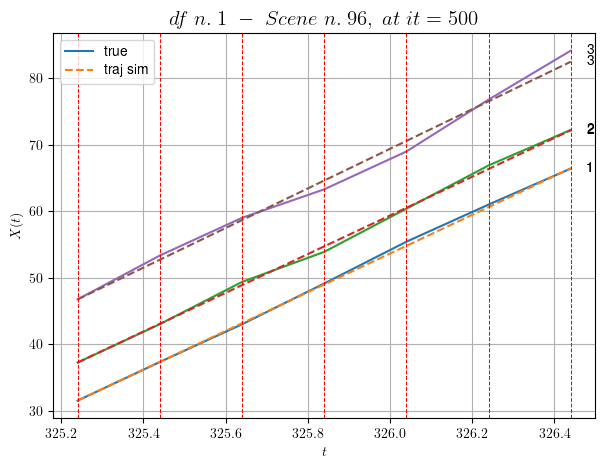

----------------------------------------------------------------------------------------------------
        For scene 33/73:
        * After LR finder: LR_NN=0.001 with mse=0.4816641414648357 at it=24
        * v0 = 29.80403381006949
        * MSE = 0.45094909644992437
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [240.64,241.04]


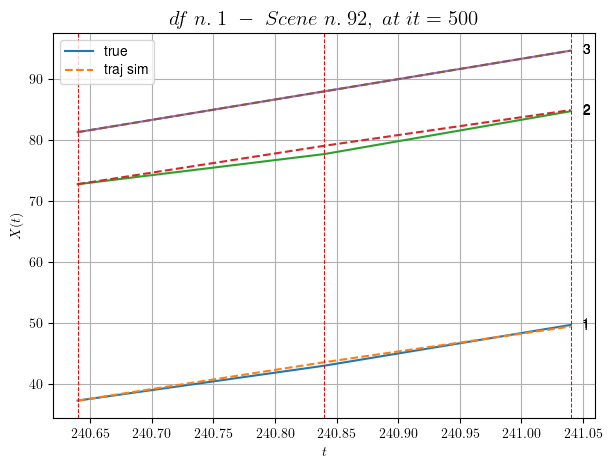

----------------------------------------------------------------------------------------------------
        For scene 34/73:
        * After LR finder: LR_NN=0.005 with mse=0.5467850867856743 at it=24
        * v0 = 33.344769841085146
        * MSE = 0.24218252064489496
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [380.24,380.64]


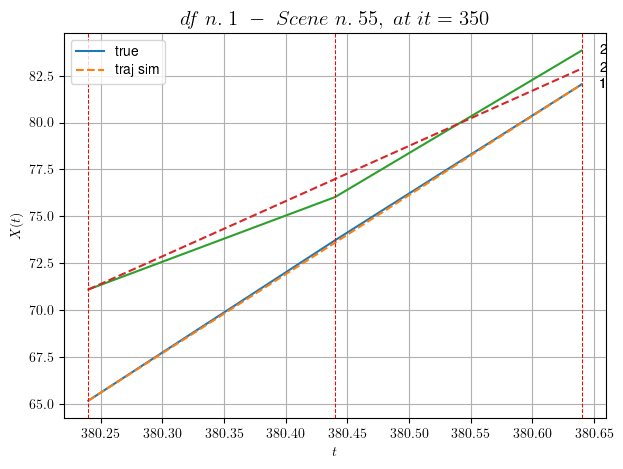

----------------------------------------------------------------------------------------------------
        For scene 35/73:
        * After LR finder: LR_NN=0.001 with mse=0.2999940766615919 at it=24
        * v0 = 29.441226274727107
        * MSE = 0.2974440386994337
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [352.84,353.84]


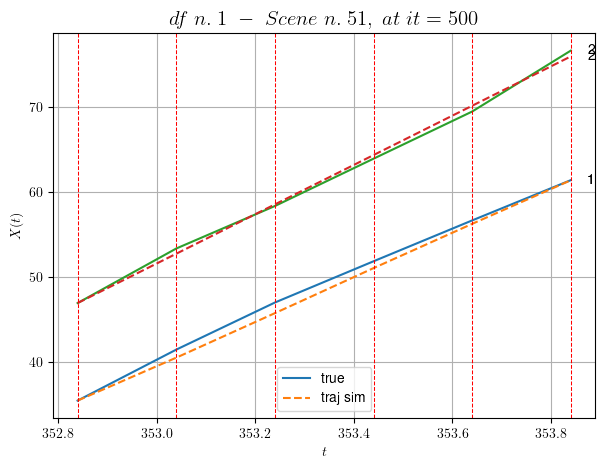

----------------------------------------------------------------------------------------------------
        For scene 36/73:
        * After LR finder: LR_NN=0.005 with mse=0.4914626770447049 at it=24
        * v0 = 29.02856357779847
        * MSE = 0.39785397989917126
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [386.64,387.44]


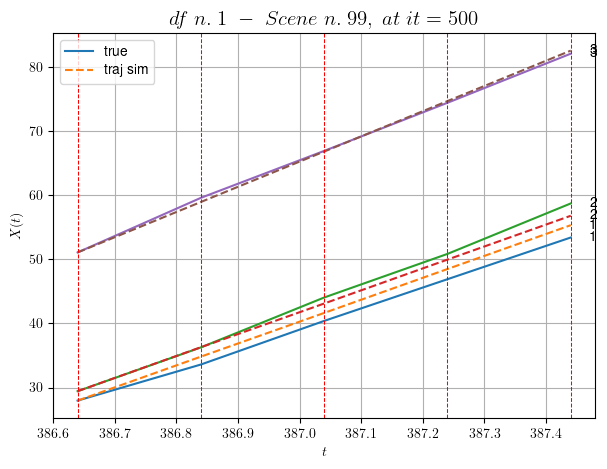

----------------------------------------------------------------------------------------------------
        For scene 37/73:
        * After LR finder: LR_NN=0.001 with mse=7.424809789743899 at it=24
        * v0 = 39.346100167621515
        * MSE = 1.0204613299156333
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [335.24,335.84]


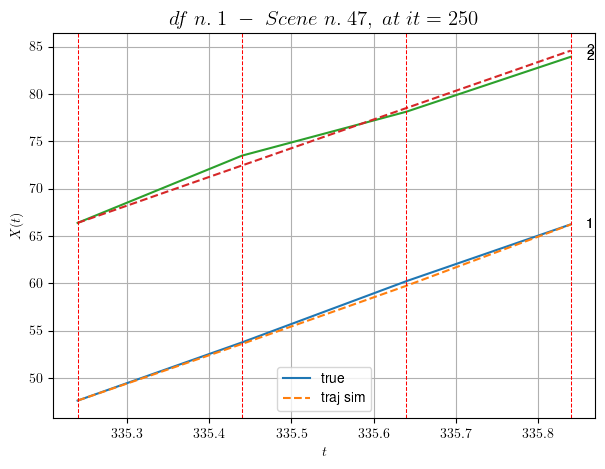

----------------------------------------------------------------------------------------------------
        For scene 38/73:
        * After LR finder: LR_NN=0.01 with mse=0.2551107437273644 at it=24
        * v0 = 30.33723843000091
        * MSE = 0.23744566132316808
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [72.44,73.44]


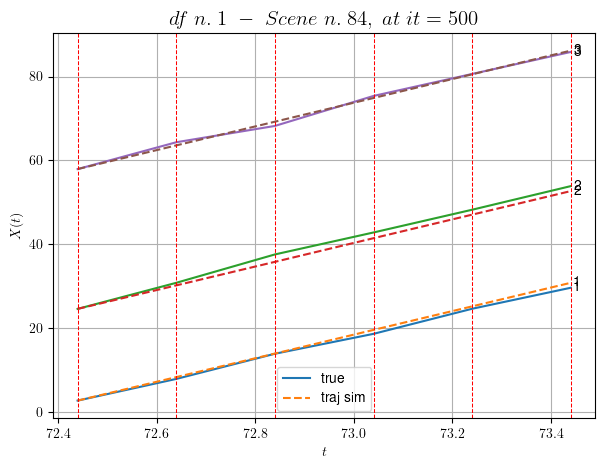

----------------------------------------------------------------------------------------------------
        For scene 39/73:
        * After LR finder: LR_NN=0.001 with mse=1.1432741374427435 at it=24
        * v0 = 28.250920573908264
        * MSE = 0.7140741259281262
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [431.04,432.24]


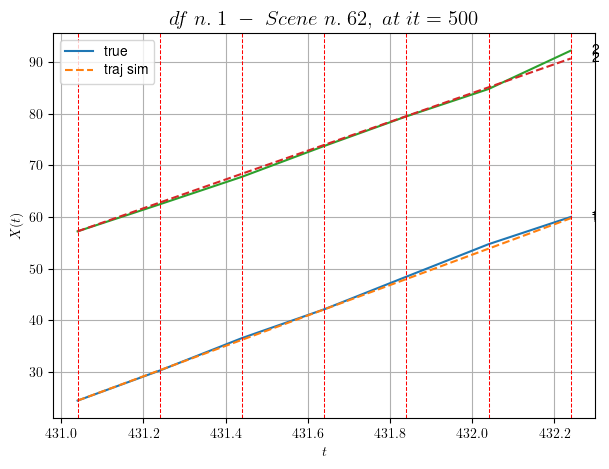

----------------------------------------------------------------------------------------------------
        For scene 40/73:
        * After LR finder: LR_NN=1e-05 with mse=1.0692592176826092 at it=24
        * v0 = 27.91482717316352
        * MSE = 0.2914409165668423
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [500.64,501.04]


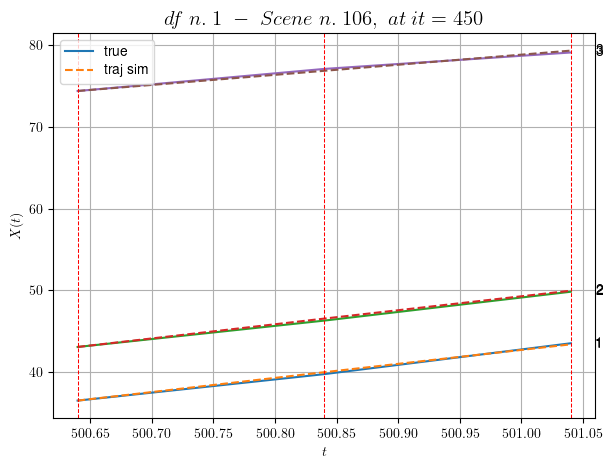

----------------------------------------------------------------------------------------------------
        For scene 41/73:
        * After LR finder: LR_NN=0.005 with mse=7.157116822397957 at it=24
        * v0 = 12.361373747544404
        * MSE = 0.02814121241753324
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [446.24,446.84]


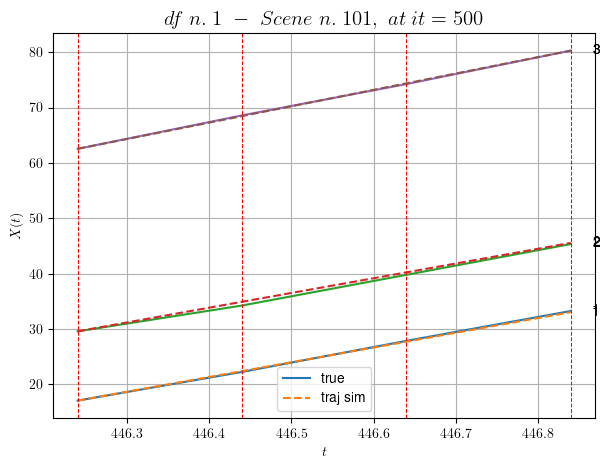

----------------------------------------------------------------------------------------------------
        For scene 42/73:
        * After LR finder: LR_NN=0.001 with mse=0.08509006402820109 at it=24
        * v0 = 29.554429209126564
        * MSE = 0.06738631145346351
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [316.44,317.04]


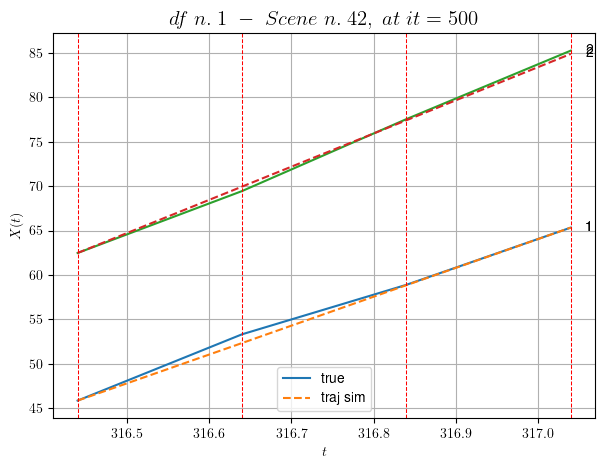

----------------------------------------------------------------------------------------------------
        For scene 43/73:
        * After LR finder: LR_NN=0.0005 with mse=4.278295774865488 at it=24
        * v0 = 37.33434122715033
        * MSE = 0.17134642014742454
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [403.64,404.64]


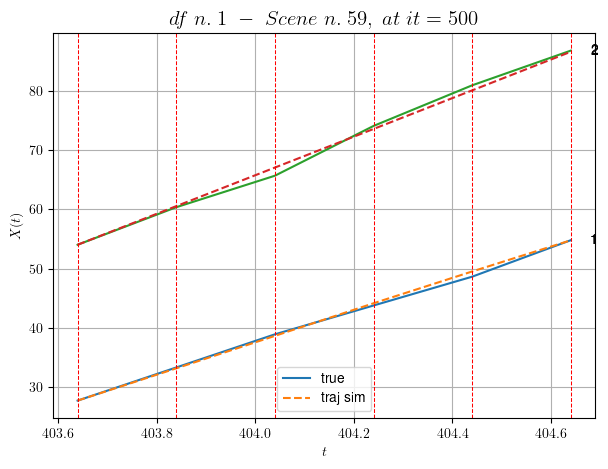

----------------------------------------------------------------------------------------------------
        For scene 44/73:
        * After LR finder: LR_NN=0.005 with mse=1.9813701598174847 at it=24
        * v0 = 32.579782853266344
        * MSE = 0.3241294806804455
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [349.64,350.44]


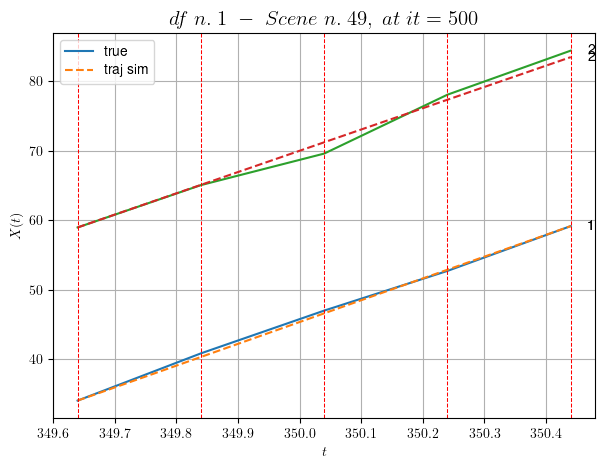

----------------------------------------------------------------------------------------------------
        For scene 45/73:
        * After LR finder: LR_NN=5e-05 with mse=0.5500595220578077 at it=24
        * v0 = 30.663808885196495
        * MSE = 0.45069279890905717
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [314.84,315.64]


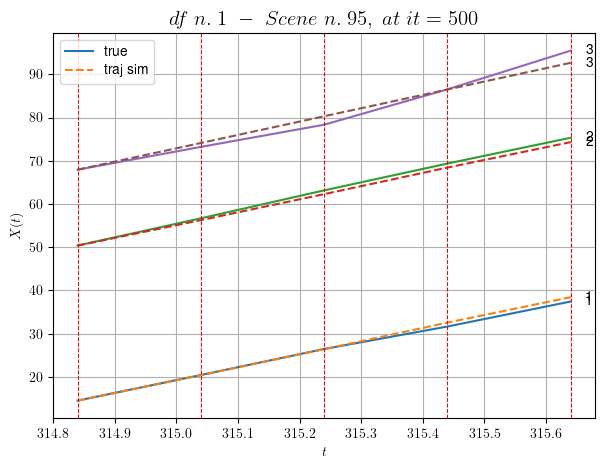

----------------------------------------------------------------------------------------------------
        For scene 46/73:
        * After LR finder: LR_NN=0.01 with mse=1.3791720618743148 at it=24
        * v0 = 30.92624785892753
        * MSE = 1.1465905703063324
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.04,402.84]


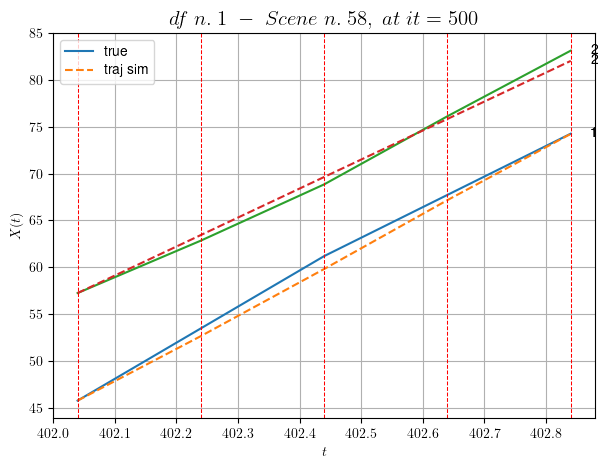

----------------------------------------------------------------------------------------------------
        For scene 47/73:
        * After LR finder: LR_NN=0.005 with mse=0.6137203206464833 at it=24
        * v0 = 31.00675921223668
        * MSE = 0.5126048072845334
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [561.44,561.84]


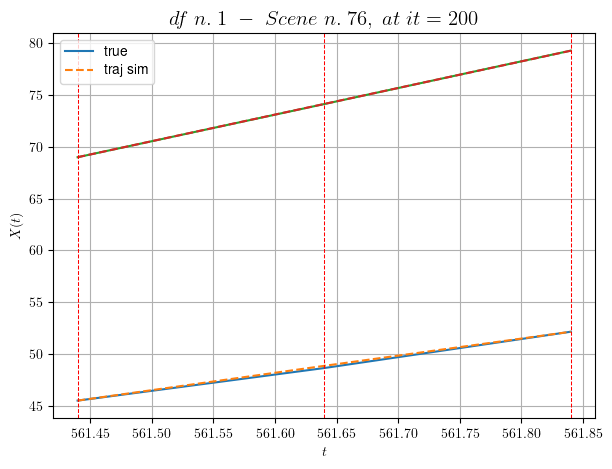

----------------------------------------------------------------------------------------------------
        For scene 48/73:
        * After LR finder: LR_NN=0.005 with mse=0.6133461864401836 at it=24
        * v0 = 25.72787979698681
        * MSE = 0.007311662416087338
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [271.04,271.64]


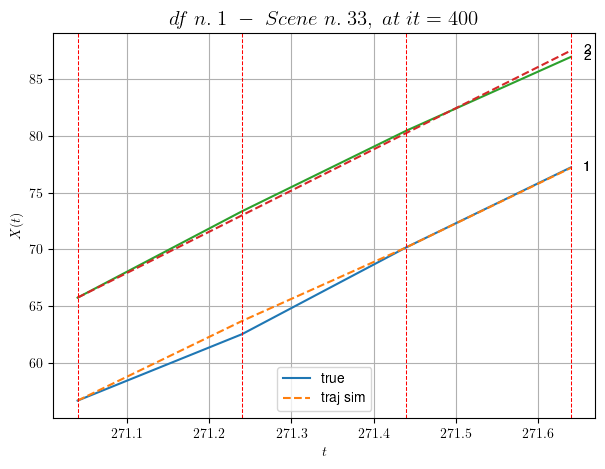

----------------------------------------------------------------------------------------------------
        For scene 49/73:
        * After LR finder: LR_NN=0.005 with mse=2.7712745288920413 at it=24
        * v0 = 36.29888465691567
        * MSE = 0.2290910615998347
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [573.84,574.44]


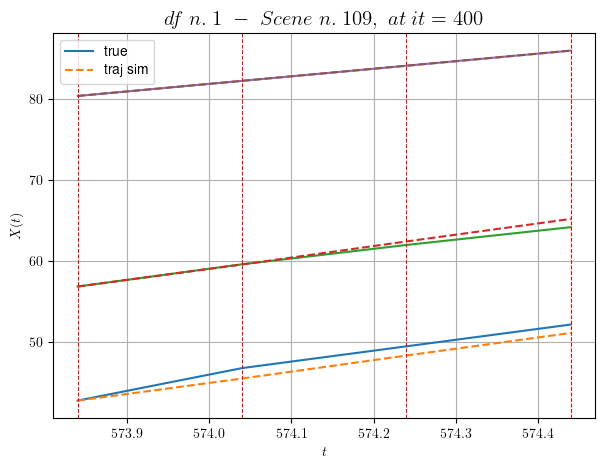

----------------------------------------------------------------------------------------------------
        For scene 50/73:
        * After LR finder: LR_NN=0.005 with mse=20.41231069557278 at it=24
        * v0 = 9.338746310354523
        * MSE = 0.43900740873650773
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [411.64,412.64]


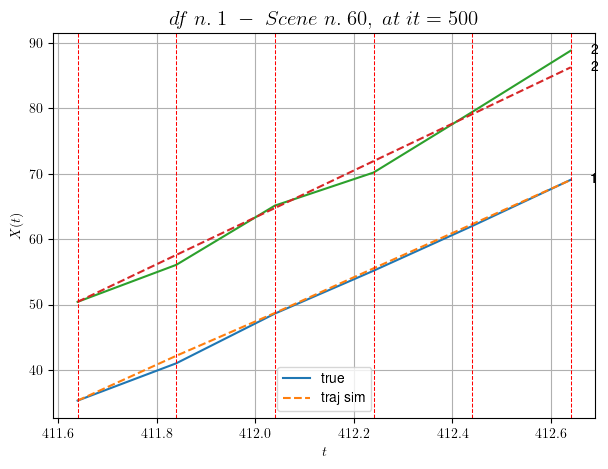

----------------------------------------------------------------------------------------------------
        For scene 51/73:
        * After LR finder: LR_NN=0.005 with mse=9.037732399875878 at it=24
        * v0 = 35.85294111711268
        * MSE = 1.1390139094144884
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [454.24,454.64]


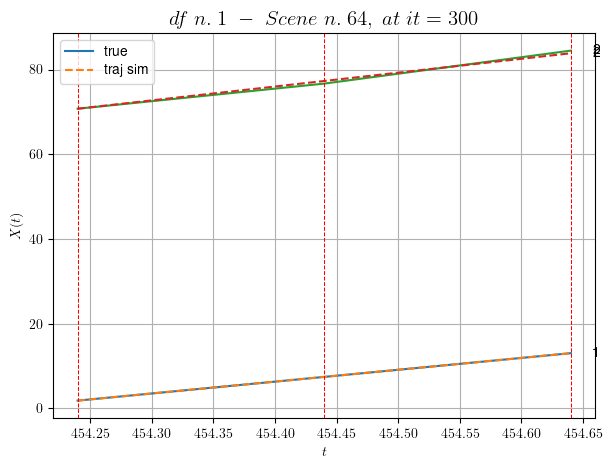

----------------------------------------------------------------------------------------------------
        For scene 52/73:
        * After LR finder: LR_NN=0.005 with mse=0.4982201755097892 at it=24
        * v0 = 32.76709532818077
        * MSE = 0.12846020763113594
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [502.24,503.04]


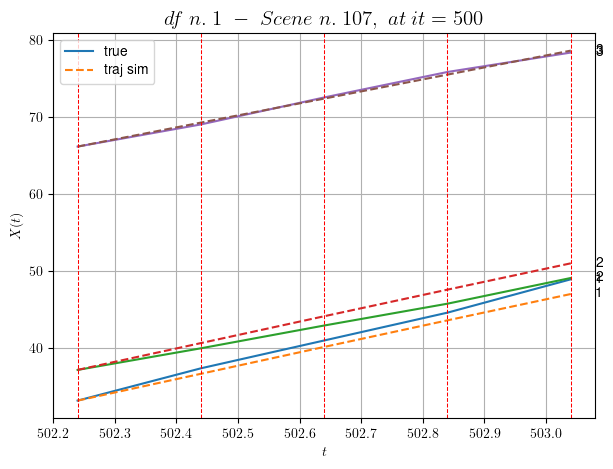

----------------------------------------------------------------------------------------------------
        For scene 53/73:
        * After LR finder: LR_NN=0.005 with mse=17.375617222390016 at it=24
        * v0 = 15.581016722935056
        * MSE = 0.9987784968825589
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [298.04,298.84]


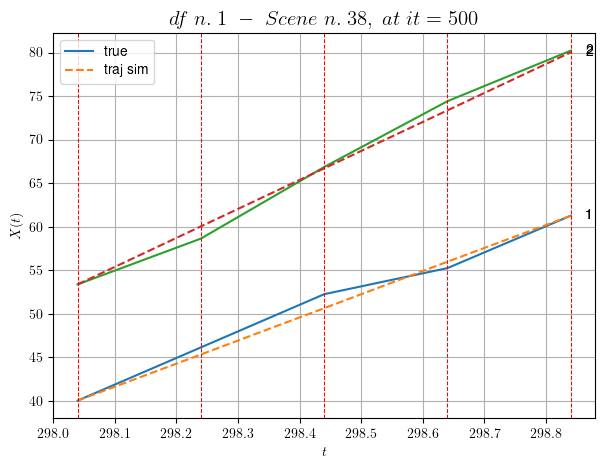

----------------------------------------------------------------------------------------------------
        For scene 54/73:
        * After LR finder: LR_NN=0.0005 with mse=2.465403146089814 at it=24
        * v0 = 33.342662459050565
        * MSE = 0.6922226943851428
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [249.84,250.44]


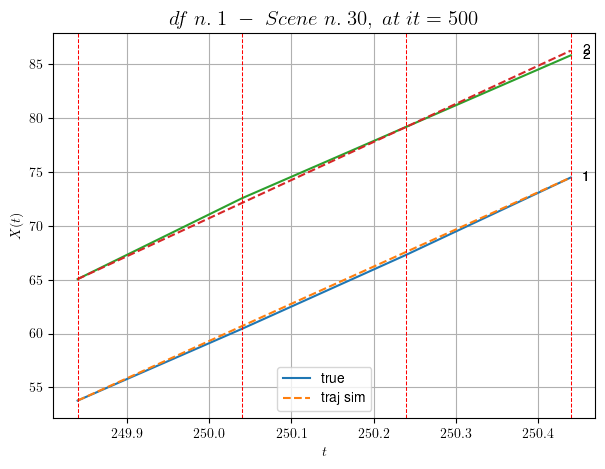

----------------------------------------------------------------------------------------------------
        For scene 55/73:
        * After LR finder: LR_NN=0.001 with mse=1.8560011536118117 at it=24
        * v0 = 35.36623656084904
        * MSE = 0.059524080807488125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [363.44,364.04]


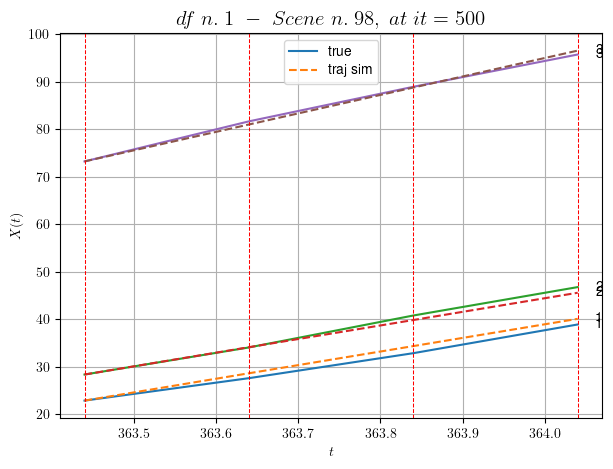

----------------------------------------------------------------------------------------------------
        For scene 56/73:
        * After LR finder: LR_NN=0.001 with mse=3.902375859607554 at it=24
        * v0 = 38.923494443016025
        * MSE = 0.6704240978443865
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [16.44,16.84]


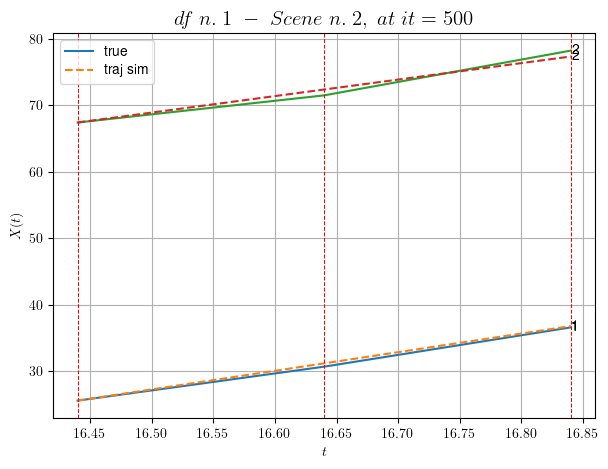

----------------------------------------------------------------------------------------------------
        For scene 57/73:
        * After LR finder: LR_NN=1e-05 with mse=7.622334726423819 at it=24
        * v0 = 24.819169840097516
        * MSE = 0.307809165793426
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [361.24,361.64]


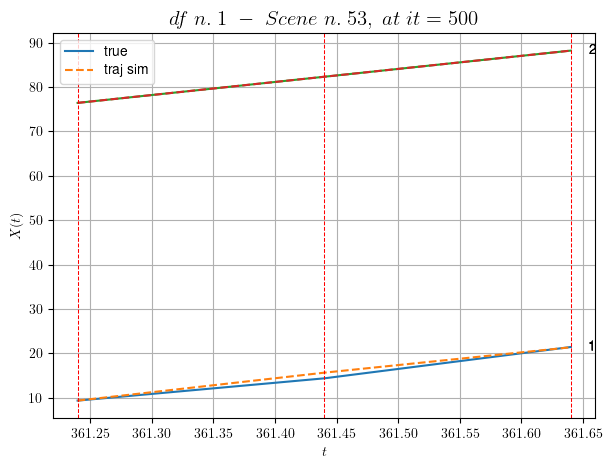

----------------------------------------------------------------------------------------------------
        For scene 58/73:
        * After LR finder: LR_NN=0.005 with mse=0.33936393507016244 at it=24
        * v0 = 29.4538609086207
        * MSE = 0.26001164566535234
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [193.24,193.64]


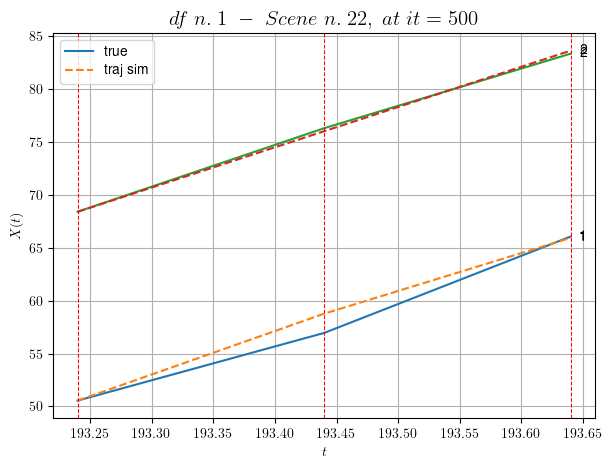

----------------------------------------------------------------------------------------------------
        For scene 59/73:
        * After LR finder: LR_NN=0.005 with mse=2.791664225571954 at it=24
        * v0 = 38.083999376914505
        * MSE = 0.5515052904052539
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.44,34.04]


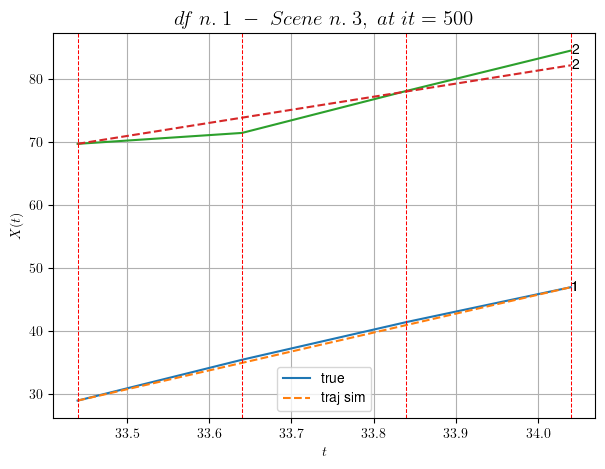

----------------------------------------------------------------------------------------------------
        For scene 60/73:
        * After LR finder: LR_NN=0.0005 with mse=5.289594313266059 at it=24
        * v0 = 20.7356239852382
        * MSE = 1.2667178249718394
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.44,199.84]


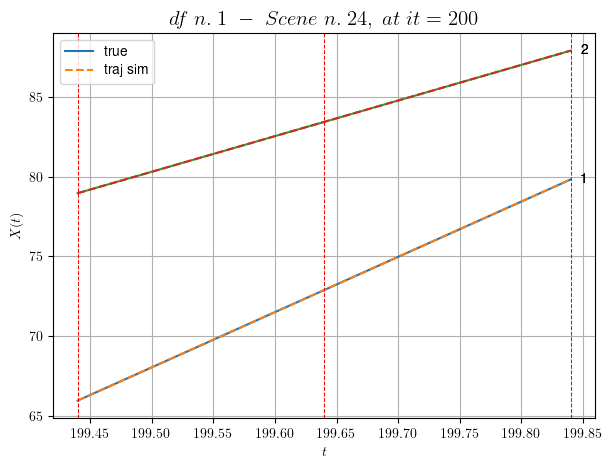

----------------------------------------------------------------------------------------------------
        For scene 61/73:
        * After LR finder: LR_NN=0.0005 with mse=36.422132349814206 at it=24
        * v0 = 22.403293039969885
        * MSE = 1.6809746792323054e-06
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [161.64,162.04]


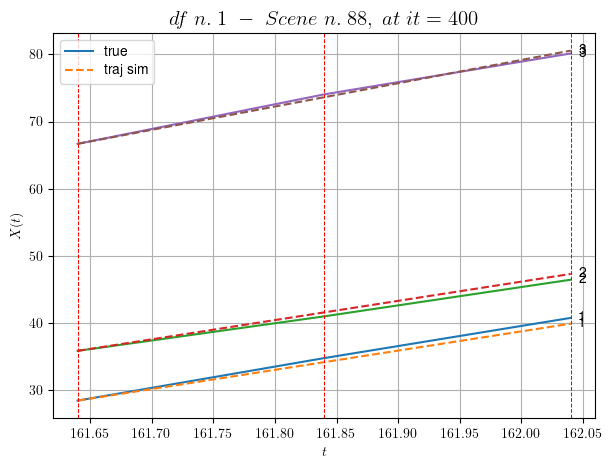

----------------------------------------------------------------------------------------------------
        For scene 62/73:
        * After LR finder: LR_NN=0.005 with mse=0.68859271366476 at it=24
        * v0 = 34.711809120617
        * MSE = 0.2798963695449774
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [431.84,432.24]


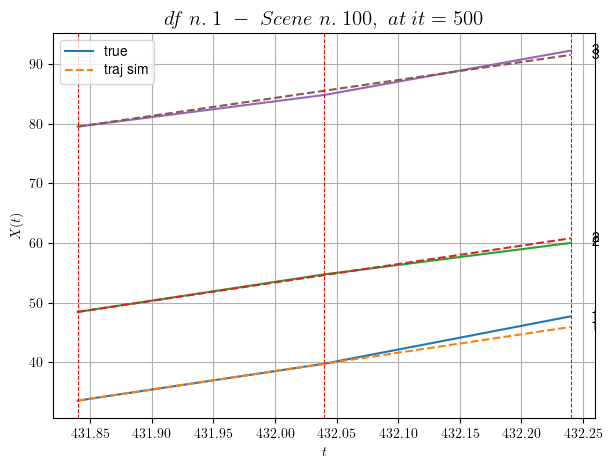

----------------------------------------------------------------------------------------------------
        For scene 63/73:
        * After LR finder: LR_NN=1e-05 with mse=43.25863390402077 at it=24
        * v0 = 30.084161636186618
        * MSE = 0.5307058512684258
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


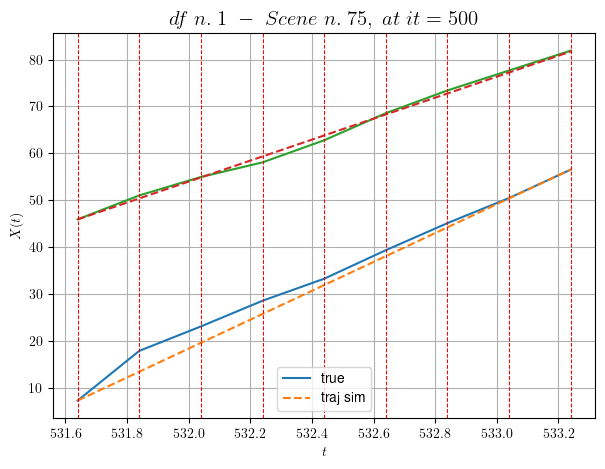

----------------------------------------------------------------------------------------------------
        For scene 64/73:
        * After LR finder: LR_NN=1e-05 with mse=26.81542709664655 at it=24
        * v0 = 22.382648405903115
        * MSE = 2.637939934303183
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


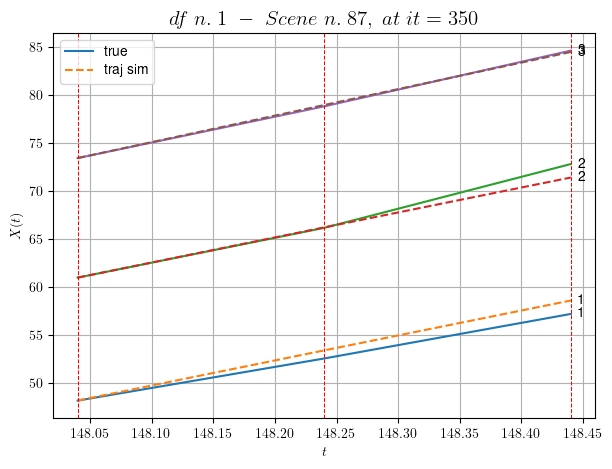

----------------------------------------------------------------------------------------------------
        For scene 65/73:
        * After LR finder: LR_NN=0.001 with mse=0.6312387202683979 at it=24
        * v0 = 27.62167390672553
        * MSE = 0.5186701747718918
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


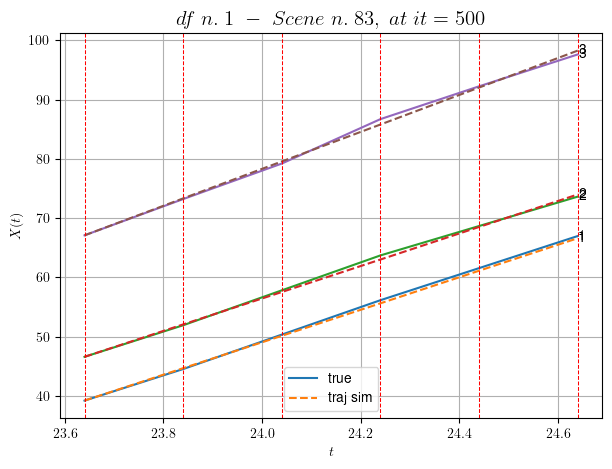

----------------------------------------------------------------------------------------------------
        For scene 66/73:
        * After LR finder: LR_NN=0.001 with mse=0.3701341515247818 at it=24
        * v0 = 31.184420565840014
        * MSE = 0.15681490614318835
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


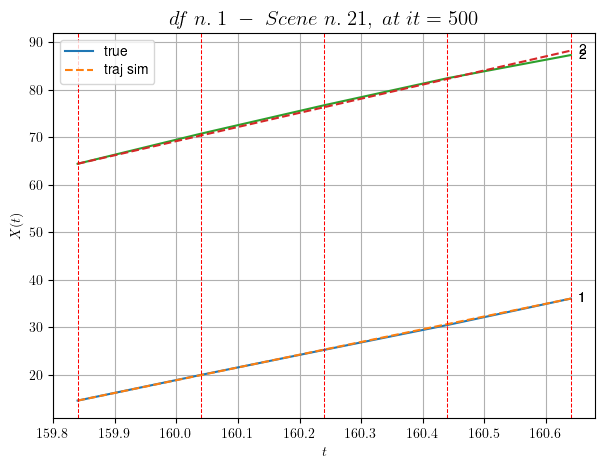

----------------------------------------------------------------------------------------------------
        For scene 67/73:
        * After LR finder: LR_NN=5e-05 with mse=0.14827278456968263 at it=24
        * v0 = 29.799065415674303
        * MSE = 0.12525042362325026
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


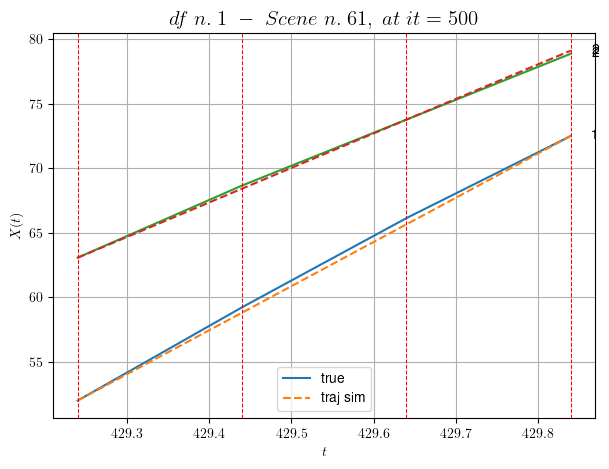

----------------------------------------------------------------------------------------------------
        For scene 68/73:
        * After LR finder: LR_NN=0.001 with mse=0.9173262027448079 at it=24
        * v0 = 26.76492351472634
        * MSE = 0.06534962871518414
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


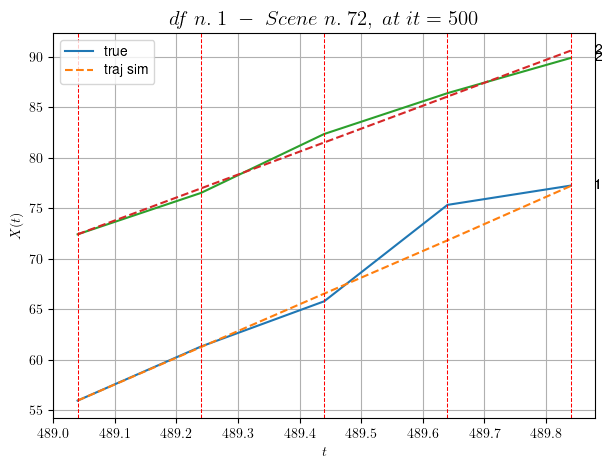

----------------------------------------------------------------------------------------------------
        For scene 69/73:
        * After LR finder: LR_NN=0.0005 with mse=8.721770740006429 at it=24
        * v0 = 22.729734196718564
        * MSE = 1.4437019183944282
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


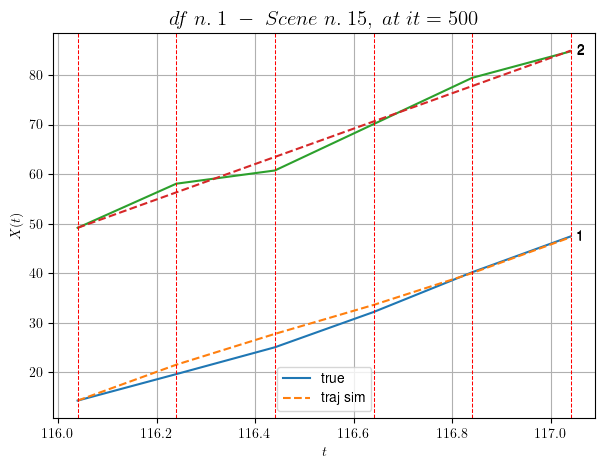

----------------------------------------------------------------------------------------------------
        For scene 70/73:
        * After LR finder: LR_NN=0.01 with mse=7.741160055198269 at it=24
        * v0 = 35.75445949476183
        * MSE = 1.60817976304481
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


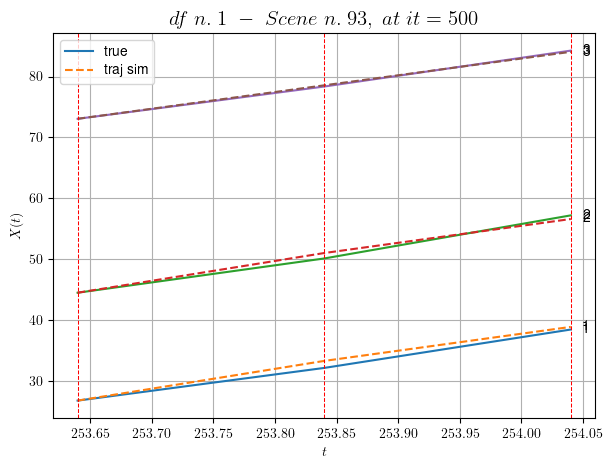

----------------------------------------------------------------------------------------------------
        For scene 71/73:
        * After LR finder: LR_NN=0.01 with mse=0.6156732164326683 at it=24
        * v0 = 27.474879582349057
        * MSE = 0.29071201863631185
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


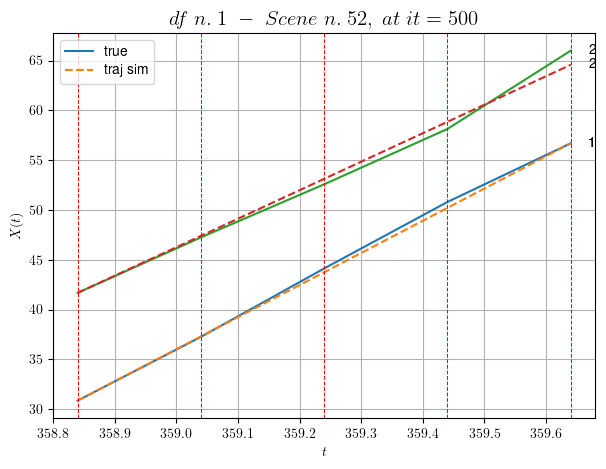

----------------------------------------------------------------------------------------------------
        For scene 72/73:
        * After LR finder: LR_NN=0.001 with mse=0.4459771205528408 at it=24
        * v0 = 28.62644197691904
        * MSE = 0.3241257128364015
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


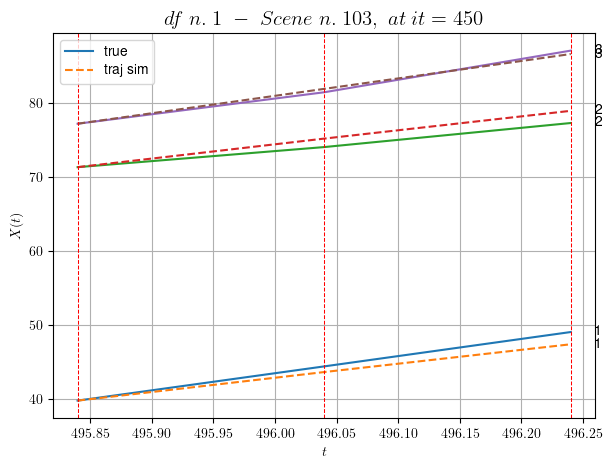

----------------------------------------------------------------------------------------------------
        For scene 73/73:
        * After LR finder: LR_NN=0.01 with mse=1.7192845897535756 at it=24
        * v0 = 23.563094778666276
        * MSE = 0.8625576140591386
        * iterations = 450
----------------------------------------------------------------------------------------------------


MSE train: 0.6118541098151932
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (36 scenes)
DataFrame n.1. Scene n.1/36


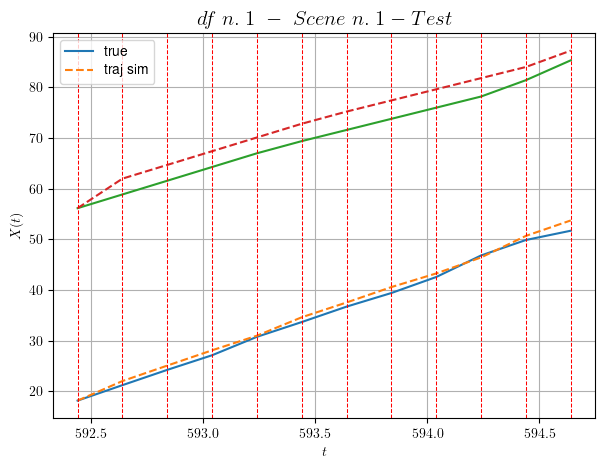

        For scene 1/36:
        * MSE = 5.190436593511168
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/36


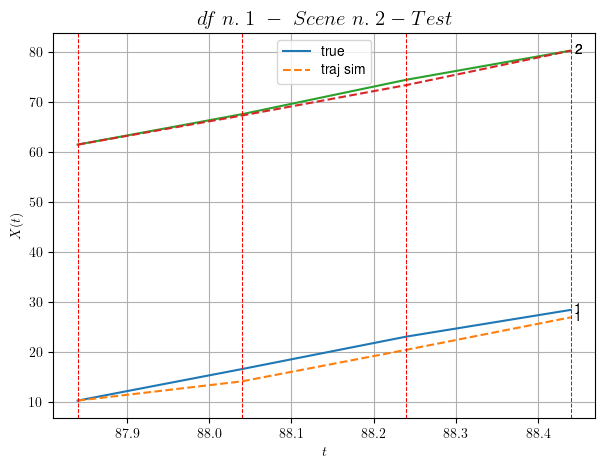

        For scene 2/36:
        * MSE = 2.054995961073858
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/36


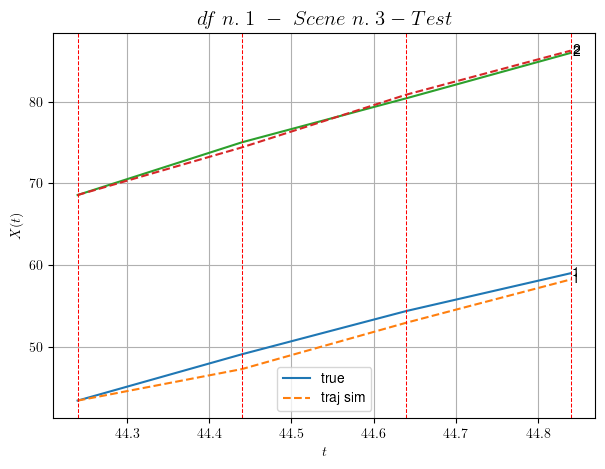

        For scene 3/36:
        * MSE = 0.8209011284057681
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/36


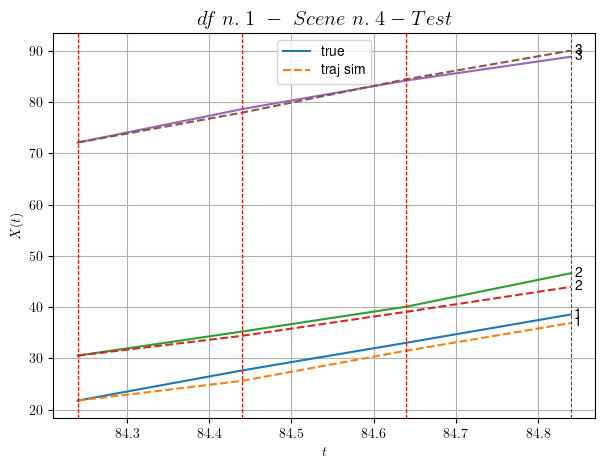

        For scene 4/36:
        * MSE = 1.6682565169048884
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/36


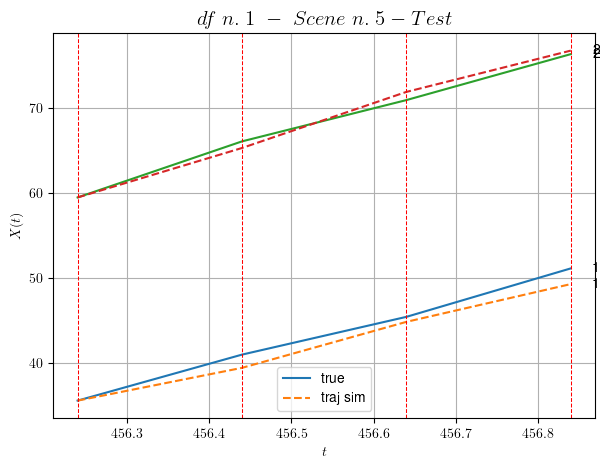

        For scene 5/36:
        * MSE = 0.9878580001711532
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/36


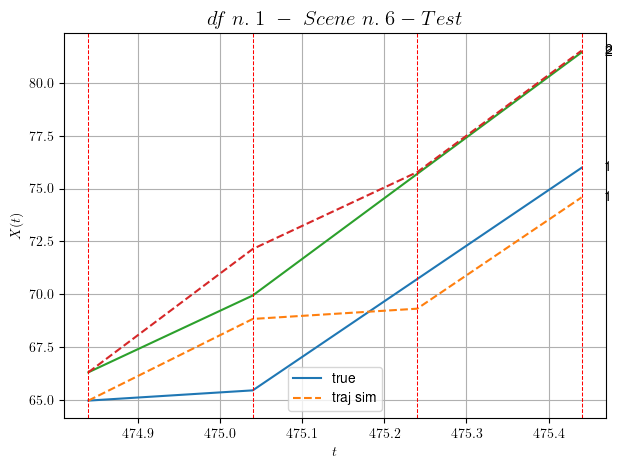

        For scene 6/36:
        * MSE = 2.5199718399607995
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/36


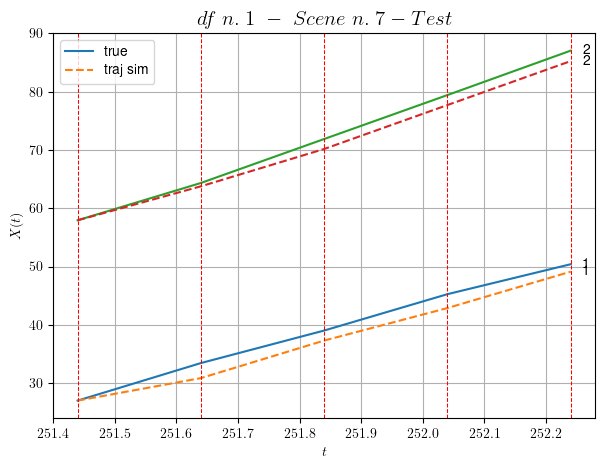

        For scene 7/36:
        * MSE = 2.6290939521988026
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/36


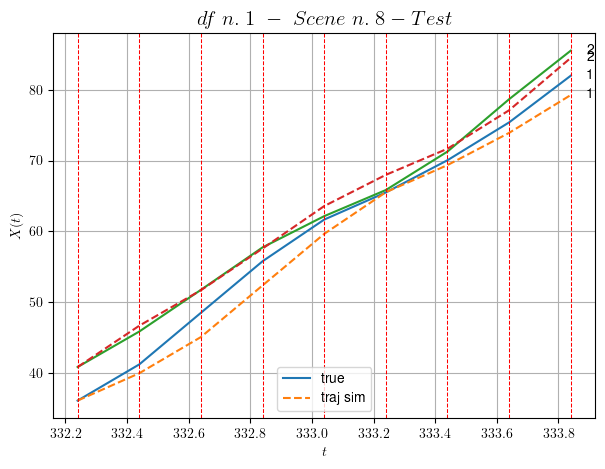

        For scene 8/36:
        * MSE = 2.7801159237411612
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/36


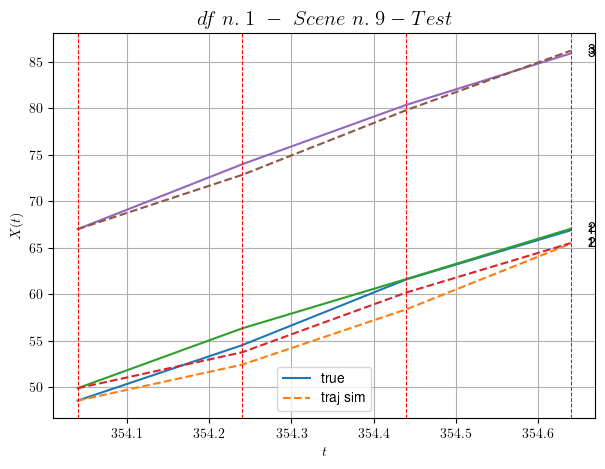

        For scene 9/36:
        * MSE = 2.462646601850041
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/36


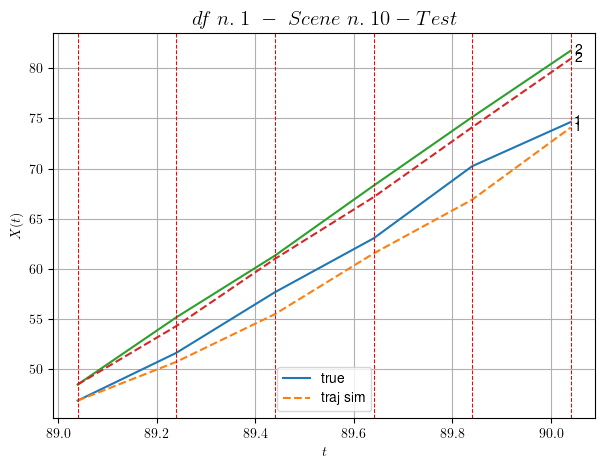

        For scene 10/36:
        * MSE = 1.9318933746685718
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/36


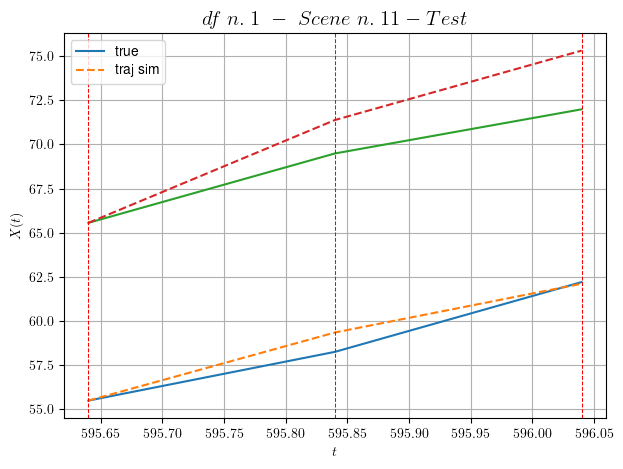

        For scene 11/36:
        * MSE = 2.646111957952143
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/36


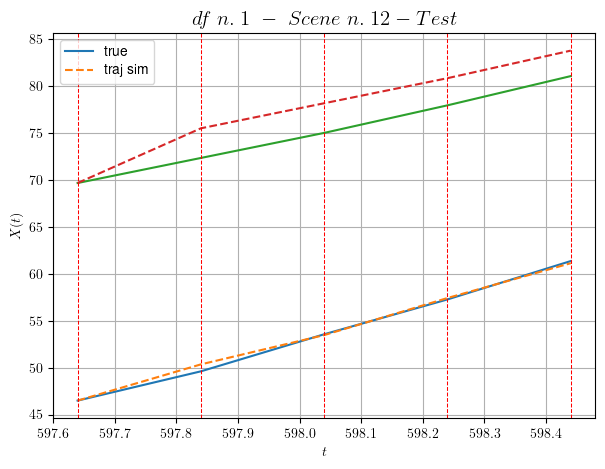

        For scene 12/36:
        * MSE = 3.6330065156328404
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/36


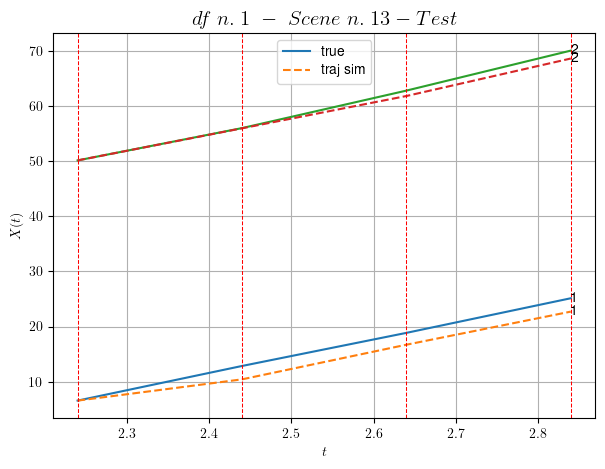

        For scene 13/36:
        * MSE = 2.4323306010732364
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/36


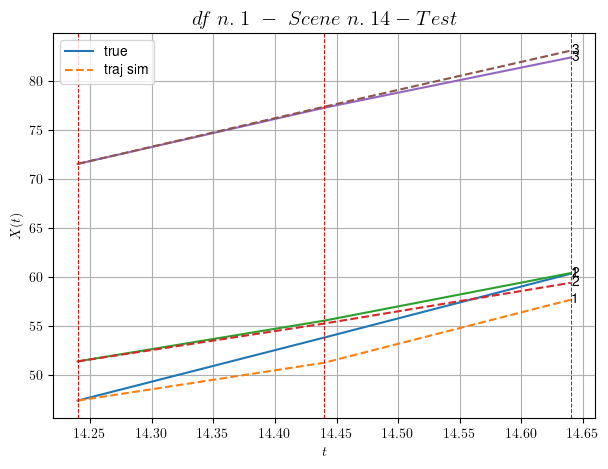

        For scene 14/36:
        * MSE = 1.6893880027387869
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/36


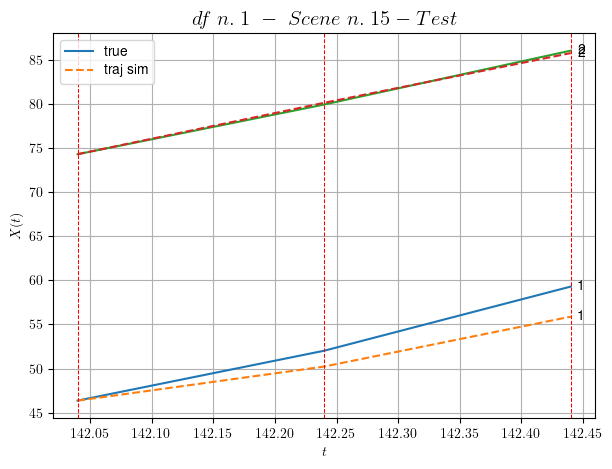

        For scene 15/36:
        * MSE = 2.4960367680384636
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/36


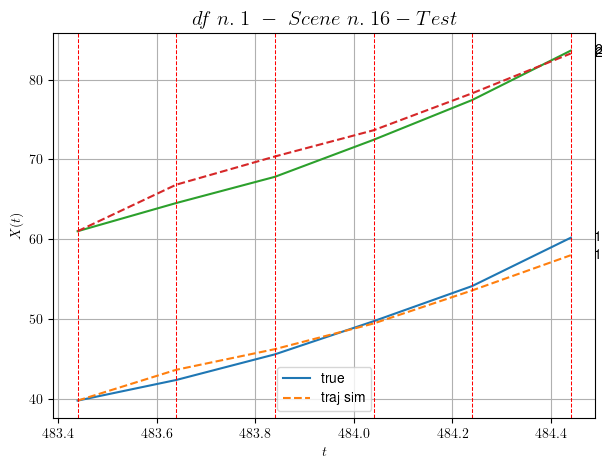

        For scene 16/36:
        * MSE = 1.7747344891198755
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/36


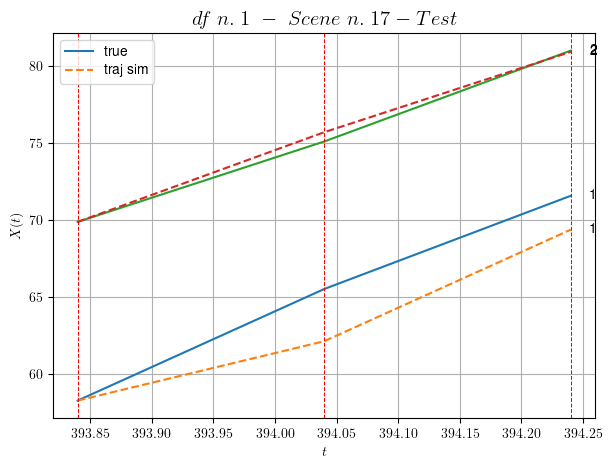

        For scene 17/36:
        * MSE = 2.787726157460149
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/36


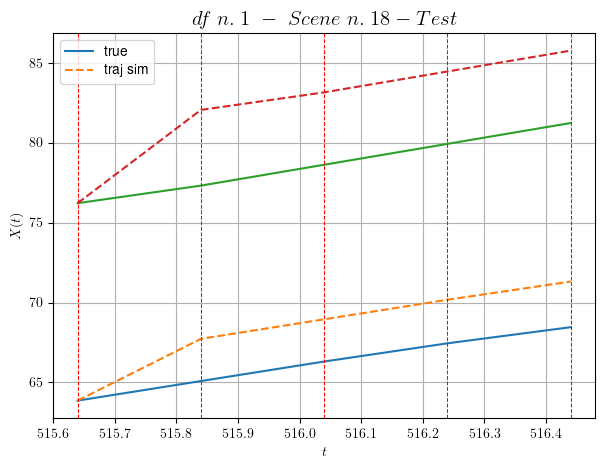

        For scene 18/36:
        * MSE = 11.329059962980896
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/36


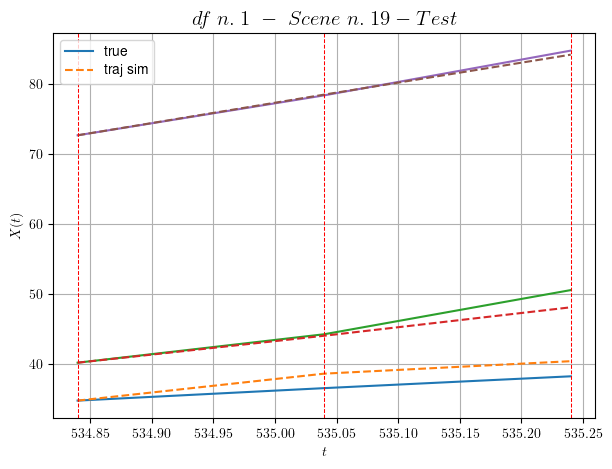

        For scene 19/36:
        * MSE = 1.7197115553226736
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/36


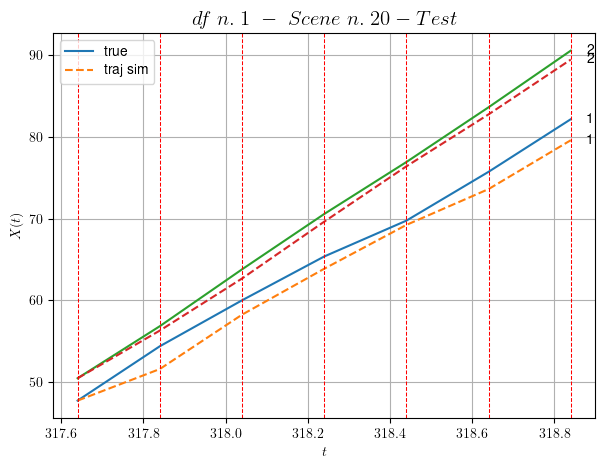

        For scene 20/36:
        * MSE = 2.0769351954077426
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/36


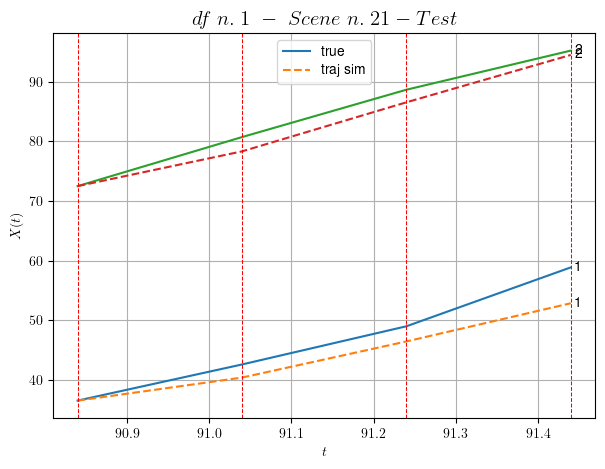

        For scene 21/36:
        * MSE = 7.272128253101371
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/36


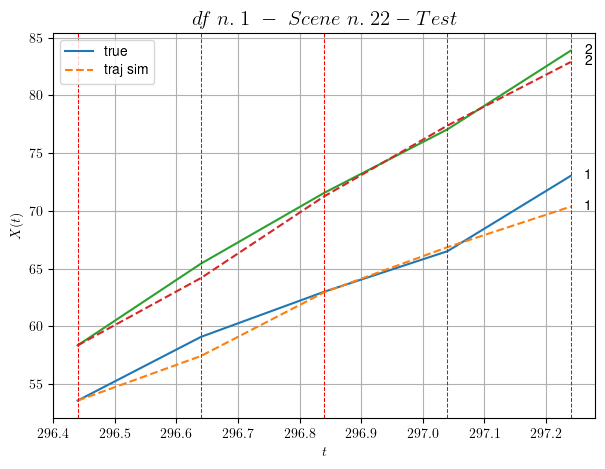

        For scene 22/36:
        * MSE = 1.2682079715035524
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/36


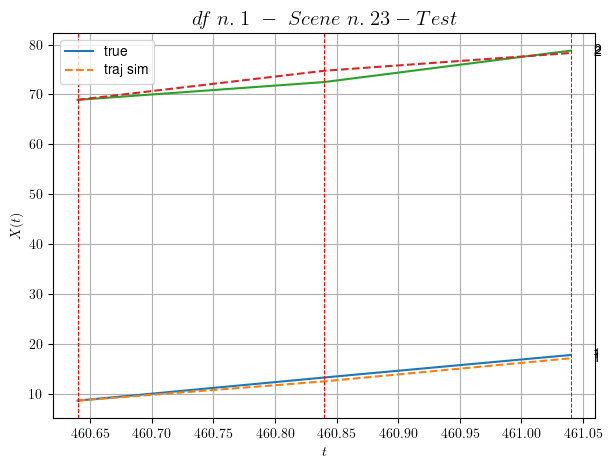

        For scene 23/36:
        * MSE = 1.0642269398324158
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/36


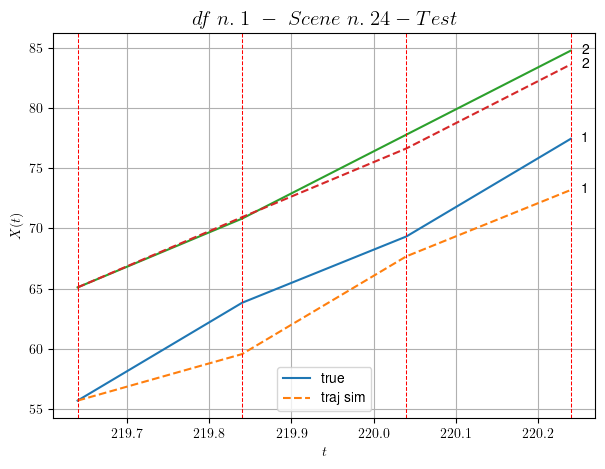

        For scene 24/36:
        * MSE = 5.195365834759409
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/36


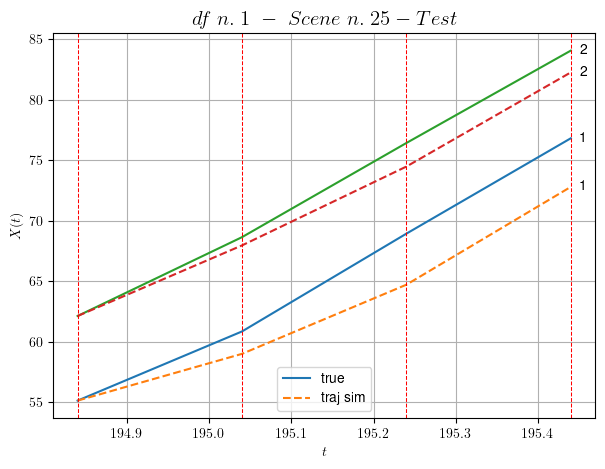

        For scene 25/36:
        * MSE = 5.597240922621682
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/36


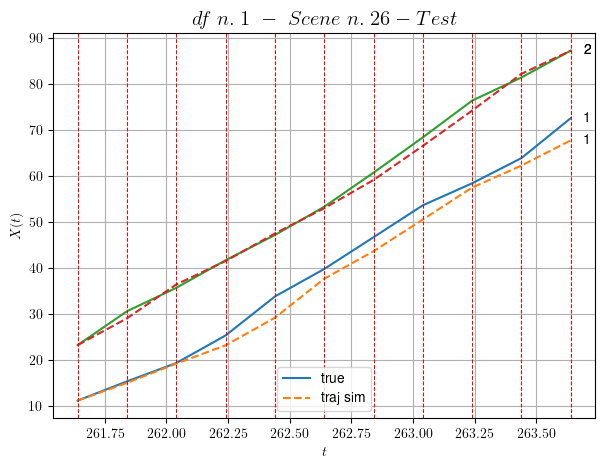

        For scene 26/36:
        * MSE = 4.131400746142191
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/36


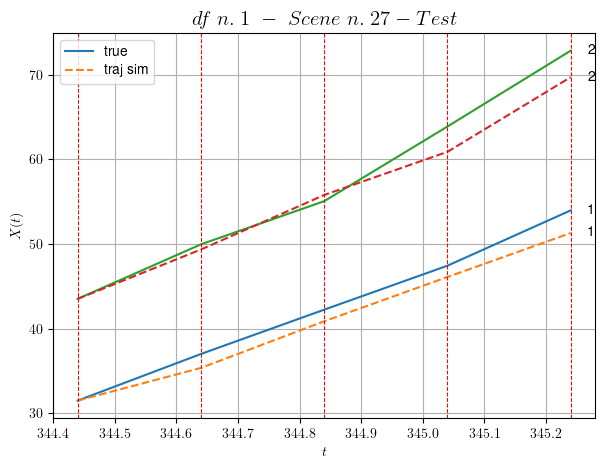

        For scene 27/36:
        * MSE = 3.3175303159946963
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/36


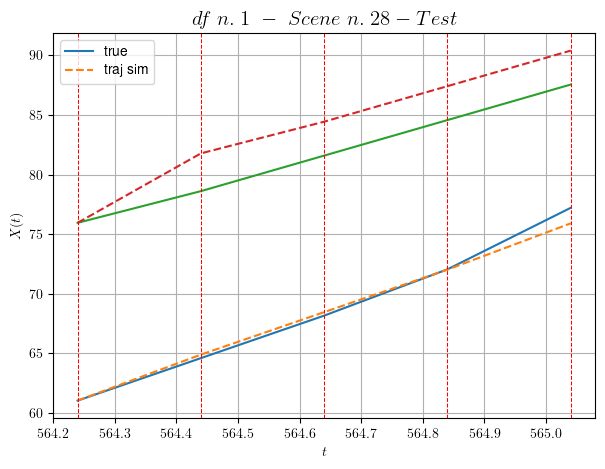

        For scene 28/36:
        * MSE = 3.6236503255596357
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/36


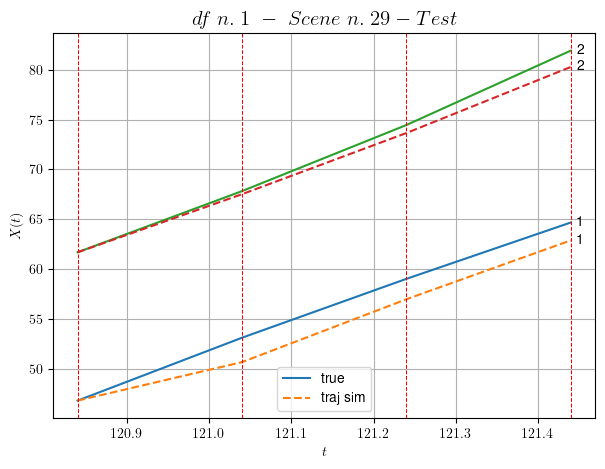

        For scene 29/36:
        * MSE = 2.104647032819816
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/36


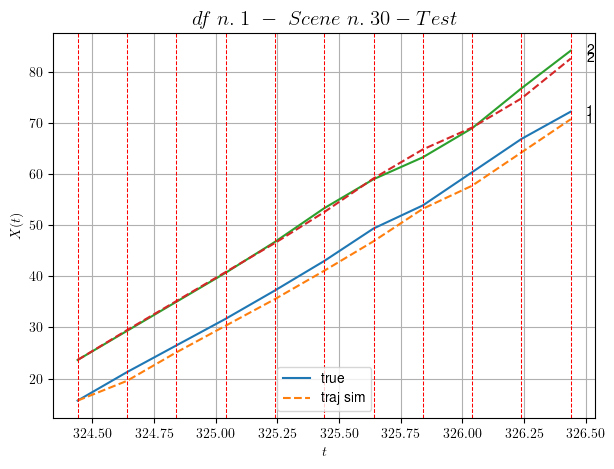

        For scene 30/36:
        * MSE = 2.0615467527539066
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/36


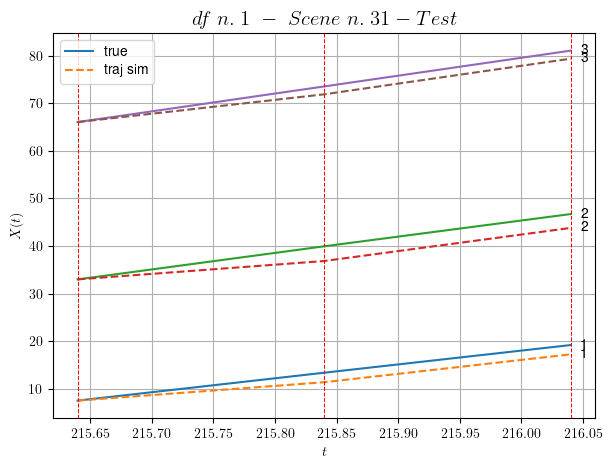

        For scene 31/36:
        * MSE = 3.487933452539225
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/36


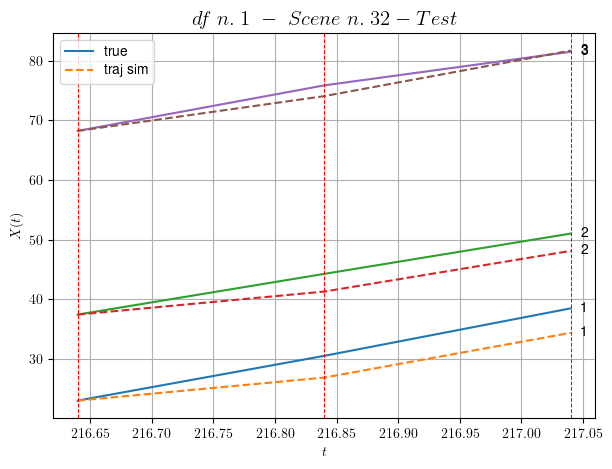

        For scene 32/36:
        * MSE = 5.6252267143055406
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/36


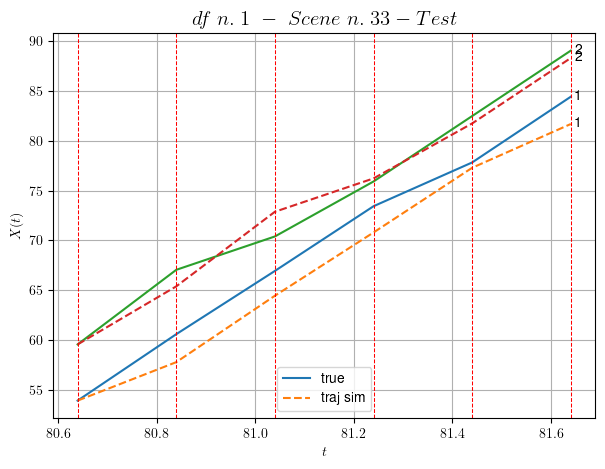

        For scene 33/36:
        * MSE = 3.2437066355277655
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/36


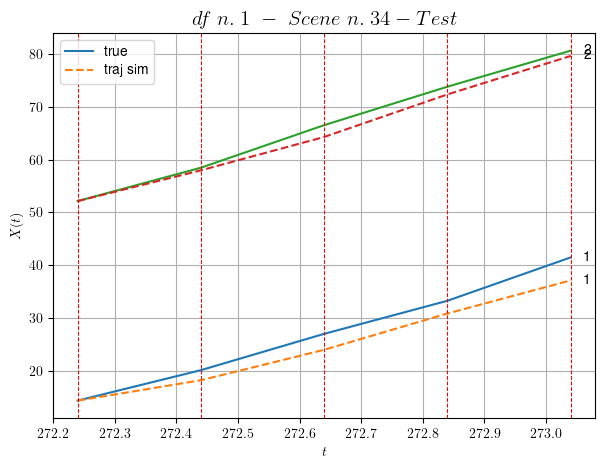

        For scene 34/36:
        * MSE = 4.606075326136491
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/36


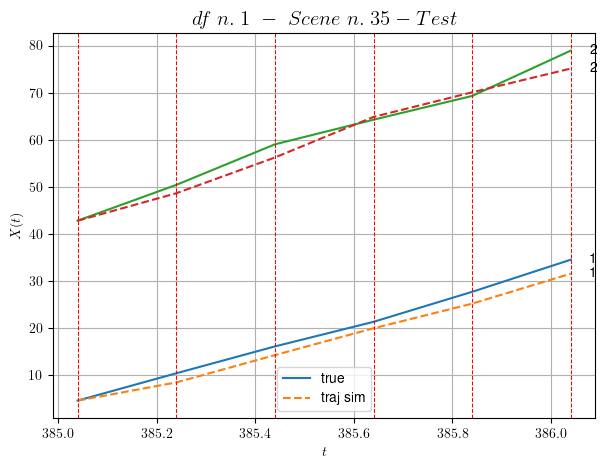

        For scene 35/36:
        * MSE = 4.230423905063709
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/36


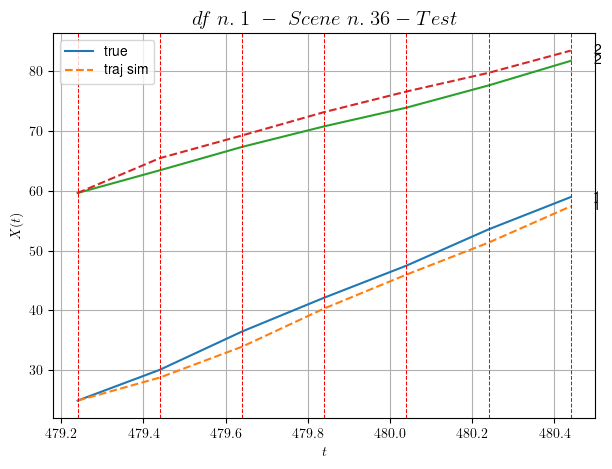

        For scene 36/36:
        * MSE = 3.510713521165519
----------------------------------------------------------------------------------------------------


MSE test: 3.221423215223332

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6118541098151932
          * MSE test: 3.221423215223332
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.2. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [292.96,293.56]


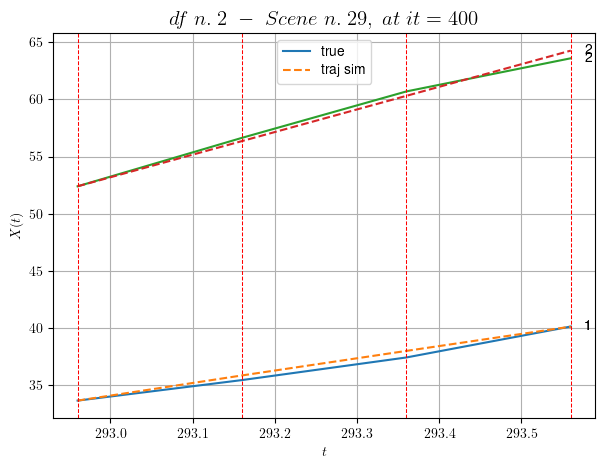

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.005 with mse=7.998869239710304 at it=24
        * v0 = 19.771247188441382
        * MSE = 0.1452363035629341
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [84.96,85.96]


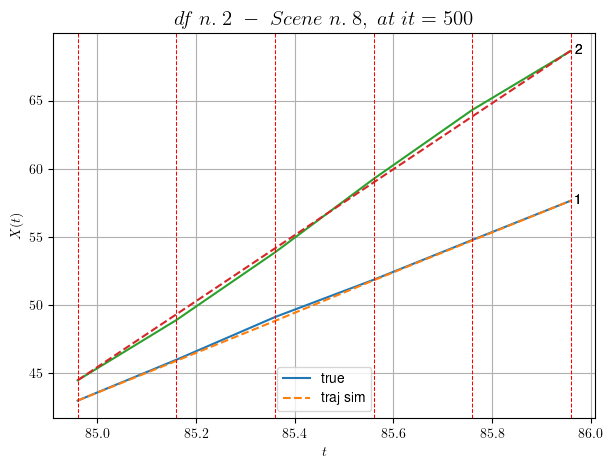

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.01 with mse=5.987005910705949 at it=24
        * v0 = 24.168678500842805
        * MSE = 0.051026253088369625
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.56,487.96]


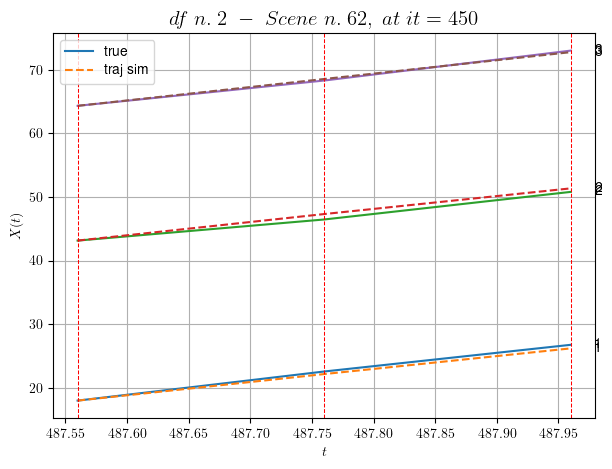

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.01 with mse=1.8615226708863692 at it=24
        * v0 = 21.111902026176693
        * MSE = 0.18090213398930965
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [440.16,441.36]


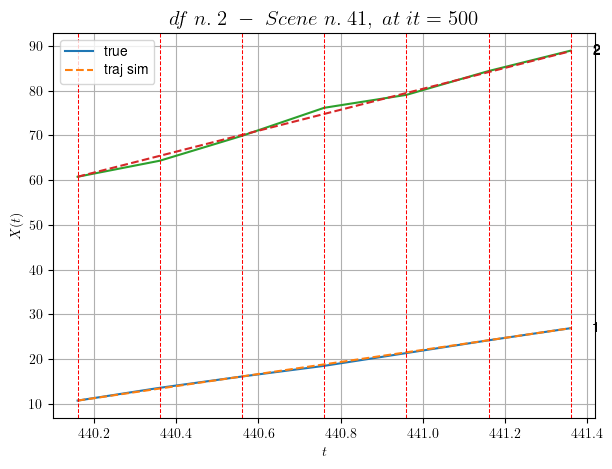

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.001 with mse=11.115857702901902 at it=24
        * v0 = 23.380815312671142
        * MSE = 0.24669262960935986
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [588.96,589.36]


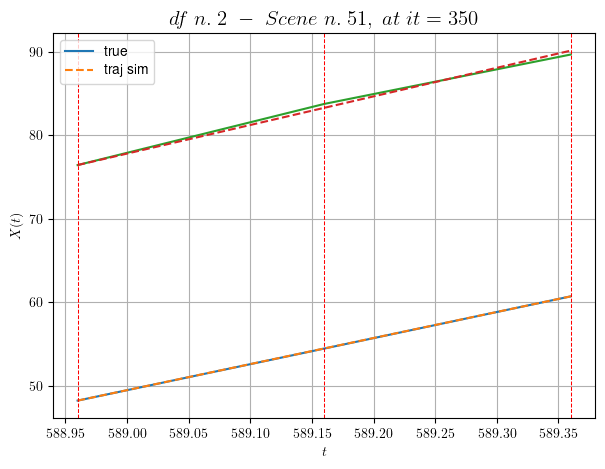

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.005 with mse=0.5352460644137892 at it=24
        * v0 = 34.221109619098584
        * MSE = 0.06538874549916877
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.96,531.36]


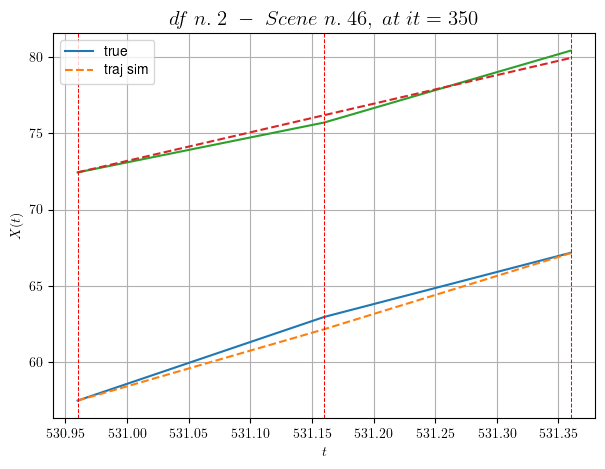

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.005 with mse=4.032173530131549 at it=24
        * v0 = 18.785408511488363
        * MSE = 0.18615166430919744
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [220.36,221.16]


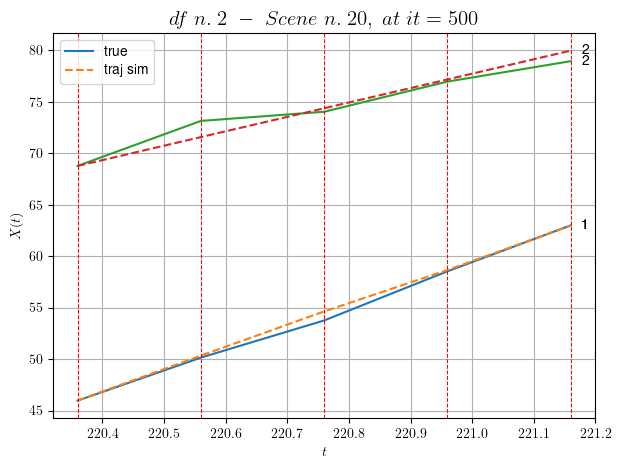

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.01 with mse=33.63424889567097 at it=24
        * v0 = 13.996427133410021
        * MSE = 0.44891877732478797
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.76,200.16]


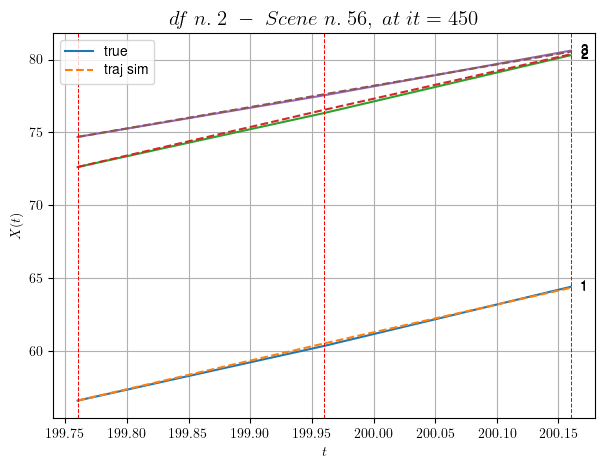

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.01 with mse=5.2413312442566635 at it=24
        * v0 = 14.651673034686215
        * MSE = 0.010242355238546387
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [428.56,429.76]


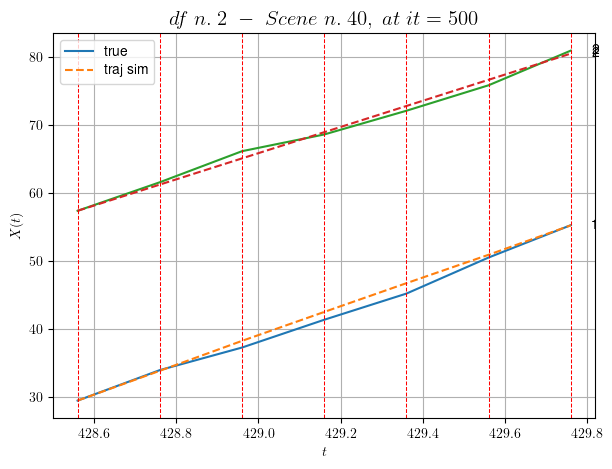

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.005 with mse=31.14218429830506 at it=24
        * v0 = 19.277810356522565
        * MSE = 0.5332718945344868
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [256.56,258.16]


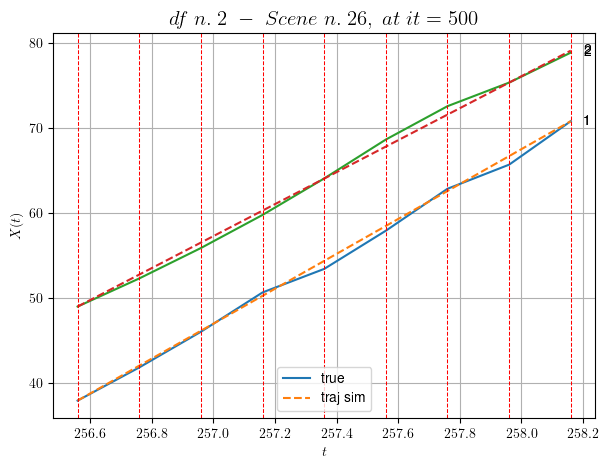

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.0001 with mse=55.63935798896484 at it=24
        * v0 = 18.832978045462383
        * MSE = 0.28008549416715495
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [413.96,414.56]


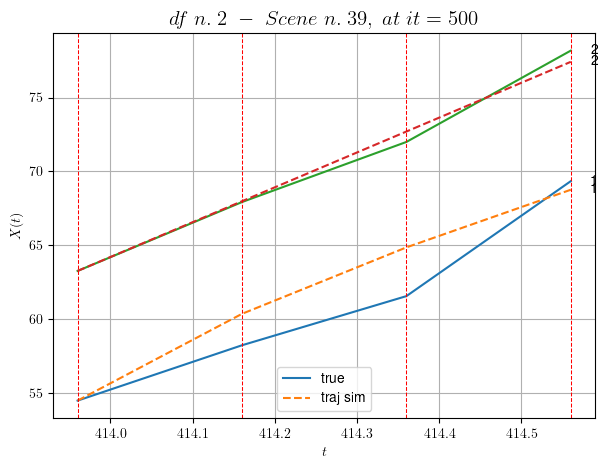

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.01 with mse=5.3785288248494965 at it=24
        * v0 = 23.61552454291822
        * MSE = 2.0436024086130566
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.96,184.56]


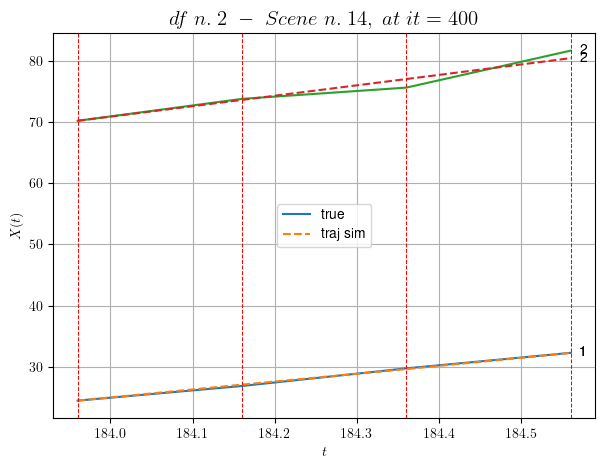

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.01 with mse=11.504622202031701 at it=24
        * v0 = 17.0518109253687
        * MSE = 0.4371676283240855
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [576.56,576.96]


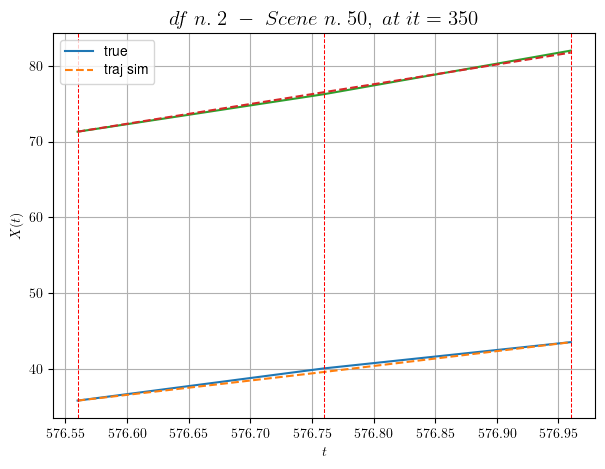

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.005 with mse=0.5097872755623978 at it=24
        * v0 = 26.06956916115639
        * MSE = 0.060165109119719264
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [54.56,55.36]


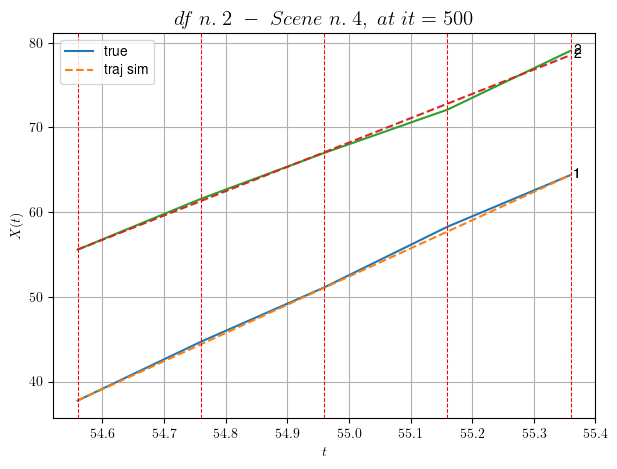

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.001 with mse=0.3746372725952789 at it=24
        * v0 = 28.716321309649988
        * MSE = 0.12575776596879706
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [215.36,215.96]


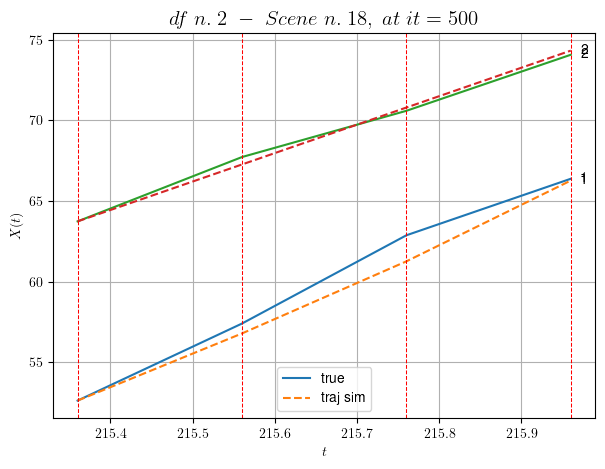

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.01 with mse=12.050001657557724 at it=24
        * v0 = 17.643232536852395
        * MSE = 0.41478189437591595
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [96.36,96.76]


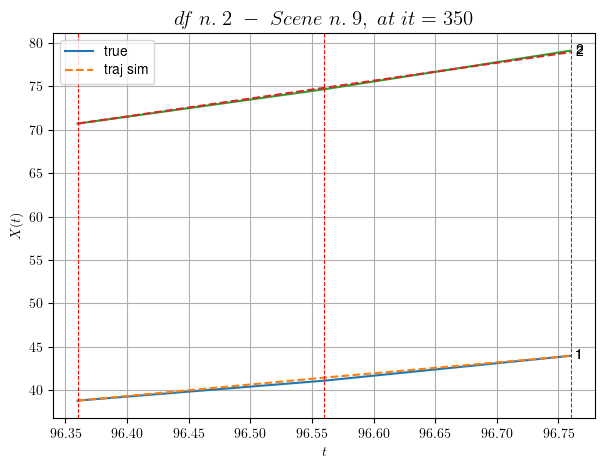

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.01 with mse=2.897036681383129 at it=24
        * v0 = 20.598848373580655
        * MSE = 0.029805010919187087
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [179.36,180.16]


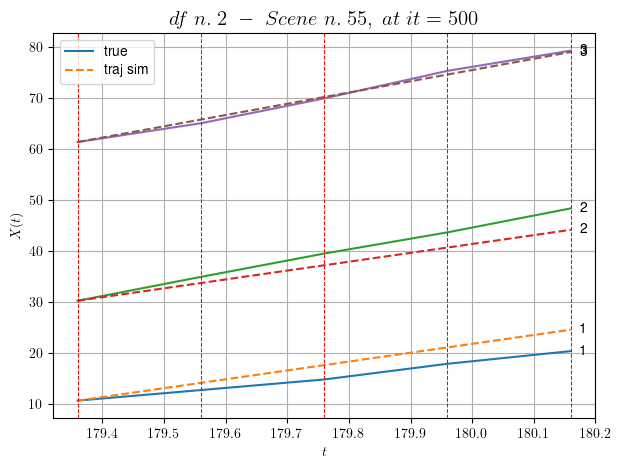

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.001 with mse=9.428361887976502 at it=24
        * v0 = 22.081999529879255
        * MSE = 4.8253062642578195
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [77.56,78.76]


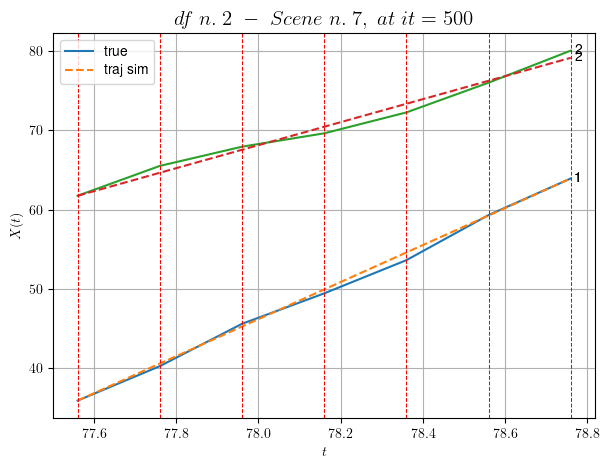

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=63.03011301670186 at it=24
        * v0 = 14.529876108312951
        * MSE = 0.36231676078465036
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [399.56,400.56]


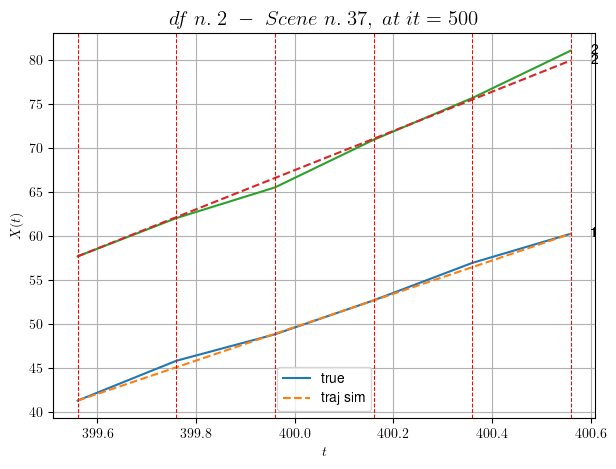

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.001 with mse=10.247798612469536 at it=24
        * v0 = 22.28590148402904
        * MSE = 0.2528750932127019
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [538.36,539.16]


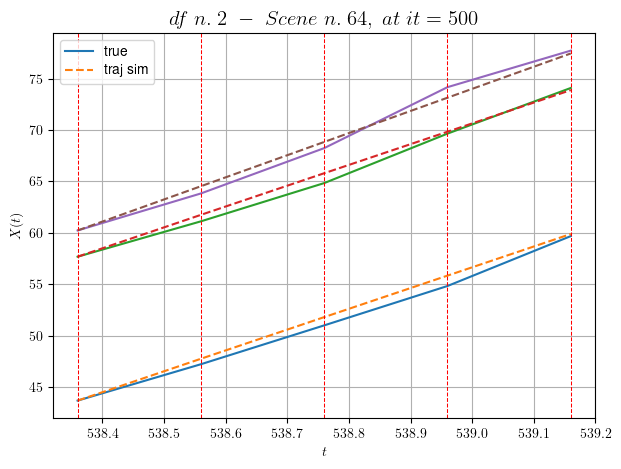

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.001 with mse=5.660382861189427 at it=24
        * v0 = 21.518869344523594
        * MSE = 0.35215915233465706
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [87.56,88.16]


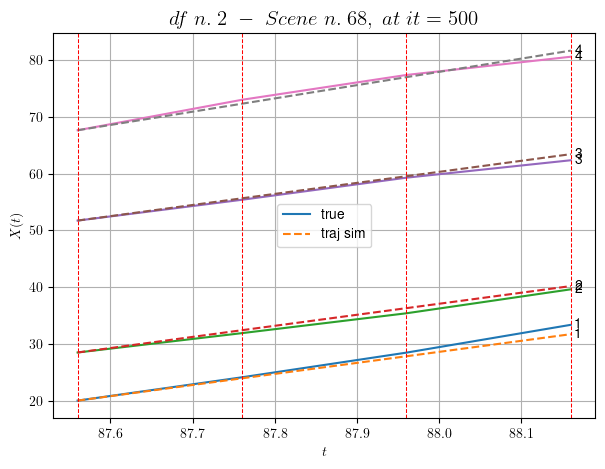

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.005 with mse=2.3075754926378917 at it=24
        * v0 = 23.39910333176453
        * MSE = 0.478412010353015
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [208.96,209.36]


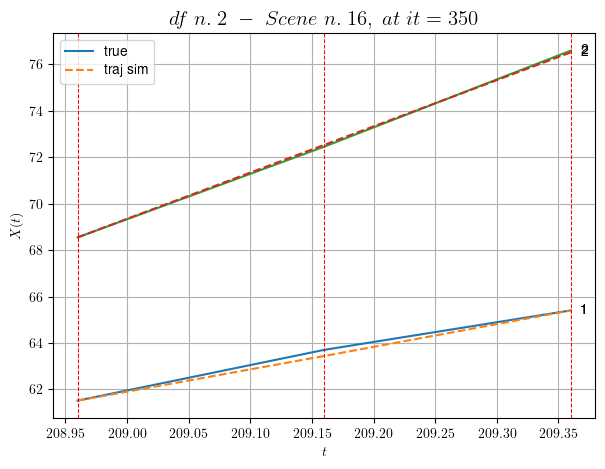

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.005 with mse=3.3491167944215365 at it=24
        * v0 = 19.925309783508897
        * MSE = 0.013561509110970735
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [287.36,287.96]


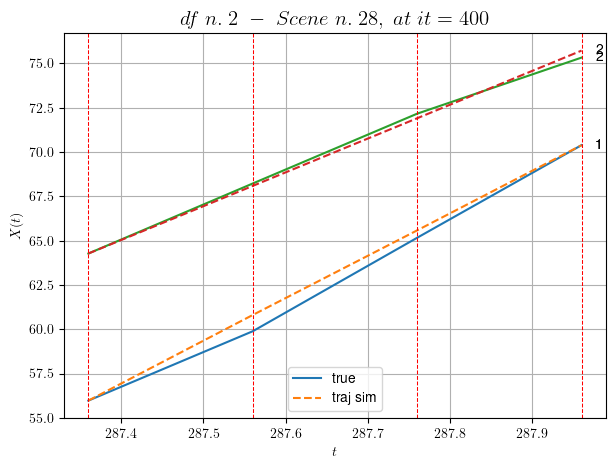

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.001 with mse=8.81543187194702 at it=24
        * v0 = 19.08174410837759
        * MSE = 0.15671075473311705
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [442.36,443.76]


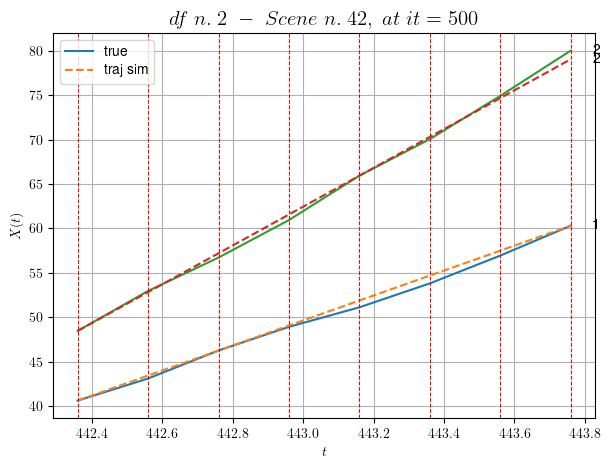

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.001 with mse=22.572127418796644 at it=24
        * v0 = 21.85795817065097
        * MSE = 0.21485890700970678
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [275.56,275.96]


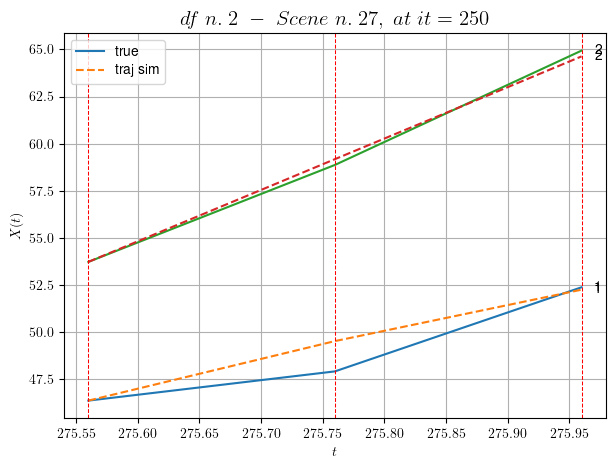

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.005 with mse=0.7012648972788527 at it=24
        * v0 = 27.245156650418213
        * MSE = 0.4494295183940973
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [557.96,559.16]


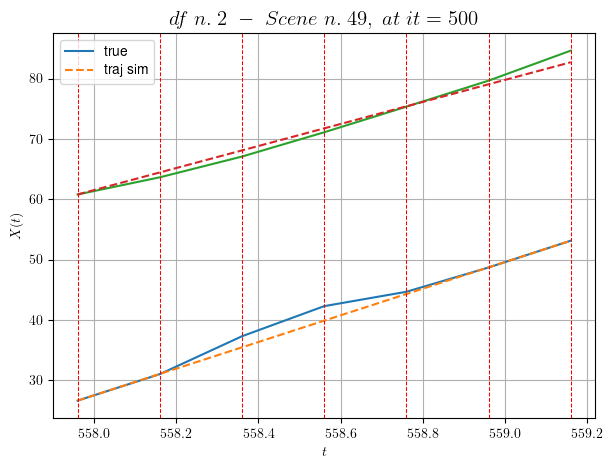

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=5e-05 with mse=33.51054062460291 at it=24
        * v0 = 18.265989604983947
        * MSE = 1.1077637521096177
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [253.96,254.56]


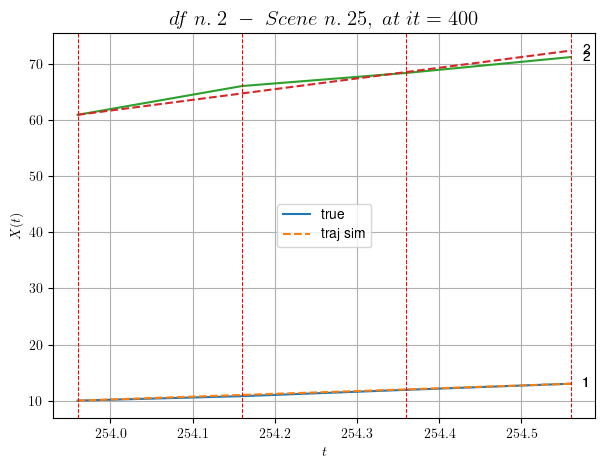

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.01 with mse=10.118756696235446 at it=24
        * v0 = 19.059884323268093
        * MSE = 0.3918412729185317
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [430.16,430.96]


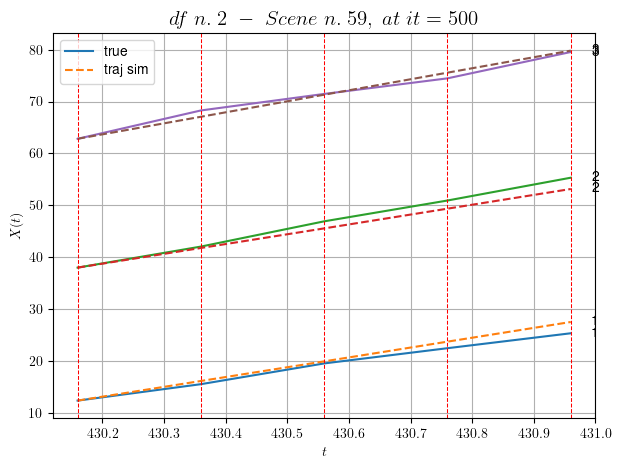

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.001 with mse=8.068530730547076 at it=24
        * v0 = 21.23690274072178
        * MSE = 1.2497637069766234
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.76,532.76]


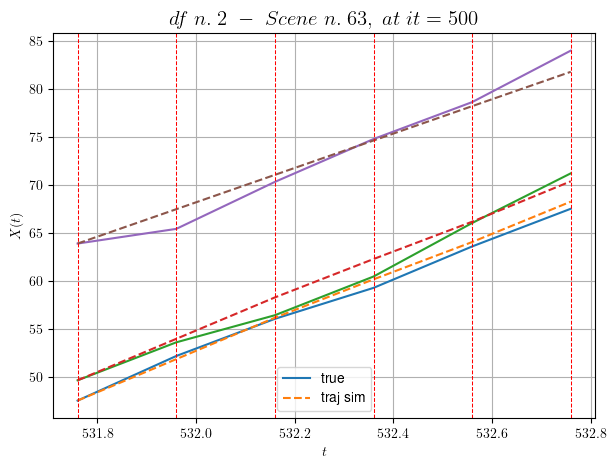

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.01 with mse=16.283511435106732 at it=24
        * v0 = 17.911731328080485
        * MSE = 0.9947767751713608
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [145.16,145.56]


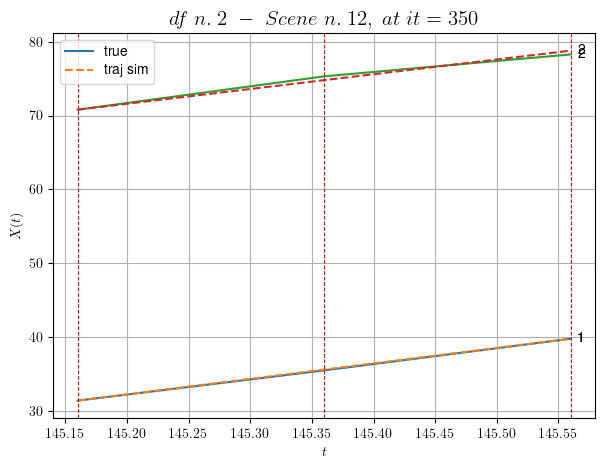

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=0.005 with mse=3.767901992397168 at it=24
        * v0 = 20.018762484246484
        * MSE = 0.09115991531663234
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [358.16,358.76]


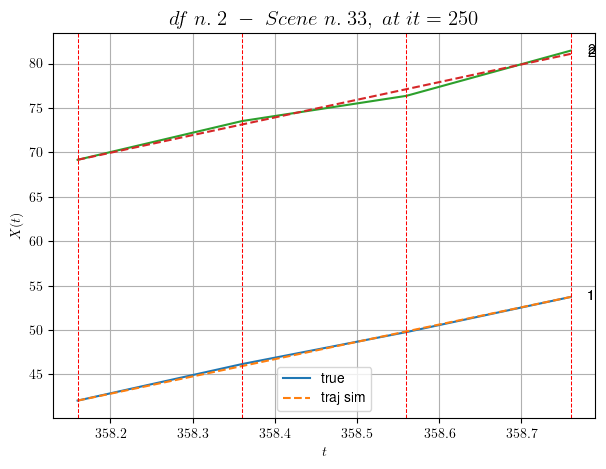

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.001 with mse=7.296676781472291 at it=24
        * v0 = 19.877126560272018
        * MSE = 0.11247670514397075
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [549.76,550.16]


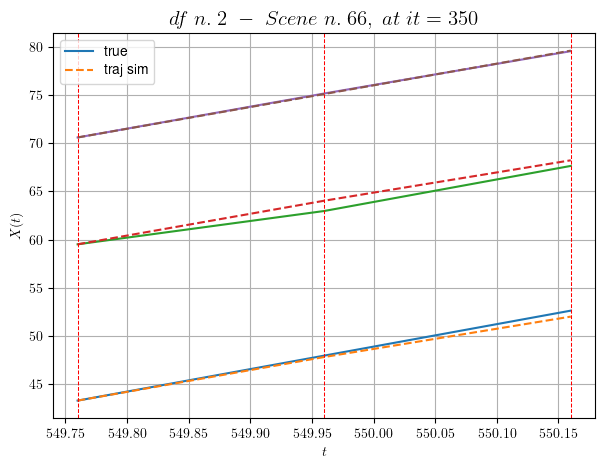

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.01 with mse=1.492410712988037 at it=24
        * v0 = 22.49577375007734
        * MSE = 0.2089988058263926
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [566.76,567.16]


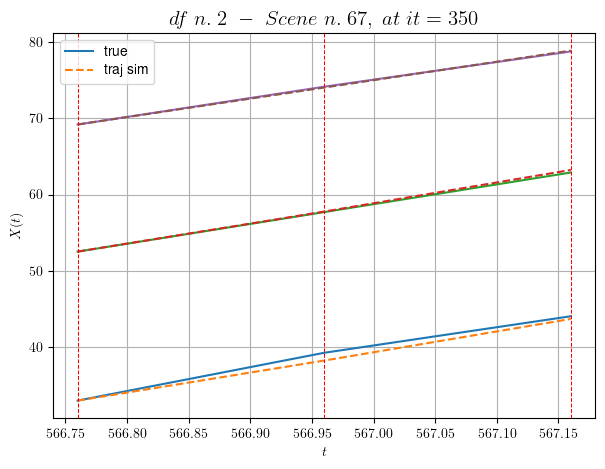

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.005 with mse=1.911338471689838 at it=24
        * v0 = 24.222562138247913
        * MSE = 0.14511664013887934
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [411.36,412.16]


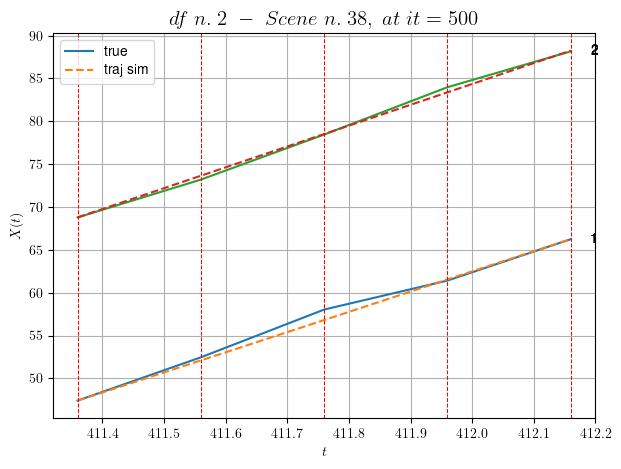

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.001 with mse=3.888396012188833 at it=24
        * v0 = 24.337743181531323
        * MSE = 0.22127478703717637
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [314.96,315.36]


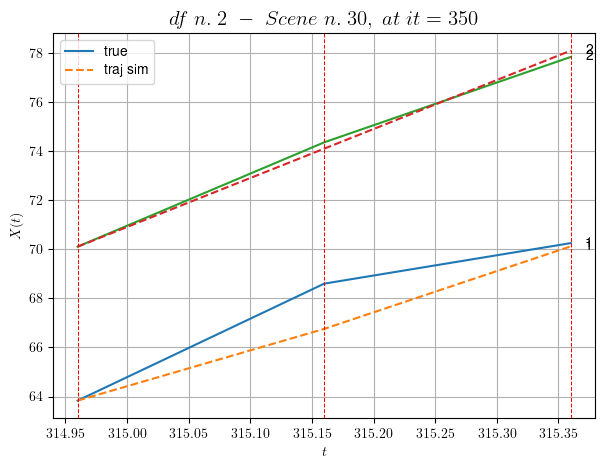

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.005 with mse=4.392777997967208 at it=24
        * v0 = 19.975403170578783
        * MSE = 0.5913835172312705
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [494.76,495.36]


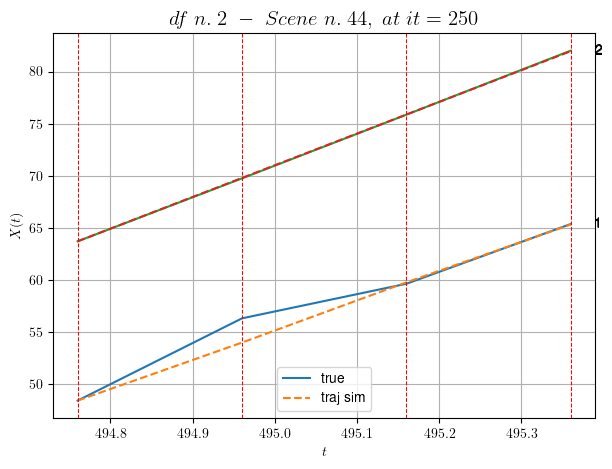

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.001 with mse=0.8869211312178463 at it=24
        * v0 = 30.44297860661074
        * MSE = 0.6738372153454125
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.16,542.36]


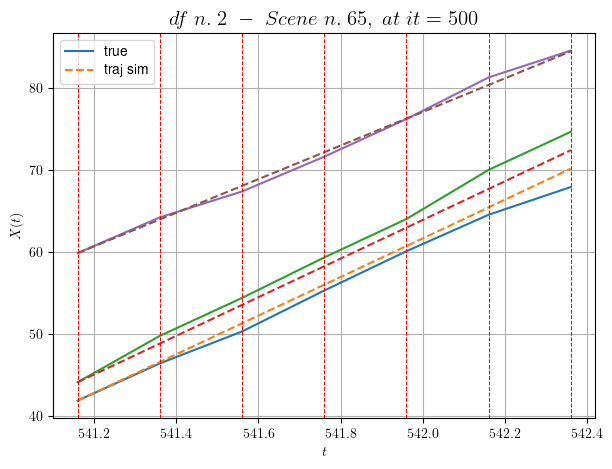

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.001 with mse=16.62464306389241 at it=24
        * v0 = 20.489990975467244
        * MSE = 1.1331591784693227
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [14.76,15.36]


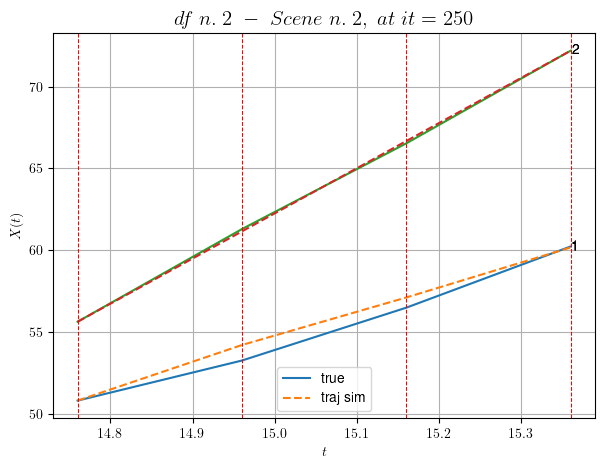

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.01 with mse=0.6226107167820243 at it=24
        * v0 = 27.61541285869292
        * MSE = 0.16010980513142117
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [109.36,110.16]


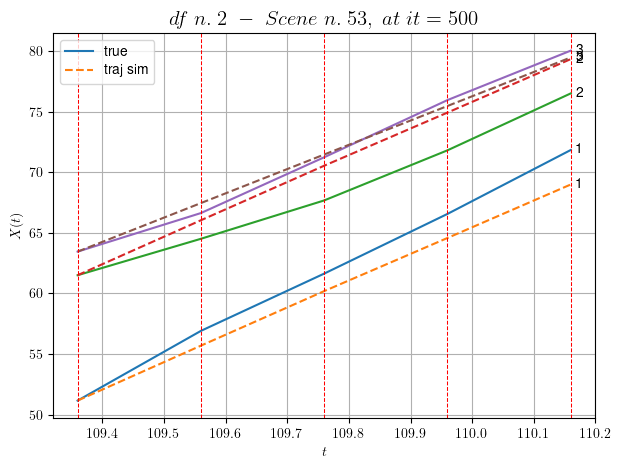

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.005 with mse=10.40198111916601 at it=24
        * v0 = 20.03385870433133
        * MSE = 3.009645008784894
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [233.36,235.36]


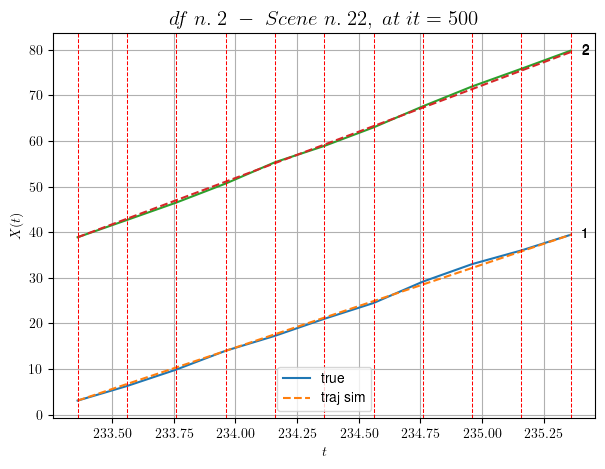

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.0005 with mse=64.52884711520913 at it=24
        * v0 = 20.300783427084454
        * MSE = 0.14322205016139103
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


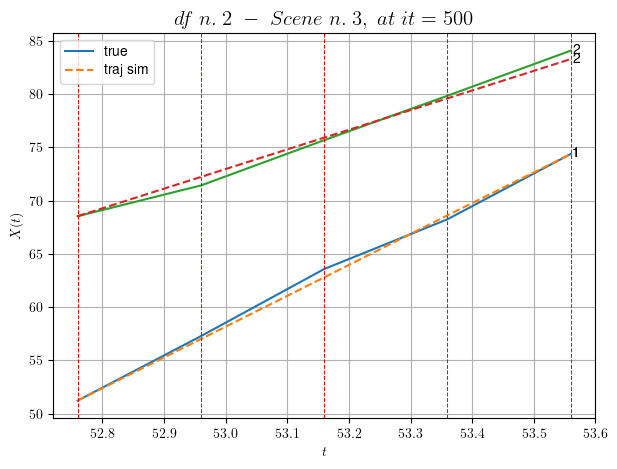

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.001 with mse=15.075752130001 at it=24
        * v0 = 18.43493729530437
        * MSE = 0.2014114479377241
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


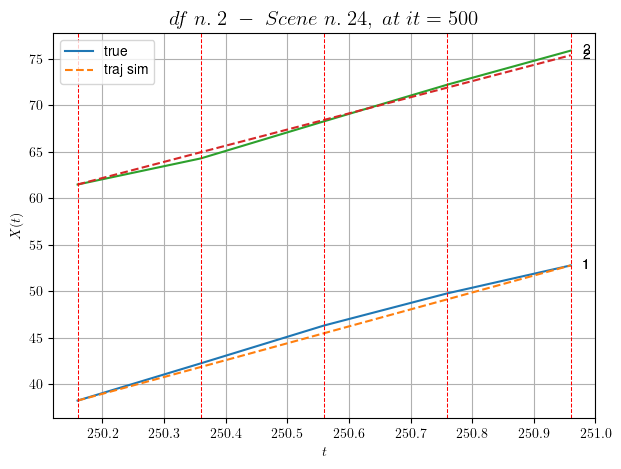

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.001 with mse=46.57576393466789 at it=24
        * v0 = 17.364515373912894
        * MSE = 0.19790452294767913
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


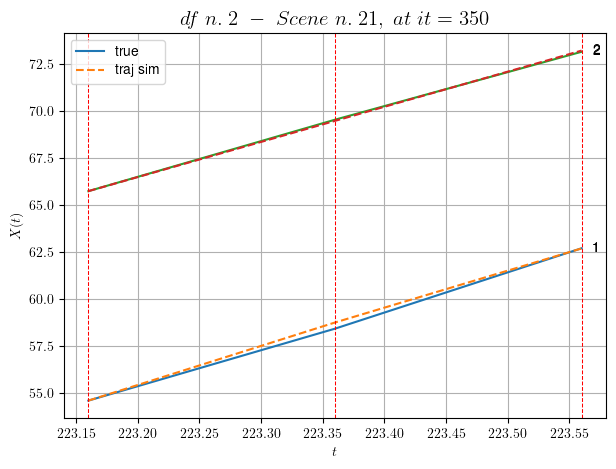

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.01 with mse=4.370527618846645 at it=24
        * v0 = 18.698370395222728
        * MSE = 0.01929097566320877
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


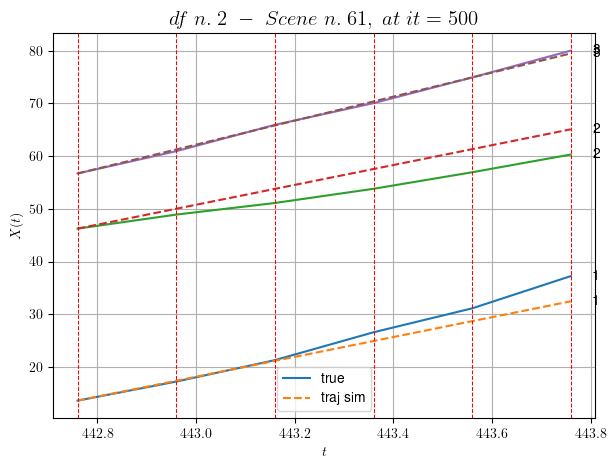

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.0001 with mse=8.549715014314238 at it=24
        * v0 = 22.775896802505347
        * MSE = 5.367453488598803
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


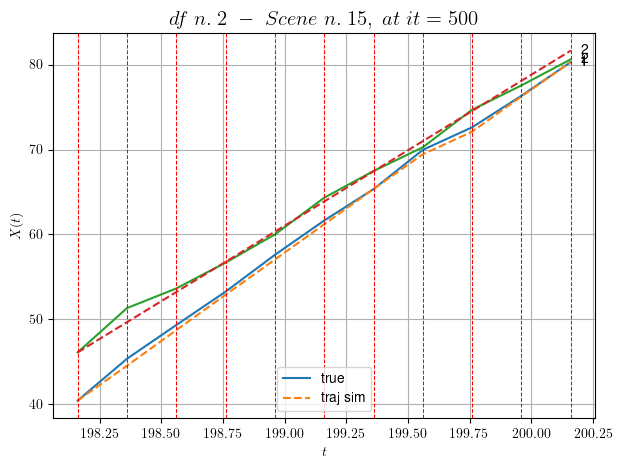

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.01 with mse=108.78687360662569 at it=24
        * v0 = 17.75627925151298
        * MSE = 0.30559847218405145
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


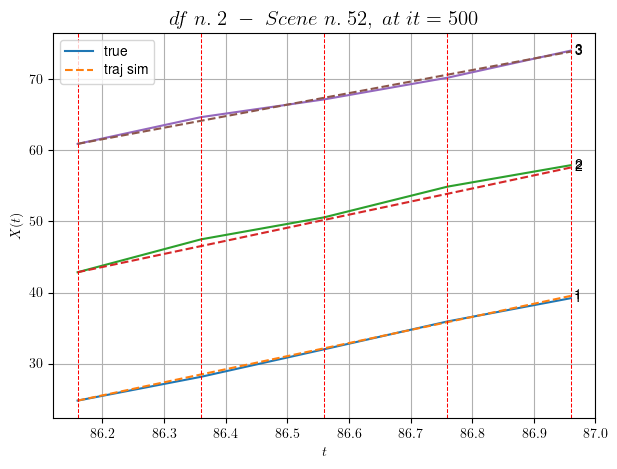

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.001 with mse=15.609235586169882 at it=24
        * v0 = 16.23533006014594
        * MSE = 0.19431663029711288
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6279419720049192
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.2. Scene n.1/23


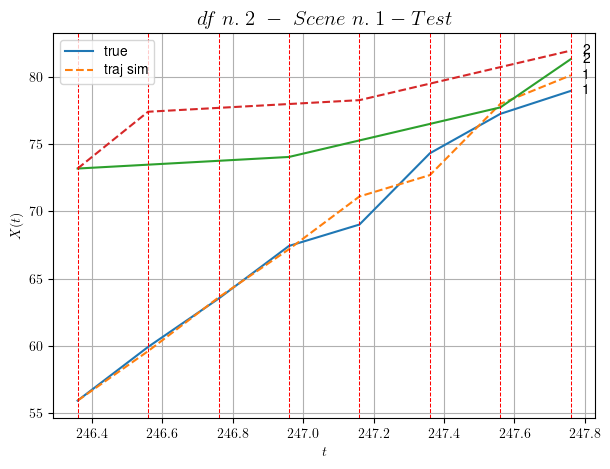

        For scene 1/23:
        * MSE = 5.17776956883432
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/23


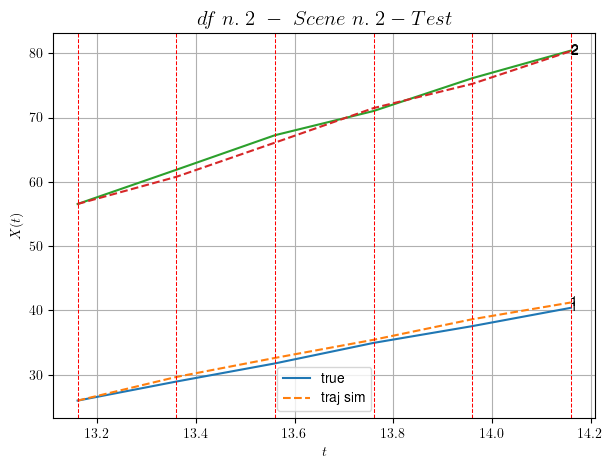

        For scene 2/23:
        * MSE = 0.5684586868161023
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/23


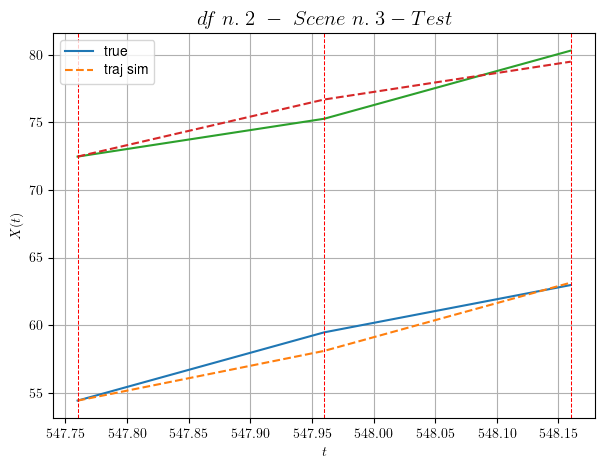

        For scene 3/23:
        * MSE = 0.7680662571045638
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/23


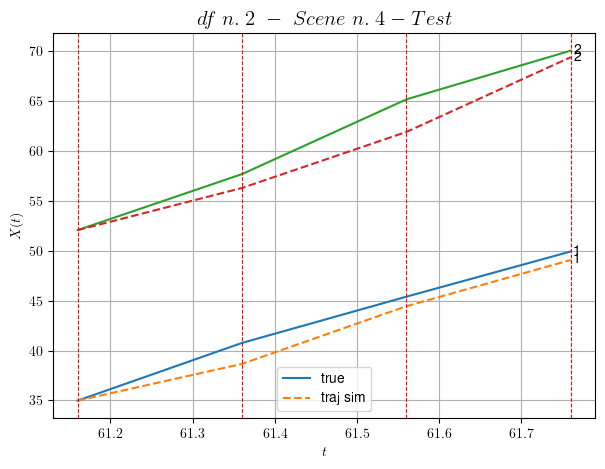

        For scene 4/23:
        * MSE = 2.384188257757011
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/23


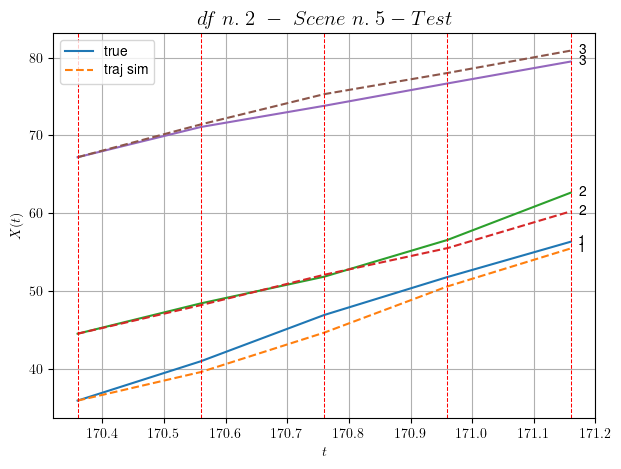

        For scene 5/23:
        * MSE = 1.4956873882964459
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/23


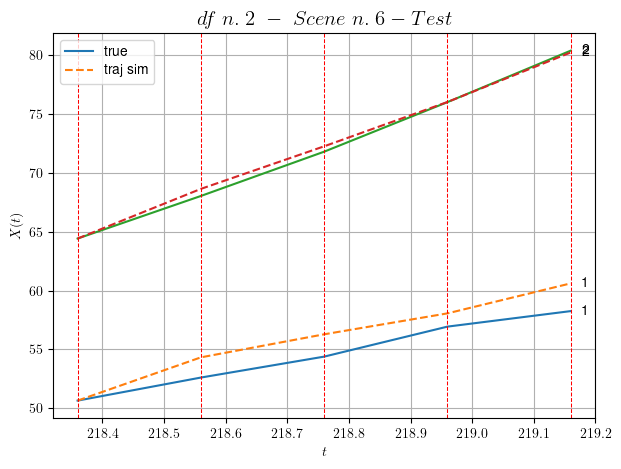

        For scene 6/23:
        * MSE = 1.3978215695167389
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/23


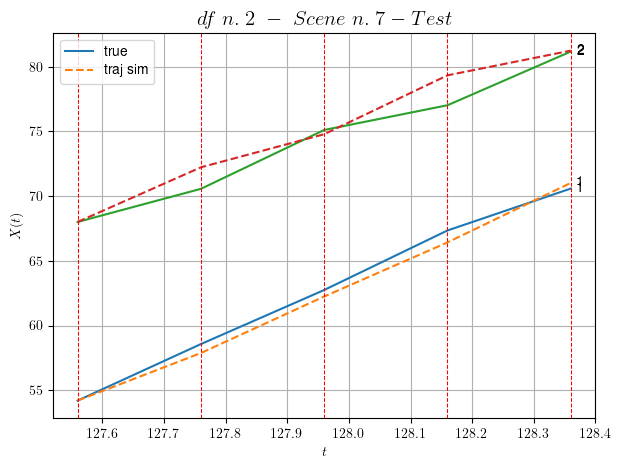

        For scene 7/23:
        * MSE = 1.0003530781031515
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/23


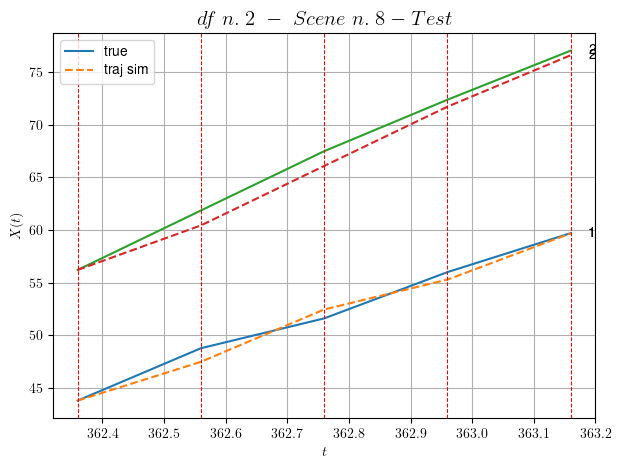

        For scene 8/23:
        * MSE = 0.7487102277317091
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/23


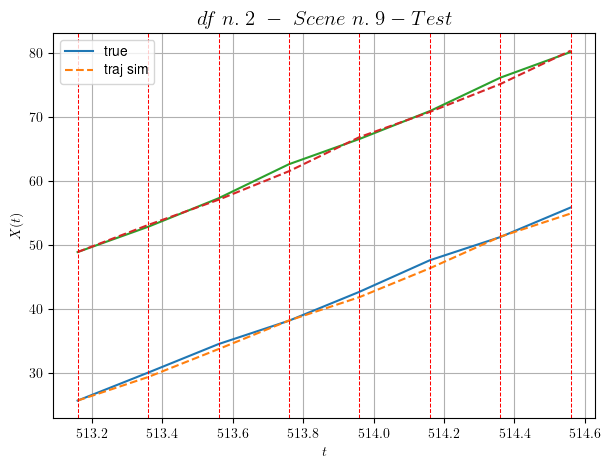

        For scene 9/23:
        * MSE = 0.41890349533206755
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/23


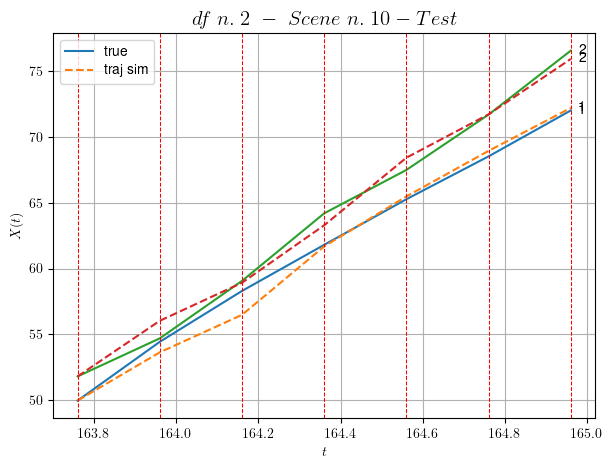

        For scene 10/23:
        * MSE = 0.5784742355365687
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/23


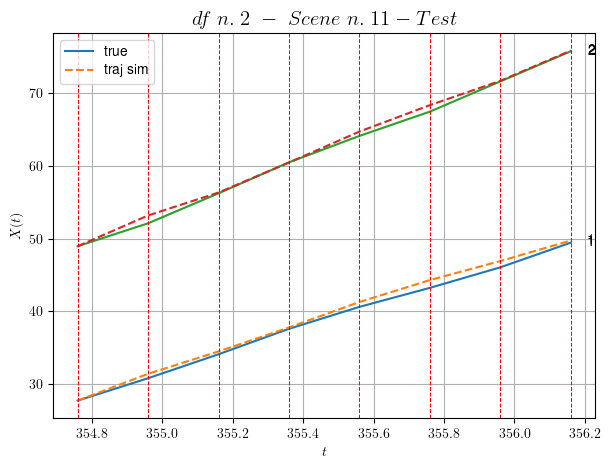

        For scene 11/23:
        * MSE = 0.3308369148517296
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/23


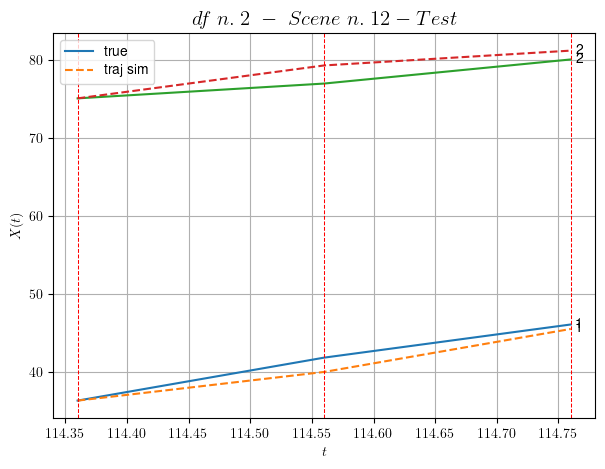

        For scene 12/23:
        * MSE = 1.7288827085657137
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/23


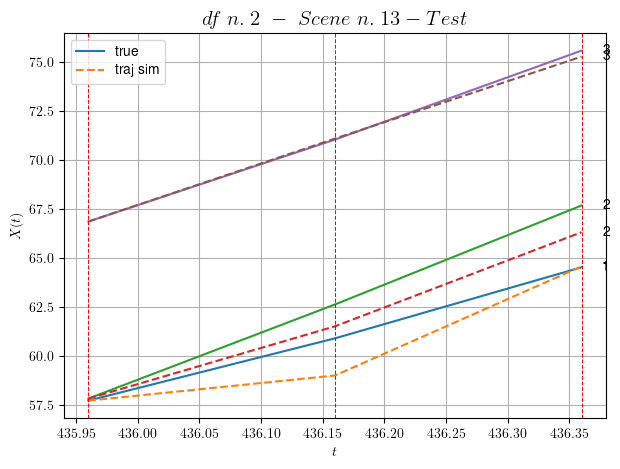

        For scene 13/23:
        * MSE = 0.7518077601418942
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/23


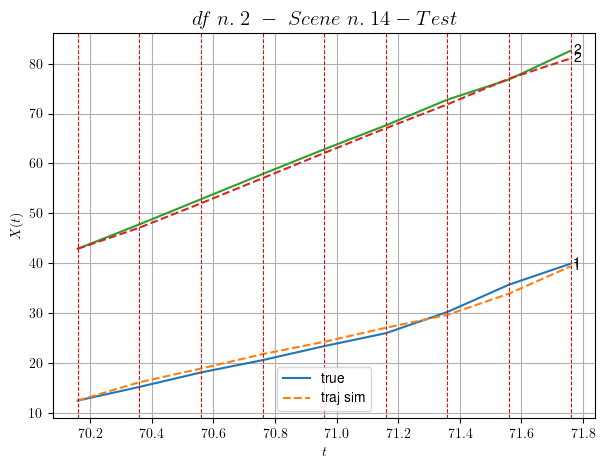

        For scene 14/23:
        * MSE = 0.8178743431710063
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/23


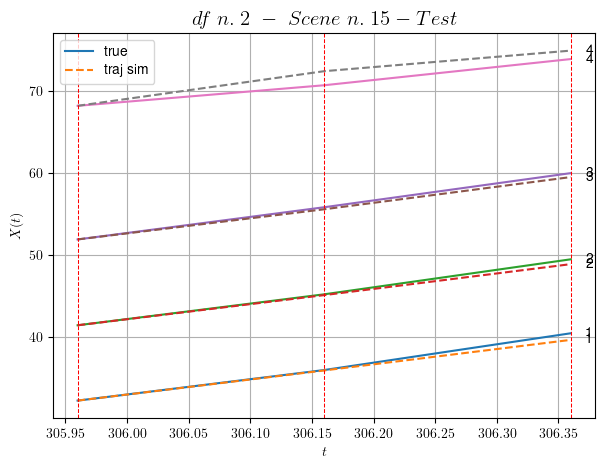

        For scene 15/23:
        * MSE = 0.4421349712030213
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/23


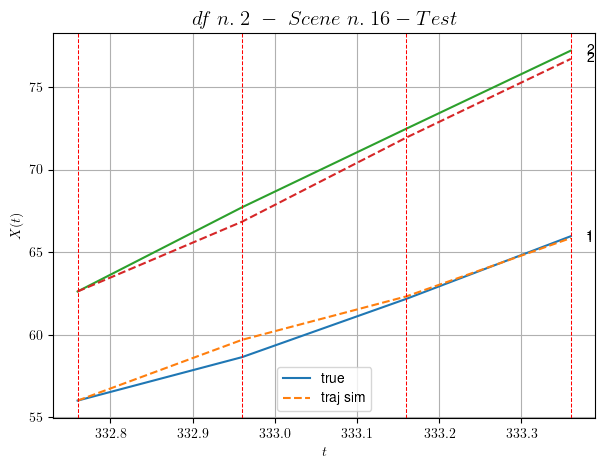

        For scene 16/23:
        * MSE = 0.3037852906800915
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/23


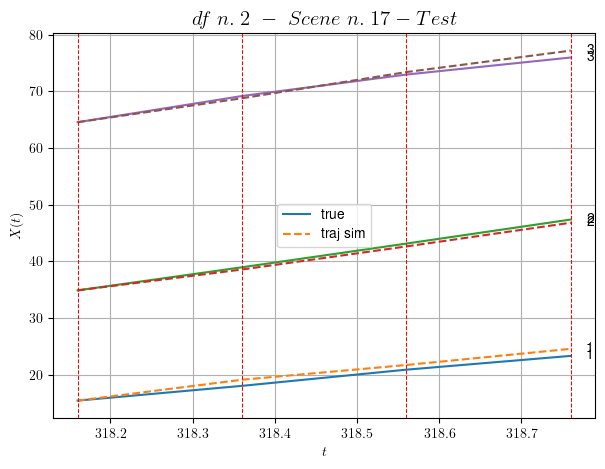

        For scene 17/23:
        * MSE = 0.49444087126704056
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/23


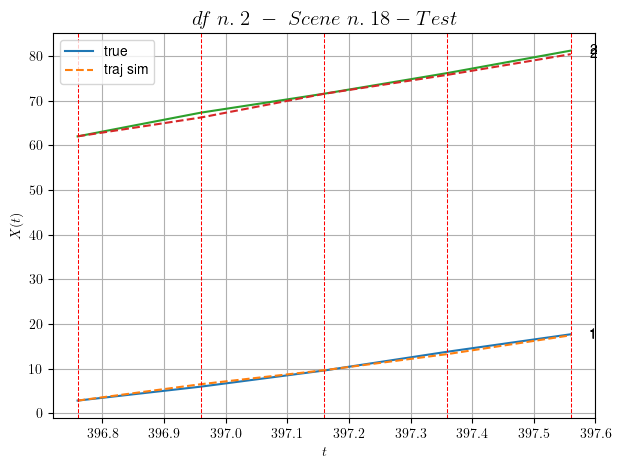

        For scene 18/23:
        * MSE = 0.2621977955550128
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/23


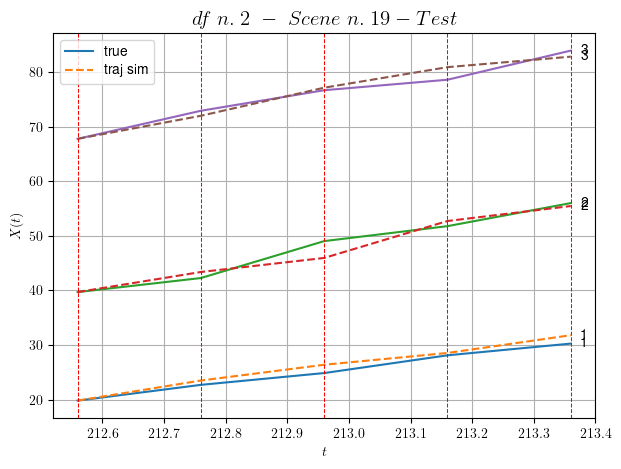

        For scene 19/23:
        * MSE = 1.6637019061023448
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/23


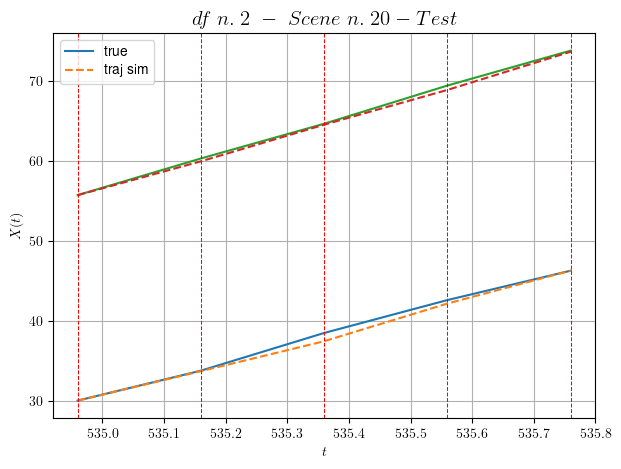

        For scene 20/23:
        * MSE = 0.17158360324276722
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/23


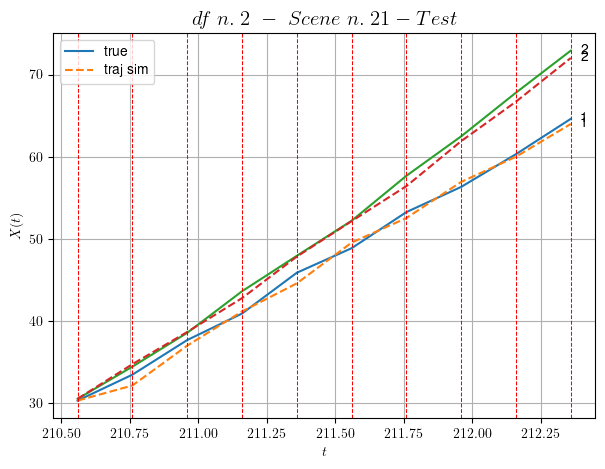

        For scene 21/23:
        * MSE = 0.5264361672901791
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/23


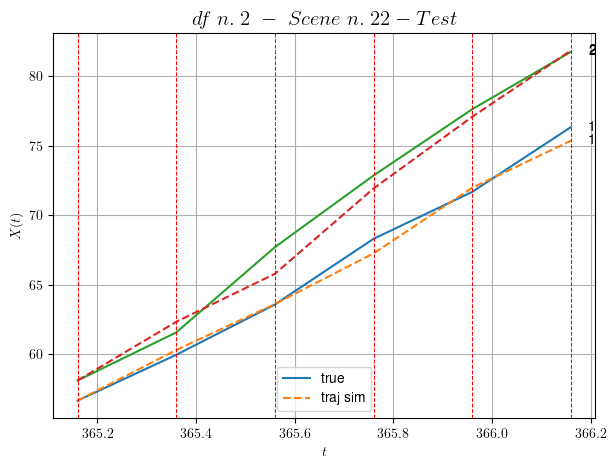

        For scene 22/23:
        * MSE = 0.643797060537018
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/23


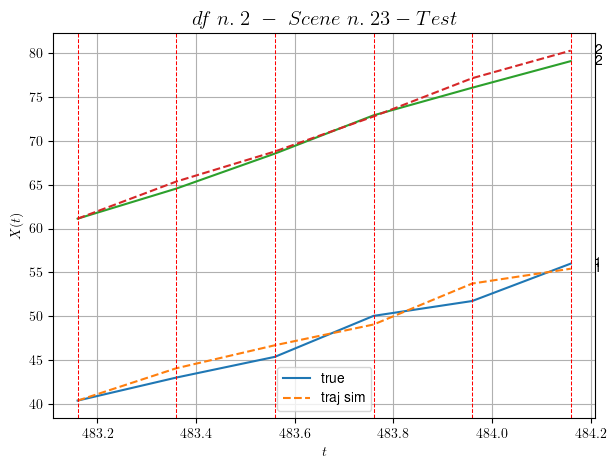

        For scene 23/23:
        * MSE = 0.9519444876266927
----------------------------------------------------------------------------------------------------


MSE test: 1.027298115011443

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6279419720049192
          * MSE test: 1.027298115011443
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 60 scenes, the remaining 30 to test the model.

Training step. (60 scenes)
DataFrame n.3. Scene n.1/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [215.56,216.36]


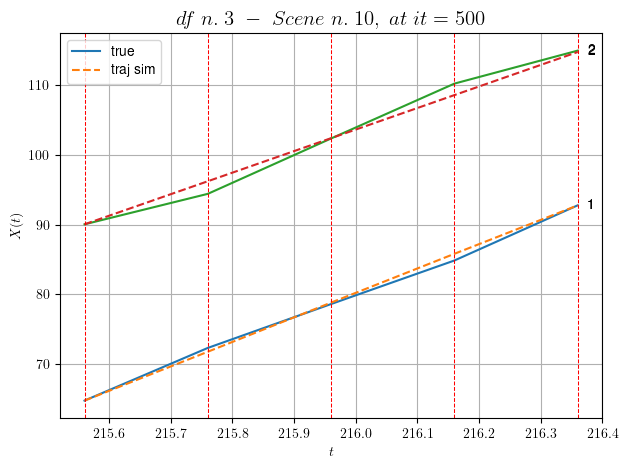

----------------------------------------------------------------------------------------------------
        For scene 1/60:
        * After LR finder: LR_NN=0.001 with mse=1.0295603829820532 at it=24
        * v0 = 30.842897264969384
        * MSE = 0.7248270537368722
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.16,487.56]


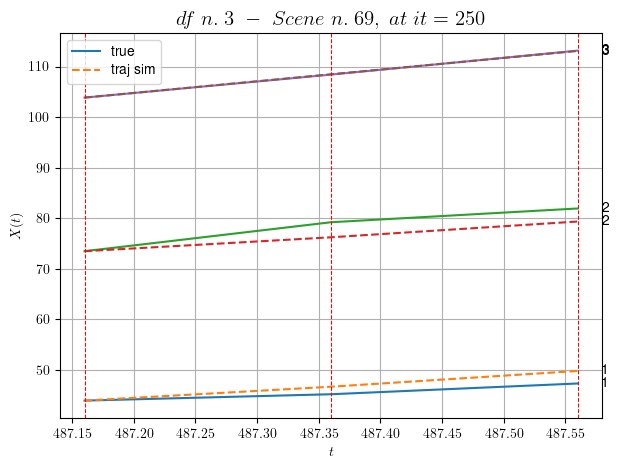

----------------------------------------------------------------------------------------------------
        For scene 2/60:
        * After LR finder: LR_NN=0.01 with mse=3.802698959366482 at it=24
        * v0 = 23.073325918701737
        * MSE = 2.6506848853007194
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/60
----------------------------------------------------------------------------------------------------
We have 17 time intervals inside [138.16,141.56]


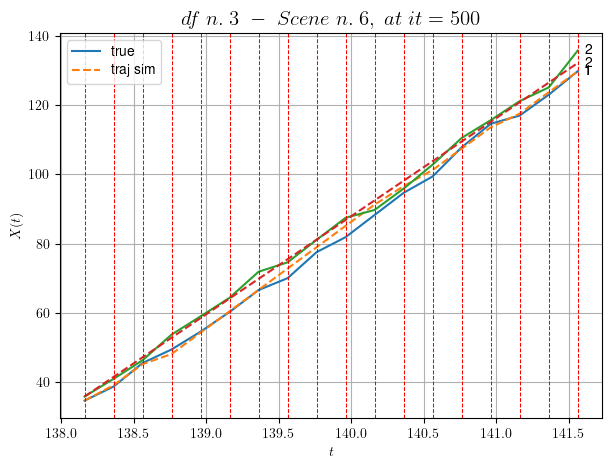

----------------------------------------------------------------------------------------------------
        For scene 3/60:
        * After LR finder: LR_NN=0.001 with mse=8.00377506197429 at it=24
        * v0 = 28.318639127967614
        * MSE = 1.8496709341528277
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [72.76,74.16]


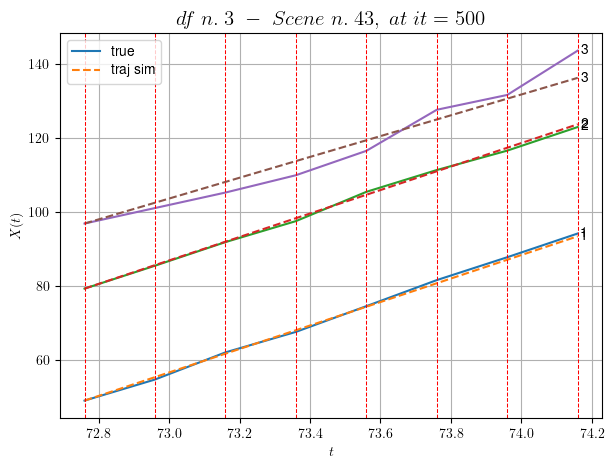

----------------------------------------------------------------------------------------------------
        For scene 4/60:
        * After LR finder: LR_NN=0.0005 with mse=3.756909650731789 at it=24
        * v0 = 28.121240263140283
        * MSE = 3.6901954865518234
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [143.76,144.36]


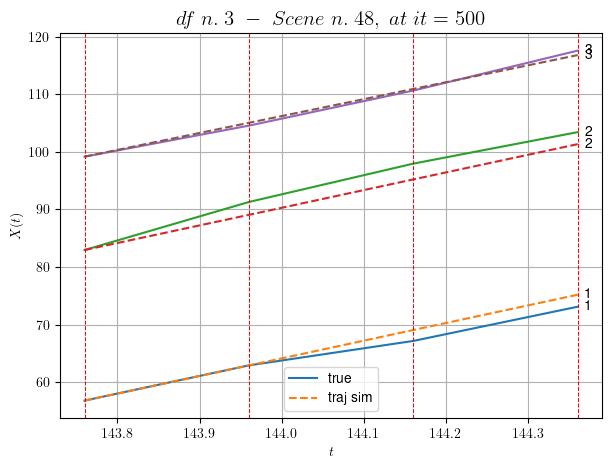

----------------------------------------------------------------------------------------------------
        For scene 5/60:
        * After LR finder: LR_NN=0.0005 with mse=2.261509072937478 at it=24
        * v0 = 29.41474446324747
        * MSE = 2.089939561956196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [338.36,338.96]


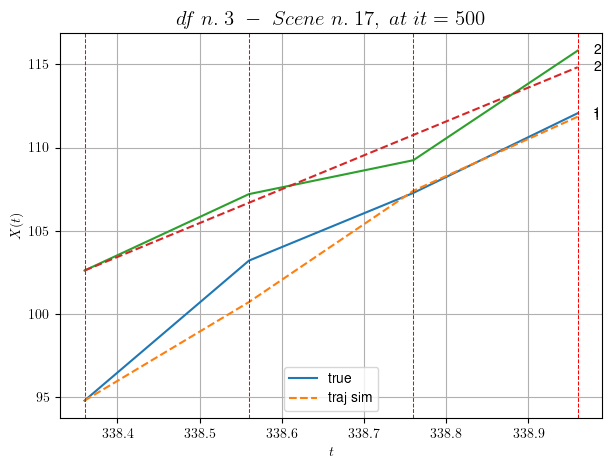

----------------------------------------------------------------------------------------------------
        For scene 6/60:
        * After LR finder: LR_NN=0.005 with mse=8.311958616369182 at it=24
        * v0 = 20.358070226672314
        * MSE = 1.2264554807398595
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [130.96,131.96]


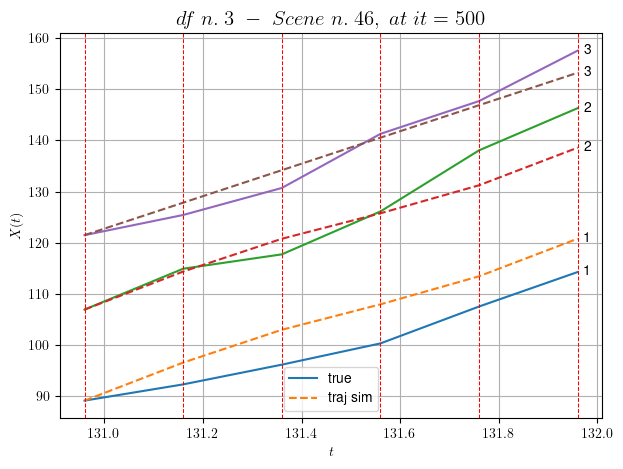

----------------------------------------------------------------------------------------------------
        For scene 7/60:
        * After LR finder: LR_NN=0.01 with mse=20.53989364700791 at it=24
        * v0 = 31.752337885123755
        * MSE = 17.9025010810703
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [590.36,591.76]


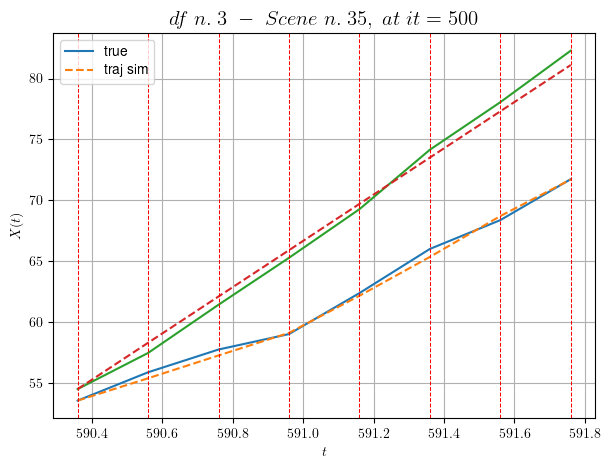

----------------------------------------------------------------------------------------------------
        For scene 8/60:
        * After LR finder: LR_NN=0.01 with mse=40.05061561365377 at it=24
        * v0 = 19.035476639426484
        * MSE = 0.3242841711063471
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.16,183.76]


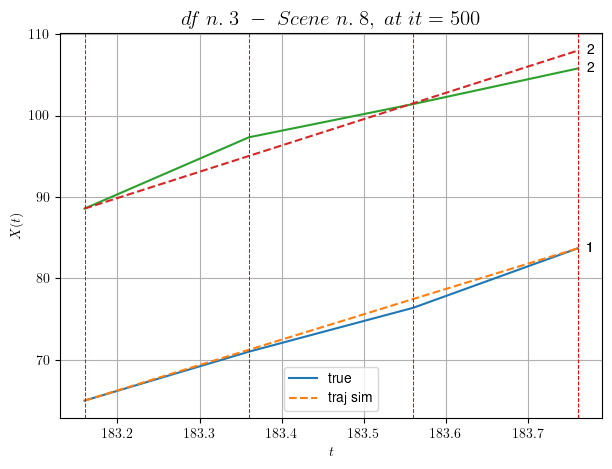

----------------------------------------------------------------------------------------------------
        For scene 9/60:
        * After LR finder: LR_NN=0.0001 with mse=1.439092931264581 at it=24
        * v0 = 32.31398331046929
        * MSE = 1.272586967557031
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.76,34.36]


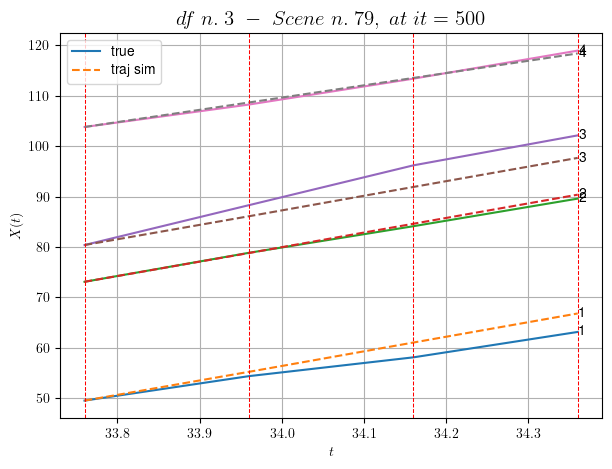

----------------------------------------------------------------------------------------------------
        For scene 10/60:
        * After LR finder: LR_NN=0.001 with mse=5.212028501964296 at it=24
        * v0 = 24.315647482967442
        * MSE = 4.203032608872091
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [486.56,487.56]


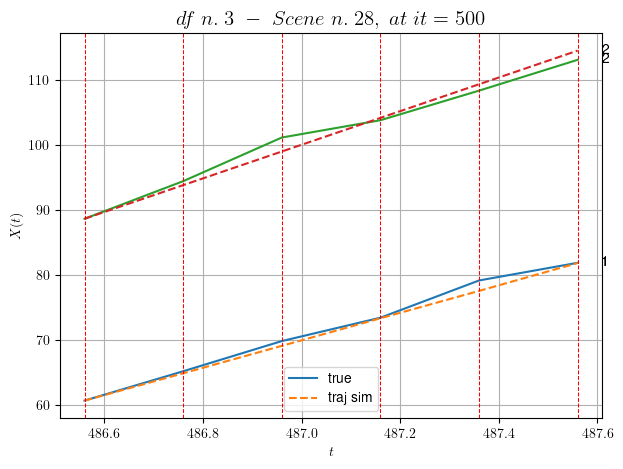

----------------------------------------------------------------------------------------------------
        For scene 11/60:
        * After LR finder: LR_NN=0.001 with mse=5.236379067234311 at it=24
        * v0 = 25.858119431709166
        * MSE = 0.935164569509338
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.76,403.56]


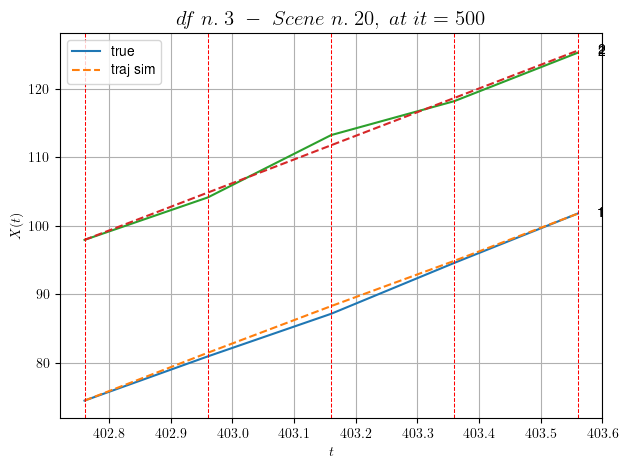

----------------------------------------------------------------------------------------------------
        For scene 12/60:
        * After LR finder: LR_NN=0.005 with mse=2.7824124445101566 at it=24
        * v0 = 34.51967072229297
        * MSE = 0.4602585045471064
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [248.16,248.56]


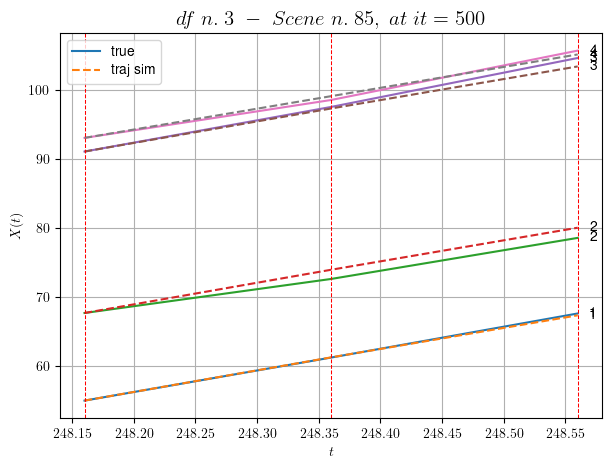

----------------------------------------------------------------------------------------------------
        For scene 13/60:
        * After LR finder: LR_NN=0.005 with mse=0.5663016455246251 at it=24
        * v0 = 30.248970609827257
        * MSE = 0.5163288729112191
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [464.56,466.56]


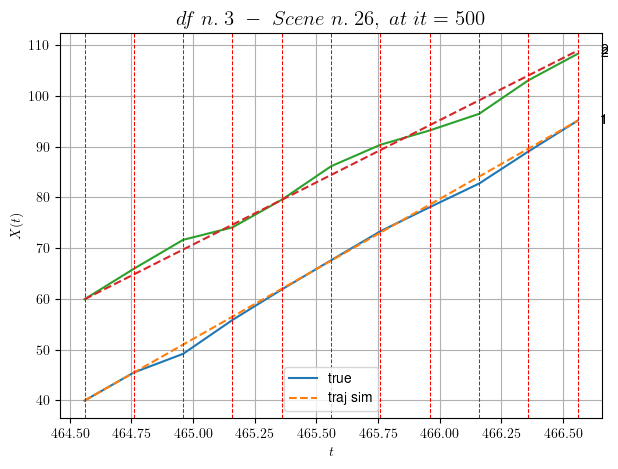

----------------------------------------------------------------------------------------------------
        For scene 14/60:
        * After LR finder: LR_NN=0.001 with mse=24.927220448105114 at it=24
        * v0 = 24.498602704881407
        * MSE = 1.1307342992475942
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [247.36,248.56]


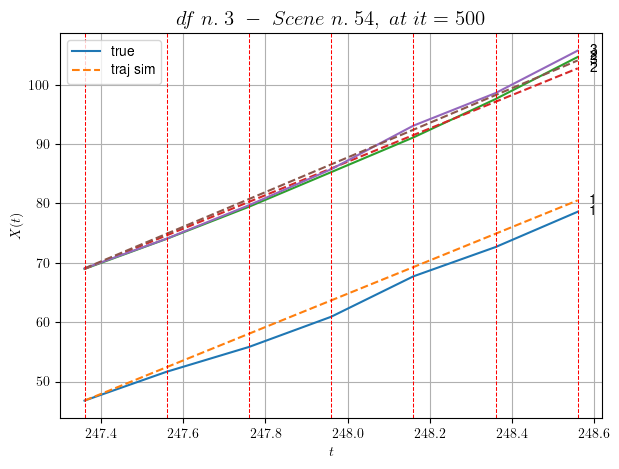

----------------------------------------------------------------------------------------------------
        For scene 15/60:
        * After LR finder: LR_NN=0.0005 with mse=1.40951424404429 at it=24
        * v0 = 29.19954509278809
        * MSE = 1.3772821100605557
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [292.56,294.56]


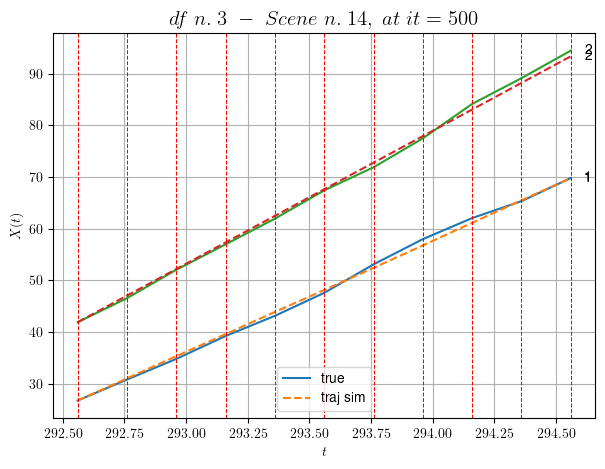

----------------------------------------------------------------------------------------------------
        For scene 16/60:
        * After LR finder: LR_NN=0.005 with mse=11.936882261685872 at it=24
        * v0 = 25.740986248381557
        * MSE = 0.411082796229137
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [438.16,438.76]


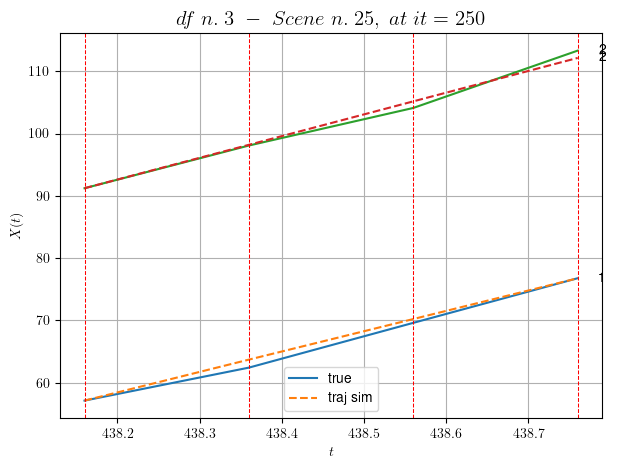

----------------------------------------------------------------------------------------------------
        For scene 17/60:
        * After LR finder: LR_NN=0.0005 with mse=66.17042317819077 at it=24
        * v0 = 34.86836427163435
        * MSE = 0.564414803123129
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [79.56,80.36]


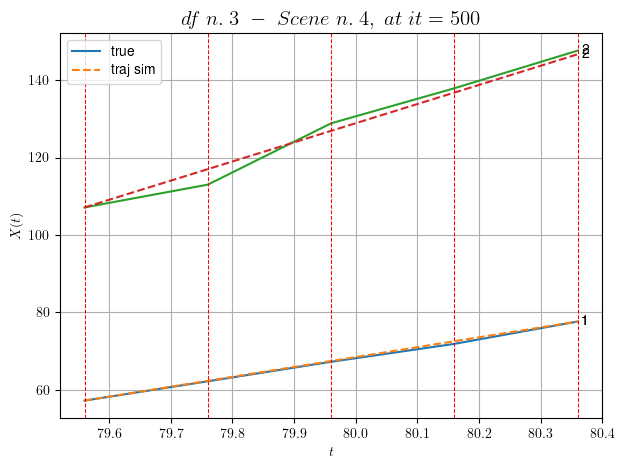

----------------------------------------------------------------------------------------------------
        For scene 18/60:
        * After LR finder: LR_NN=0.0005 with mse=52.96651826185278 at it=24
        * v0 = 49.42636153730838
        * MSE = 2.2409519593329996
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [377.56,378.36]


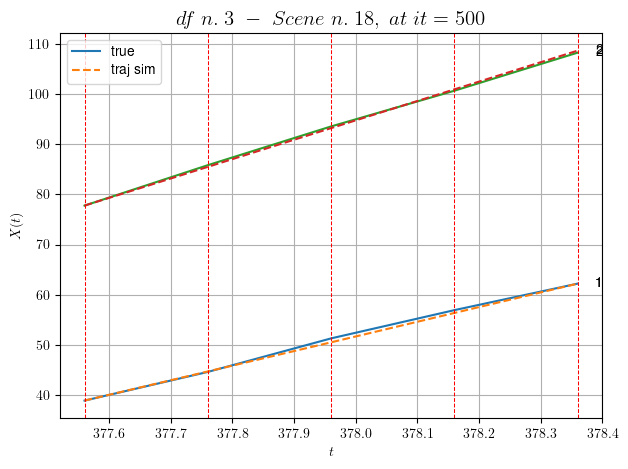

----------------------------------------------------------------------------------------------------
        For scene 19/60:
        * After LR finder: LR_NN=0.001 with mse=8.567802609373649 at it=24
        * v0 = 38.599928283780386
        * MSE = 0.13931180084813233
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [42.96,43.76]


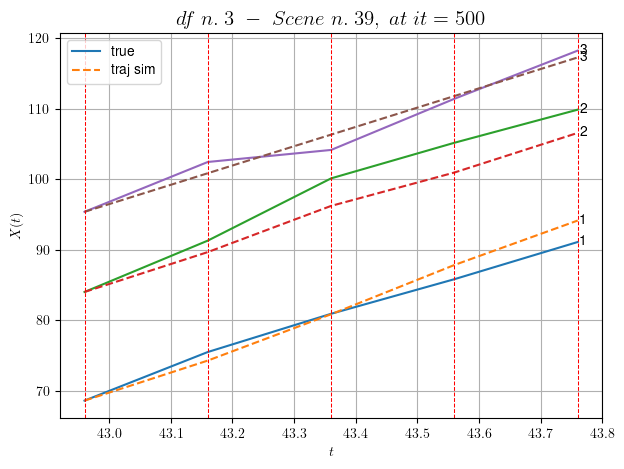

----------------------------------------------------------------------------------------------------
        For scene 20/60:
        * After LR finder: LR_NN=0.01 with mse=3.6732221958802196 at it=24
        * v0 = 27.35067344092231
        * MSE = 2.852239772179756
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/60
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [199.96,201.56]


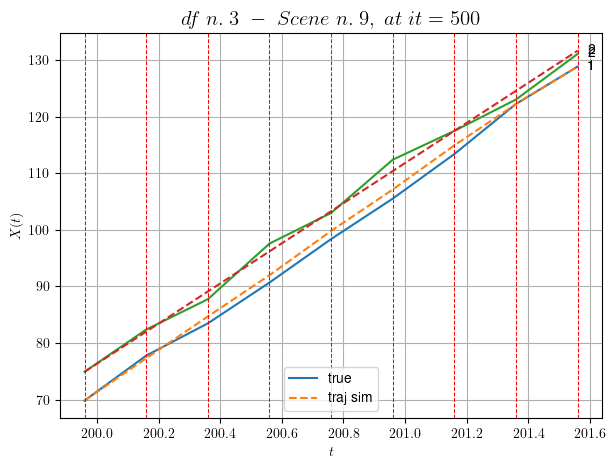

----------------------------------------------------------------------------------------------------
        For scene 21/60:
        * After LR finder: LR_NN=0.001 with mse=14.016830972806728 at it=24
        * v0 = 35.48263392775811
        * MSE = 1.165274137727593
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [393.36,393.76]


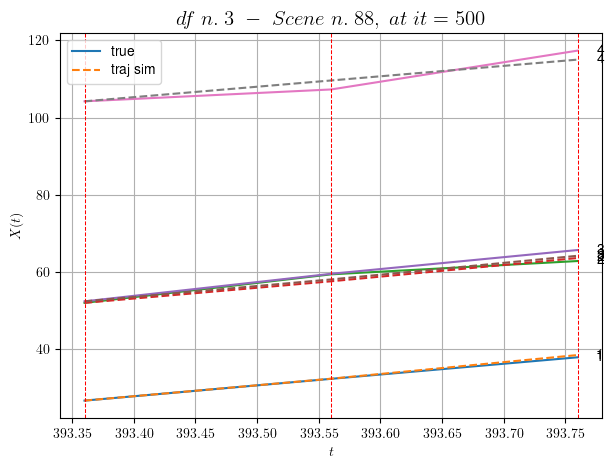

----------------------------------------------------------------------------------------------------
        For scene 22/60:
        * After LR finder: LR_NN=0.005 with mse=1.6703034808102433 at it=24
        * v0 = 27.00629353640485
        * MSE = 1.5165861975167712
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [154.56,155.36]


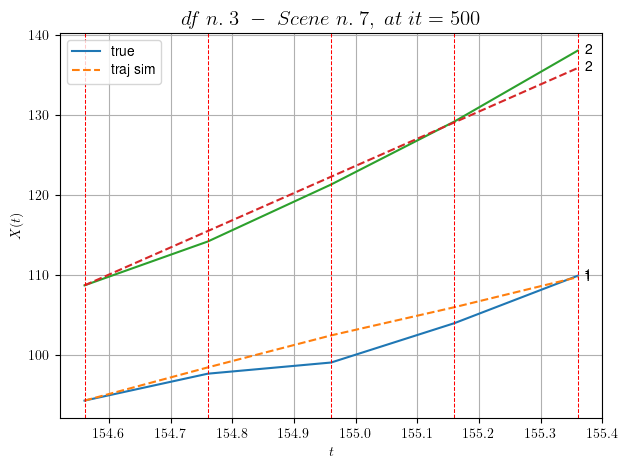

----------------------------------------------------------------------------------------------------
        For scene 23/60:
        * After LR finder: LR_NN=0.005 with mse=5.353141580266319 at it=24
        * v0 = 33.88242010375711
        * MSE = 2.2827031510754114
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [448.36,448.76]


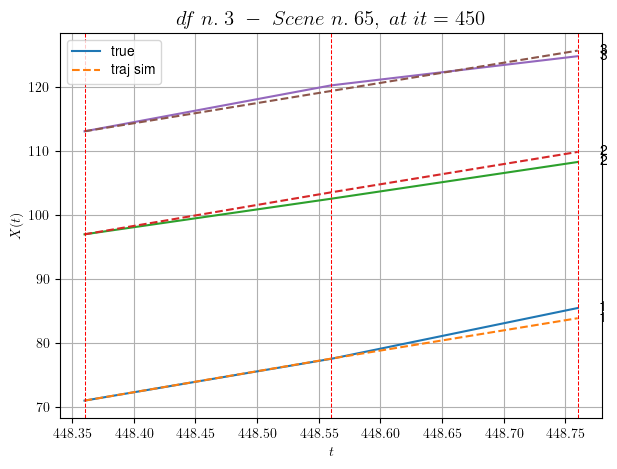

----------------------------------------------------------------------------------------------------
        For scene 24/60:
        * After LR finder: LR_NN=0.005 with mse=1.6833277657529557 at it=24
        * v0 = 31.58504786926365
        * MSE = 0.8269673710073739
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [17.56,17.96]


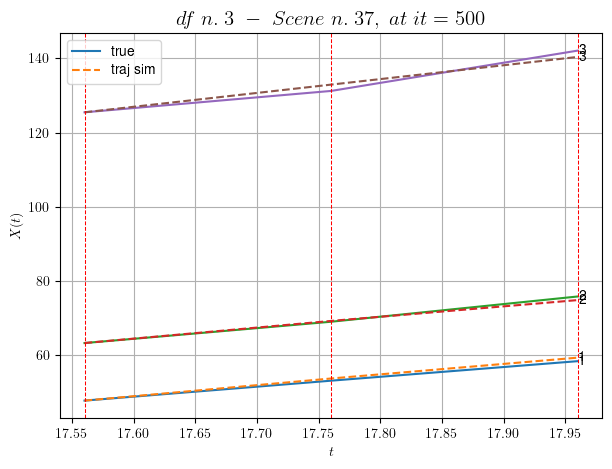

----------------------------------------------------------------------------------------------------
        For scene 25/60:
        * After LR finder: LR_NN=0.01 with mse=2.6784485962892117 at it=24
        * v0 = 37.341608941888914
        * MSE = 0.892884581555237
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [83.36,84.56]


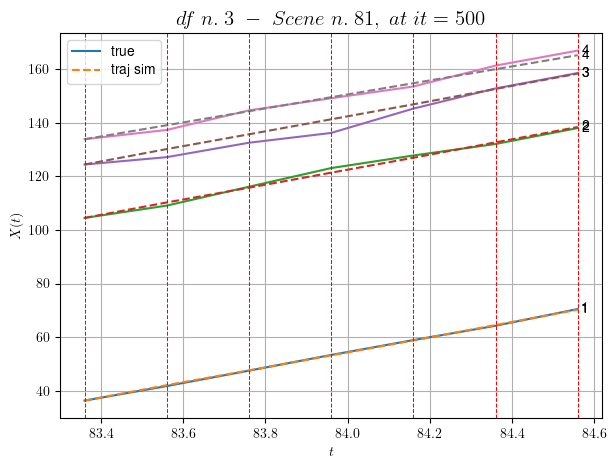

----------------------------------------------------------------------------------------------------
        For scene 26/60:
        * After LR finder: LR_NN=0.005 with mse=3.5529897248014004 at it=24
        * v0 = 26.107724197314568
        * MSE = 2.1338991726618417
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [95.36,95.76]


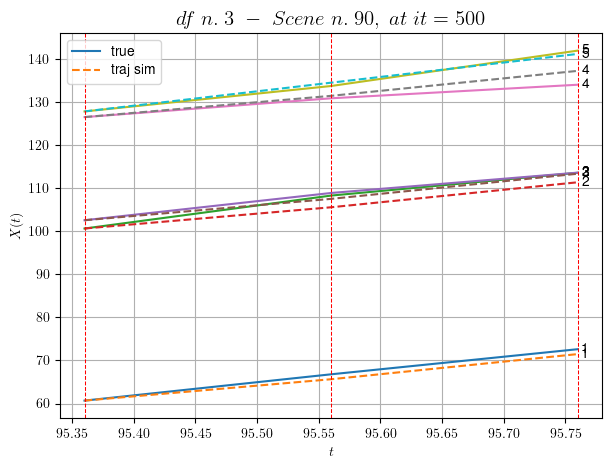

----------------------------------------------------------------------------------------------------
        For scene 27/60:
        * After LR finder: LR_NN=0.01 with mse=2.4590266508216616 at it=24
        * v0 = 33.35137428698077
        * MSE = 1.9023193838736596
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [269.56,270.96]


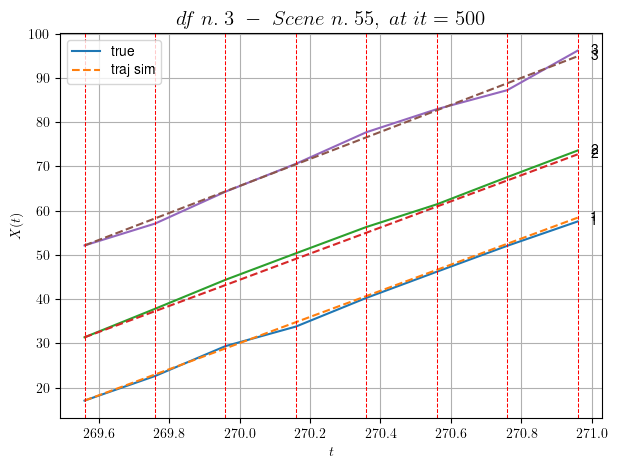

----------------------------------------------------------------------------------------------------
        For scene 28/60:
        * After LR finder: LR_NN=0.001 with mse=0.7860345211378639 at it=24
        * v0 = 30.539175669712137
        * MSE = 0.6673766619121174
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


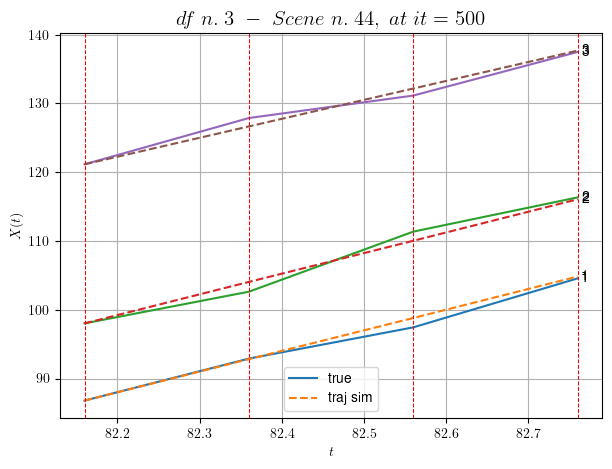

----------------------------------------------------------------------------------------------------
        For scene 29/60:
        * After LR finder: LR_NN=0.001 with mse=1.1031062338886441 at it=24
        * v0 = 27.55023741370728
        * MSE = 0.69669240994429
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [207.96,208.76]


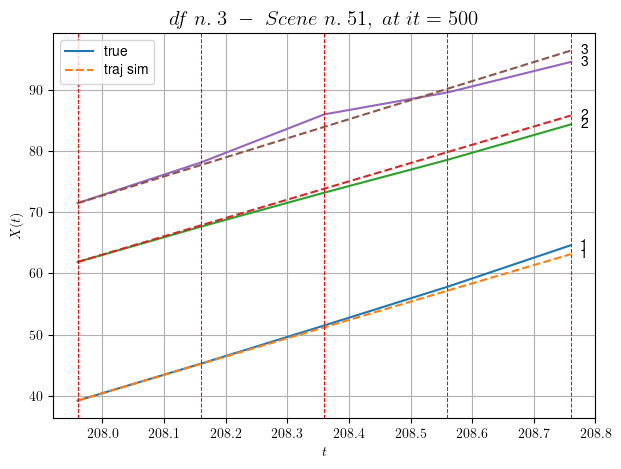

----------------------------------------------------------------------------------------------------
        For scene 30/60:
        * After LR finder: LR_NN=0.001 with mse=0.9637810004292572 at it=24
        * v0 = 31.124909645189884
        * MSE = 0.9447979999676908
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/60
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [139.16,141.56]


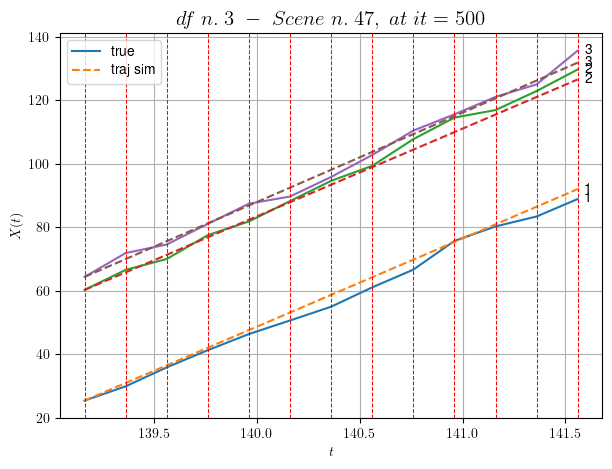

----------------------------------------------------------------------------------------------------
        For scene 31/60:
        * After LR finder: LR_NN=0.0005 with mse=5.422101486097207 at it=24
        * v0 = 28.14463056725904
        * MSE = 3.9090263742339695
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [390.36,390.76]


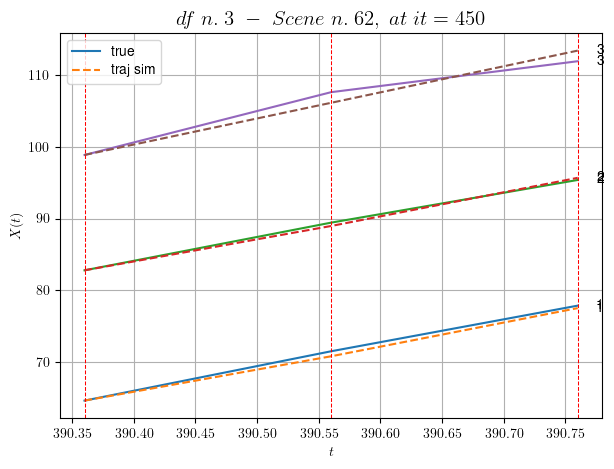

----------------------------------------------------------------------------------------------------
        For scene 32/60:
        * After LR finder: LR_NN=0.01 with mse=1.2229376412137418 at it=24
        * v0 = 36.35425916503303
        * MSE = 0.5873249467661196
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [521.76,522.76]


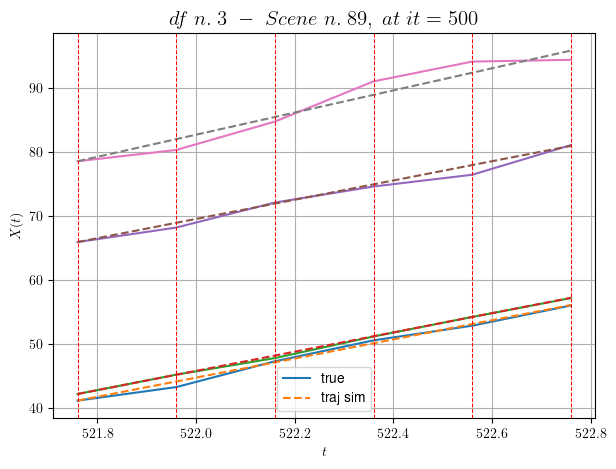

----------------------------------------------------------------------------------------------------
        For scene 33/60:
        * After LR finder: LR_NN=0.001 with mse=15.056575229351175 at it=24
        * v0 = 17.247787667046882
        * MSE = 0.7069399573606947
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [331.56,332.56]


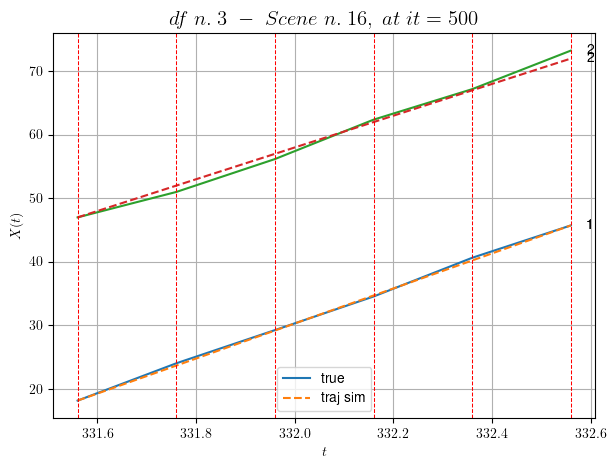

----------------------------------------------------------------------------------------------------
        For scene 34/60:
        * After LR finder: LR_NN=0.0001 with mse=3.971304279600839 at it=24
        * v0 = 25.002166879948692
        * MSE = 0.3130517283812228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [530.36,530.96]


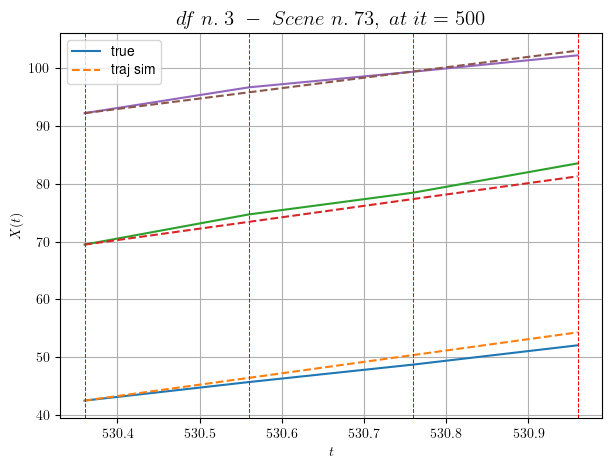

----------------------------------------------------------------------------------------------------
        For scene 35/60:
        * After LR finder: LR_NN=0.001 with mse=8.802074840232608 at it=24
        * v0 = 18.054855152782814
        * MSE = 1.4682222185540839
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [67.16,67.76]


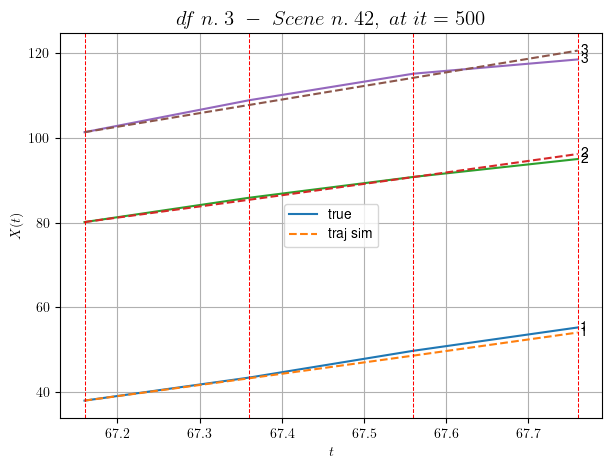

----------------------------------------------------------------------------------------------------
        For scene 36/60:
        * After LR finder: LR_NN=0.005 with mse=1.0363032072036795 at it=24
        * v0 = 32.13932154245628
        * MSE = 0.8801817527616902
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [335.76,336.16]


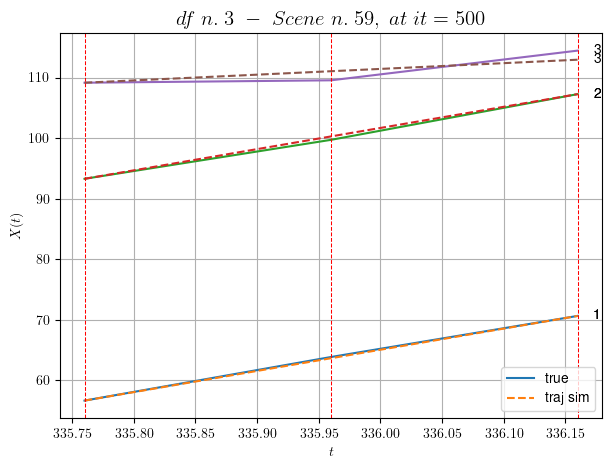

----------------------------------------------------------------------------------------------------
        For scene 37/60:
        * After LR finder: LR_NN=0.001 with mse=8.519305204309925 at it=24
        * v0 = 9.495680524398642
        * MSE = 0.4907589756505056
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [149.36,149.96]


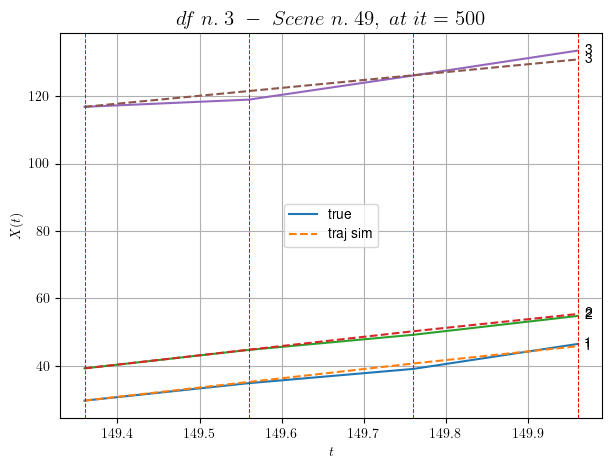

----------------------------------------------------------------------------------------------------
        For scene 38/60:
        * After LR finder: LR_NN=0.005 with mse=2.7079101033266433 at it=24
        * v0 = 23.443555328520812
        * MSE = 1.44210154408461
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [34.96,35.36]


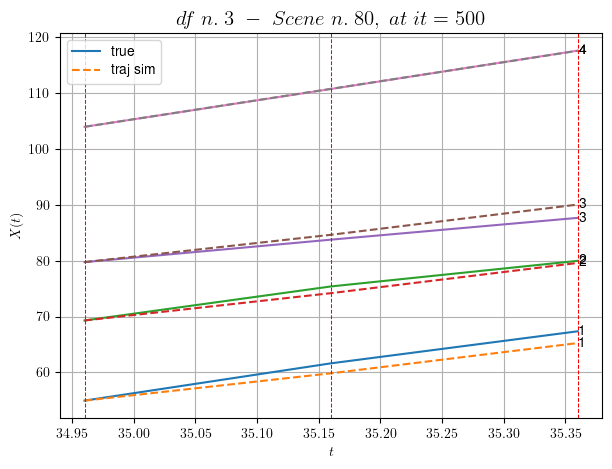

----------------------------------------------------------------------------------------------------
        For scene 39/60:
        * After LR finder: LR_NN=0.01 with mse=1.7272173369180202 at it=24
        * v0 = 34.04452453089846
        * MSE = 1.302549999390728
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.76,326.96]


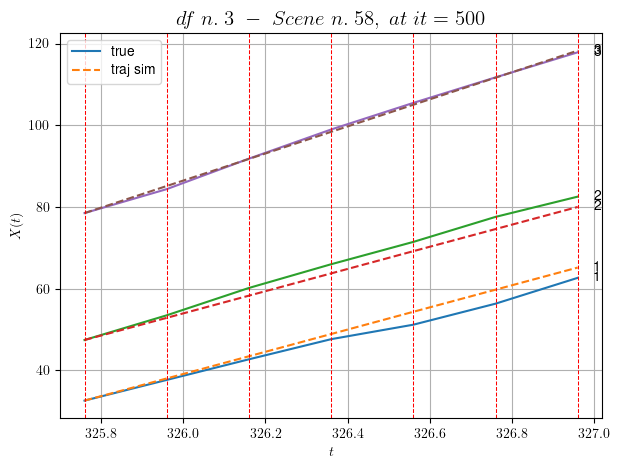

----------------------------------------------------------------------------------------------------
        For scene 40/60:
        * After LR finder: LR_NN=0.001 with mse=4.646951319940477 at it=24
        * v0 = 33.13555230710433
        * MSE = 2.904529463161799
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [573.76,574.56]


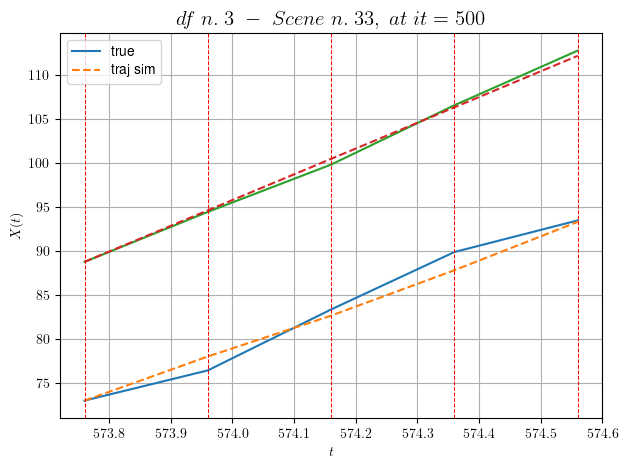

----------------------------------------------------------------------------------------------------
        For scene 41/60:
        * After LR finder: LR_NN=0.005 with mse=1.4206308303962834 at it=24
        * v0 = 29.32939981959702
        * MSE = 0.8201720069103964
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.56,321.16]


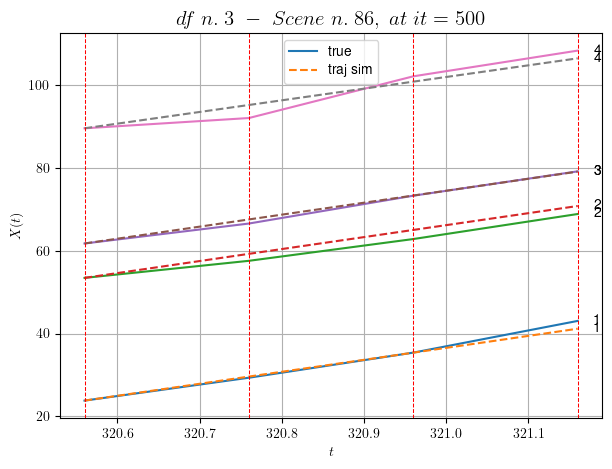

----------------------------------------------------------------------------------------------------
        For scene 42/60:
        * After LR finder: LR_NN=0.0005 with mse=1.8095072720173007 at it=24
        * v0 = 28.130140949143787
        * MSE = 1.747605478020776
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [371.16,371.76]


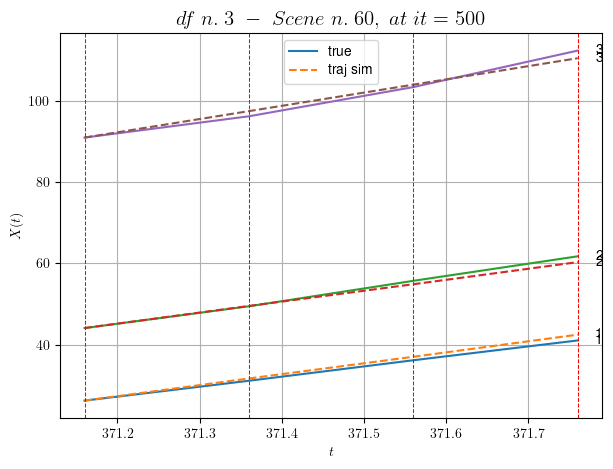

----------------------------------------------------------------------------------------------------
        For scene 43/60:
        * After LR finder: LR_NN=0.005 with mse=1.5082162359327647 at it=24
        * v0 = 32.539507599225445
        * MSE = 0.9391043521859493
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [439.36,439.96]


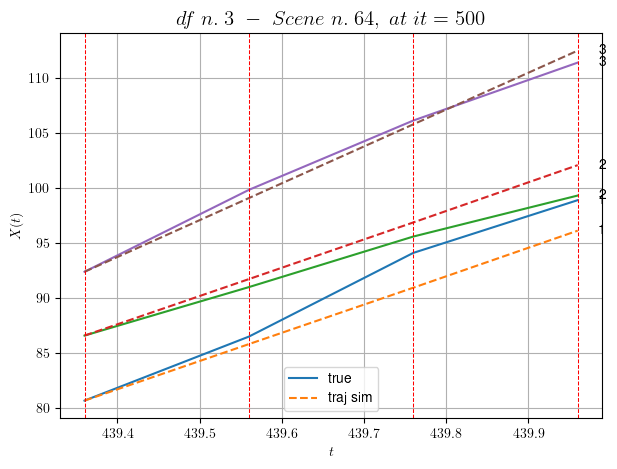

----------------------------------------------------------------------------------------------------
        For scene 44/60:
        * After LR finder: LR_NN=0.001 with mse=2.891965152449714 at it=24
        * v0 = 33.53637857273001
        * MSE = 2.4790643722591095
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [31.36,31.96]


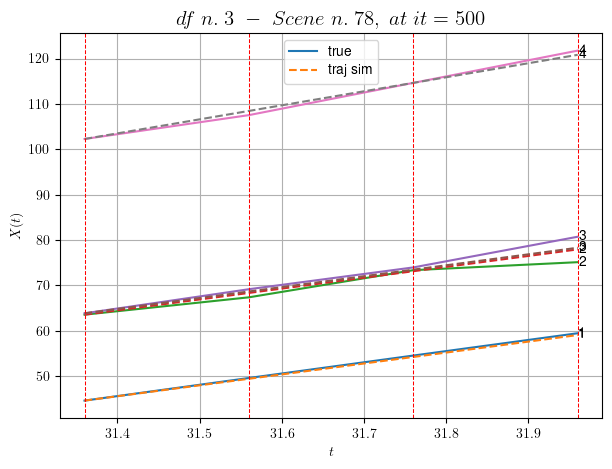

----------------------------------------------------------------------------------------------------
        For scene 45/60:
        * After LR finder: LR_NN=0.001 with mse=0.903577614066595 at it=24
        * v0 = 30.91717405915605
        * MSE = 1.0801411886081693
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.96,24.76]


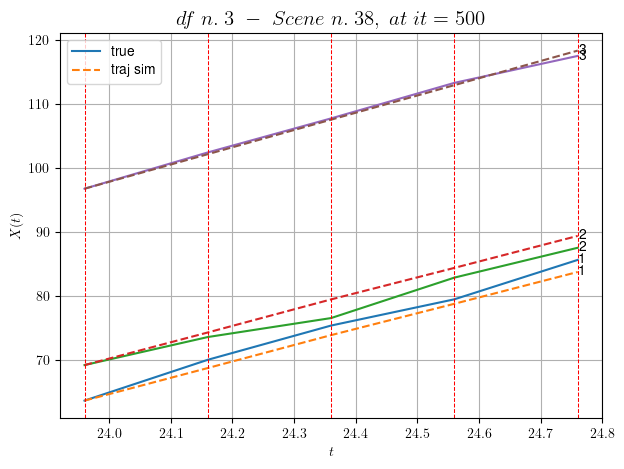

----------------------------------------------------------------------------------------------------
        For scene 46/60:
        * After LR finder: LR_NN=0.005 with mse=2.1626529457163564 at it=24
        * v0 = 27.0166643536972
        * MSE = 1.578467199630228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [544.16,545.16]


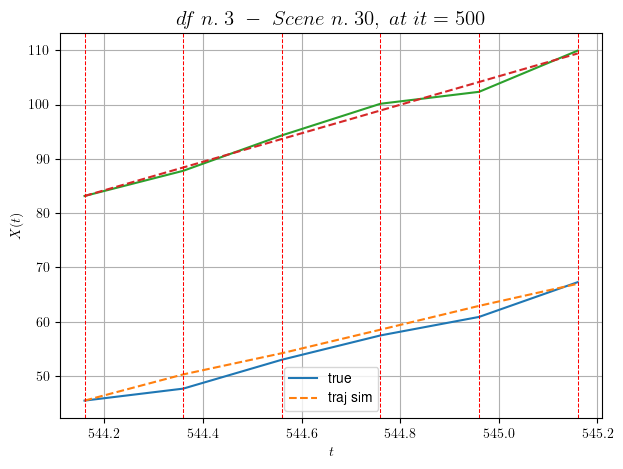

----------------------------------------------------------------------------------------------------
        For scene 47/60:
        * After LR finder: LR_NN=0.01 with mse=4.6055023877679275 at it=24
        * v0 = 26.245021293268852
        * MSE = 1.582616466680673
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [12.76,13.96]


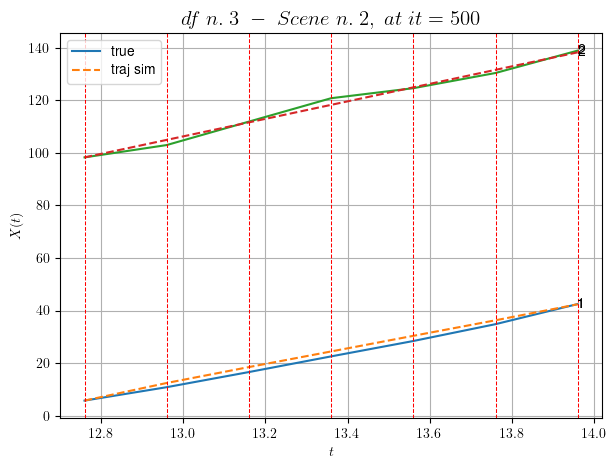

----------------------------------------------------------------------------------------------------
        For scene 48/60:
        * After LR finder: LR_NN=0.01 with mse=4.933778914453833 at it=24
        * v0 = 33.329707464158176
        * MSE = 1.841787070009014
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [222.96,223.76]


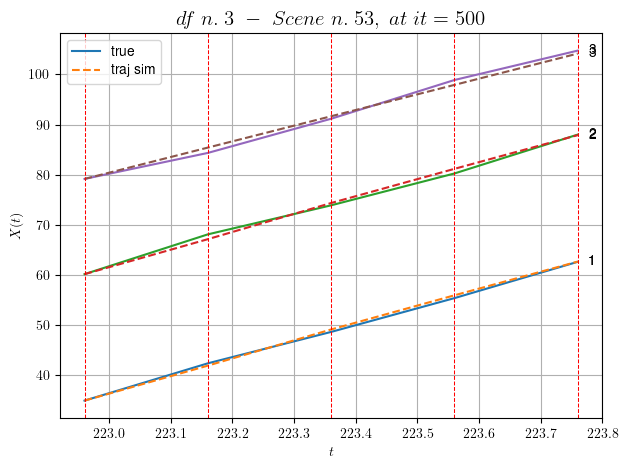

----------------------------------------------------------------------------------------------------
        For scene 49/60:
        * After LR finder: LR_NN=0.005 with mse=0.7534000062609841 at it=24
        * v0 = 31.279750687416612
        * MSE = 0.3631772488426747
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [427.36,427.76]


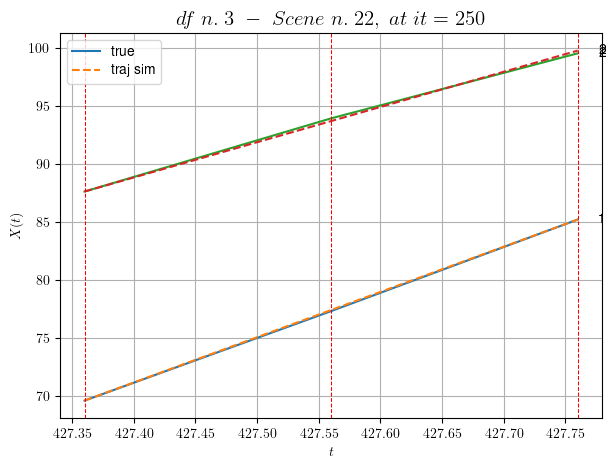

----------------------------------------------------------------------------------------------------
        For scene 50/60:
        * After LR finder: LR_NN=0.001 with mse=0.02017280738098775 at it=24
        * v0 = 30.36152457041891
        * MSE = 0.01772222939380074
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [40.76,41.16]


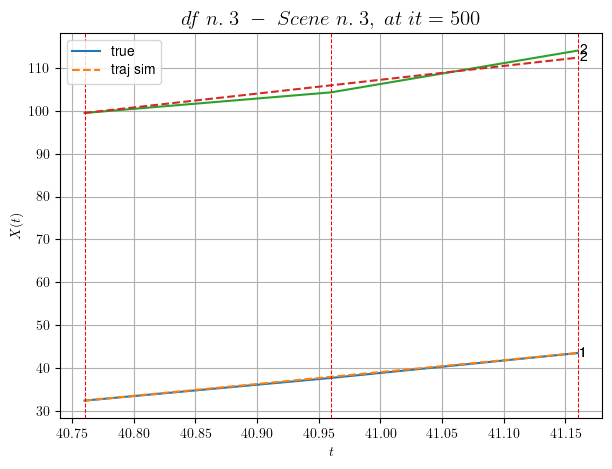

----------------------------------------------------------------------------------------------------
        For scene 51/60:
        * After LR finder: LR_NN=0.0001 with mse=1.3522665386857449 at it=24
        * v0 = 32.20688351428612
        * MSE = 0.9080817435358528
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


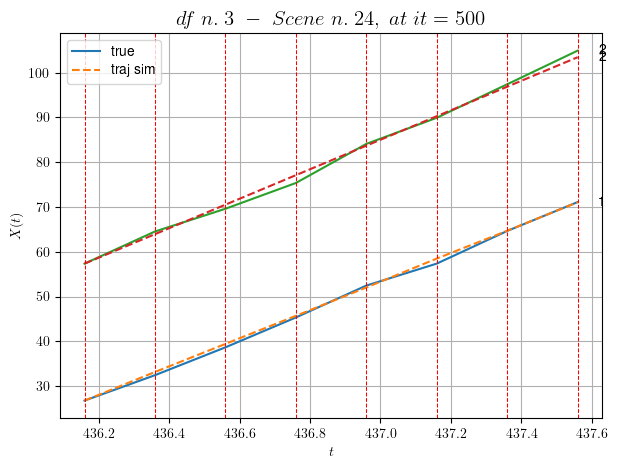

----------------------------------------------------------------------------------------------------
        For scene 52/60:
        * After LR finder: LR_NN=0.005 with mse=4.155823023336248 at it=24
        * v0 = 32.92393930276478
        * MSE = 0.5996749405996737
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


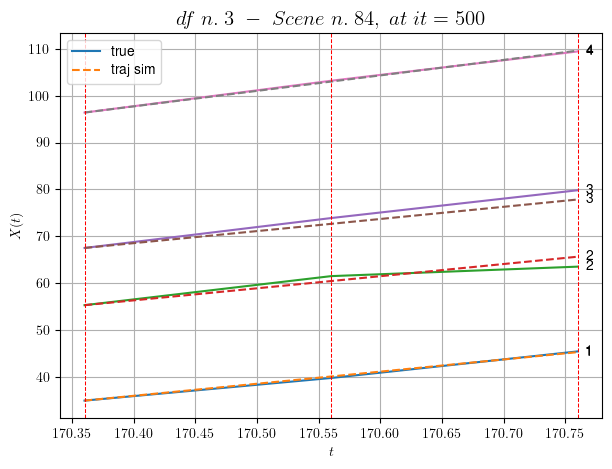

----------------------------------------------------------------------------------------------------
        For scene 53/60:
        * After LR finder: LR_NN=0.001 with mse=1.127437134594694 at it=24
        * v0 = 32.99653993565652
        * MSE = 0.9310642570397617
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


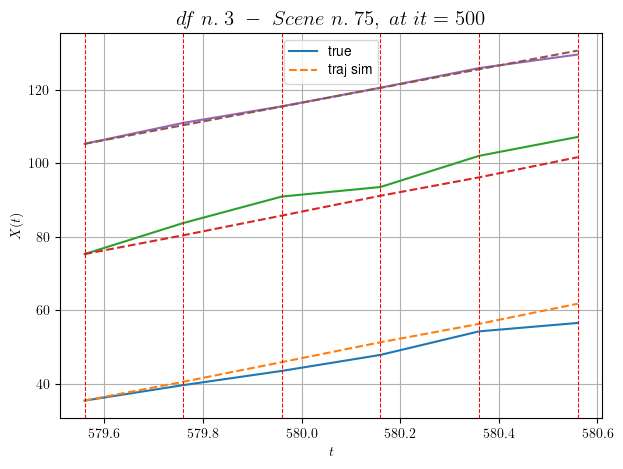

----------------------------------------------------------------------------------------------------
        For scene 54/60:
        * After LR finder: LR_NN=0.005 with mse=12.49017122203045 at it=24
        * v0 = 25.358404463471246
        * MSE = 8.838788144788284
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


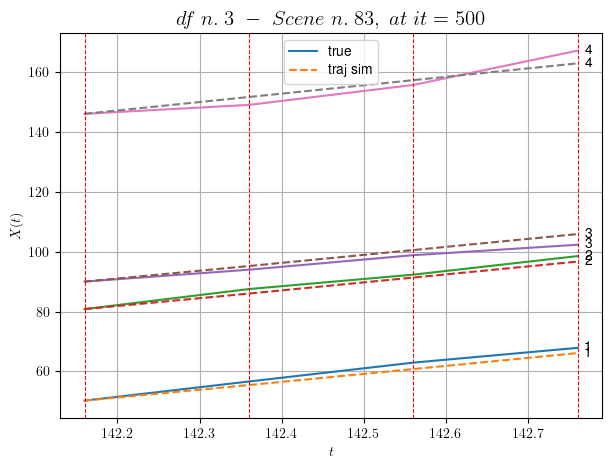

----------------------------------------------------------------------------------------------------
        For scene 55/60:
        * After LR finder: LR_NN=0.005 with mse=3.598721875302959 at it=24
        * v0 = 28.12123774853819
        * MSE = 3.5843416465246816
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


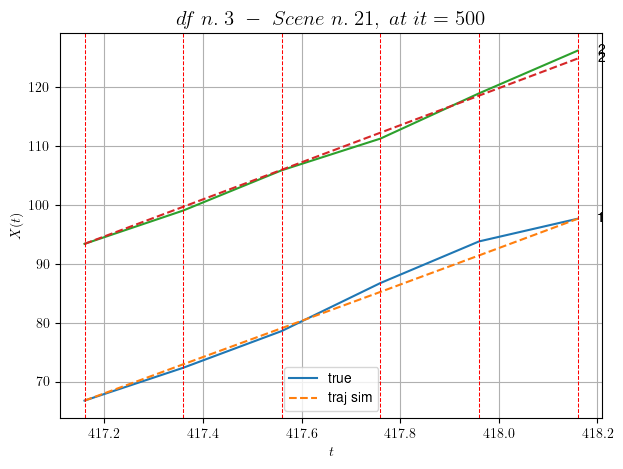

----------------------------------------------------------------------------------------------------
        For scene 56/60:
        * After LR finder: LR_NN=0.0005 with mse=5.655908851268775 at it=24
        * v0 = 31.447990123716224
        * MSE = 0.9798250612491473
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


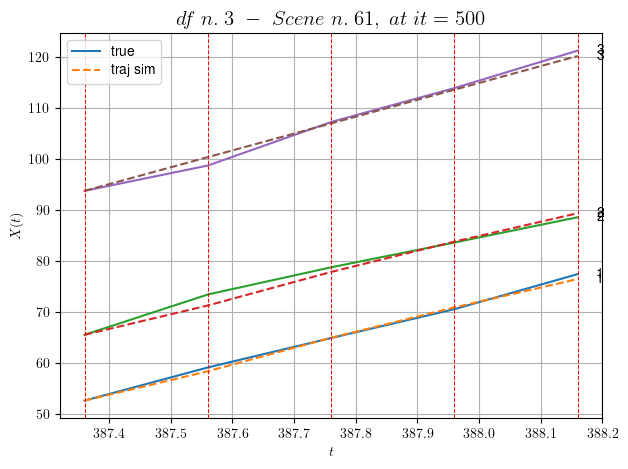

----------------------------------------------------------------------------------------------------
        For scene 57/60:
        * After LR finder: LR_NN=0.01 with mse=1.8363776371439744 at it=24
        * v0 = 33.031898088257954
        * MSE = 0.7538833272200458
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


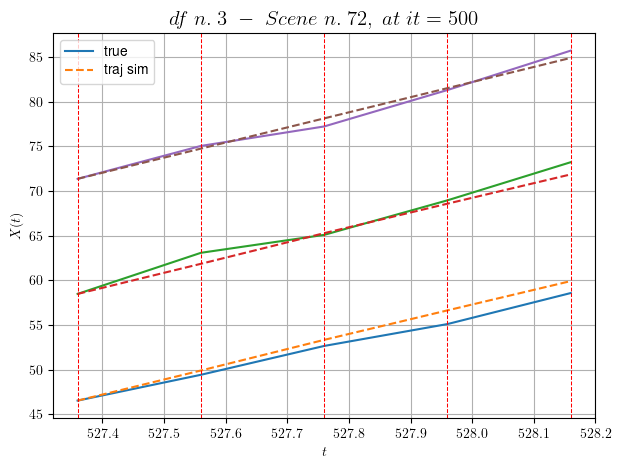

----------------------------------------------------------------------------------------------------
        For scene 58/60:
        * After LR finder: LR_NN=0.005 with mse=14.093516703700288 at it=24
        * v0 = 16.920906022778254
        * MSE = 0.6659686444060912
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


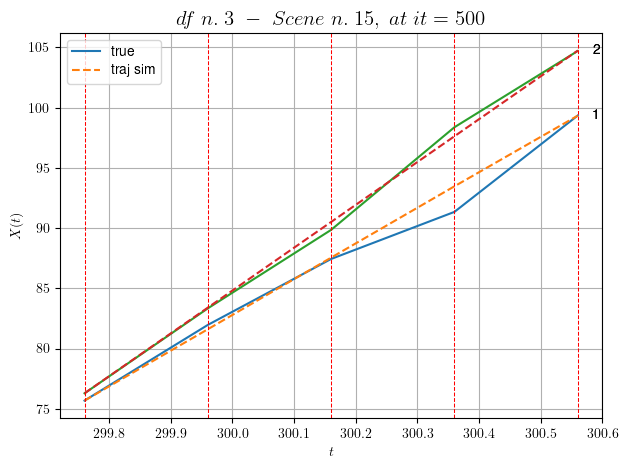

----------------------------------------------------------------------------------------------------
        For scene 59/60:
        * After LR finder: LR_NN=0.001 with mse=4.4511301529612775 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5628334323626591
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


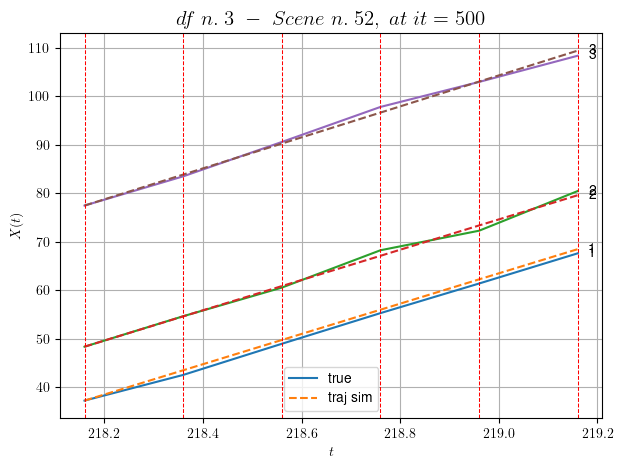

----------------------------------------------------------------------------------------------------
        For scene 60/60:
        * After LR finder: LR_NN=0.0005 with mse=0.9546610259783165 at it=24
        * v0 = 31.946925583263628
        * MSE = 0.5289196539982389
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.739989570181428
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.3. Scene n.1/30


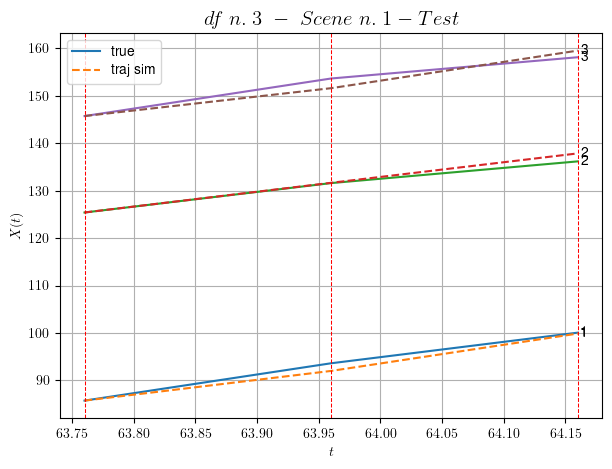

        For scene 1/30:
        * MSE = 1.2866107400176225
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/30


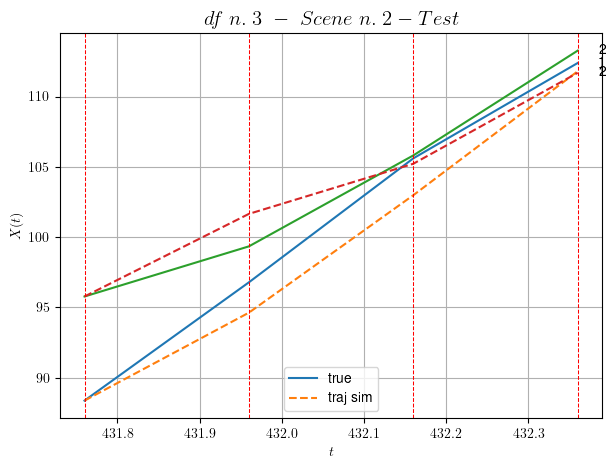

        For scene 2/30:
        * MSE = 2.5052899157971025
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/30


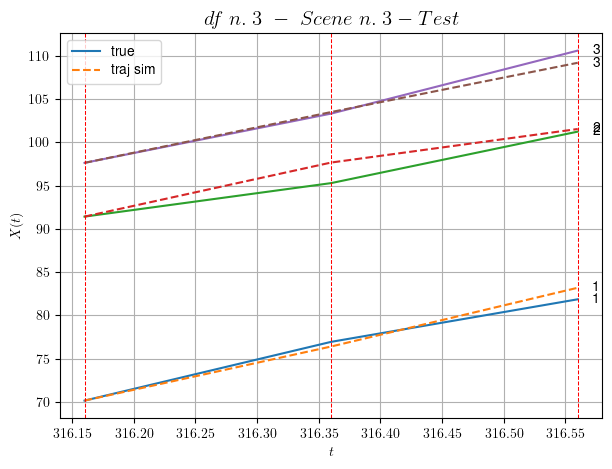

        For scene 3/30:
        * MSE = 1.0913598119168997
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/30


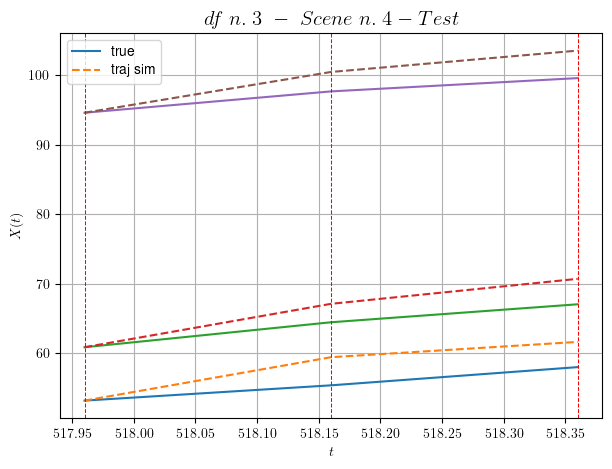

        For scene 4/30:
        * MSE = 8.180041277864678
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/30


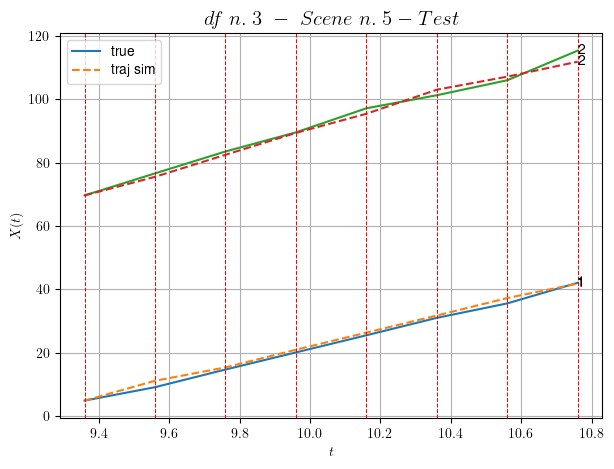

        For scene 5/30:
        * MSE = 1.9580489486210828
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/30


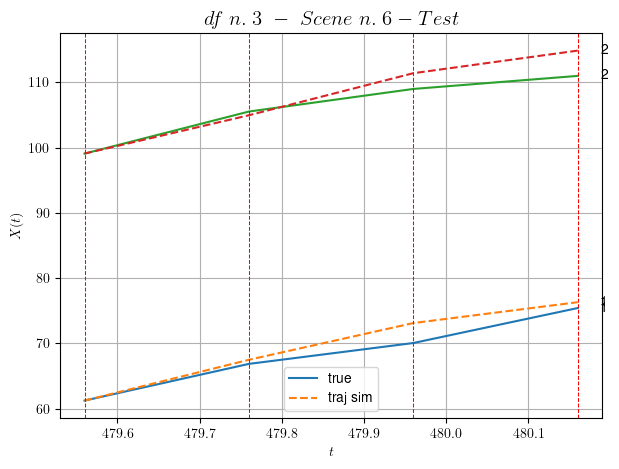

        For scene 6/30:
        * MSE = 3.9614682131849697
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/30


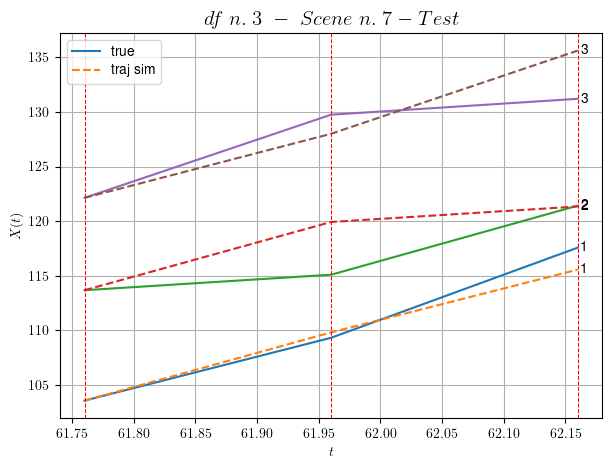

        For scene 7/30:
        * MSE = 5.581835979757269
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/30


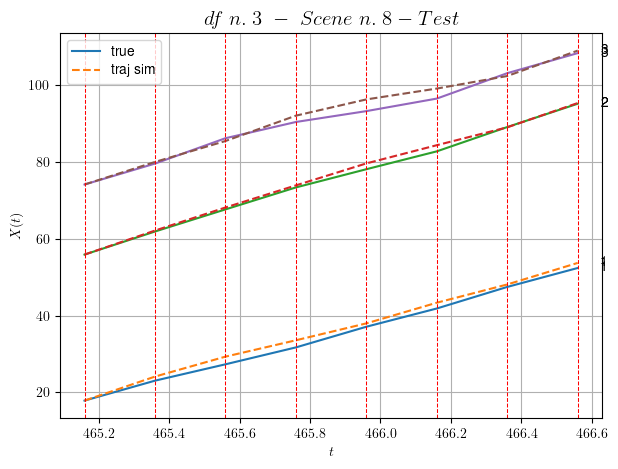

        For scene 8/30:
        * MSE = 1.6543100166363942
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/30


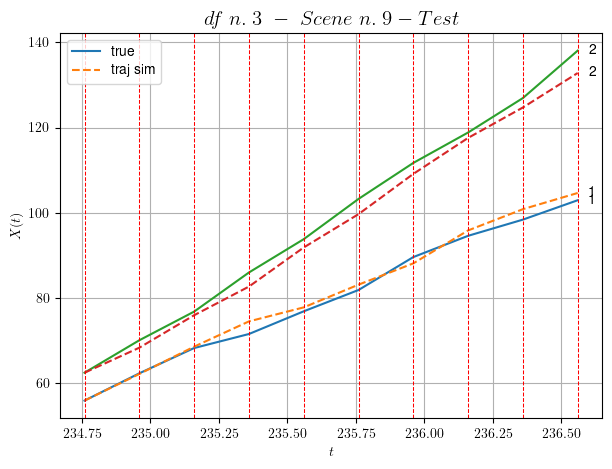

        For scene 9/30:
        * MSE = 4.806218736018826
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/30


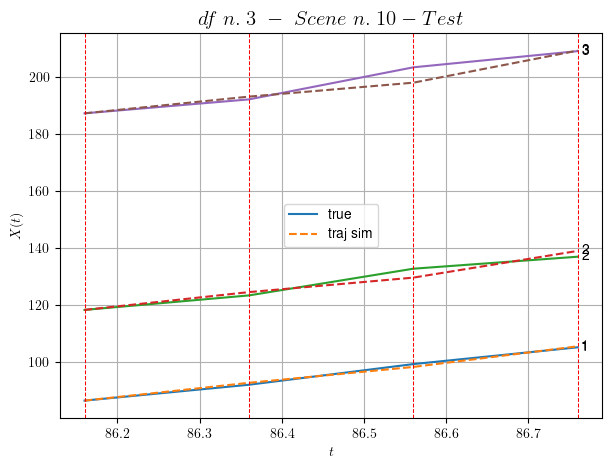

        For scene 10/30:
        * MSE = 3.9189209371097014
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/30


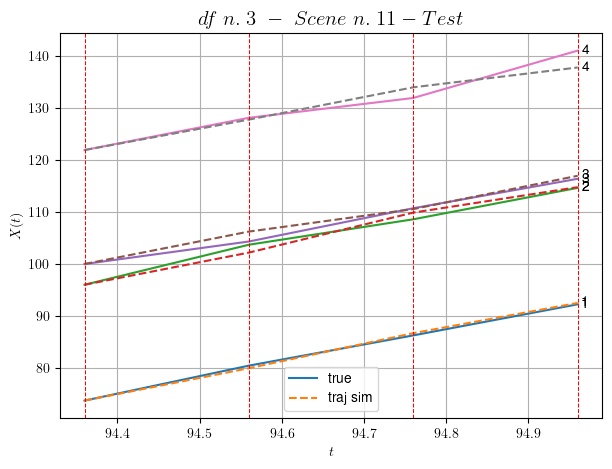

        For scene 11/30:
        * MSE = 1.461531491105731
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/30


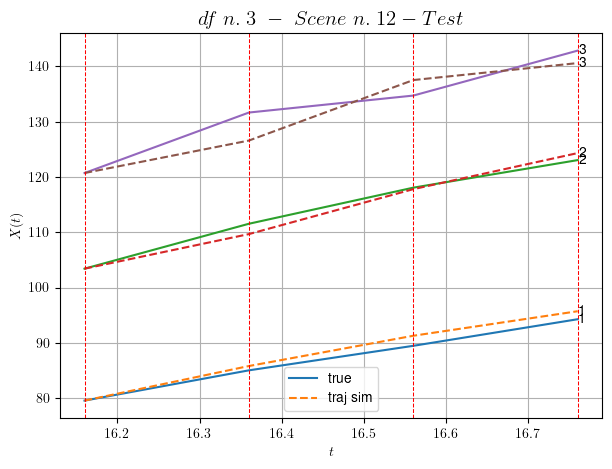

        For scene 12/30:
        * MSE = 4.14727128195
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/30


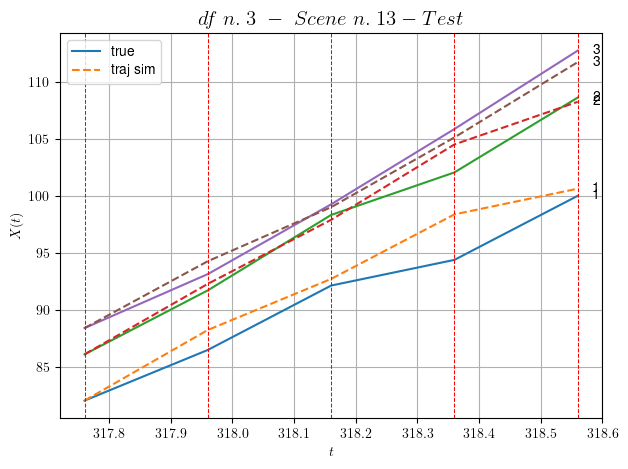

        For scene 13/30:
        * MSE = 1.9576839512096968
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/30


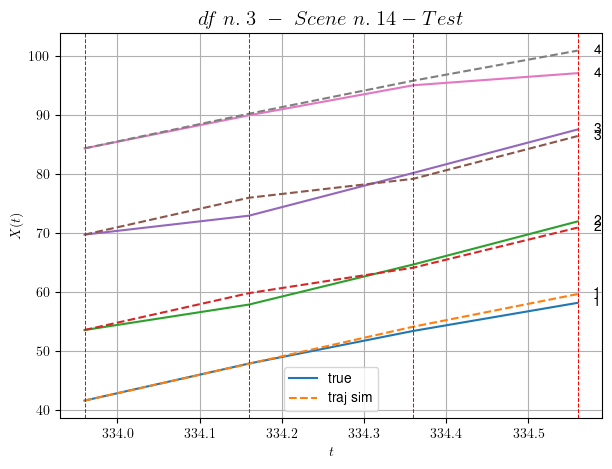

        For scene 14/30:
        * MSE = 2.167422695262133
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/30


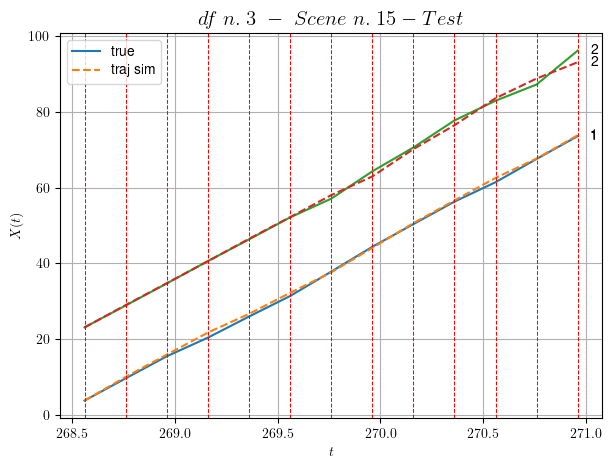

        For scene 15/30:
        * MSE = 0.8361047488115412
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/30


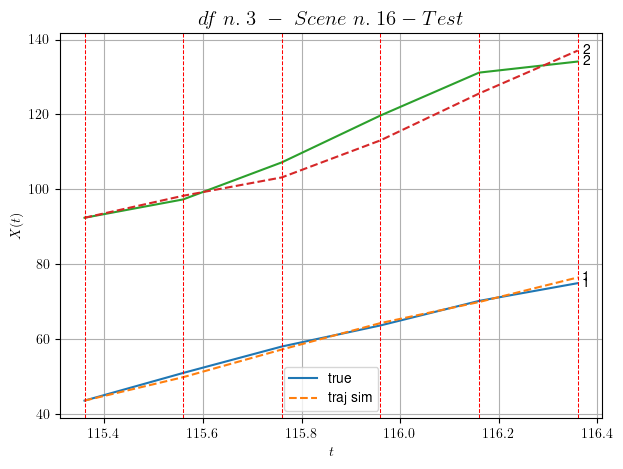

        For scene 16/30:
        * MSE = 8.781138298438316
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/30


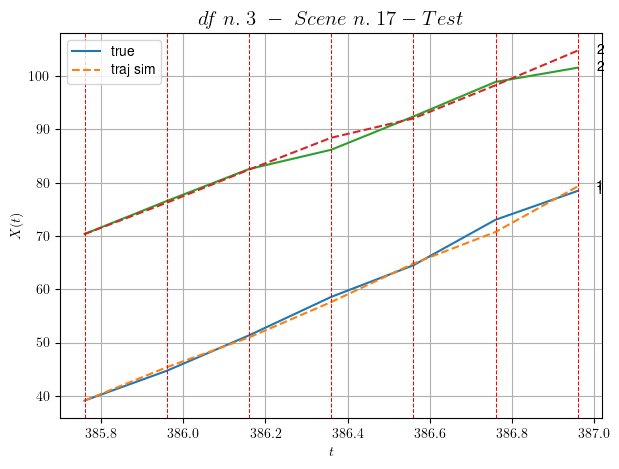

        For scene 17/30:
        * MSE = 1.6812961649765565
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/30


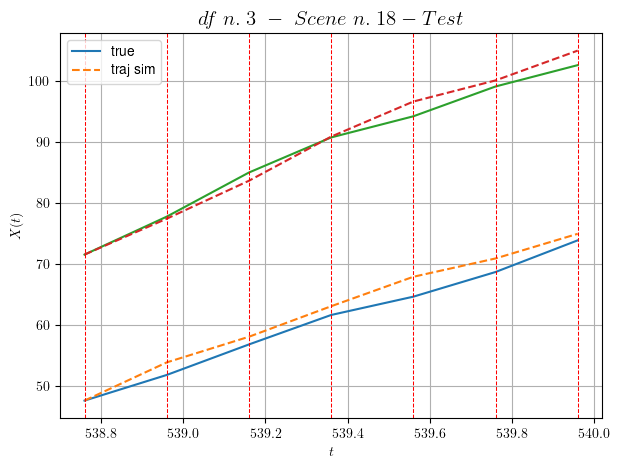

        For scene 18/30:
        * MSE = 2.780699072229956
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/30


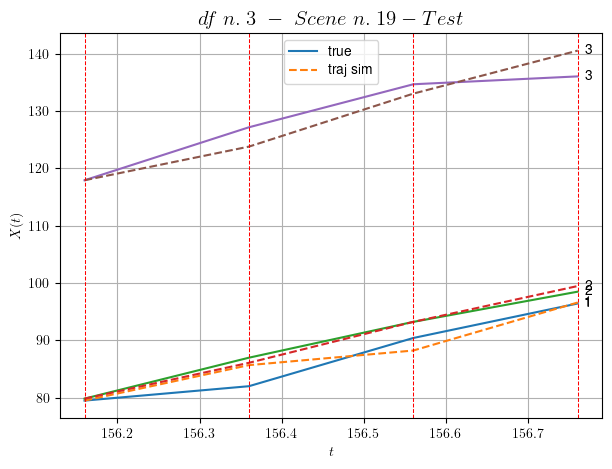

        For scene 19/30:
        * MSE = 4.5322458600352356
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/30


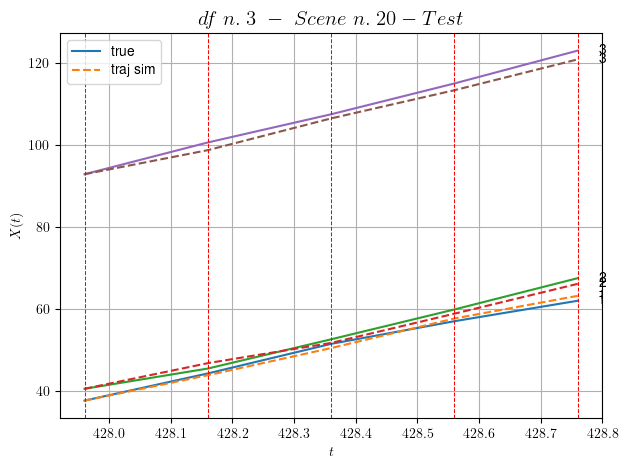

        For scene 20/30:
        * MSE = 1.3622667867987406
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/30


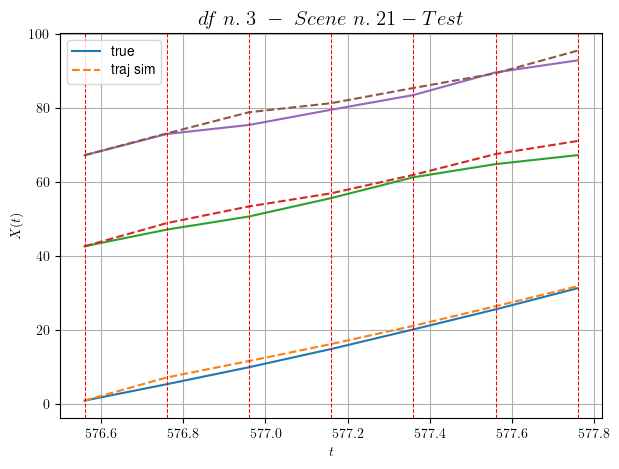

        For scene 21/30:
        * MSE = 3.331500232732532
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/30


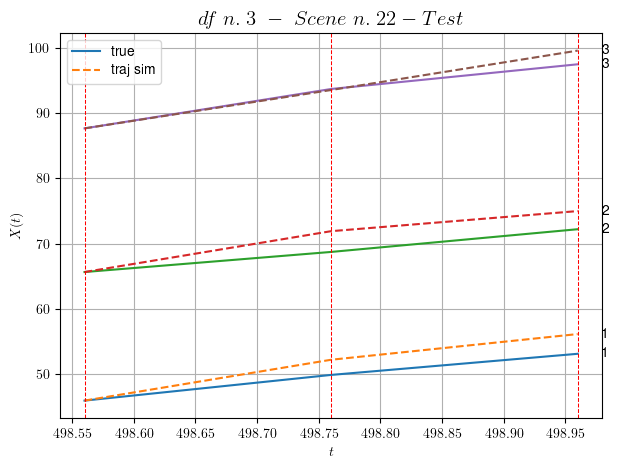

        For scene 22/30:
        * MSE = 4.080636375616947
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/30


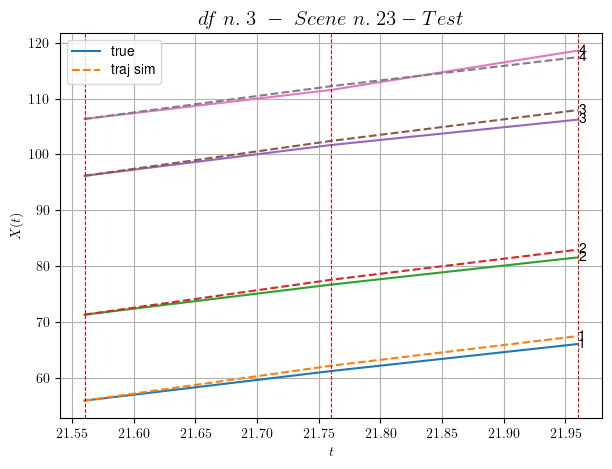

        For scene 23/30:
        * MSE = 0.9043610118688872
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/30


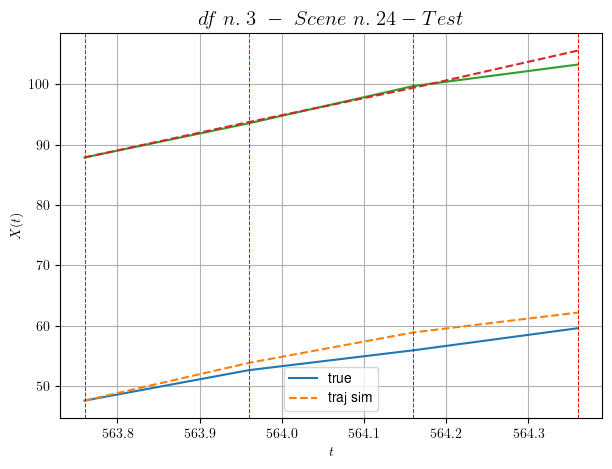

        For scene 24/30:
        * MSE = 2.8060657633038177
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/30


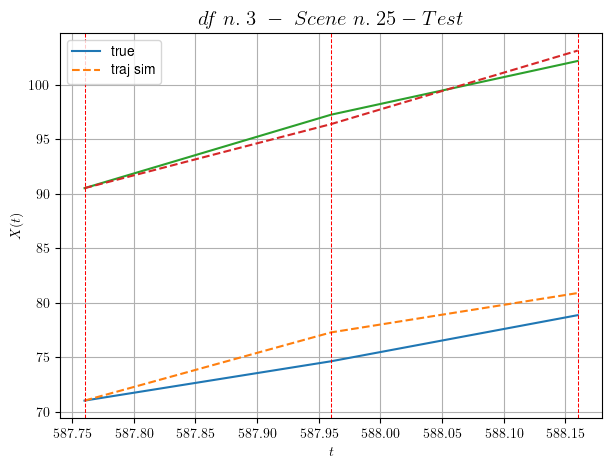

        For scene 25/30:
        * MSE = 2.127557131747526
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/30


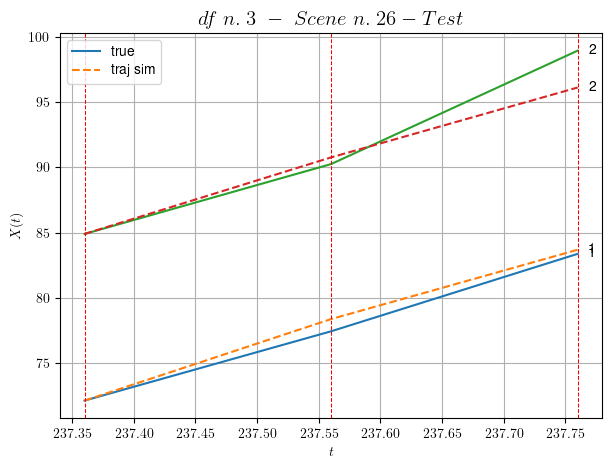

        For scene 26/30:
        * MSE = 1.5393953217055247
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/30


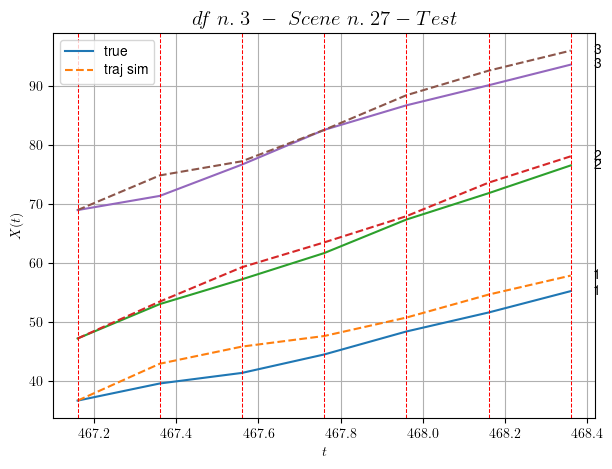

        For scene 27/30:
        * MSE = 4.9153389175908035
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/30


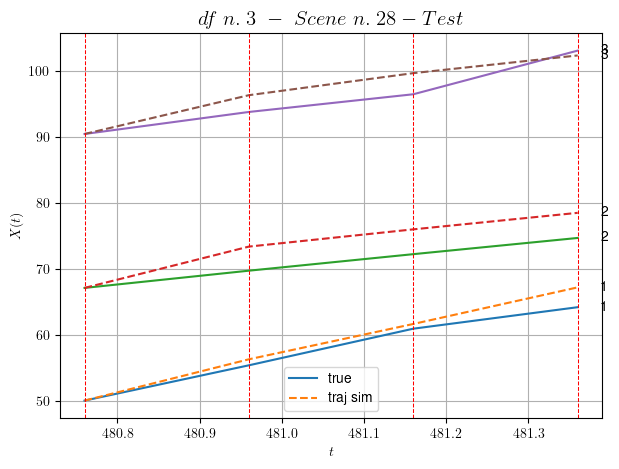

        For scene 28/30:
        * MSE = 5.780829959631414
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/30


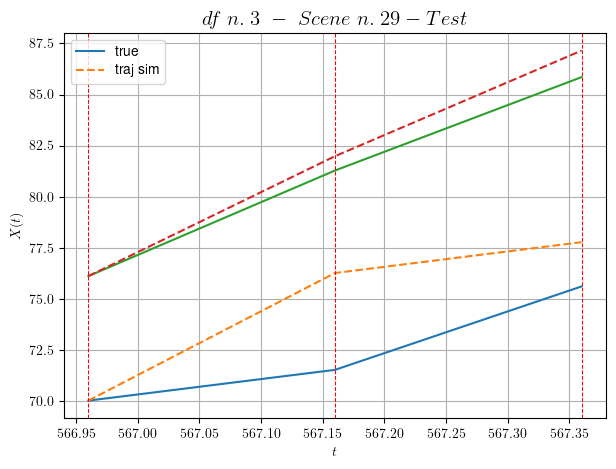

        For scene 29/30:
        * MSE = 4.897628090408637
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/30


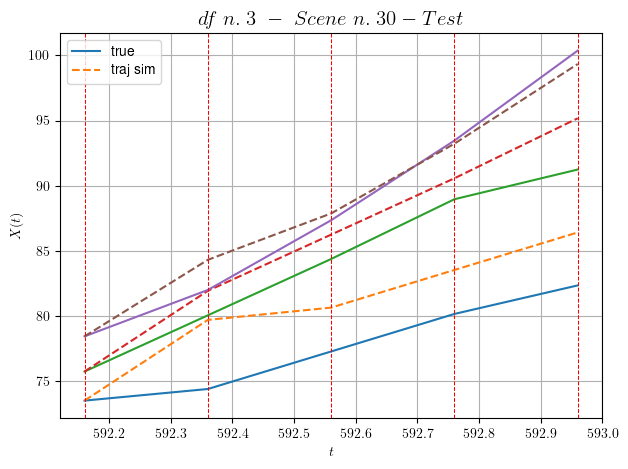

        For scene 30/30:
        * MSE = 6.610520944473914
----------------------------------------------------------------------------------------------------


MSE test: 3.3881866225607484

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.739989570181428
          * MSE test: 3.3881866225607484
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.4. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [399.24,399.84]


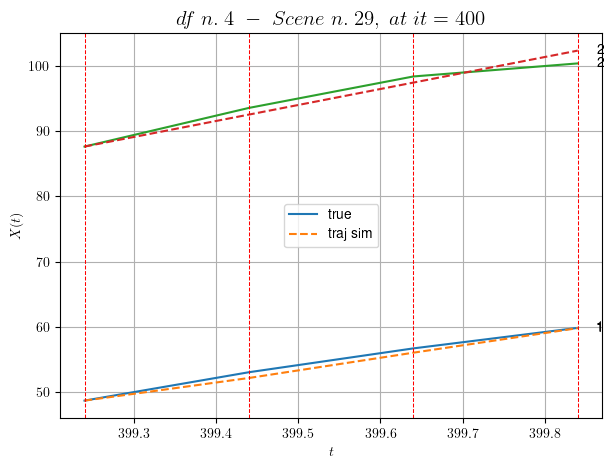

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.01 with mse=3.8662062824640655 at it=24
        * v0 = 24.51238648235069
        * MSE = 0.8735450299838055
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [128.24,129.24]


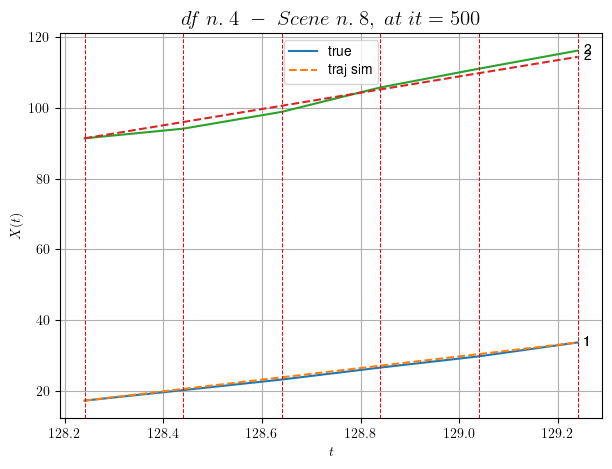

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.001 with mse=7.656209066826087 at it=24
        * v0 = 23.005181028725612
        * MSE = 0.9056913324963077
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [556.24,556.64]


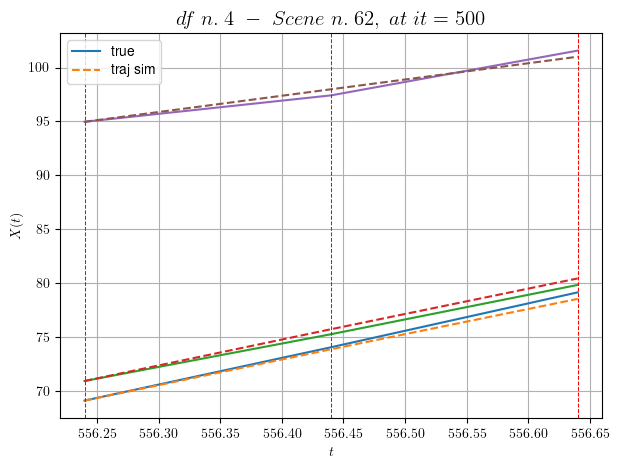

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.01 with mse=4.74674325302092 at it=24
        * v0 = 15.086092436632914
        * MSE = 0.1773484829835215
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.84,20.24]


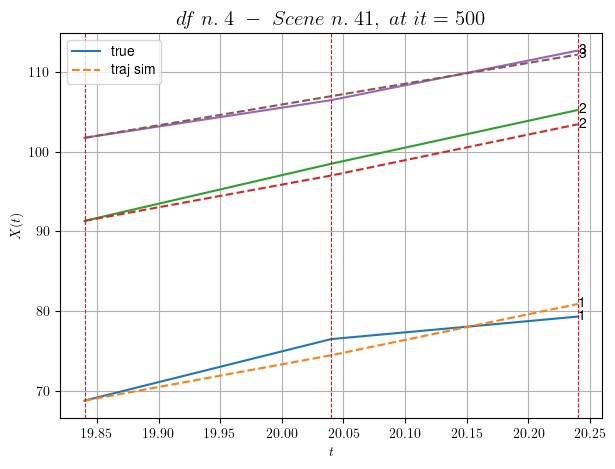

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.005 with mse=1.9842987688990146 at it=24
        * v0 = 26.058966670570207
        * MSE = 1.366883568541282
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [230.84,232.24]


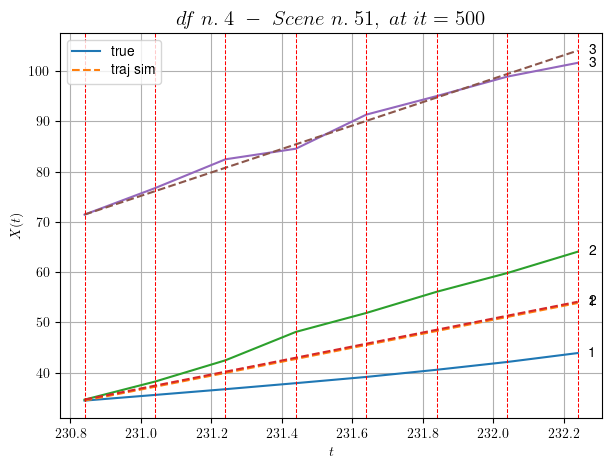

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.0005 with mse=21.31942173314089 at it=24
        * v0 = 23.322723002586443
        * MSE = 26.097267756144706
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [182.24,183.64]


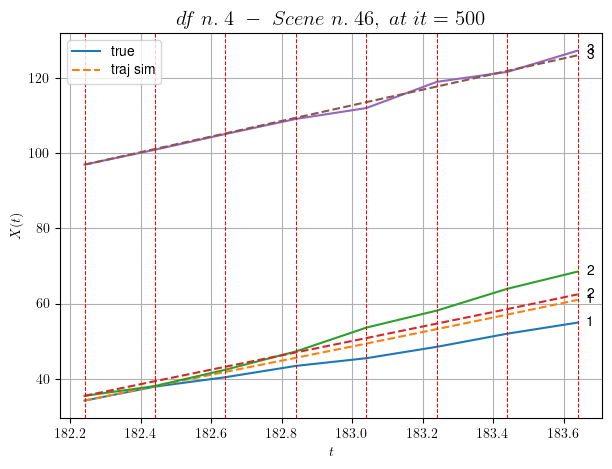

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.005 with mse=26.838816714766864 at it=24
        * v0 = 20.7731995672723
        * MSE = 8.338387055060778
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [266.84,269.04]


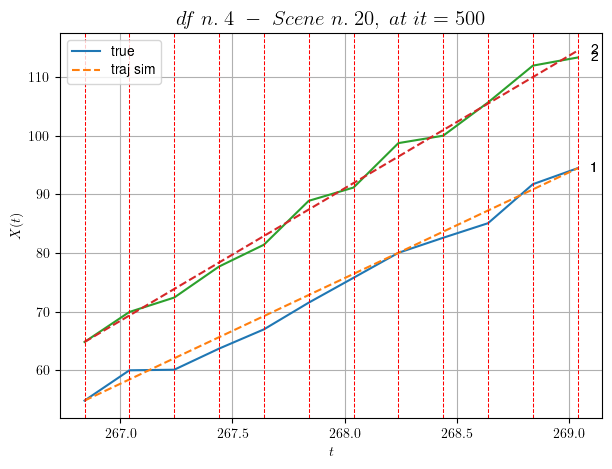

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.0005 with mse=46.80108442294578 at it=24
        * v0 = 22.599995584638805
        * MSE = 1.7895655550960547
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [440.44,440.84]


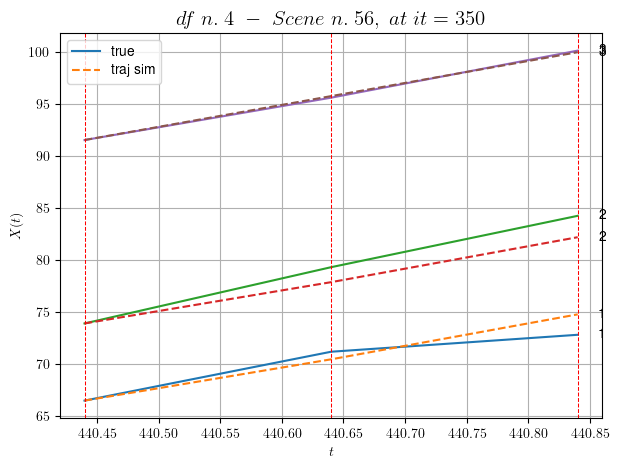

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.005 with mse=3.0279955164635832 at it=24
        * v0 = 21.12705861241983
        * MSE = 1.193064349870607
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [7.04,7.44]


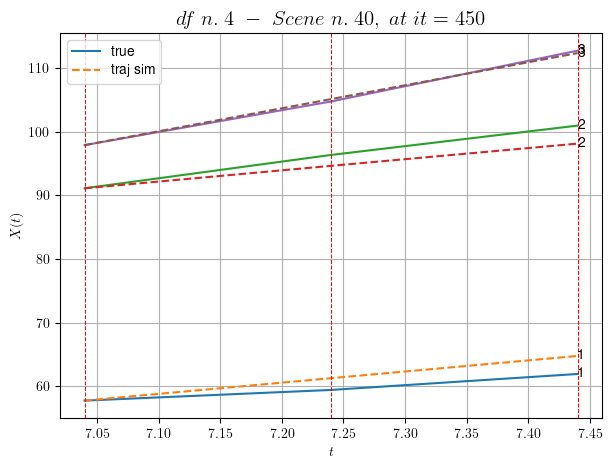

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.01 with mse=3.4542905003934137 at it=24
        * v0 = 36.154229124863036
        * MSE = 2.5175571561845054
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [374.24,375.04]


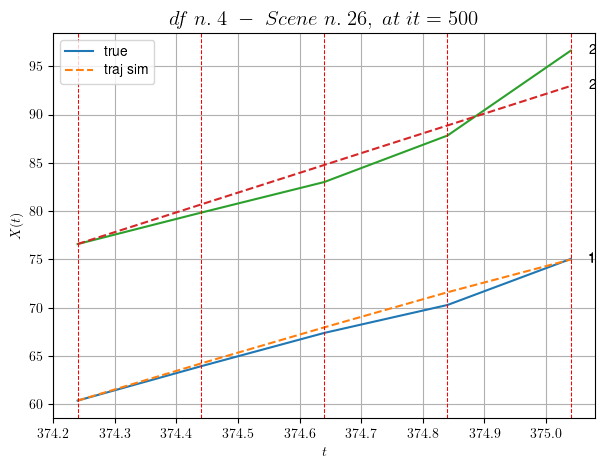

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.01 with mse=10.371247039907619 at it=24
        * v0 = 20.475722036933877
        * MSE = 2.0074420813157903
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [584.84,585.44]


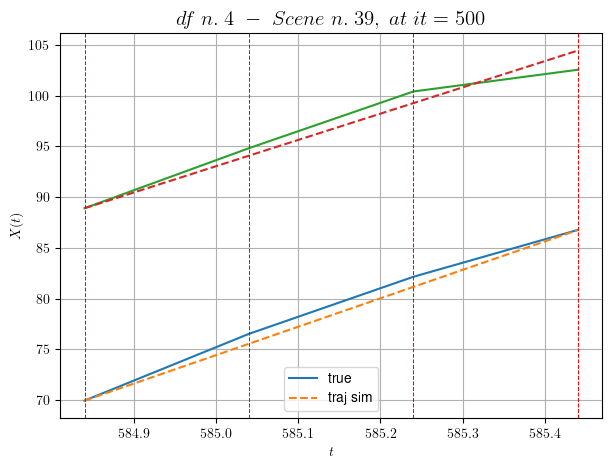

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=5e-05 with mse=2.6621007309958893 at it=24
        * v0 = 25.88944052970489
        * MSE = 0.9215044765144308
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [176.24,177.24]


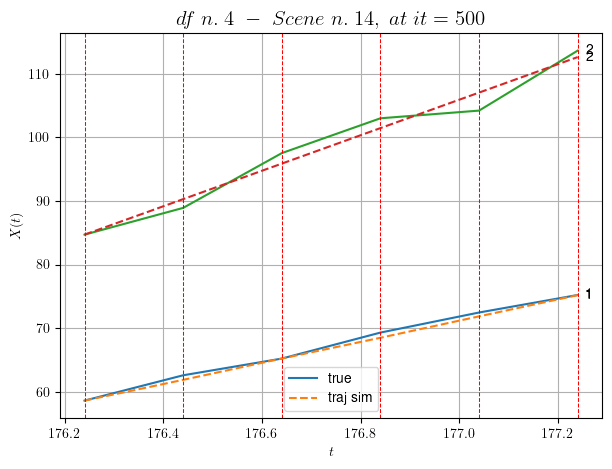

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.005 with mse=2.2631193135235366 at it=24
        * v0 = 27.94819777081733
        * MSE = 1.4684764376617523
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [224.84,227.24]


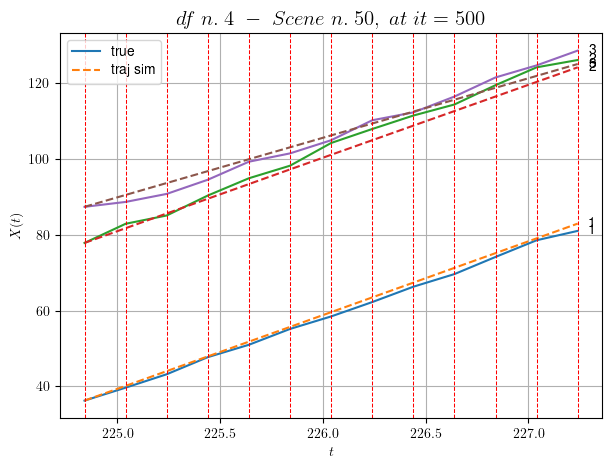

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.001 with mse=128.14723112555785 at it=24
        * v0 = 15.7136771300548
        * MSE = 3.0408107167579863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [67.64,68.04]


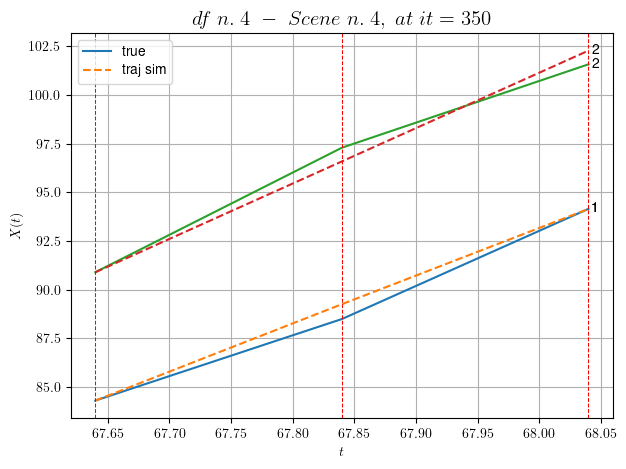

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.001 with mse=9.64911244419734 at it=24
        * v0 = 28.464980033502524
        * MSE = 0.262243331847071
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [205.84,206.84]


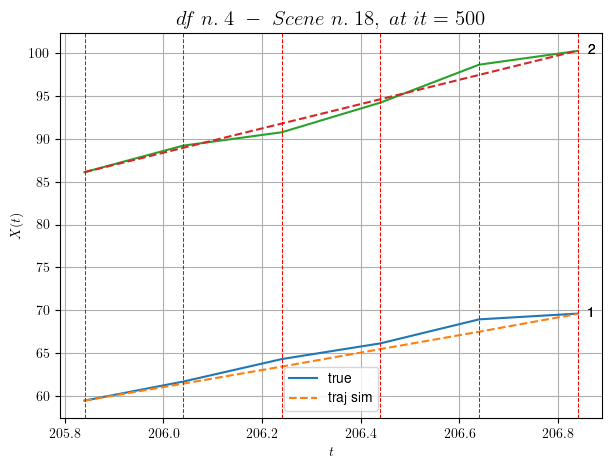

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.005 with mse=45.75279390098836 at it=24
        * v0 = 14.204943221367984
        * MSE = 0.4967520590472977
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 15 time intervals inside [129.84,132.84]


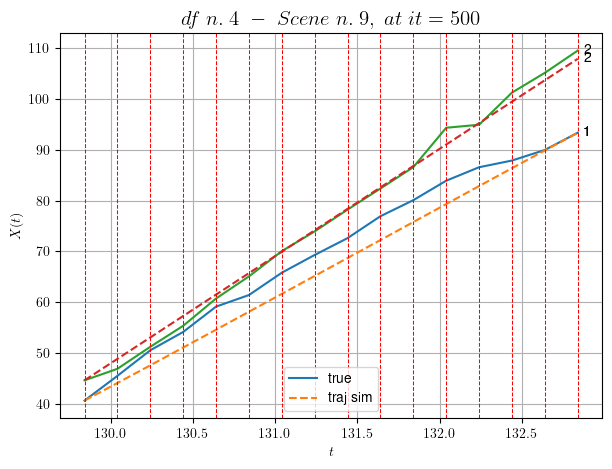

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.005 with mse=120.14686422438469 at it=24
        * v0 = 21.068534244852284
        * MSE = 5.772263981587506
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [422.64,423.64]


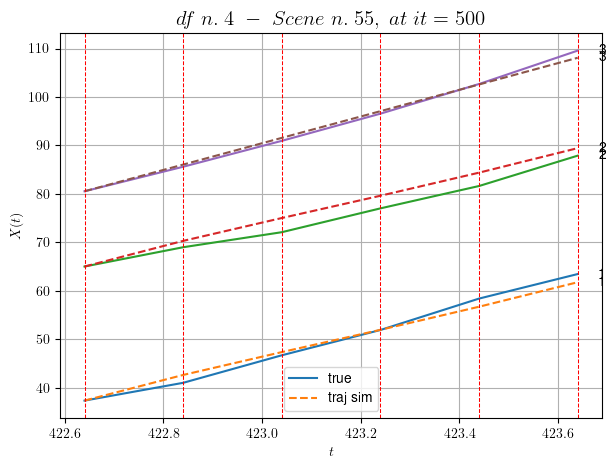

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.01 with mse=2.3745285823646767 at it=24
        * v0 = 27.54508960777844
        * MSE = 1.8948707872206647
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [122.84,123.84]


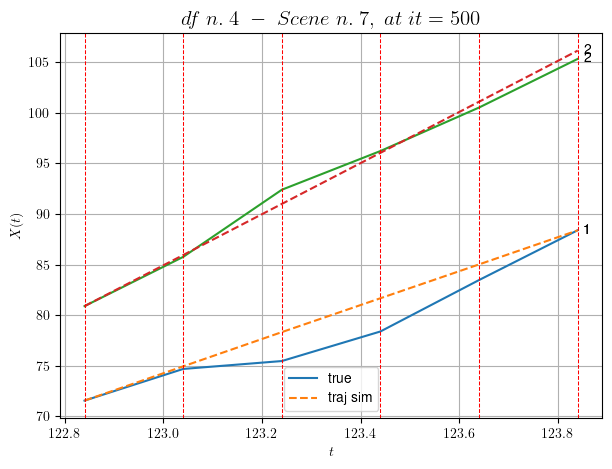

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=5.403622975111803 at it=24
        * v0 = 25.259320008419433
        * MSE = 2.0295939054944196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [500.04,501.04]


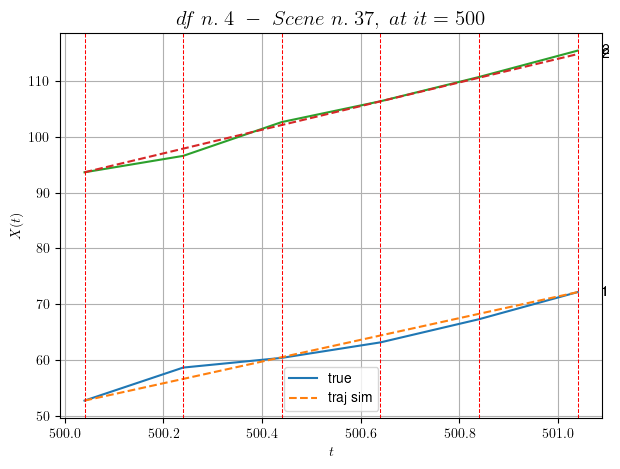

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=5e-05 with mse=14.01771678889032 at it=24
        * v0 = 21.189572495102674
        * MSE = 0.6876651774944141
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [313.84,314.44]


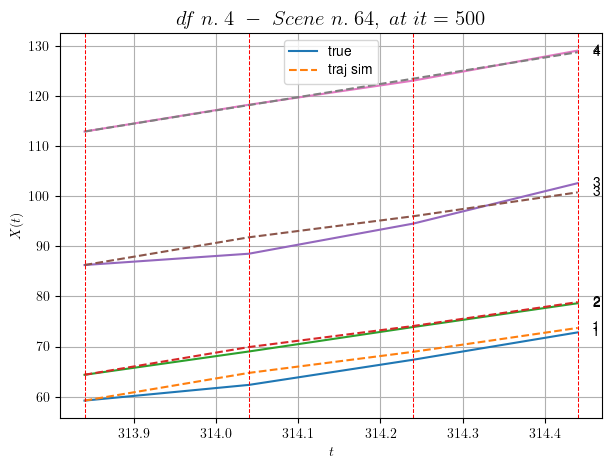

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.01 with mse=2.555932464427451 at it=24
        * v0 = 26.415529524805063
        * MSE = 1.59940608814701
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [541.84,542.84]


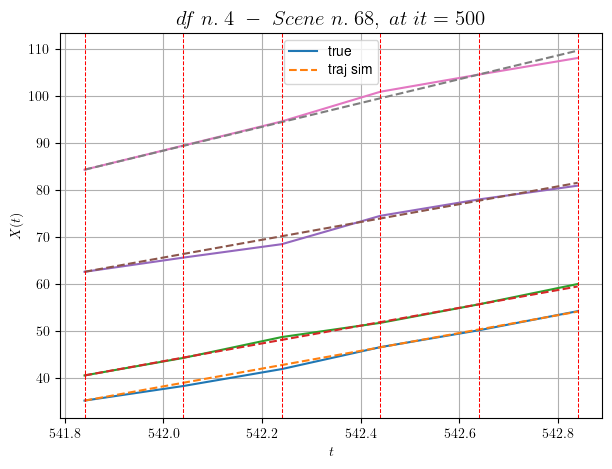

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.001 with mse=27.604404856051822 at it=24
        * v0 = 25.31159160096248
        * MSE = 0.439644842349902
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [195.44,197.24]


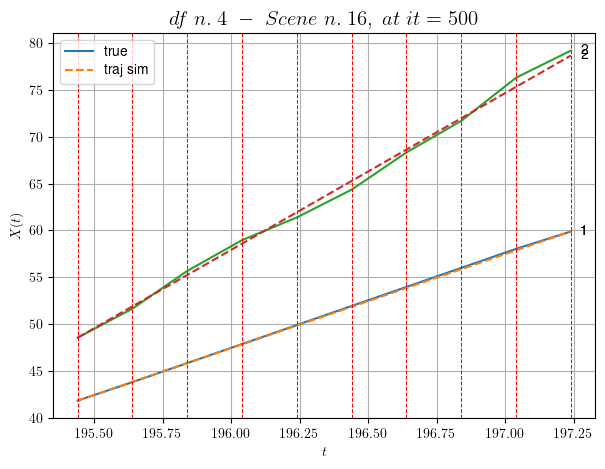

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.01 with mse=99.42754674585032 at it=24
        * v0 = 16.73844314065949
        * MSE = 0.15138087781709075
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.64,388.44]


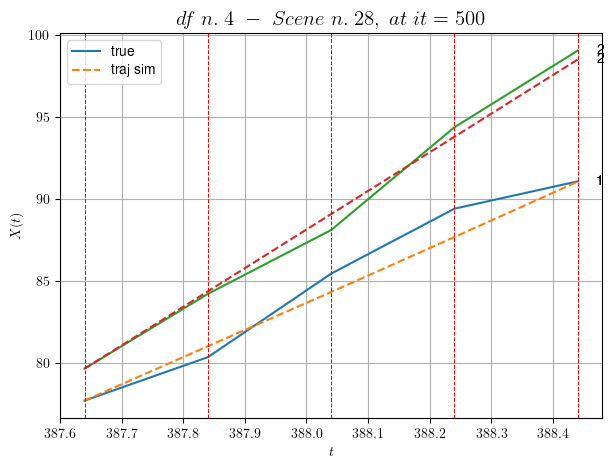

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.001 with mse=5.350214304472313 at it=24
        * v0 = 23.572406443207264
        * MSE = 0.6291580195227405
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


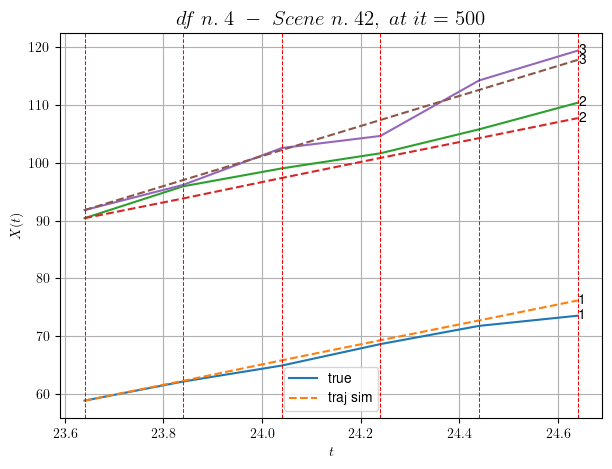

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.005 with mse=3.96333251840491 at it=24
        * v0 = 25.97457555941862
        * MSE = 2.193851506587293
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [378.64,379.24]


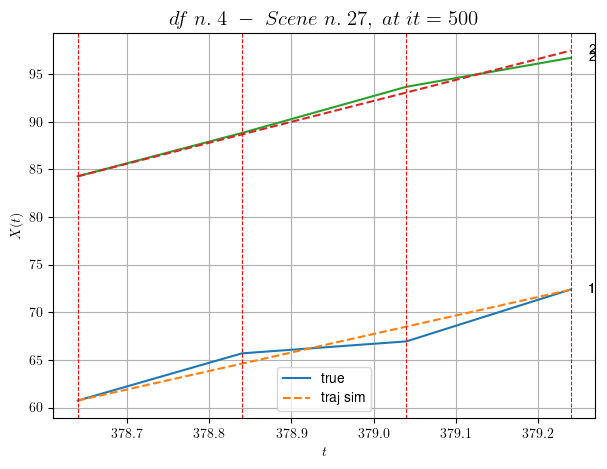

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=5e-05 with mse=5.433004698673849 at it=24
        * v0 = 21.986682448765315
        * MSE = 0.5330124035801169
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [222.84,223.44]


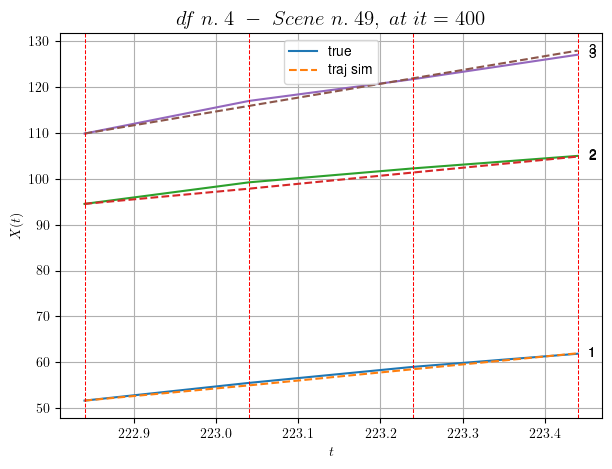

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=0.005 with mse=0.4648055115489543 at it=24
        * v0 = 30.10792852352175
        * MSE = 0.3790022028923672
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [321.84,323.84]


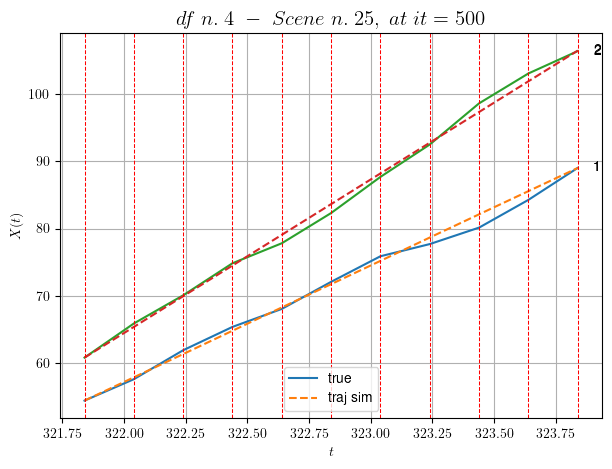

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.001 with mse=36.254777297487394 at it=24
        * v0 = 22.81009773351758
        * MSE = 0.6766829722969825
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [520.04,521.64]


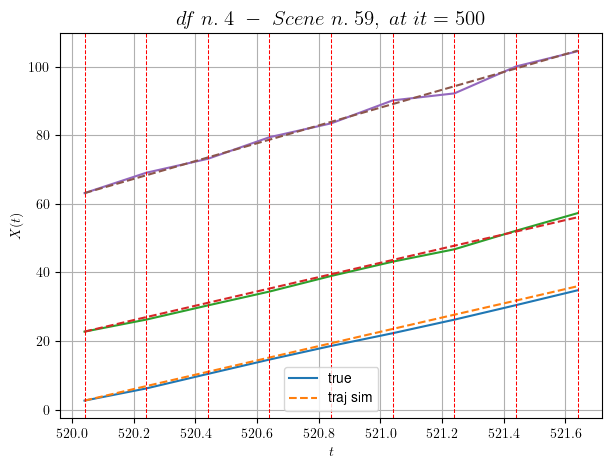

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.005 with mse=5.736269271805566 at it=24
        * v0 = 25.96280732717801
        * MSE = 0.767419320151911
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [575.04,575.84]


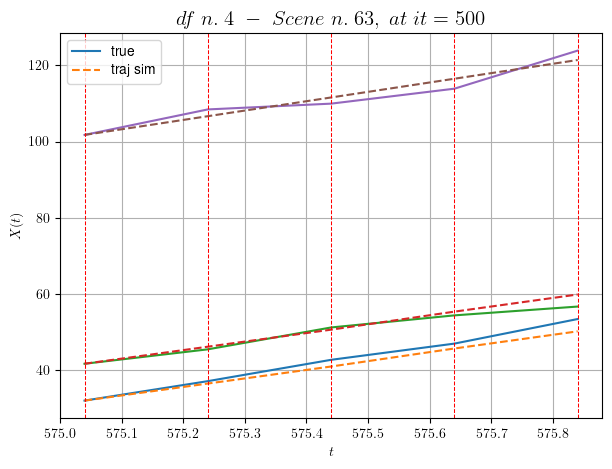

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=5.788657874240935 at it=24
        * v0 = 24.545621507401012
        * MSE = 3.0583224709582457
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [153.04,153.44]


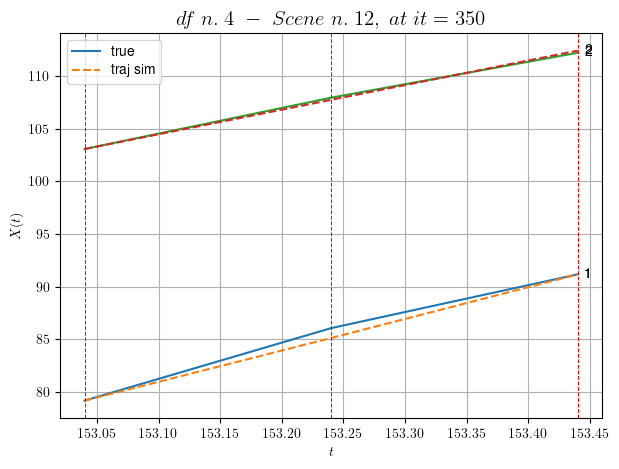

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=0.001 with mse=1.7809259867018155 at it=24
        * v0 = 23.385109159661944
        * MSE = 0.1601324758149442
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [419.84,421.84]


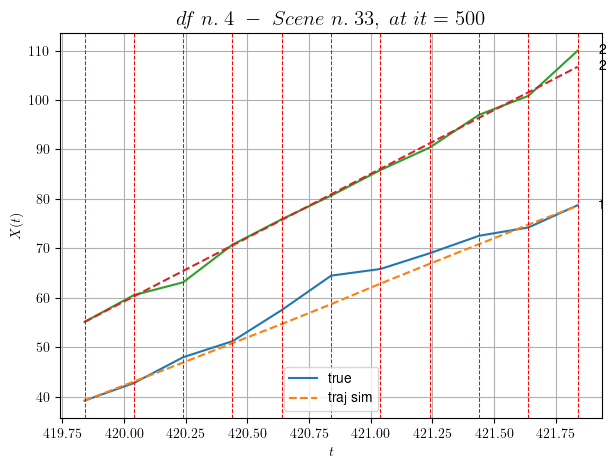

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.005 with mse=14.496500486440867 at it=24
        * v0 = 25.806420226564676
        * MSE = 3.4511548397483103
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [462.64,463.04]


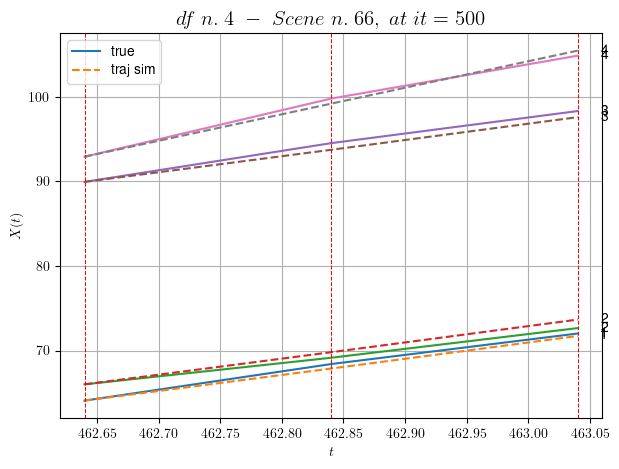

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.005 with mse=0.35393877846901195 at it=24
        * v0 = 31.352447205664888
        * MSE = 0.3013942037799349
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [495.24,495.84]


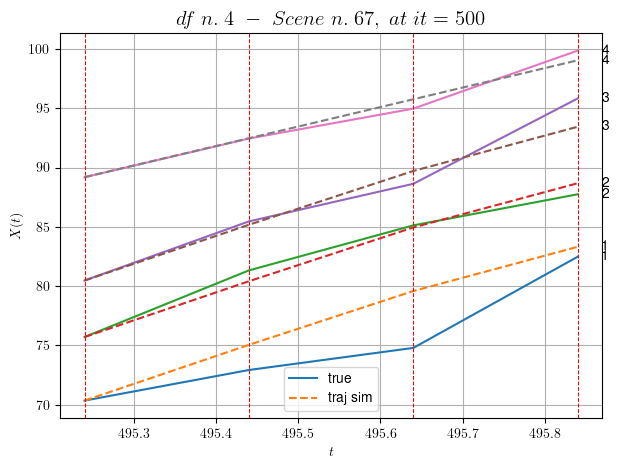

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.01 with mse=8.851713588585735 at it=24
        * v0 = 16.437805482237593
        * MSE = 2.3639097634875488
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [566.84,569.24]


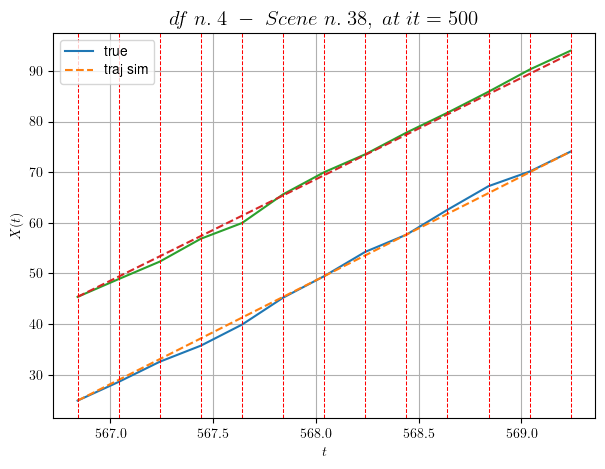

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.0005 with mse=96.56622116608396 at it=24
        * v0 = 20.028487582196743
        * MSE = 0.4792014473389755
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [406.24,406.64]


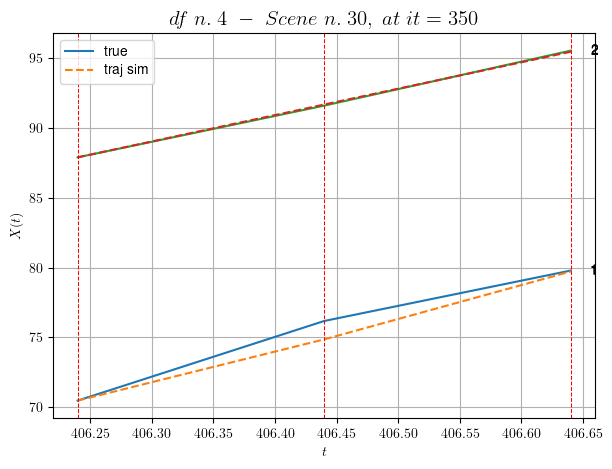

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.005 with mse=5.876833541982845 at it=24
        * v0 = 18.926519727481644
        * MSE = 0.29183910851596967
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [89.04,89.84]


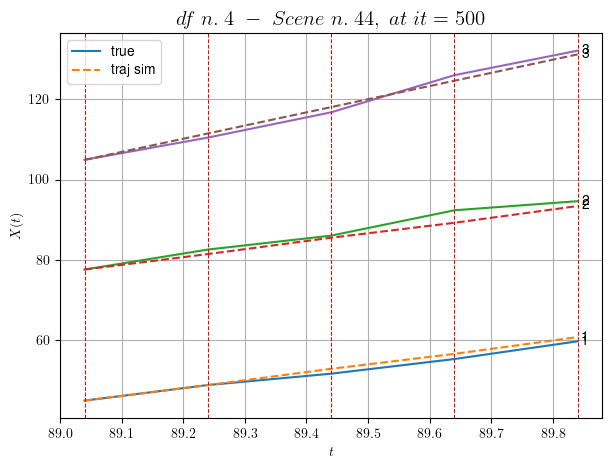

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.01 with mse=2.6590996323105625 at it=24
        * v0 = 32.77543163260266
        * MSE = 1.4902454840369834
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [460.84,461.24]


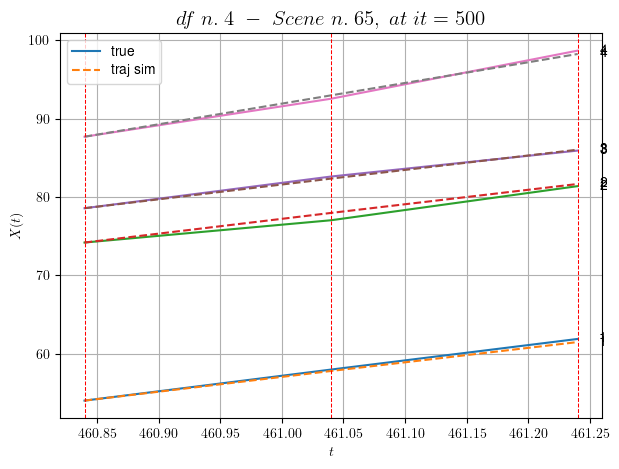

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.01 with mse=0.2995627898873837 at it=24
        * v0 = 26.404314529225093
        * MSE = 0.13201603832084186
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [59.84,60.44]


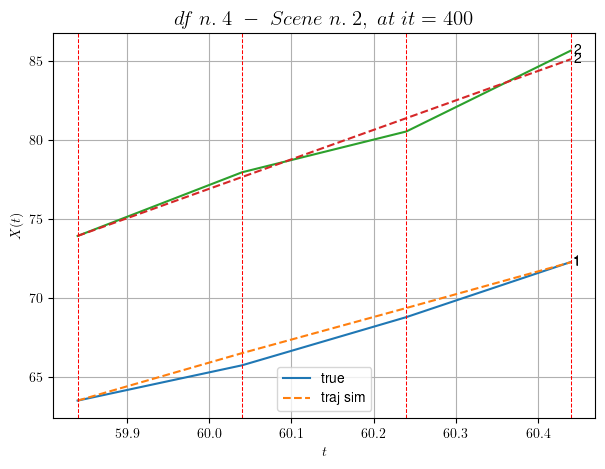

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.005 with mse=9.234646452427267 at it=24
        * v0 = 18.62551828792452
        * MSE = 0.25161735984961586
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [302.44,302.84]


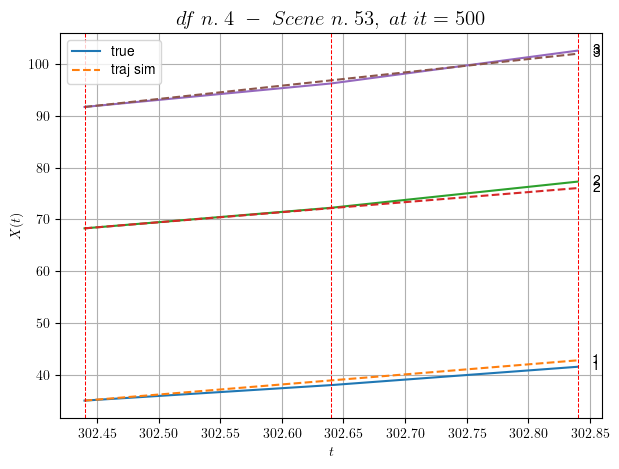

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.001 with mse=0.8110354922212407 at it=24
        * v0 = 25.744538233026674
        * MSE = 0.511464879550297
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [288.04,289.04]


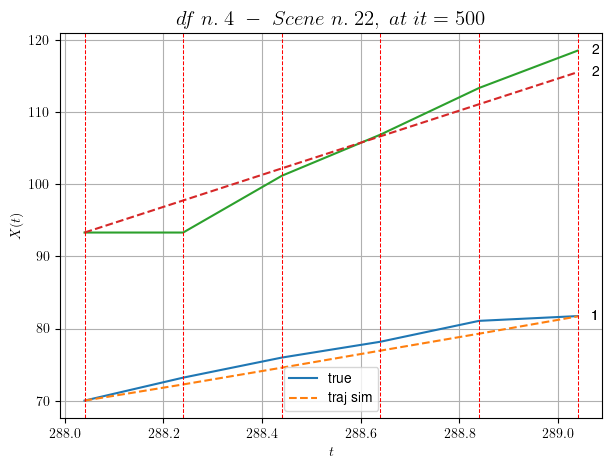

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.005 with mse=10.285513313688995 at it=24
        * v0 = 22.24789971530882
        * MSE = 3.2182382949475286
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


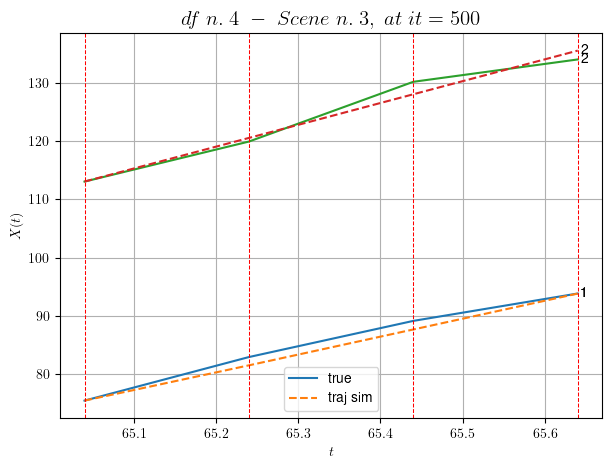

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.001 with mse=5.053145451709737 at it=24
        * v0 = 37.41903742148366
        * MSE = 1.42528626370047
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


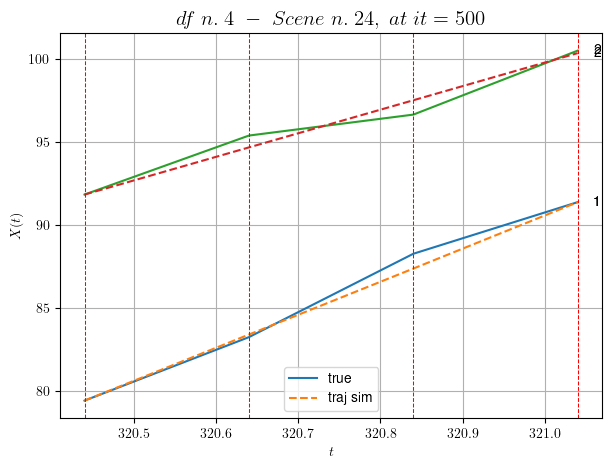

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.0005 with mse=18.337187419198894 at it=24
        * v0 = 14.162426648994275
        * MSE = 0.26062290785581405
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


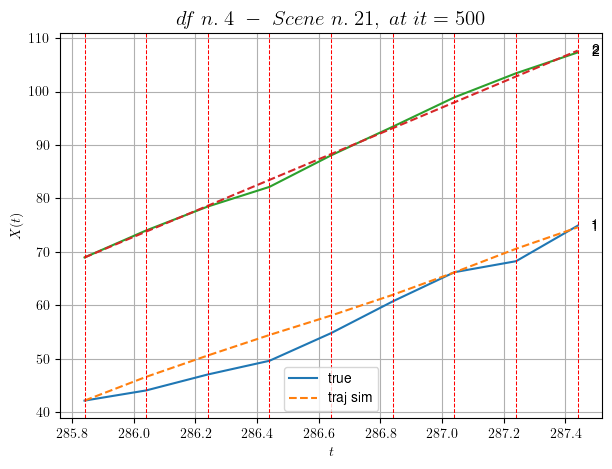

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.01 with mse=16.947519161802987 at it=24
        * v0 = 24.20183084742258
        * MSE = 2.1695970105996722
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


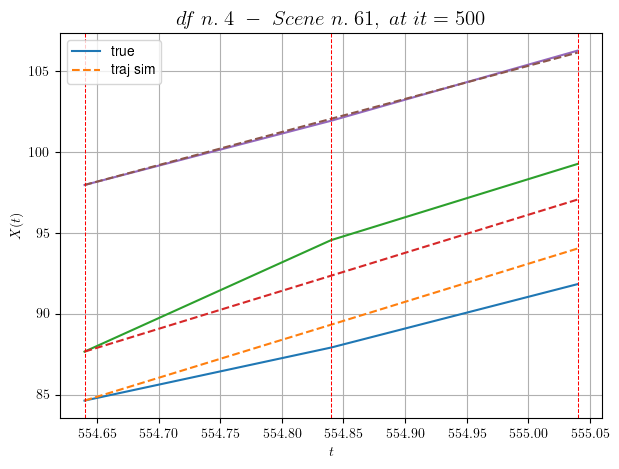

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.0005 with mse=2.351919127252914 at it=24
        * v0 = 20.44072781876008
        * MSE = 1.8348189465209161
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


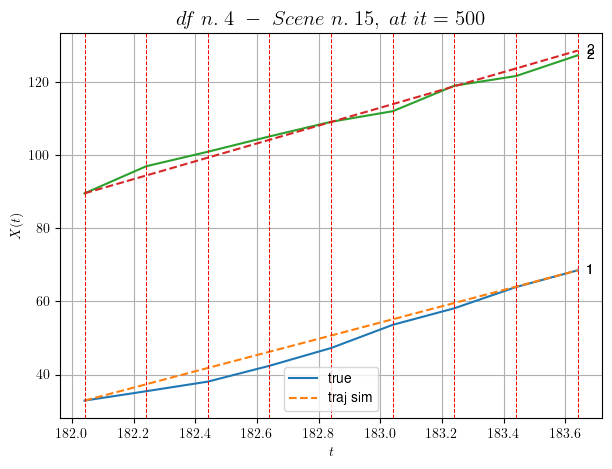

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.0005 with mse=21.026422747134347 at it=24
        * v0 = 24.3849534285798
        * MSE = 3.7426666601339145
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


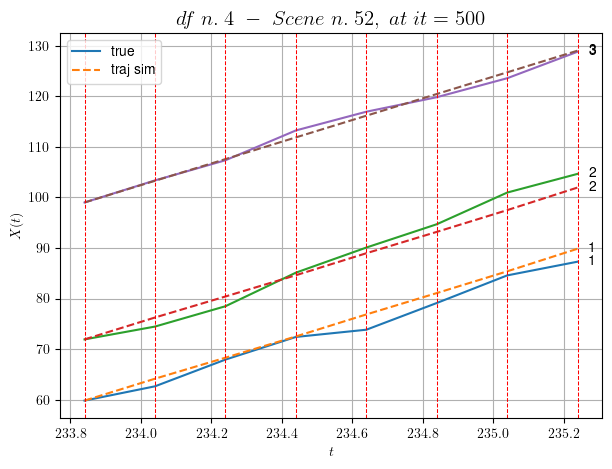

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.005 with mse=20.34726204736482 at it=24
        * v0 = 21.462806471988753
        * MSE = 2.3786168274436523
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 2.102861662114173
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.4. Scene n.1/23


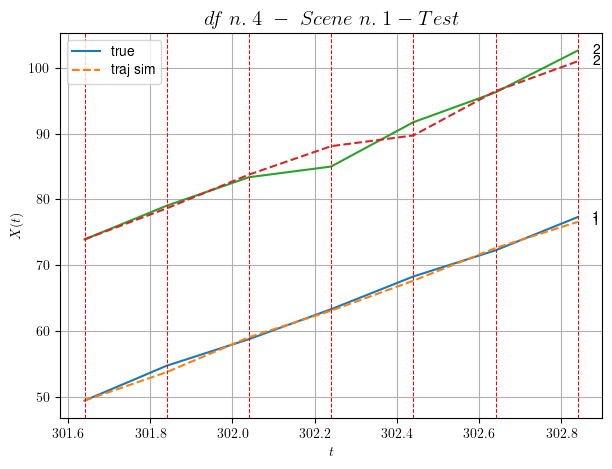

        For scene 1/23:
        * MSE = 1.3444642405251905
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/23


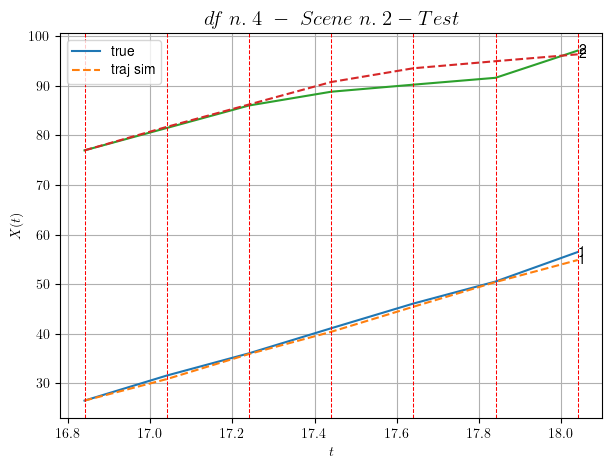

        For scene 2/23:
        * MSE = 2.189428541270505
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/23


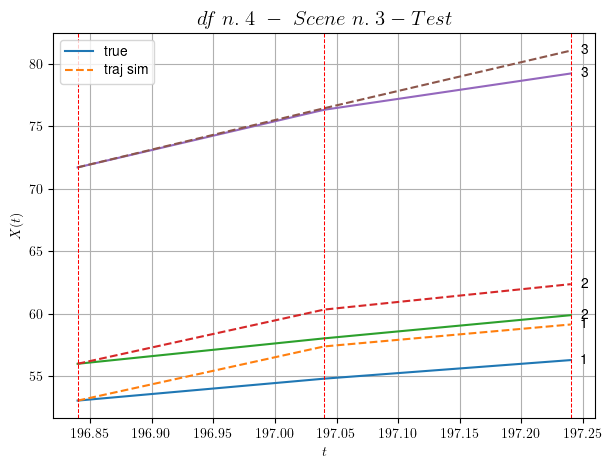

        For scene 3/23:
        * MSE = 3.2838196231012984
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/23


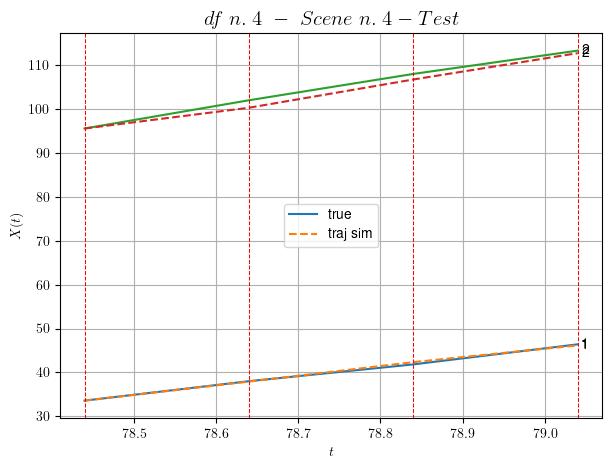

        For scene 4/23:
        * MSE = 0.6441461098377008
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/23


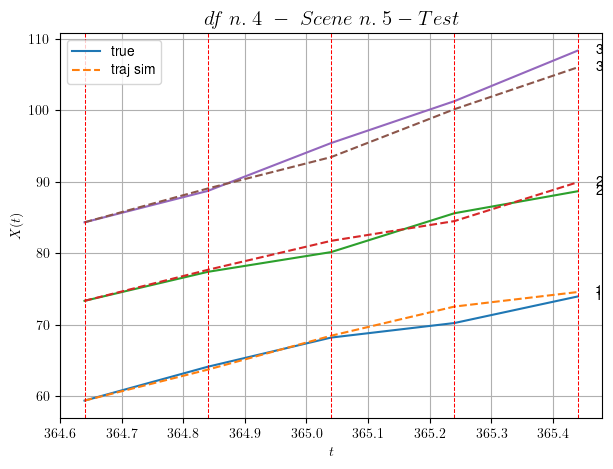

        For scene 5/23:
        * MSE = 1.4638058892306585
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/23


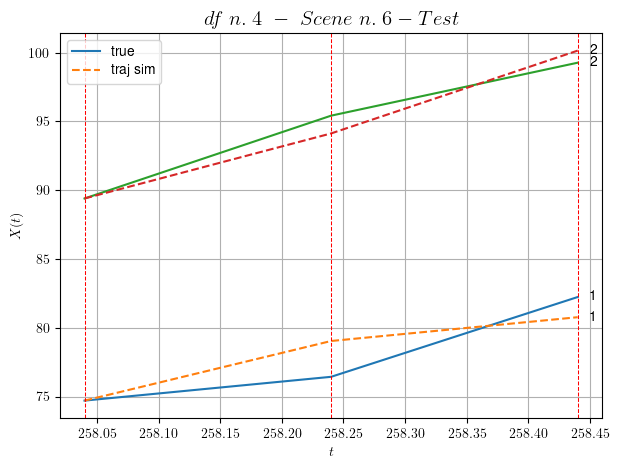

        For scene 6/23:
        * MSE = 1.8951388406887868
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/23


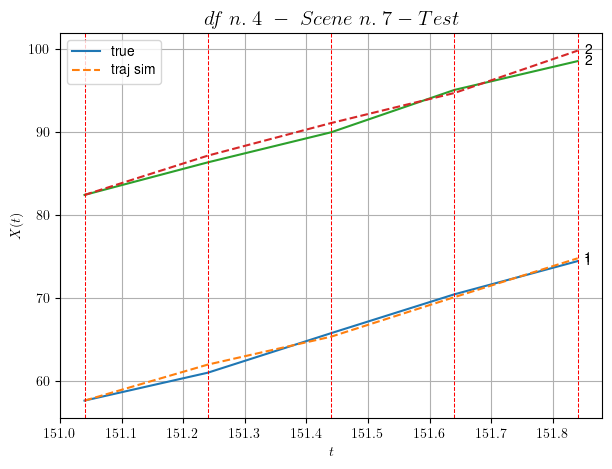

        For scene 7/23:
        * MSE = 0.4980381241988841
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/23


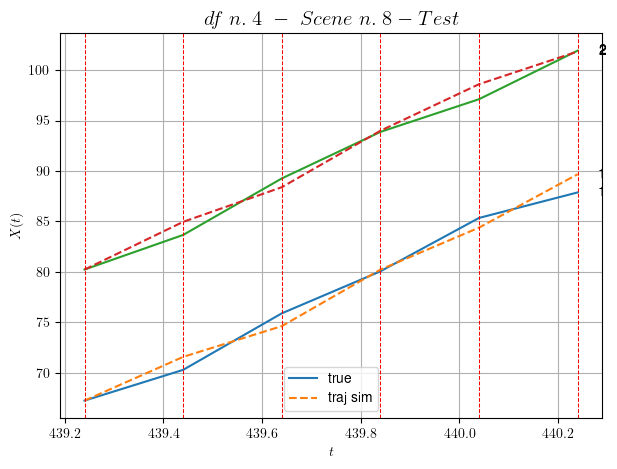

        For scene 8/23:
        * MSE = 1.0119584149237646
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/23


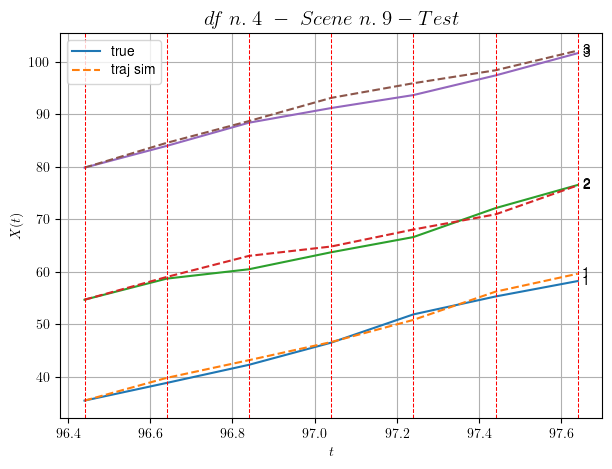

        For scene 9/23:
        * MSE = 1.3042451619066098
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/23


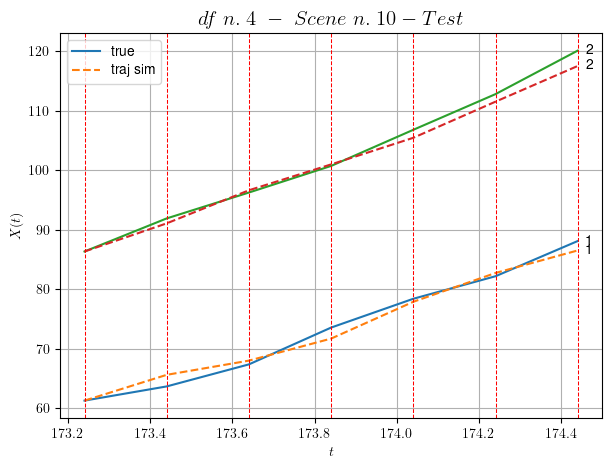

        For scene 10/23:
        * MSE = 1.547165005554965
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/23


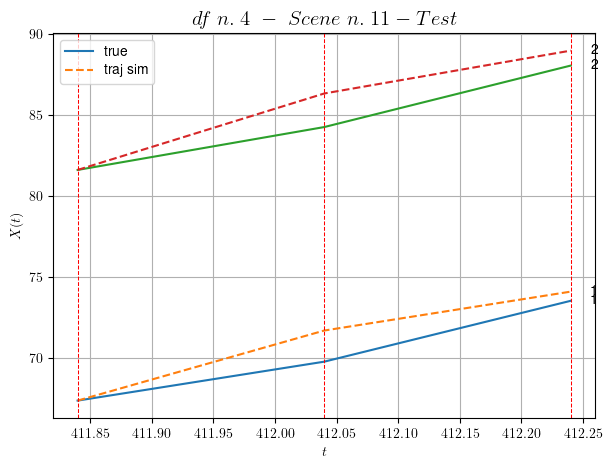

        For scene 11/23:
        * MSE = 1.5324496529481335
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/23


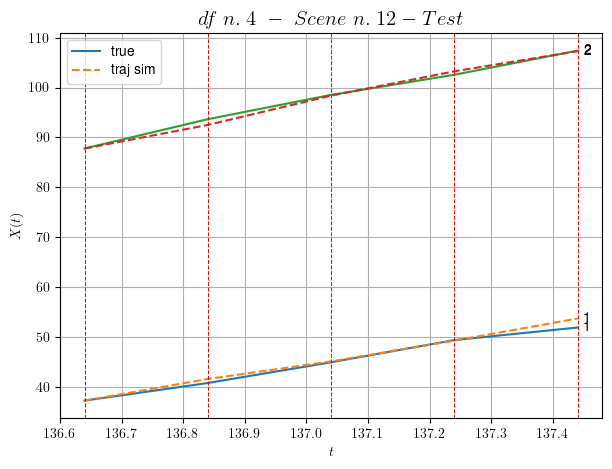

        For scene 12/23:
        * MSE = 0.5815164605866379
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/23


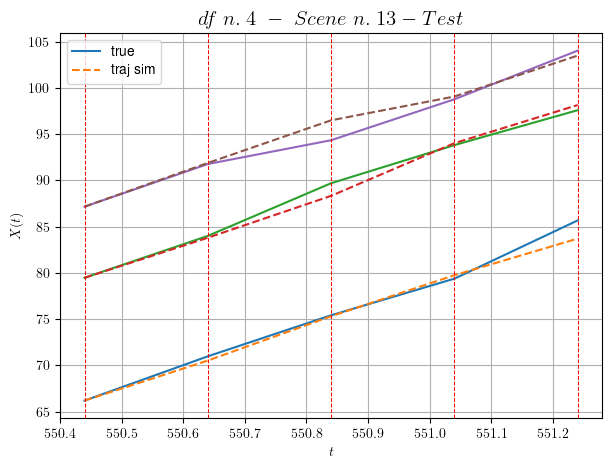

        For scene 13/23:
        * MSE = 0.768011018419422
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/23


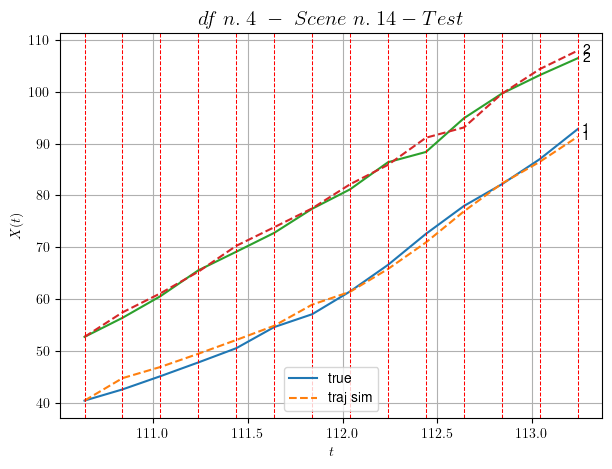

        For scene 14/23:
        * MSE = 1.5364332590950935
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/23


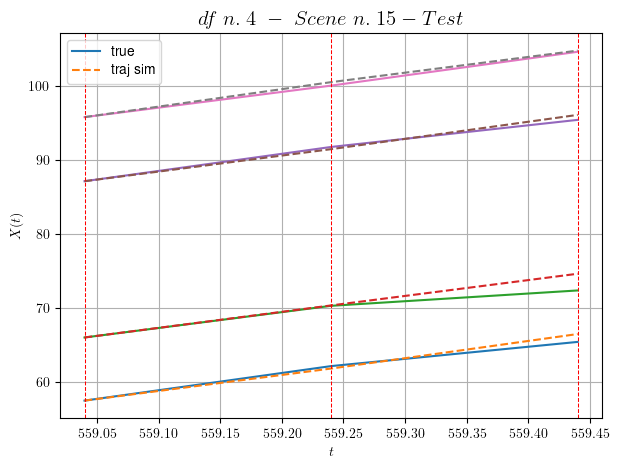

        For scene 15/23:
        * MSE = 0.593994783617872
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/23


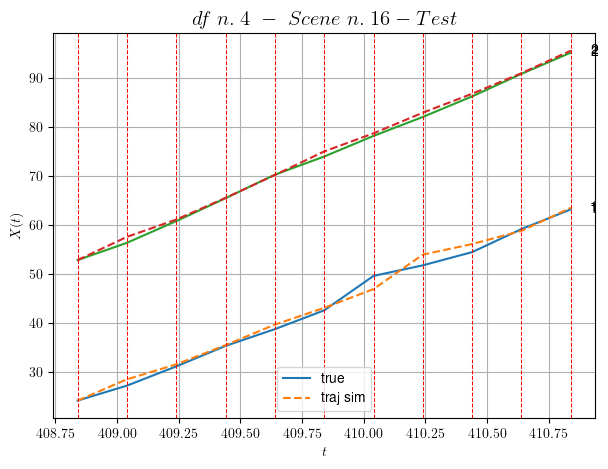

        For scene 16/23:
        * MSE = 0.9992805872342281
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/23


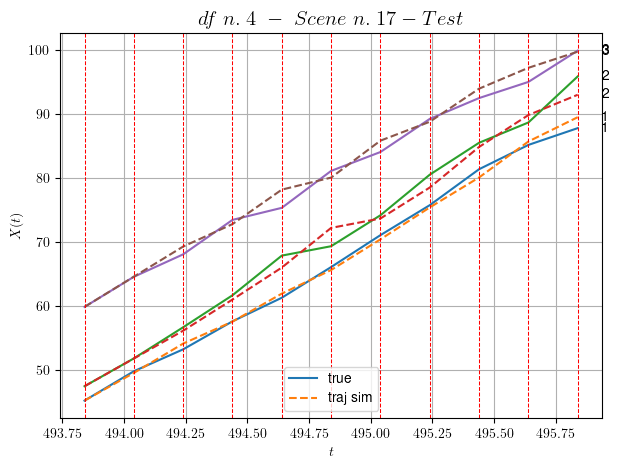

        For scene 17/23:
        * MSE = 1.6705370789305019
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/23


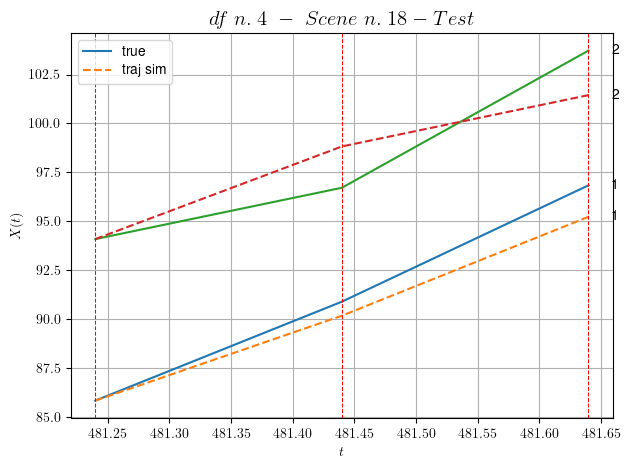

        For scene 18/23:
        * MSE = 2.116893773979118
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/23


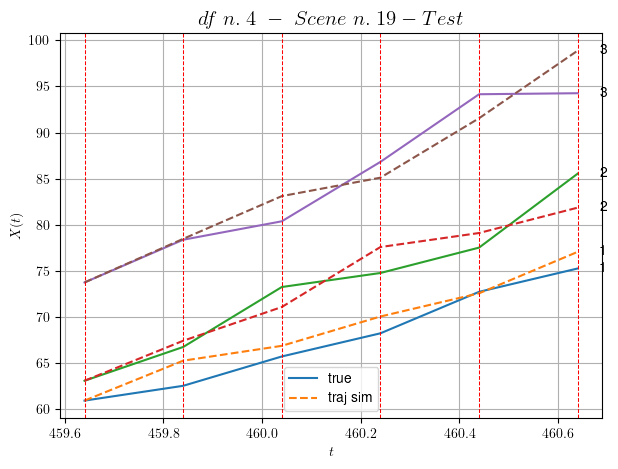

        For scene 19/23:
        * MSE = 4.610900220813672
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/23


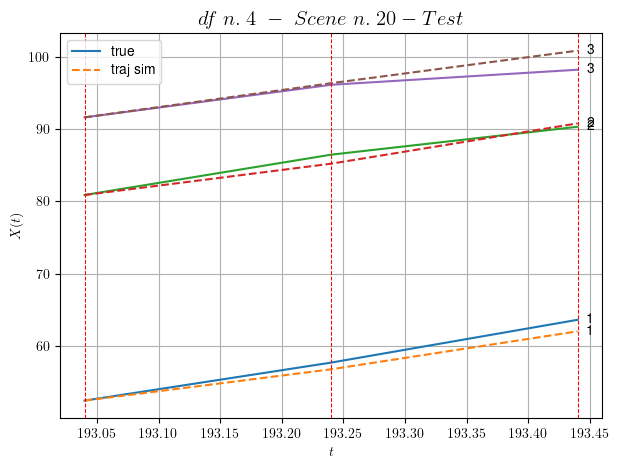

        For scene 20/23:
        * MSE = 1.3554251124855545
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/23


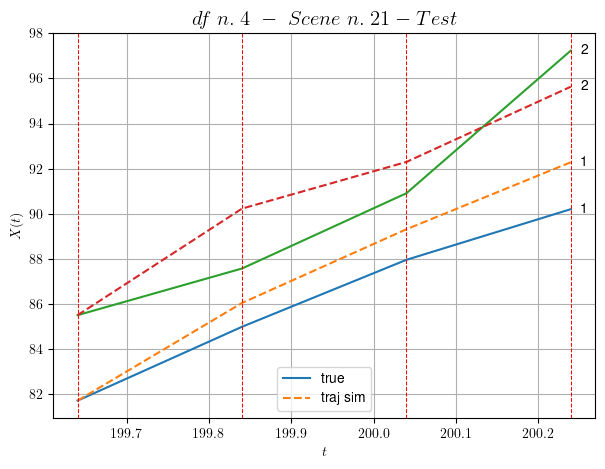

        For scene 21/23:
        * MSE = 2.3577351377382687
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/23


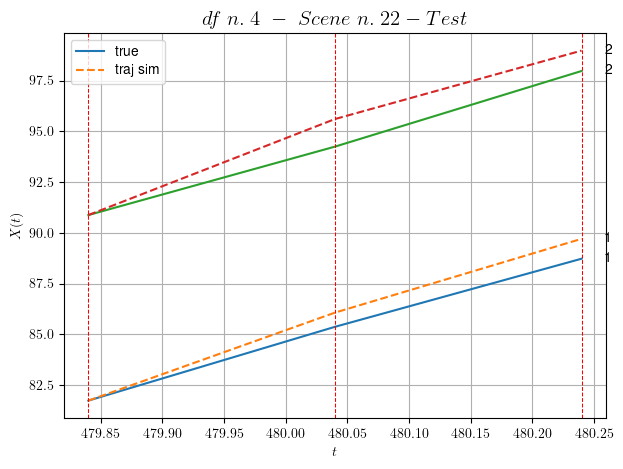

        For scene 22/23:
        * MSE = 0.71676058683349
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/23


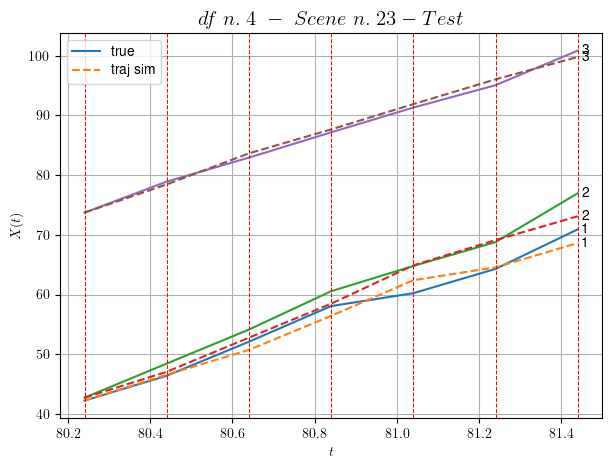

        For scene 23/23:
        * MSE = 1.96052704536016
----------------------------------------------------------------------------------------------------


MSE test: 1.5644641160556745

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 2.102861662114173
          * MSE test: 1.5644641160556745
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 44 scenes, the remaining 22 to test the model.

Training step. (44 scenes)
DataFrame n.5. Scene n.1/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.32,65.32]


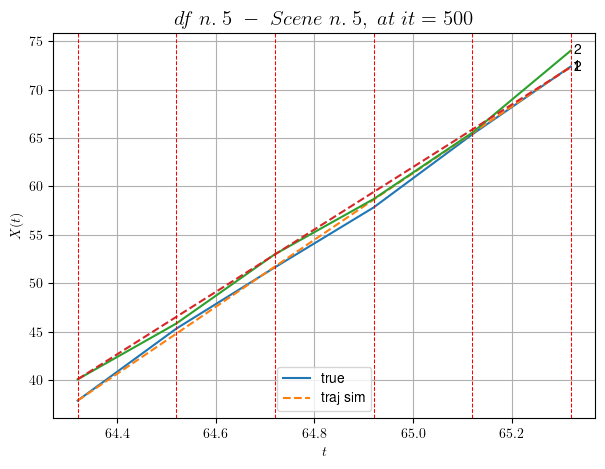

----------------------------------------------------------------------------------------------------
        For scene 1/44:
        * After LR finder: LR_NN=0.001 with mse=1.7260677011311618 at it=24
        * v0 = 32.23387857341356
        * MSE = 0.4144907277259815
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [502.72,503.72]


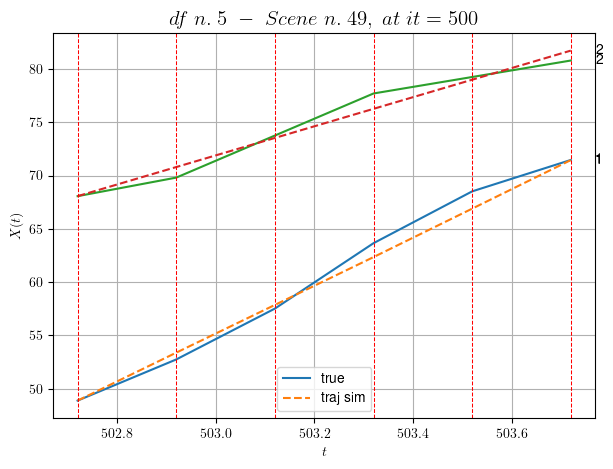

----------------------------------------------------------------------------------------------------
        For scene 2/44:
        * After LR finder: LR_NN=0.001 with mse=49.98334951249541 at it=24
        * v0 = 13.651414022050126
        * MSE = 0.7347238208910882
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [395.32,395.72]


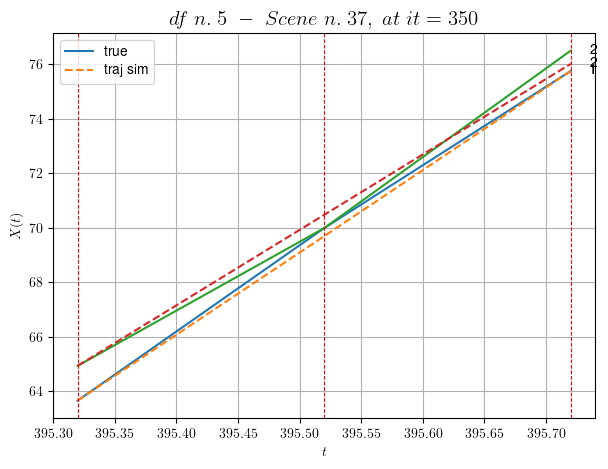

----------------------------------------------------------------------------------------------------
        For scene 3/44:
        * After LR finder: LR_NN=0.001 with mse=0.1805411746034078 at it=24
        * v0 = 27.699213315734358
        * MSE = 0.08581087453851749
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [225.72,226.12]


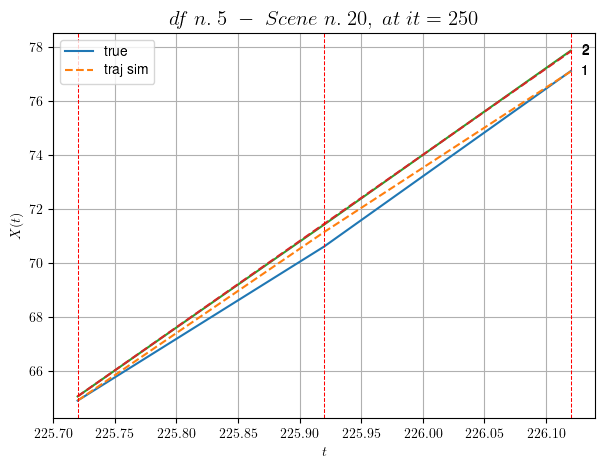

----------------------------------------------------------------------------------------------------
        For scene 4/44:
        * After LR finder: LR_NN=0.005 with mse=0.21202312777838217 at it=24
        * v0 = 32.02147602886386
        * MSE = 0.04624699582375287
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [177.32,178.52]


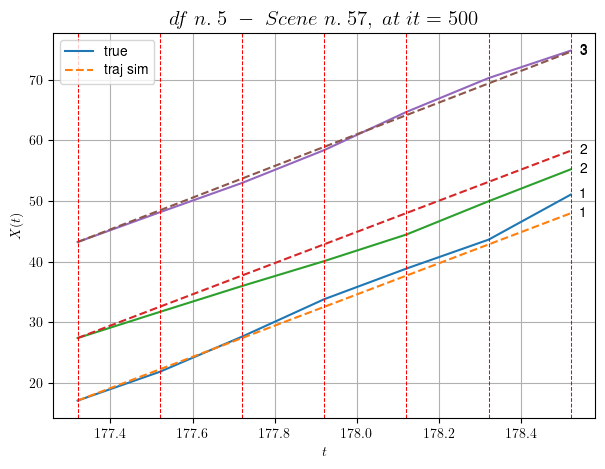

----------------------------------------------------------------------------------------------------
        For scene 5/44:
        * After LR finder: LR_NN=0.0005 with mse=5.1552276816128 at it=24
        * v0 = 26.180378384786444
        * MSE = 2.804739618264477
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [319.52,319.92]


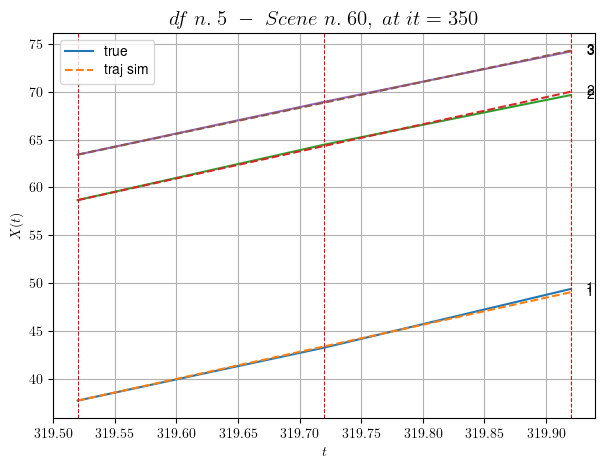

----------------------------------------------------------------------------------------------------
        For scene 6/44:
        * After LR finder: LR_NN=0.005 with mse=0.31314485069718195 at it=24
        * v0 = 27.222480010450116
        * MSE = 0.031737400687362506
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [316.92,317.32]


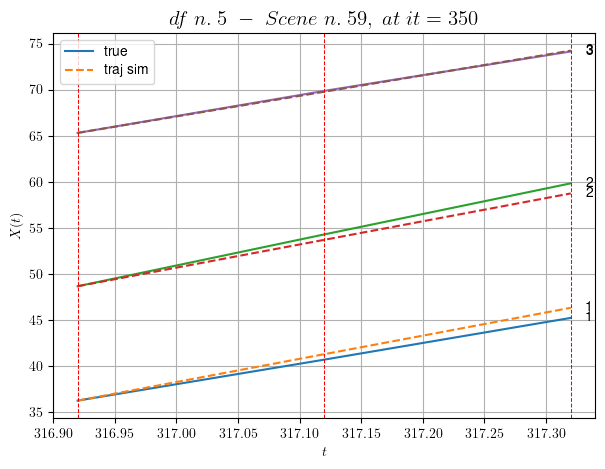

----------------------------------------------------------------------------------------------------
        For scene 7/44:
        * After LR finder: LR_NN=0.0005 with mse=1.405607447283077 at it=24
        * v0 = 22.342101196305528
        * MSE = 0.34609858671134835
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [533.12,533.52]


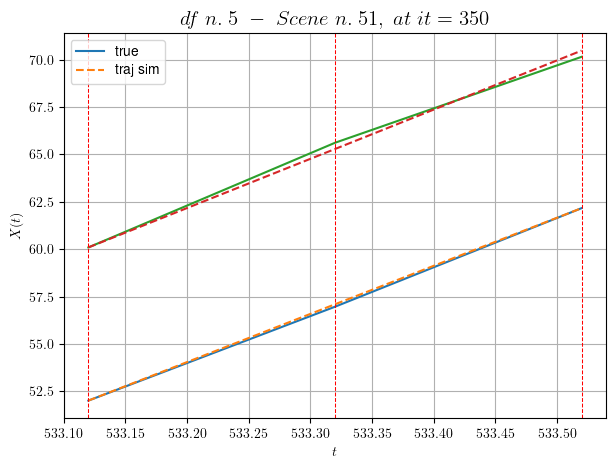

----------------------------------------------------------------------------------------------------
        For scene 8/44:
        * After LR finder: LR_NN=0.001 with mse=0.6753604077544989 at it=24
        * v0 = 25.948720360559975
        * MSE = 0.0387929003185639
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [332.72,334.12]


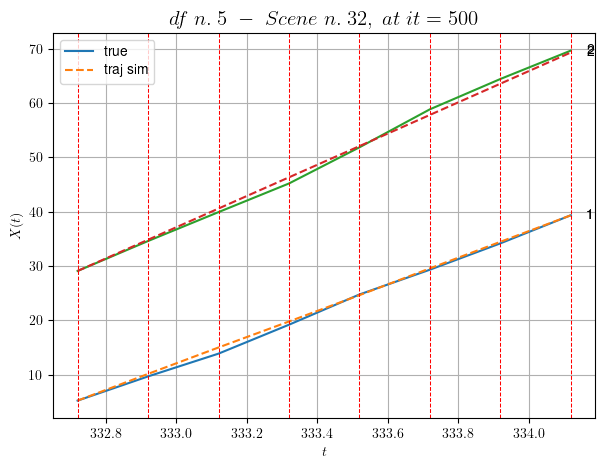

----------------------------------------------------------------------------------------------------
        For scene 9/44:
        * After LR finder: LR_NN=0.005 with mse=0.6917002820852631 at it=24
        * v0 = 28.714685816753477
        * MSE = 0.33237786529999525
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [457.32,458.32]


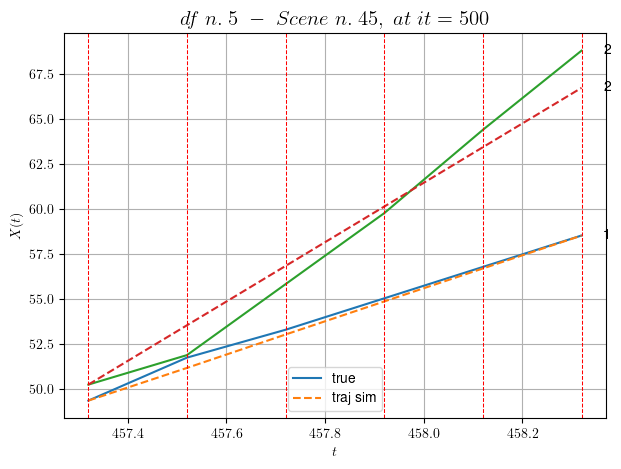

----------------------------------------------------------------------------------------------------
        For scene 10/44:
        * After LR finder: LR_NN=0.005 with mse=29.997573095651088 at it=24
        * v0 = 16.493097805853914
        * MSE = 0.6620874677103359
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [578.92,579.52]


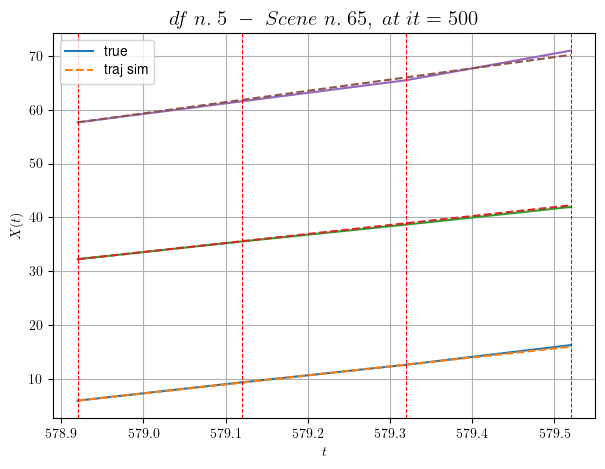

----------------------------------------------------------------------------------------------------
        For scene 11/44:
        * After LR finder: LR_NN=0.005 with mse=3.6360485390866066 at it=24
        * v0 = 20.916611347750116
        * MSE = 0.09551429940075733
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [167.32,167.72]


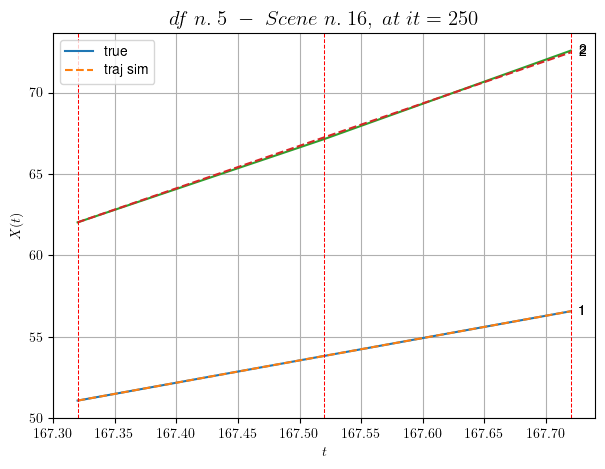

----------------------------------------------------------------------------------------------------
        For scene 12/44:
        * After LR finder: LR_NN=0.01 with mse=0.4811571666713386 at it=24
        * v0 = 26.107264726505786
        * MSE = 0.0034370013656676145
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [293.52,294.32]


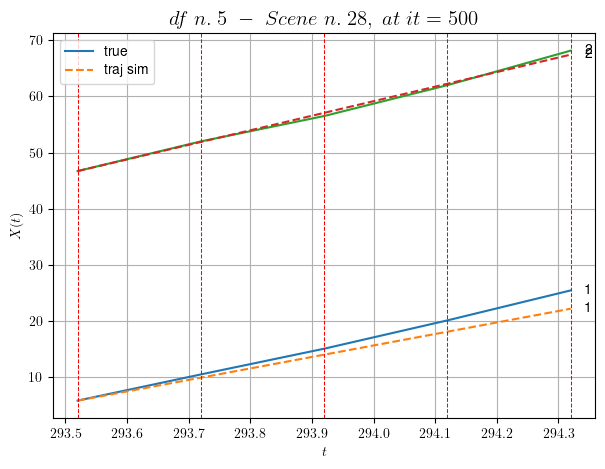

----------------------------------------------------------------------------------------------------
        For scene 13/44:
        * After LR finder: LR_NN=1e-05 with mse=1.9343254108310892 at it=24
        * v0 = 25.9305274823745
        * MSE = 1.7069760530490596
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [282.52,282.92]


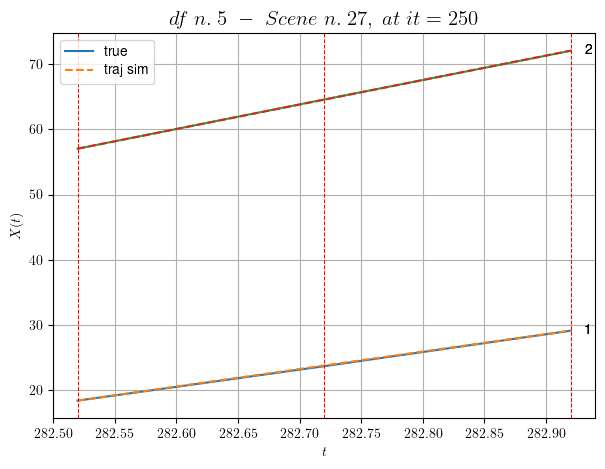

----------------------------------------------------------------------------------------------------
        For scene 14/44:
        * After LR finder: LR_NN=0.005 with mse=1.96204976532628 at it=24
        * v0 = 37.541185245583975
        * MSE = 0.0022028000432622735
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [274.12,275.52]


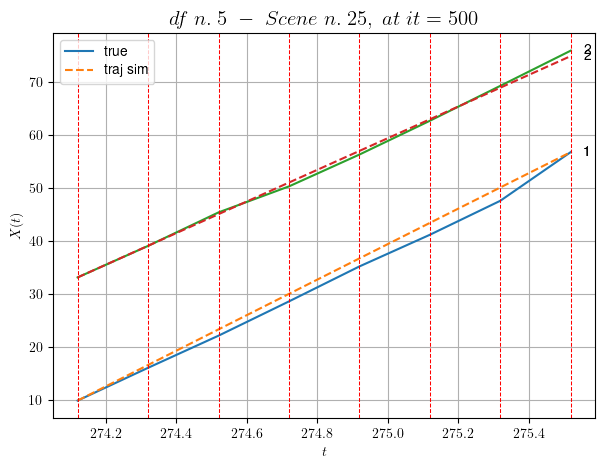

----------------------------------------------------------------------------------------------------
        For scene 15/44:
        * After LR finder: LR_NN=0.0005 with mse=1.8038371098109773 at it=24
        * v0 = 29.831436253445762
        * MSE = 0.5448485637882029
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [496.72,497.12]


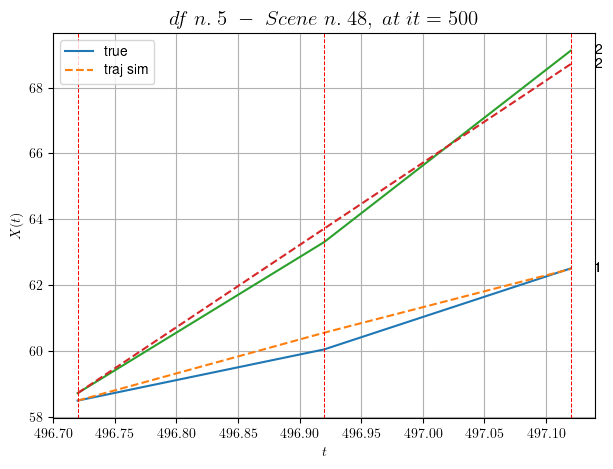

----------------------------------------------------------------------------------------------------
        For scene 16/44:
        * After LR finder: LR_NN=0.01 with mse=0.8005071281807956 at it=24
        * v0 = 25.01096626444741
        * MSE = 0.09763440977531183
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [125.12,126.12]


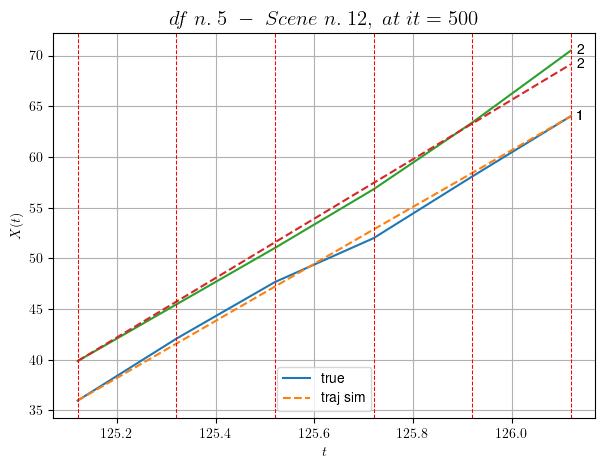

----------------------------------------------------------------------------------------------------
        For scene 17/44:
        * After LR finder: LR_NN=0.001 with mse=0.3863481782012317 at it=24
        * v0 = 29.26921039472321
        * MSE = 0.2988553835186825
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/44
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [337.72,339.52]


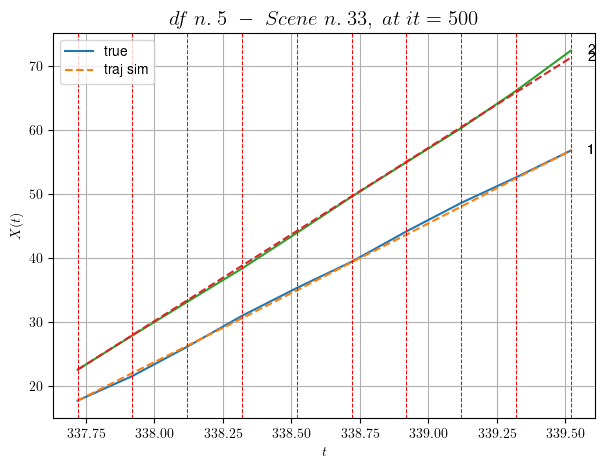

----------------------------------------------------------------------------------------------------
        For scene 18/44:
        * After LR finder: LR_NN=0.01 with mse=4.796084753829422 at it=24
        * v0 = 27.020038219089077
        * MSE = 0.13970106065326163
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [338.52,339.52]


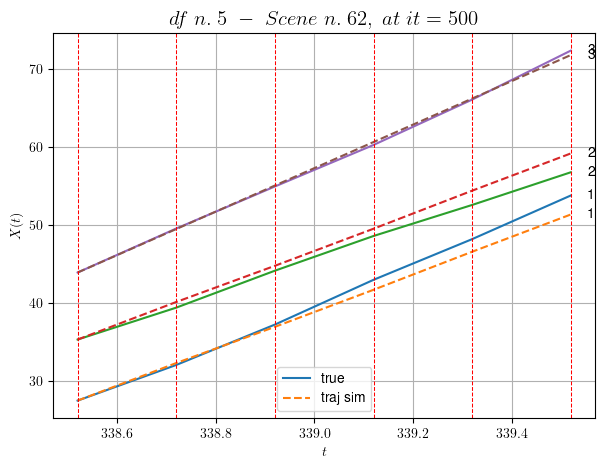

----------------------------------------------------------------------------------------------------
        For scene 19/44:
        * After LR finder: LR_NN=0.01 with mse=1.7317684721014155 at it=24
        * v0 = 27.853928426095536
        * MSE = 1.2077738756488008
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [490.92,491.32]


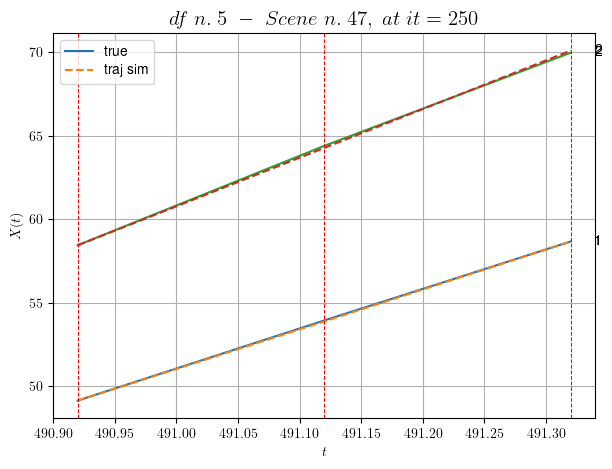

----------------------------------------------------------------------------------------------------
        For scene 20/44:
        * After LR finder: LR_NN=0.01 with mse=0.039581385249375 at it=24
        * v0 = 29.11559727009669
        * MSE = 0.0056850640422108105
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [396.92,397.32]


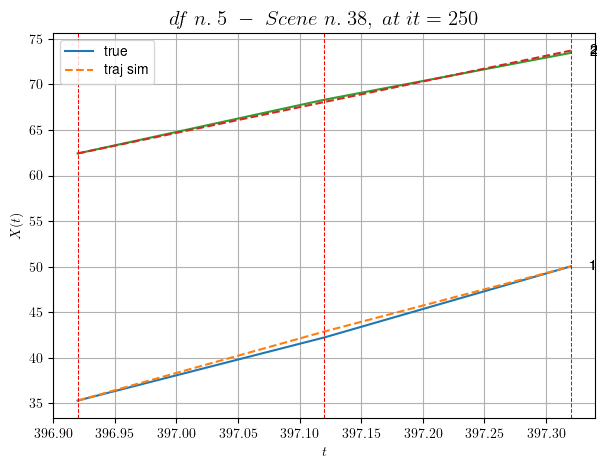

----------------------------------------------------------------------------------------------------
        For scene 21/44:
        * After LR finder: LR_NN=0.005 with mse=0.3268513397373476 at it=24
        * v0 = 28.2391103919293
        * MSE = 0.08768192493495133
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [326.52,327.92]


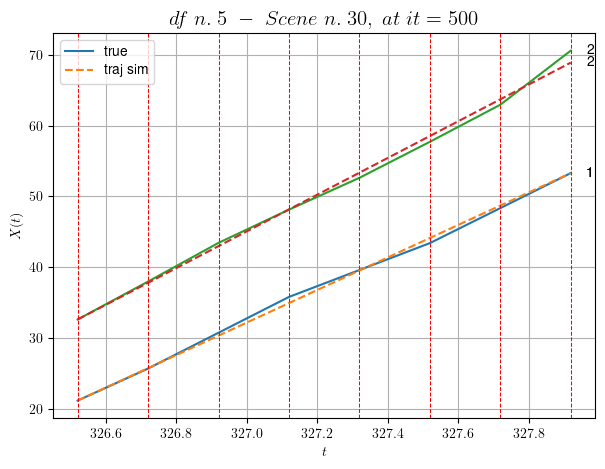

----------------------------------------------------------------------------------------------------
        For scene 22/44:
        * After LR finder: LR_NN=0.0005 with mse=6.129667251484725 at it=24
        * v0 = 25.910216862746267
        * MSE = 0.40365043644829884
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.92,451.52]


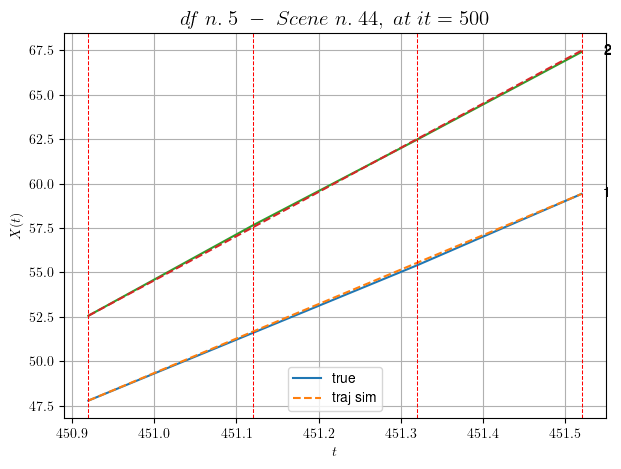

----------------------------------------------------------------------------------------------------
        For scene 23/44:
        * After LR finder: LR_NN=0.001 with mse=1.889750736474507 at it=24
        * v0 = 24.877482654595042
        * MSE = 0.005445537104830804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [525.52,526.12]


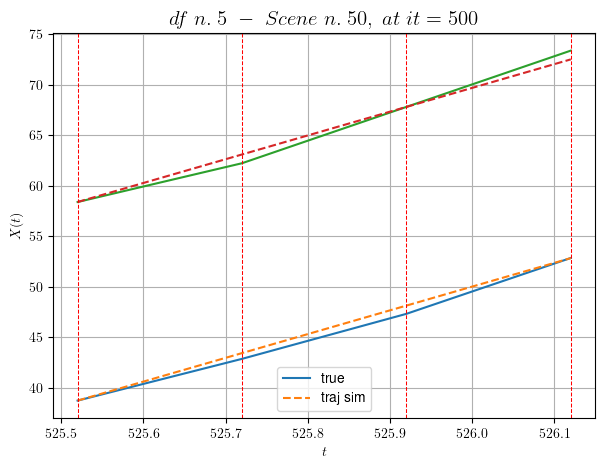

----------------------------------------------------------------------------------------------------
        For scene 24/44:
        * After LR finder: LR_NN=5e-05 with mse=2.6667904131746596 at it=24
        * v0 = 23.539355454247865
        * MSE = 0.26956142707318975
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.72,39.12]


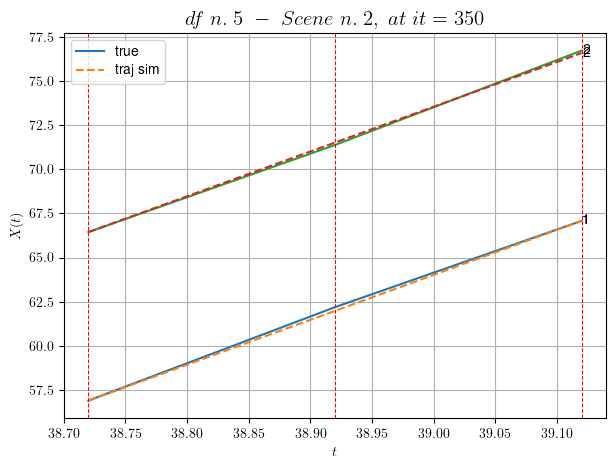

----------------------------------------------------------------------------------------------------
        For scene 25/44:
        * After LR finder: LR_NN=0.001 with mse=8.86874977376272 at it=24
        * v0 = 25.372432045097298
        * MSE = 0.013314072622376336
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [232.32,233.52]


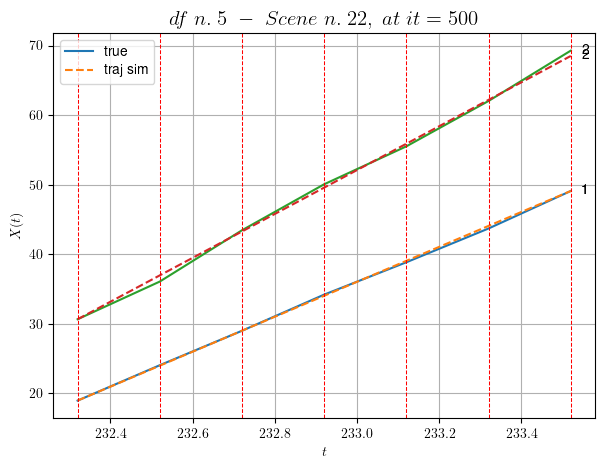

----------------------------------------------------------------------------------------------------
        For scene 26/44:
        * After LR finder: LR_NN=0.0005 with mse=0.9033231199144801 at it=24
        * v0 = 31.53725778703042
        * MSE = 0.1445416643926753
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [47.12,47.52]


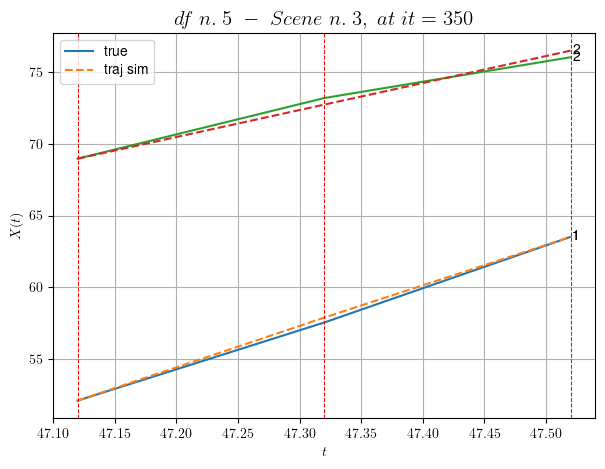

----------------------------------------------------------------------------------------------------
        For scene 27/44:
        * After LR finder: LR_NN=0.005 with mse=4.786820098523671 at it=24
        * v0 = 18.77182145861043
        * MSE = 0.08906665559762876
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [28.12,28.72]


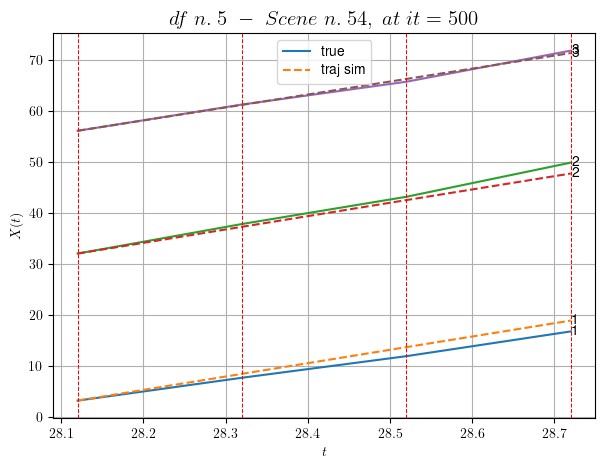

----------------------------------------------------------------------------------------------------
        For scene 28/44:
        * After LR finder: LR_NN=0.001 with mse=2.2183683189609127 at it=24
        * v0 = 25.379383792483814
        * MSE = 1.1678103359942167
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [415.32,416.32]


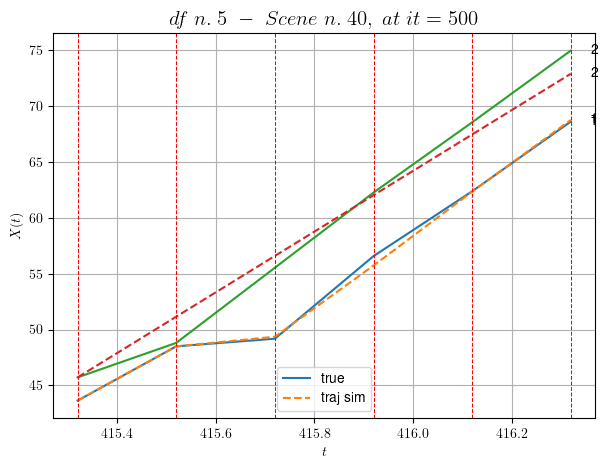

----------------------------------------------------------------------------------------------------
        For scene 29/44:
        * After LR finder: LR_NN=0.001 with mse=2.7576260054138597 at it=24
        * v0 = 27.188395316741065
        * MSE = 1.072626972732318
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [368.32,368.92]


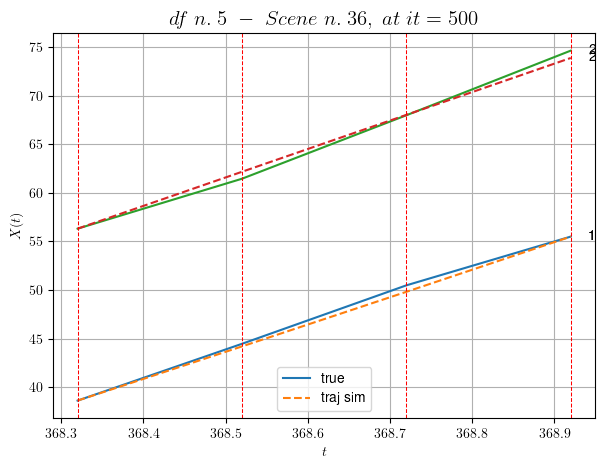

----------------------------------------------------------------------------------------------------
        For scene 30/44:
        * After LR finder: LR_NN=0.0005 with mse=0.19105333545281455 at it=24
        * v0 = 29.29813929812529
        * MSE = 0.16261065194385202
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.72,24.52]


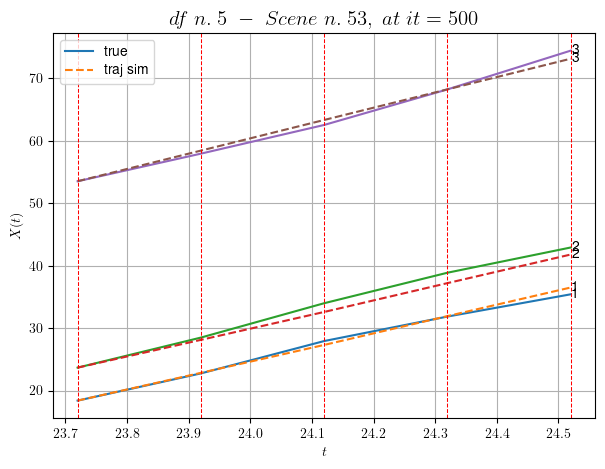

----------------------------------------------------------------------------------------------------
        For scene 31/44:
        * After LR finder: LR_NN=0.001 with mse=2.684558455082151 at it=24
        * v0 = 24.534803734519347
        * MSE = 0.6837441101057348
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [264.92,266.12]


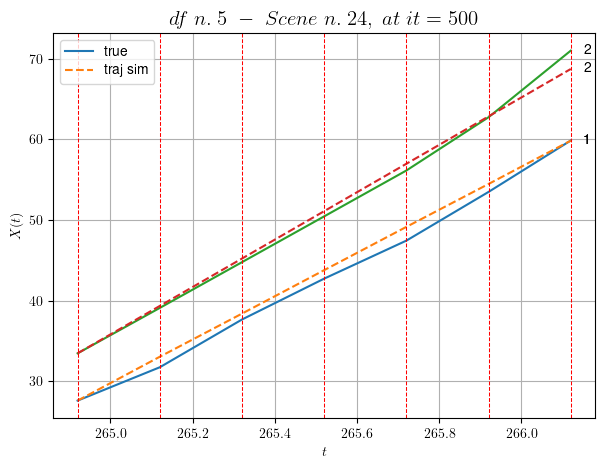

----------------------------------------------------------------------------------------------------
        For scene 32/44:
        * After LR finder: LR_NN=0.0005 with mse=0.6010053857122616 at it=24
        * v0 = 29.366788374198492
        * MSE = 0.7088548214305526
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [151.12,151.52]


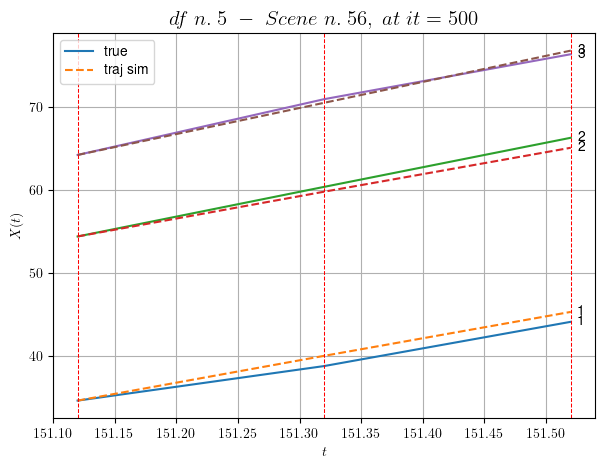

----------------------------------------------------------------------------------------------------
        For scene 33/44:
        * After LR finder: LR_NN=0.001 with mse=18.37381723358964 at it=24
        * v0 = 31.516138737958112
        * MSE = 0.5703193750897122
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [123.92,124.52]


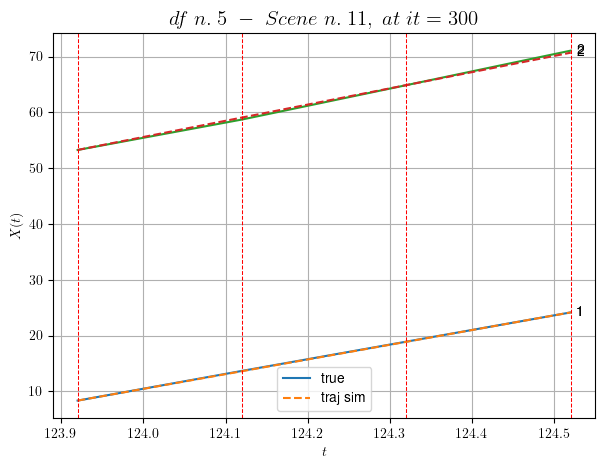

----------------------------------------------------------------------------------------------------
        For scene 34/44:
        * After LR finder: LR_NN=5e-05 with mse=0.06440909577051897 at it=24
        * v0 = 29.06710522631125
        * MSE = 0.028931568195379113
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [251.72,252.72]


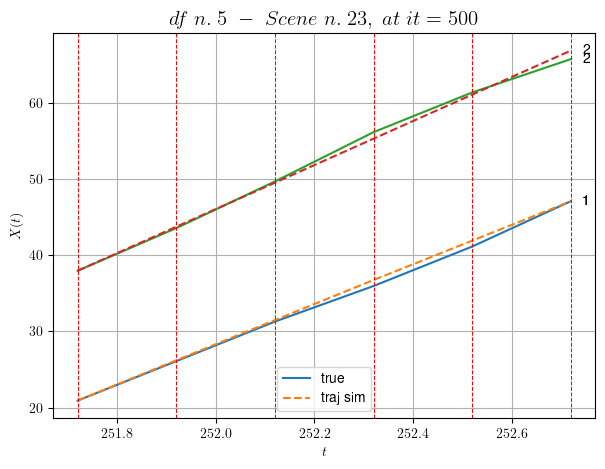

----------------------------------------------------------------------------------------------------
        For scene 35/44:
        * After LR finder: LR_NN=0.001 with mse=0.5962045147026811 at it=24
        * v0 = 28.91133195438039
        * MSE = 0.2782912087642203
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.32,214.92]


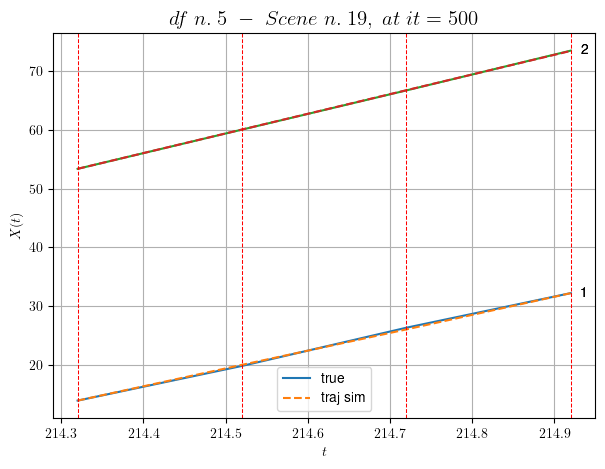

----------------------------------------------------------------------------------------------------
        For scene 36/44:
        * After LR finder: LR_NN=0.001 with mse=0.8467187653412013 at it=24
        * v0 = 33.41665141134033
        * MSE = 0.014864057897578076
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [266.92,267.32]


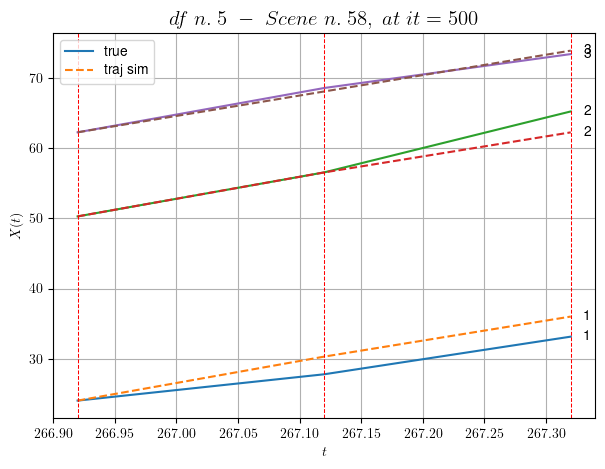

----------------------------------------------------------------------------------------------------
        For scene 37/44:
        * After LR finder: LR_NN=0.005 with mse=2.867096556635849 at it=24
        * v0 = 29.08570162592654
        * MSE = 2.6364426686919735
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [407.92,408.52]


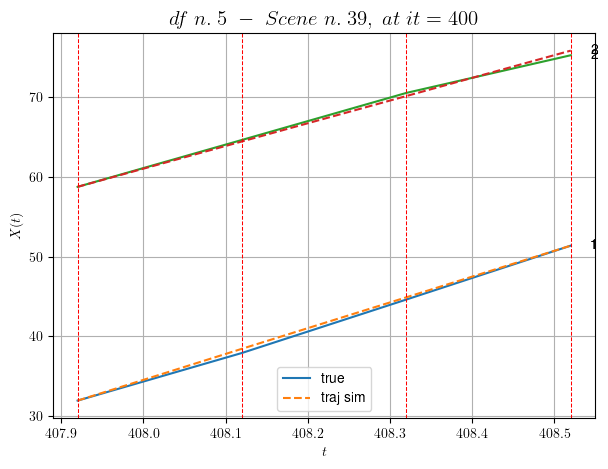

----------------------------------------------------------------------------------------------------
        For scene 38/44:
        * After LR finder: LR_NN=0.001 with mse=0.35642841966822036 at it=24
        * v0 = 28.45068736411588
        * MSE = 0.10955986715110204
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


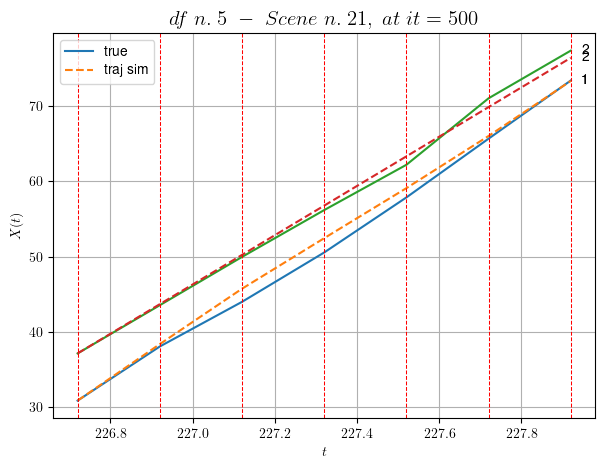

----------------------------------------------------------------------------------------------------
        For scene 39/44:
        * After LR finder: LR_NN=0.01 with mse=2.718840325047908 at it=24
        * v0 = 32.69366457961355
        * MSE = 0.5210297038708934
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


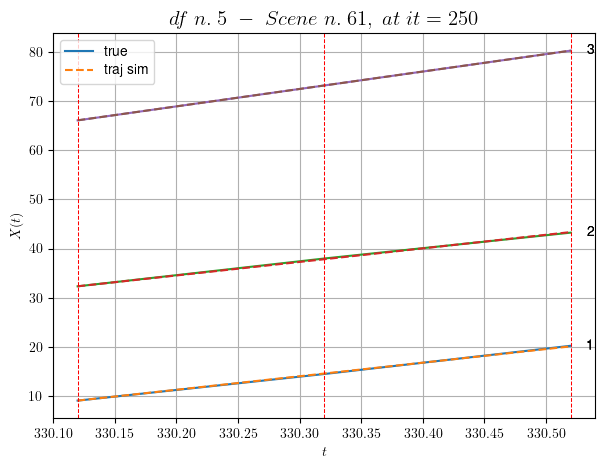

----------------------------------------------------------------------------------------------------
        For scene 40/44:
        * After LR finder: LR_NN=0.01 with mse=0.6739771419556138 at it=24
        * v0 = 35.477501601630344
        * MSE = 0.006673371197604381
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


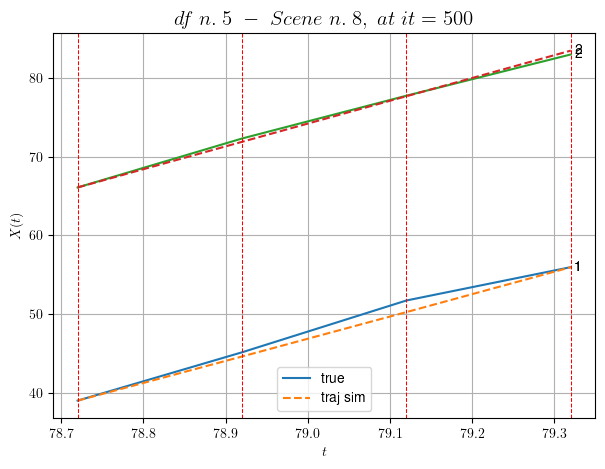

----------------------------------------------------------------------------------------------------
        For scene 41/44:
        * After LR finder: LR_NN=0.001 with mse=0.7362988411660811 at it=24
        * v0 = 28.96540729561131
        * MSE = 0.3578836596842149
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


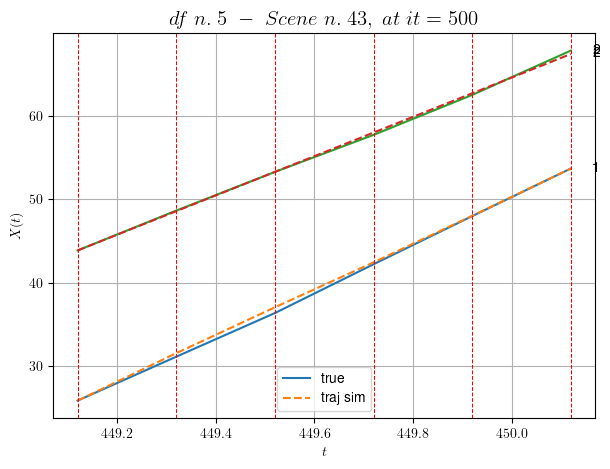

----------------------------------------------------------------------------------------------------
        For scene 42/44:
        * After LR finder: LR_NN=0.01 with mse=7.629501446694923 at it=24
        * v0 = 23.52760427573276
        * MSE = 0.06084574449769961
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


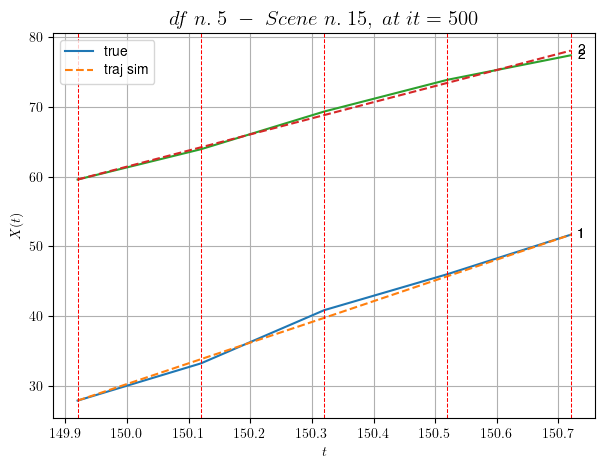

----------------------------------------------------------------------------------------------------
        For scene 43/44:
        * After LR finder: LR_NN=0.0005 with mse=6.204322758425125 at it=24
        * v0 = 23.102993584361432
        * MSE = 0.26385343019902996
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


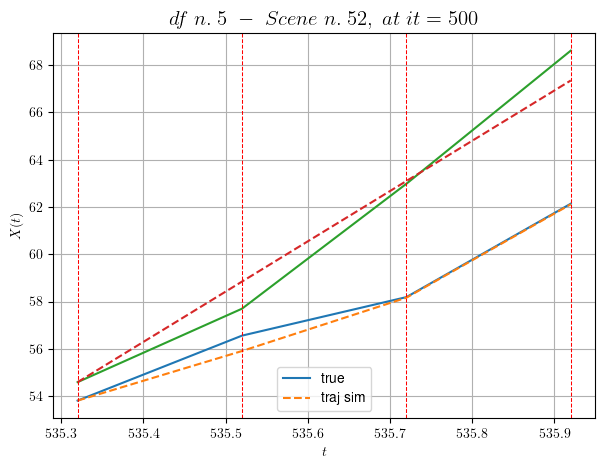

----------------------------------------------------------------------------------------------------
        For scene 44/44:
        * After LR finder: LR_NN=0.01 with mse=4.733109532431064 at it=24
        * v0 = 21.278077520484175
        * MSE = 0.3683243341415863
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.44603778111405146
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (22 scenes)
DataFrame n.5. Scene n.1/22


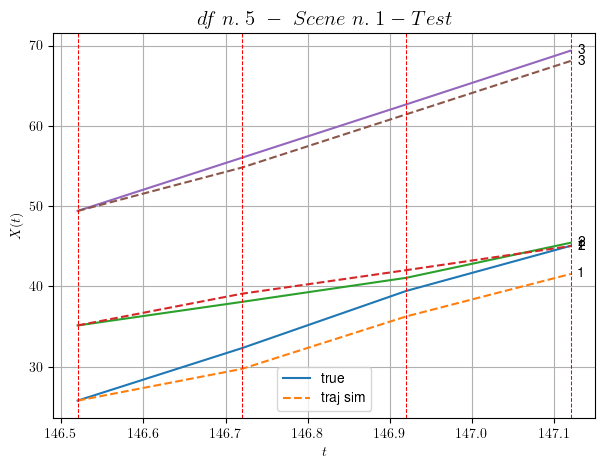

        For scene 1/22:
        * MSE = 2.9881747839706403
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/22


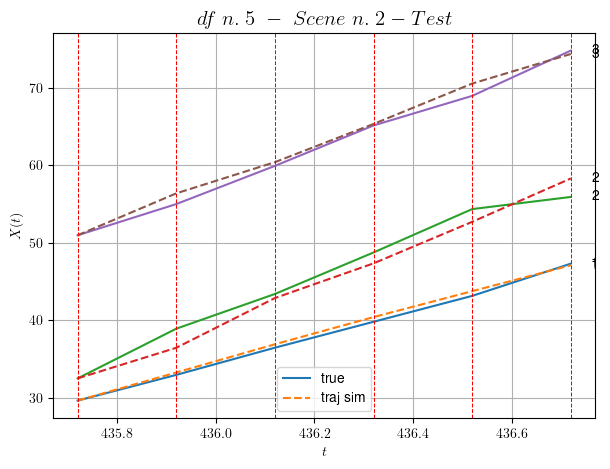

        For scene 2/22:
        * MSE = 1.2616230381592477
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/22


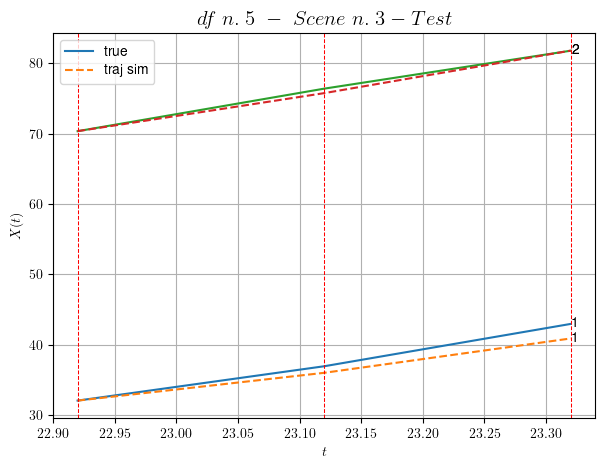

        For scene 3/22:
        * MSE = 0.9267660322753186
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/22


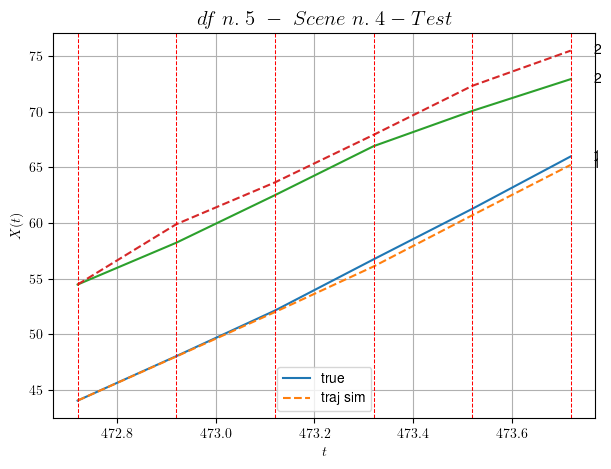

        For scene 4/22:
        * MSE = 1.5026082926034015
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/22


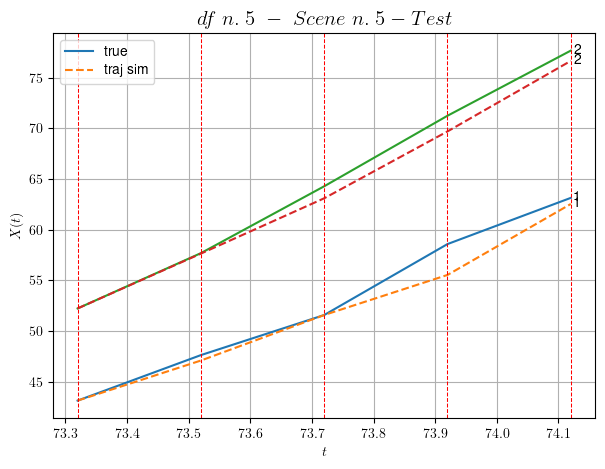

        For scene 5/22:
        * MSE = 1.4757836507713895
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/22


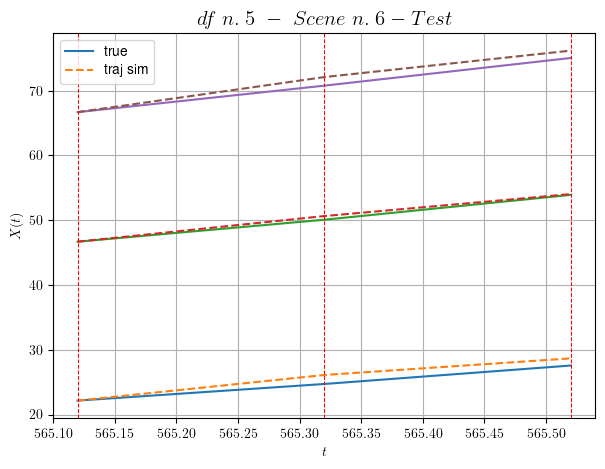

        For scene 6/22:
        * MSE = 0.7253538928059801
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/22


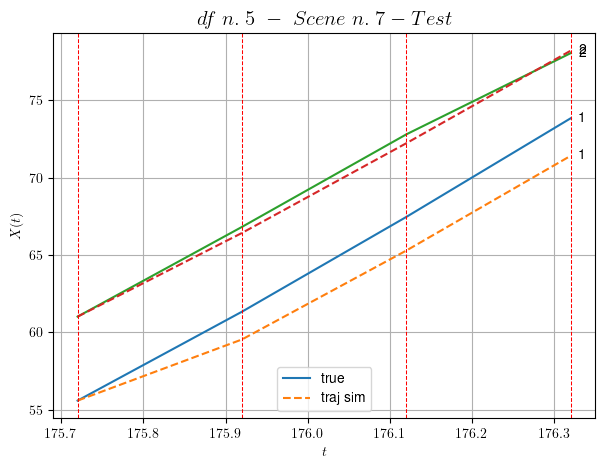

        For scene 7/22:
        * MSE = 1.793077529036993
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/22


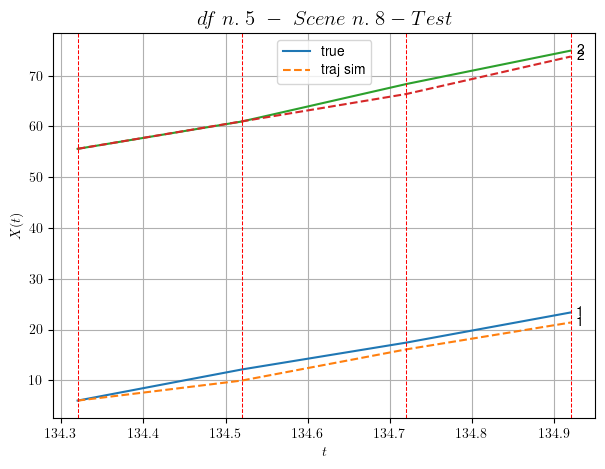

        For scene 8/22:
        * MSE = 1.9610855737074342
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/22


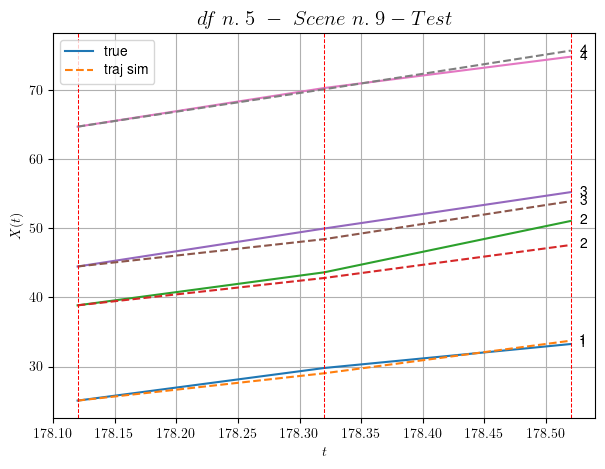

        For scene 9/22:
        * MSE = 1.5430077986032056
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/22


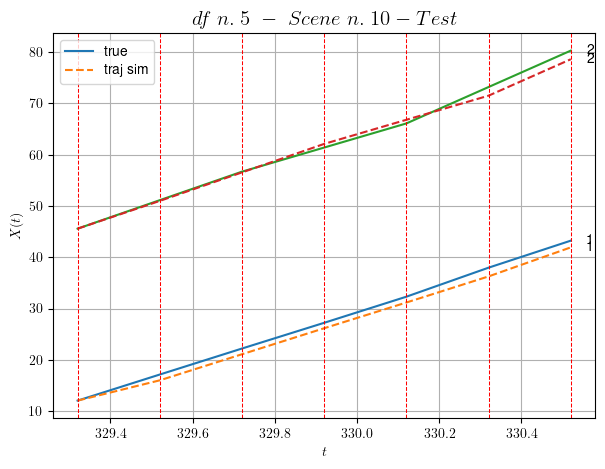

        For scene 10/22:
        * MSE = 1.161481944374806
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/22


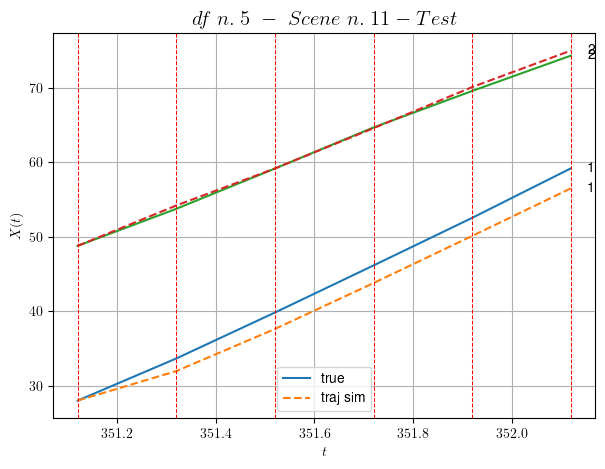

        For scene 11/22:
        * MSE = 2.2752282575666576
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/22


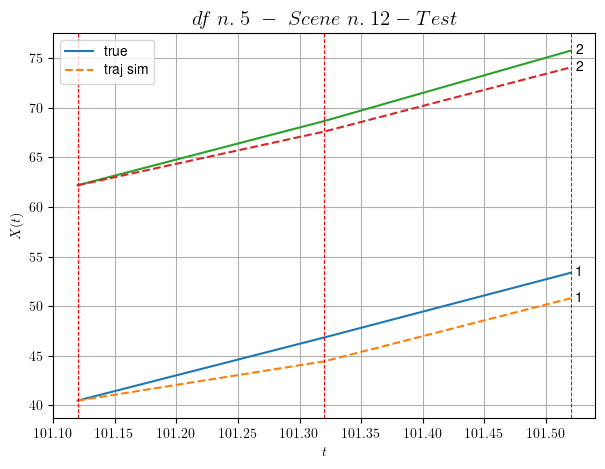

        For scene 12/22:
        * MSE = 2.727941016568064
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/22


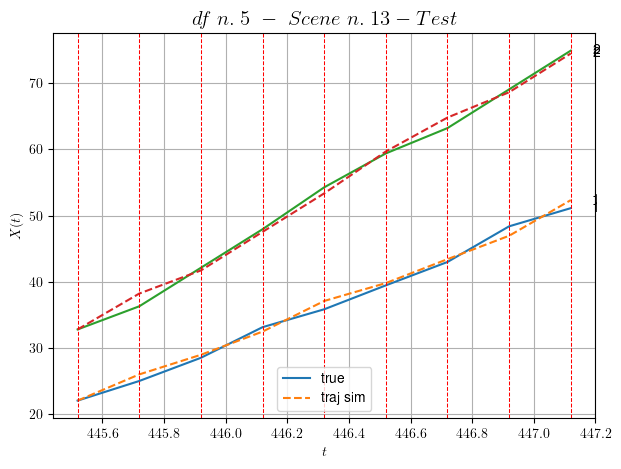

        For scene 13/22:
        * MSE = 0.8253689058498308
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/22


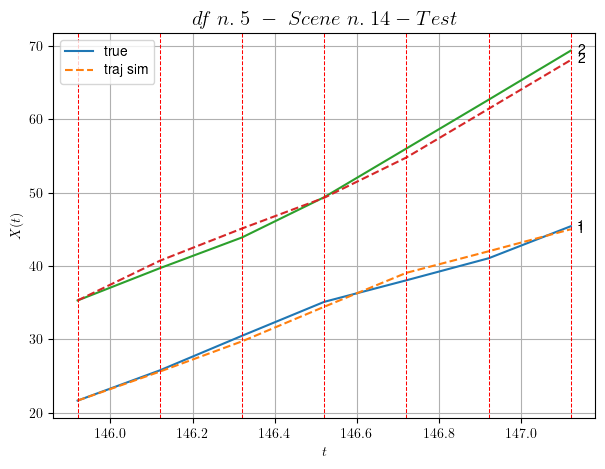

        For scene 14/22:
        * MSE = 0.7400312405908283
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/22


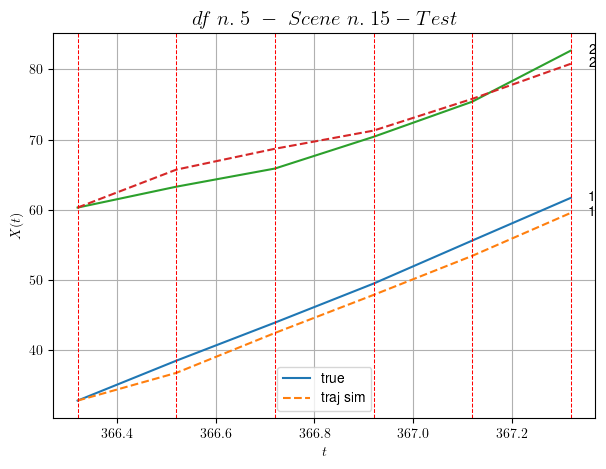

        For scene 15/22:
        * MSE = 2.9608035108442996
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/22


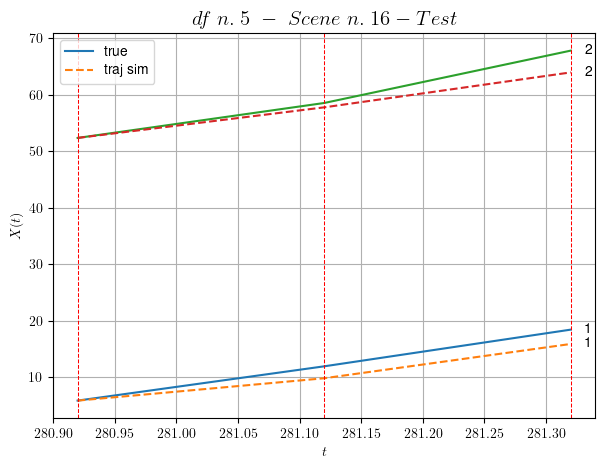

        For scene 16/22:
        * MSE = 4.388625389222823
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/22


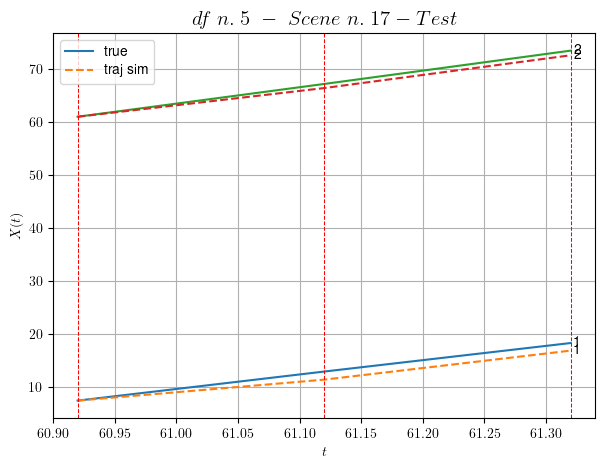

        For scene 17/22:
        * MSE = 0.9578715264326696
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/22


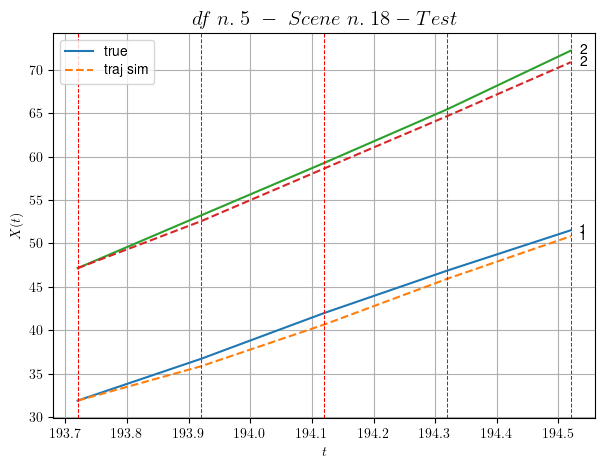

        For scene 18/22:
        * MSE = 0.7129188899106116
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/22


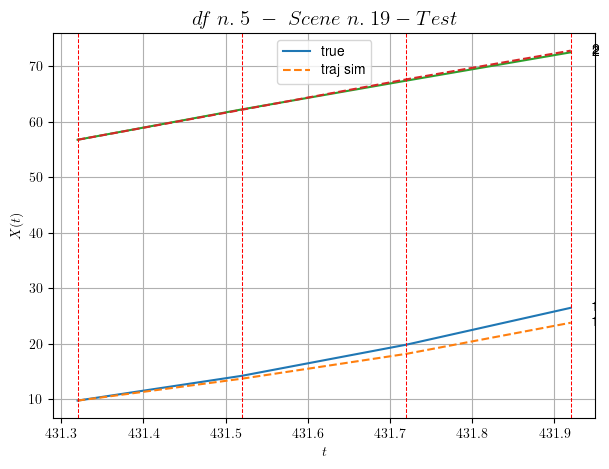

        For scene 19/22:
        * MSE = 1.3003065121592412
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/22


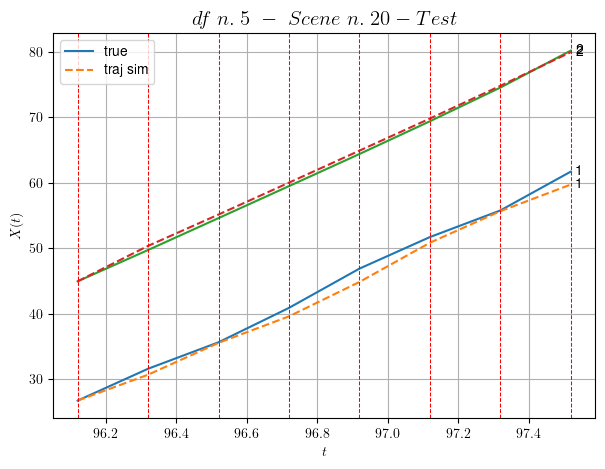

        For scene 20/22:
        * MSE = 0.8029450126655309
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/22


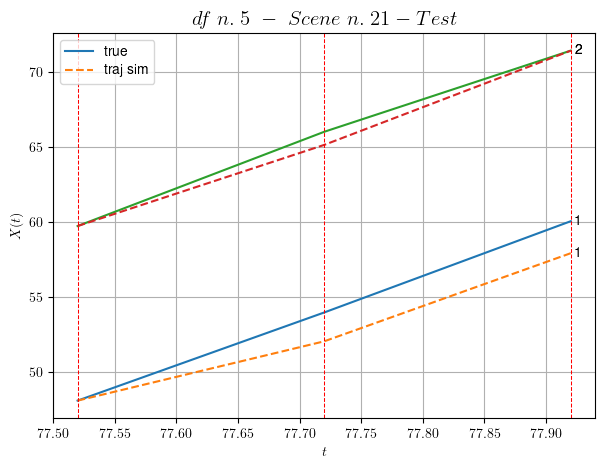

        For scene 21/22:
        * MSE = 1.50317905512845
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/22


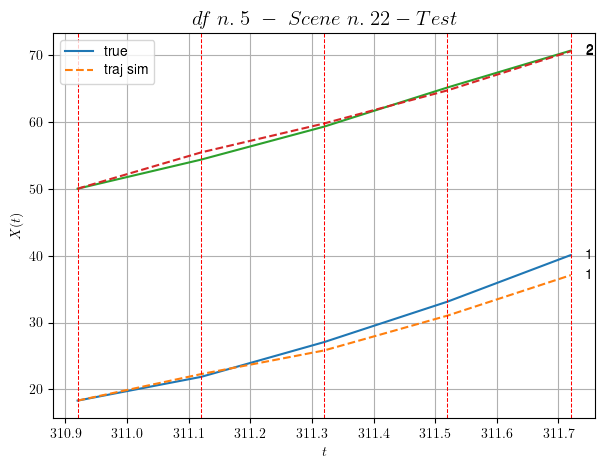

        For scene 22/22:
        * MSE = 1.6698196352423957
----------------------------------------------------------------------------------------------------


MSE test: 1.6456364312949916

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.44603778111405146
          * MSE test: 1.6456364312949916
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 34 scenes, the remaining 18 to test the model.

Training step. (34 scenes)
DataFrame n.6. Scene n.1/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.40,530.80]


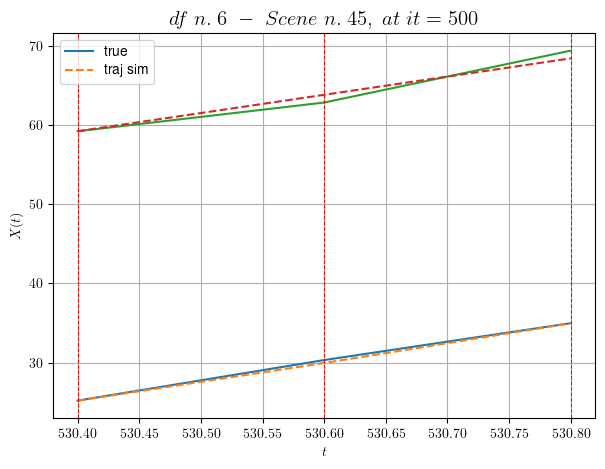

----------------------------------------------------------------------------------------------------
        For scene 1/34:
        * After LR finder: LR_NN=0.01 with mse=1.5697055475920239 at it=24
        * v0 = 22.991928031470444
        * MSE = 0.33488381540863726
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [446.80,447.80]


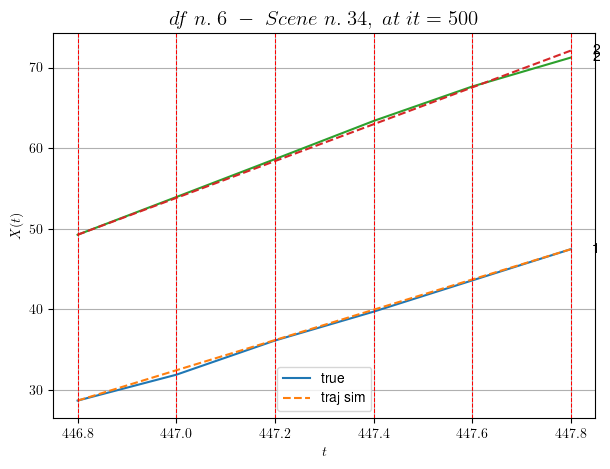

----------------------------------------------------------------------------------------------------
        For scene 2/34:
        * After LR finder: LR_NN=0.001 with mse=10.004206537085697 at it=24
        * v0 = 22.841482925267467
        * MSE = 0.11370609990116651
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [552.20,552.80]


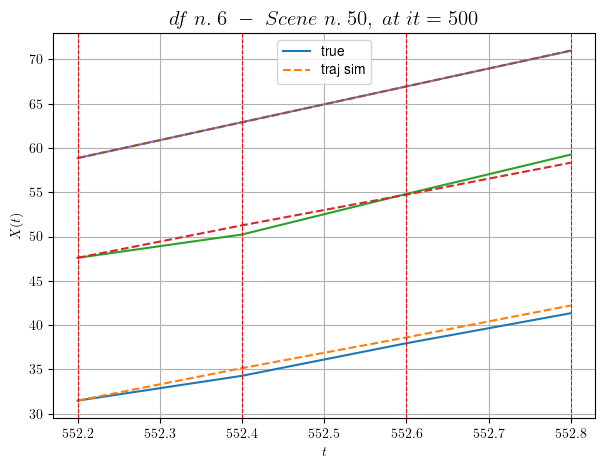

----------------------------------------------------------------------------------------------------
        For scene 3/34:
        * After LR finder: LR_NN=0.005 with mse=4.91184829062795 at it=24
        * v0 = 20.233205039552374
        * MSE = 0.3178186851610112
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [195.80,196.80]


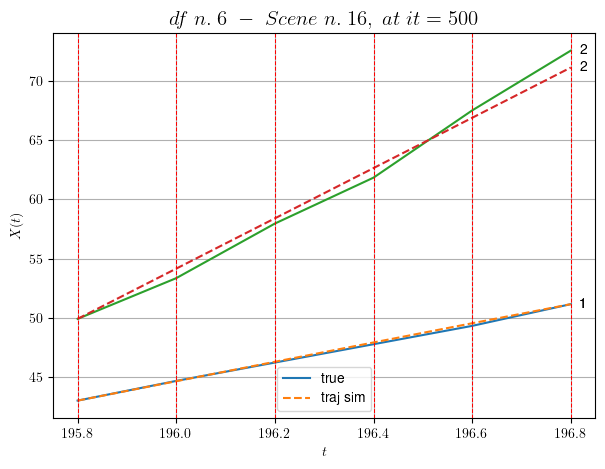

----------------------------------------------------------------------------------------------------
        For scene 4/34:
        * After LR finder: LR_NN=0.01 with mse=12.795503226866478 at it=24
        * v0 = 21.237347440799663
        * MSE = 0.28948671590364217
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [129.80,130.20]


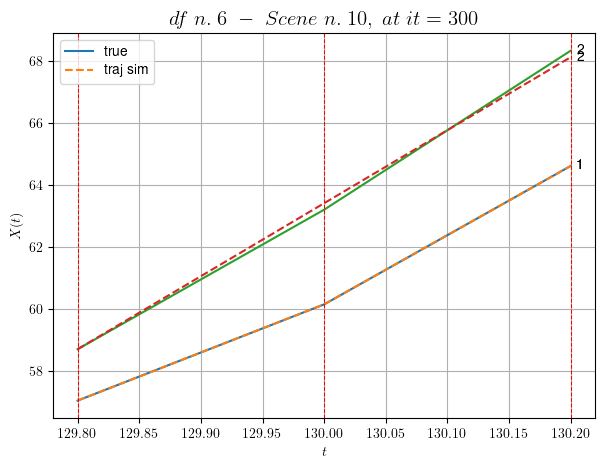

----------------------------------------------------------------------------------------------------
        For scene 5/34:
        * After LR finder: LR_NN=0.005 with mse=1.4924347898736932 at it=24
        * v0 = 23.601834328725797
        * MSE = 0.014104935934069347
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [204.40,206.20]


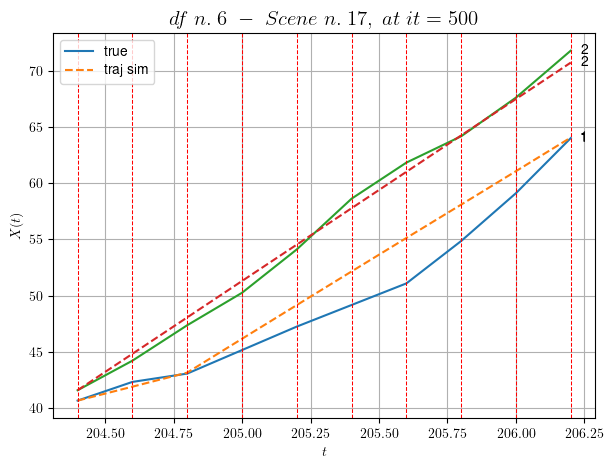

----------------------------------------------------------------------------------------------------
        For scene 6/34:
        * After LR finder: LR_NN=0.0005 with mse=108.79046144396405 at it=24
        * v0 = 16.186070594948866
        * MSE = 2.4524197575069535
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [396.40,397.60]


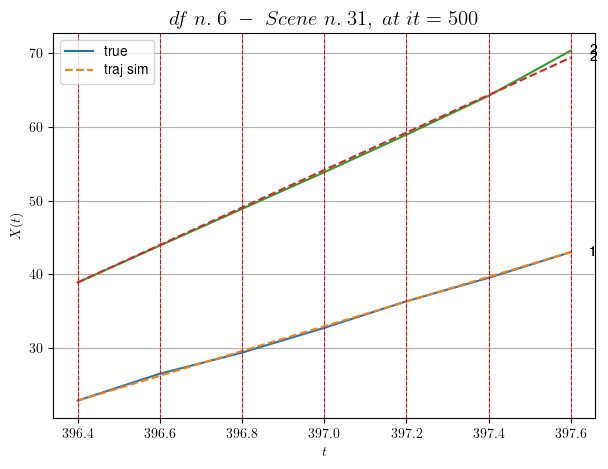

----------------------------------------------------------------------------------------------------
        For scene 7/34:
        * After LR finder: LR_NN=0.0005 with mse=5.173037896149727 at it=24
        * v0 = 25.429850069095412
        * MSE = 0.08879385242745068
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [458.00,458.40]


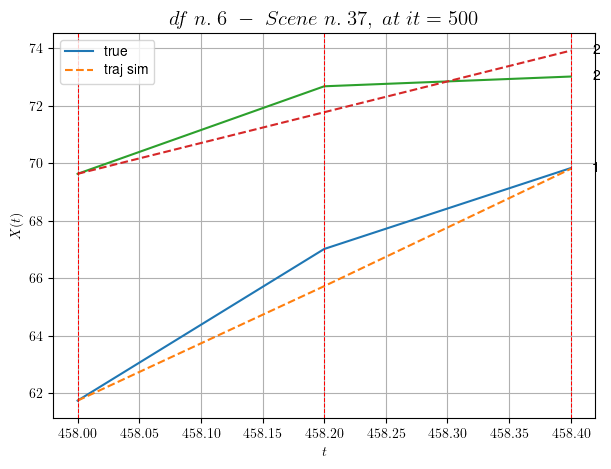

----------------------------------------------------------------------------------------------------
        For scene 8/34:
        * After LR finder: LR_NN=0.0005 with mse=14.084622150727153 at it=24
        * v0 = 10.716650123126643
        * MSE = 0.548815589383266
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [296.40,296.80]


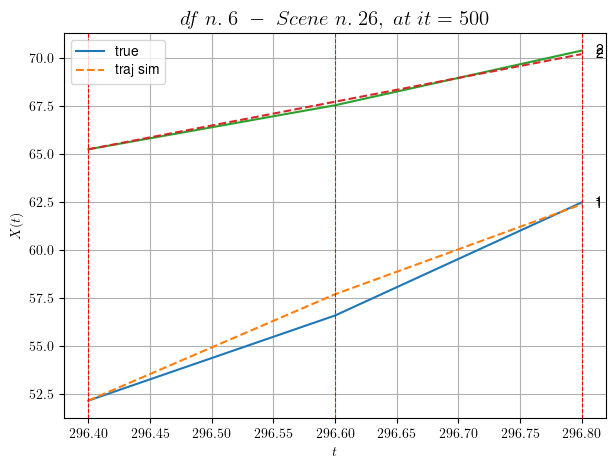

----------------------------------------------------------------------------------------------------
        For scene 9/34:
        * After LR finder: LR_NN=0.01 with mse=10.45246834157288 at it=24
        * v0 = 12.399412488572606
        * MSE = 0.20425876905833823
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [134.00,135.20]


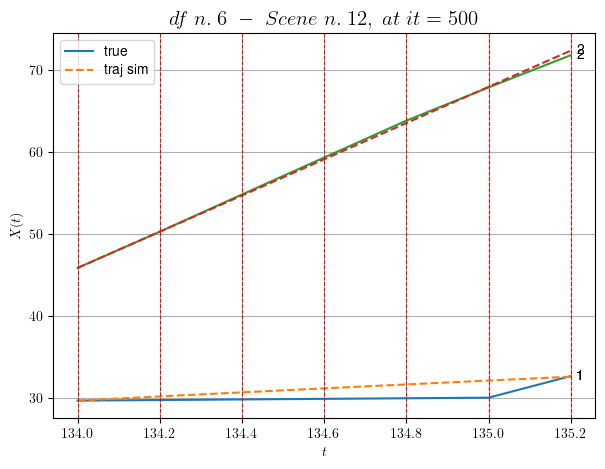

----------------------------------------------------------------------------------------------------
        For scene 10/34:
        * After LR finder: LR_NN=0.01 with mse=17.342629945218775 at it=24
        * v0 = 22.06323233551294
        * MSE = 0.6992623263559952
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [14.80,15.60]


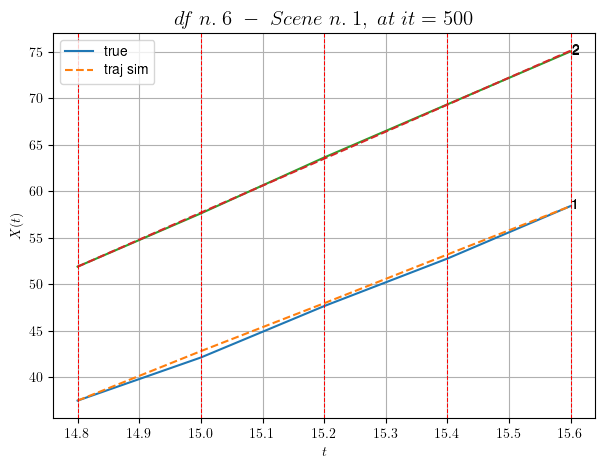

----------------------------------------------------------------------------------------------------
        For scene 11/34:
        * After LR finder: LR_NN=0.005 with mse=0.24514370227044385 at it=24
        * v0 = 29.057098132173095
        * MSE = 0.0760002344959191
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [576.00,577.60]


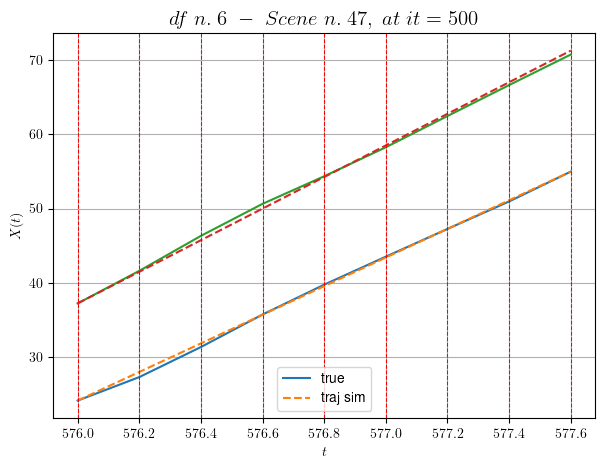

----------------------------------------------------------------------------------------------------
        For scene 12/34:
        * After LR finder: LR_NN=0.0005 with mse=35.61850638548928 at it=24
        * v0 = 21.301030620241907
        * MSE = 0.1203017433328077
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [359.20,359.60]


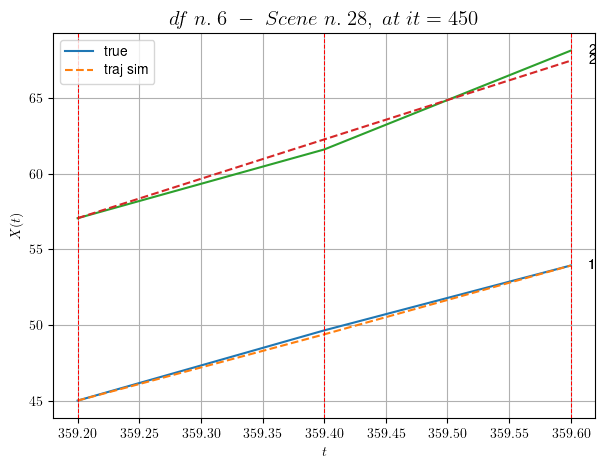

----------------------------------------------------------------------------------------------------
        For scene 13/34:
        * After LR finder: LR_NN=0.01 with mse=0.5144366428146147 at it=24
        * v0 = 26.03696181437932
        * MSE = 0.14950705791603486
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [407.80,409.20]


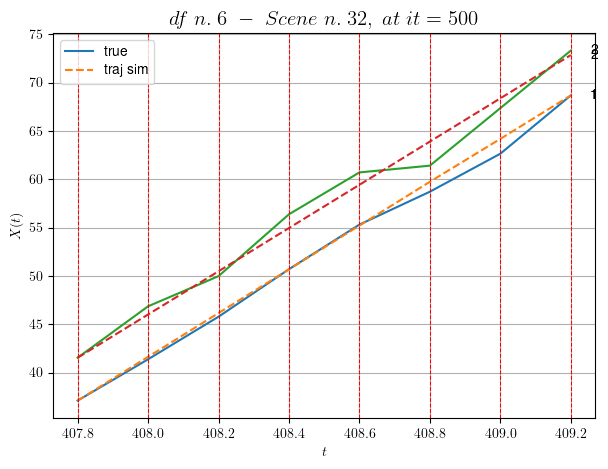

----------------------------------------------------------------------------------------------------
        For scene 14/34:
        * After LR finder: LR_NN=0.001 with mse=22.65130912738536 at it=24
        * v0 = 22.363716298521698
        * MSE = 0.9798633780313726
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [467.00,468.20]


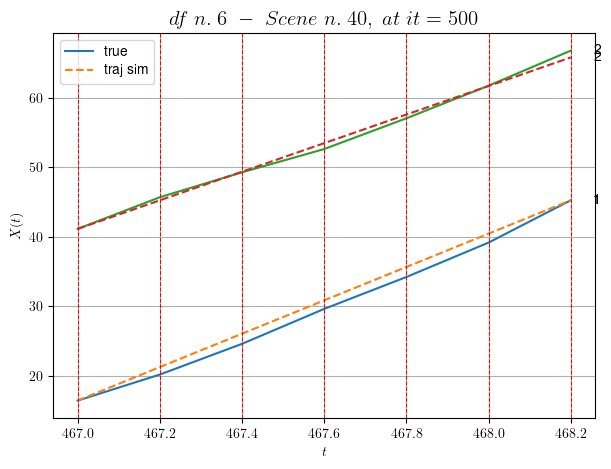

----------------------------------------------------------------------------------------------------
        For scene 15/34:
        * After LR finder: LR_NN=0.0005 with mse=23.23115418642199 at it=24
        * v0 = 20.547439201770025
        * MSE = 0.76027602648405
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [374.40,376.00]


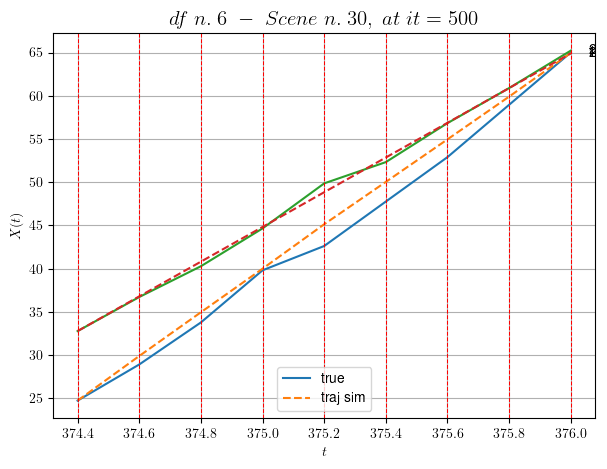

----------------------------------------------------------------------------------------------------
        For scene 16/34:
        * After LR finder: LR_NN=0.005 with mse=45.420321744194695 at it=24
        * v0 = 20.073696885978038
        * MSE = 1.1146194889392924
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [551.40,552.00]


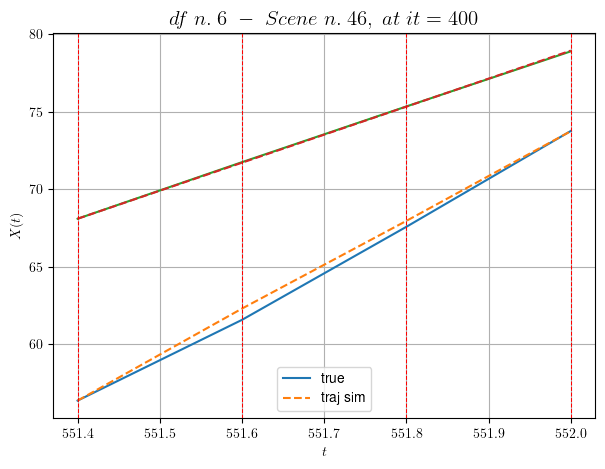

----------------------------------------------------------------------------------------------------
        For scene 17/34:
        * After LR finder: LR_NN=0.005 with mse=10.047912464632596 at it=24
        * v0 = 18.102658564770273
        * MSE = 0.08504179116790142
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [24.60,26.40]


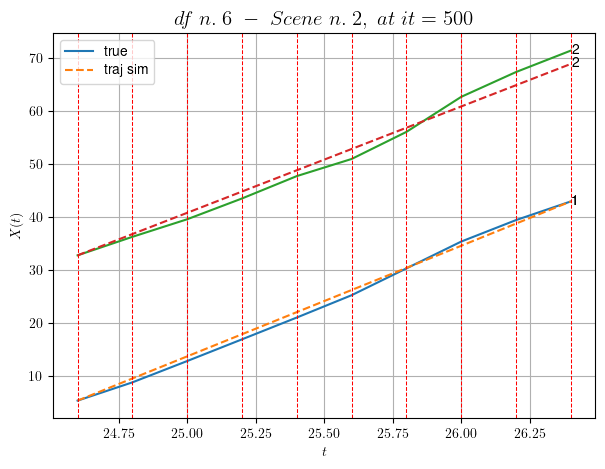

----------------------------------------------------------------------------------------------------
        For scene 18/34:
        * After LR finder: LR_NN=0.0005 with mse=51.73699957681514 at it=24
        * v0 = 20.07254372579164
        * MSE = 1.3402763844937466
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [236.20,237.00]


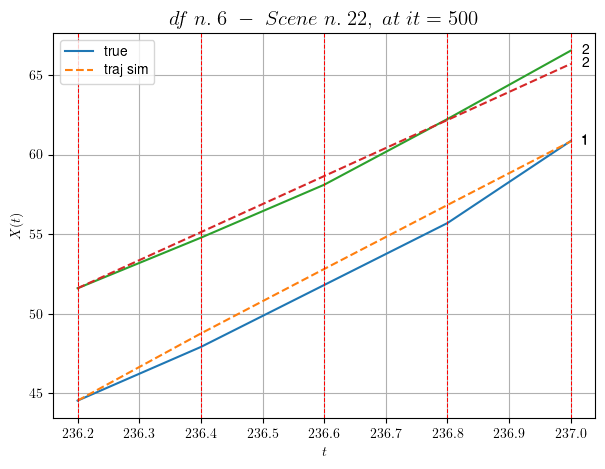

----------------------------------------------------------------------------------------------------
        For scene 19/34:
        * After LR finder: LR_NN=0.005 with mse=17.874806161892366 at it=24
        * v0 = 17.63413097458841
        * MSE = 0.4107097903759446
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [29.80,30.80]


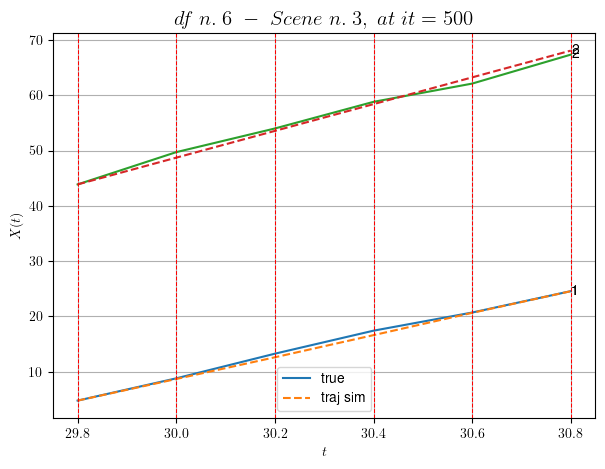

----------------------------------------------------------------------------------------------------
        For scene 20/34:
        * After LR finder: LR_NN=0.005 with mse=7.4524225601607075 at it=24
        * v0 = 24.207929046505022
        * MSE = 0.3521242308949881
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/34
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [477.80,479.80]


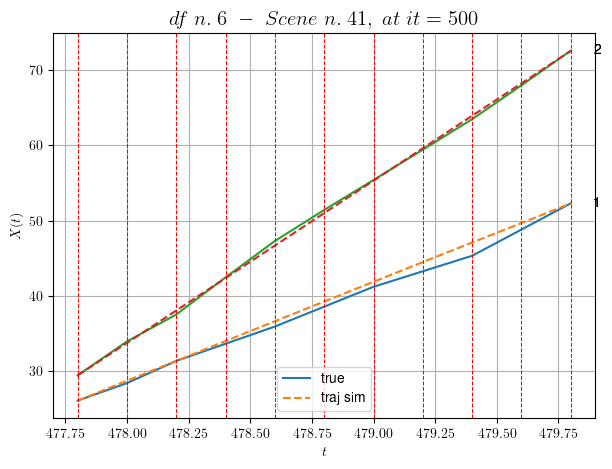

----------------------------------------------------------------------------------------------------
        For scene 21/34:
        * After LR finder: LR_NN=0.005 with mse=50.18046071092888 at it=24
        * v0 = 21.601430911083135
        * MSE = 0.3617841278026019
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.60,451.20]


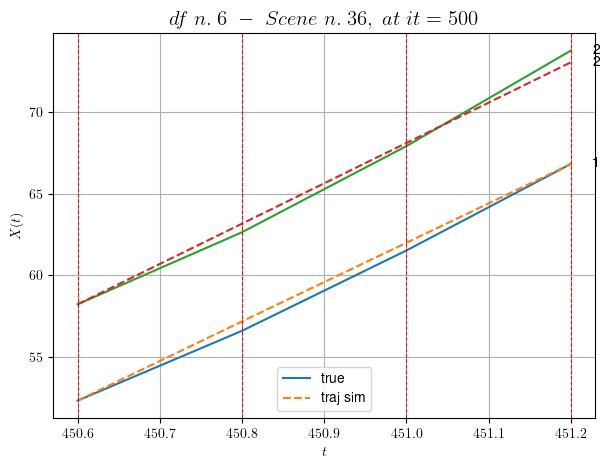

----------------------------------------------------------------------------------------------------
        For scene 22/34:
        * After LR finder: LR_NN=0.001 with mse=1.7956683460347906 at it=24
        * v0 = 24.70783812699331
        * MSE = 0.16160307612219454
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [263.80,264.20]


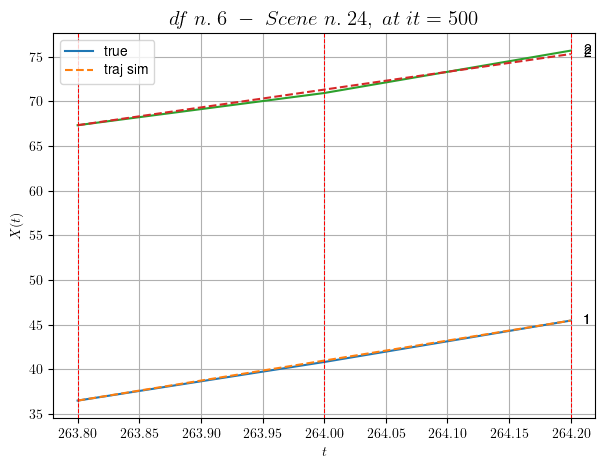

----------------------------------------------------------------------------------------------------
        For scene 23/34:
        * After LR finder: LR_NN=0.0001 with mse=3.1803733631841338 at it=24
        * v0 = 19.938624060294423
        * MSE = 0.052630588052219256
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [593.40,594.60]


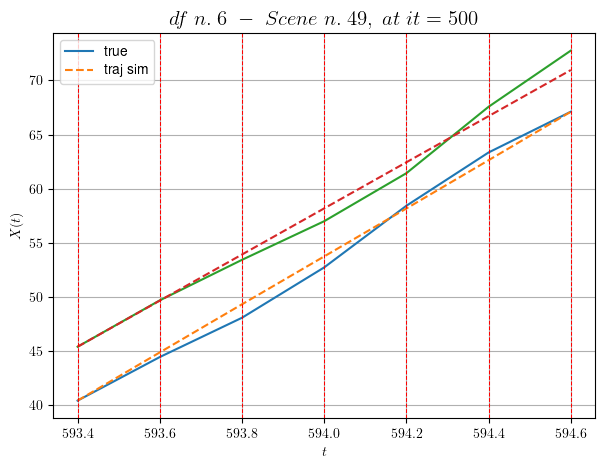

----------------------------------------------------------------------------------------------------
        For scene 24/34:
        * After LR finder: LR_NN=0.001 with mse=18.862173678727768 at it=24
        * v0 = 21.280809908315504
        * MSE = 0.6809317293133988
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [131.80,133.40]


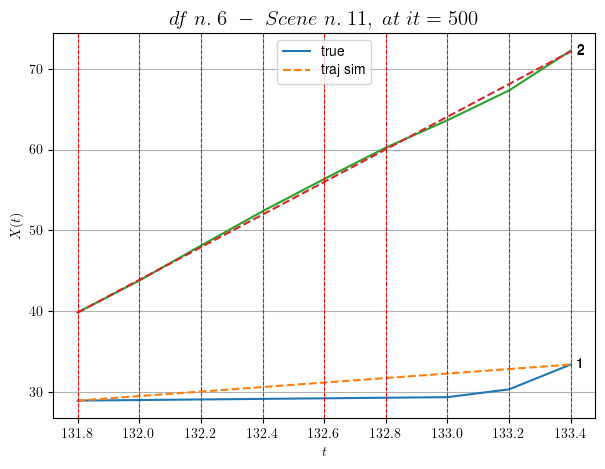

----------------------------------------------------------------------------------------------------
        For scene 25/34:
        * After LR finder: LR_NN=0.0005 with mse=44.600284629374585 at it=24
        * v0 = 20.22300032377142
        * MSE = 1.6227429744136812
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [252.60,253.20]


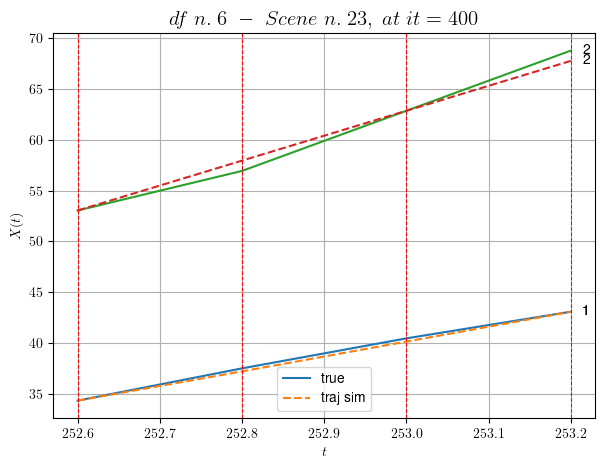

----------------------------------------------------------------------------------------------------
        For scene 26/34:
        * After LR finder: LR_NN=0.005 with mse=1.8415030816359172 at it=24
        * v0 = 24.514205455128135
        * MSE = 0.24595424661987472
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [228.80,229.40]


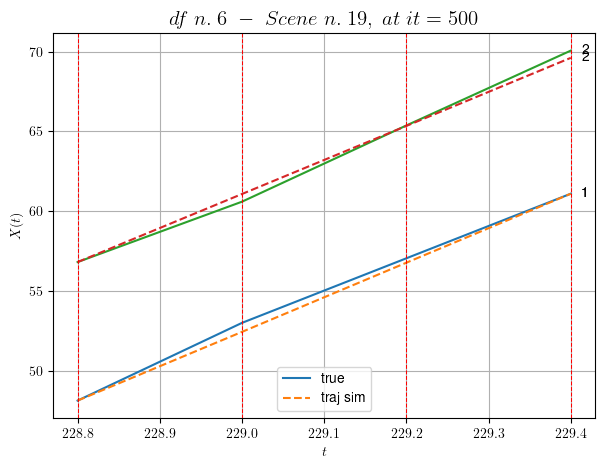

----------------------------------------------------------------------------------------------------
        For scene 27/34:
        * After LR finder: LR_NN=0.001 with mse=4.95563017074419 at it=24
        * v0 = 21.319904834010156
        * MSE = 0.09780784160725926
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.00,554.40]


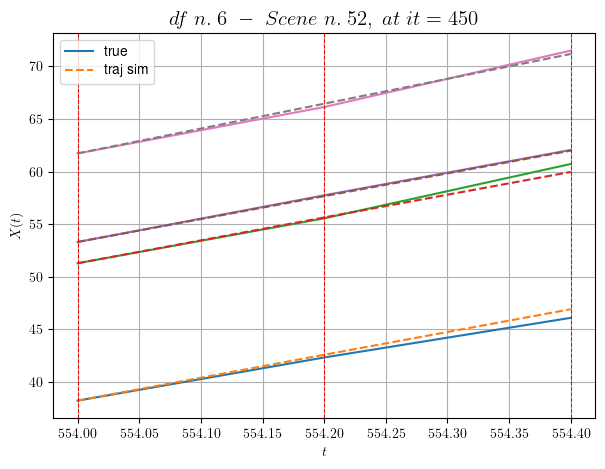

----------------------------------------------------------------------------------------------------
        For scene 28/34:
        * After LR finder: LR_NN=0.005 with mse=0.7580023025007179 at it=24
        * v0 = 23.647103365285
        * MSE = 0.1262045035650322
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [234.00,234.60]


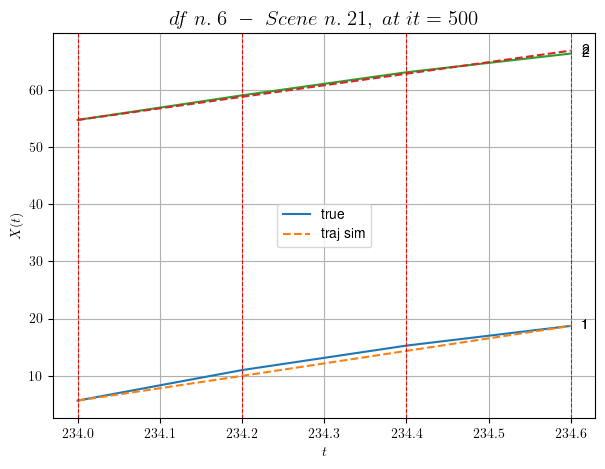

----------------------------------------------------------------------------------------------------
        For scene 29/34:
        * After LR finder: LR_NN=0.001 with mse=7.472797648356593 at it=24
        * v0 = 20.201366857273896
        * MSE = 0.2841778592600505
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


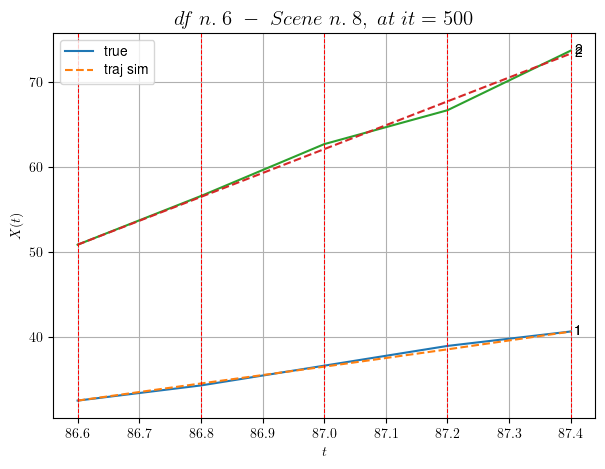

----------------------------------------------------------------------------------------------------
        For scene 30/34:
        * After LR finder: LR_NN=0.01 with mse=0.6224667735228401 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.18052634390981823
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


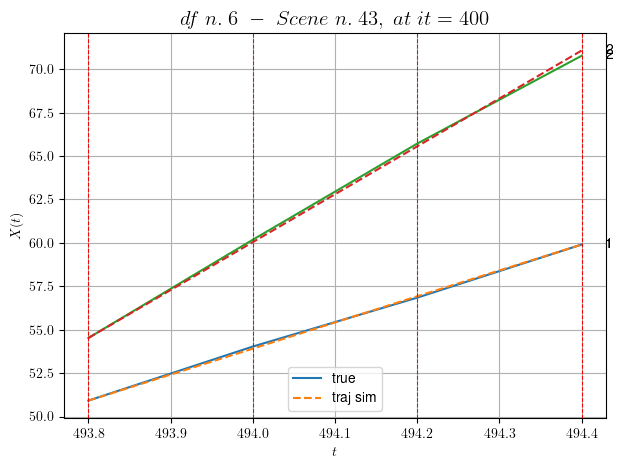

----------------------------------------------------------------------------------------------------
        For scene 31/34:
        * After LR finder: LR_NN=0.005 with mse=0.48841186307783185 at it=24
        * v0 = 27.577027547634234
        * MSE = 0.01949498278547232
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


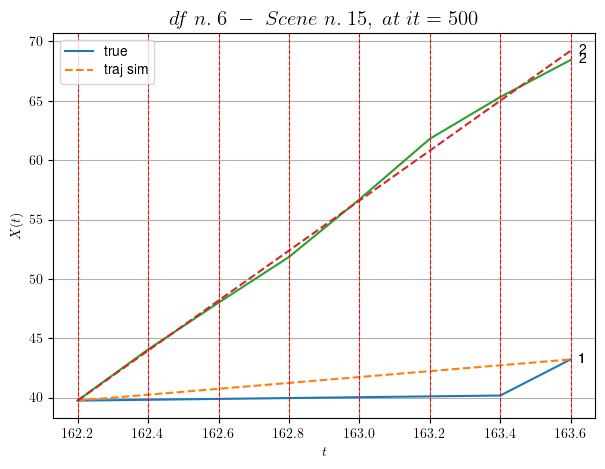

----------------------------------------------------------------------------------------------------
        For scene 32/34:
        * After LR finder: LR_NN=0.001 with mse=28.875327132200436 at it=24
        * v0 = 21.059787487615633
        * MSE = 1.1504883752592334
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


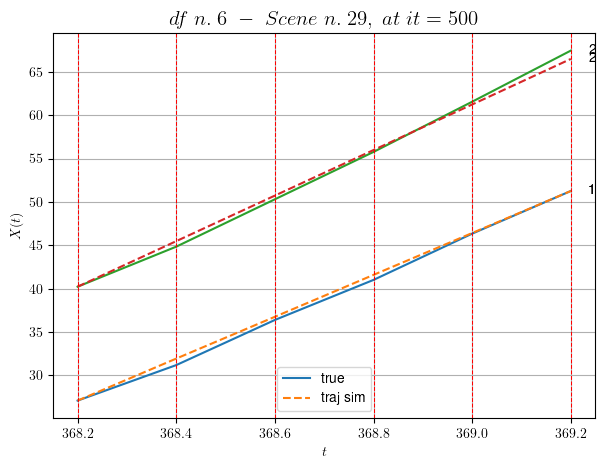

----------------------------------------------------------------------------------------------------
        For scene 33/34:
        * After LR finder: LR_NN=0.001 with mse=2.2879962842531403 at it=24
        * v0 = 26.269654614172993
        * MSE = 0.20246604730131307
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


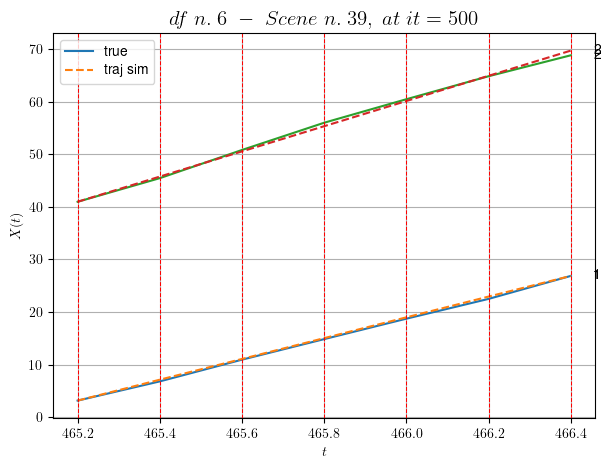

----------------------------------------------------------------------------------------------------
        For scene 34/34:
        * After LR finder: LR_NN=0.005 with mse=10.059519047943533 at it=24
        * v0 = 23.956962458802142
        * MSE = 0.1376013486656334
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.464020138760305
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (18 scenes)
DataFrame n.6. Scene n.1/18


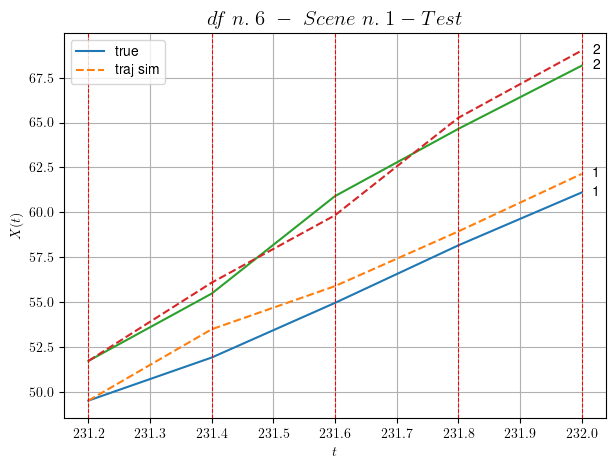

        For scene 1/18:
        * MSE = 0.762882252155306
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/18


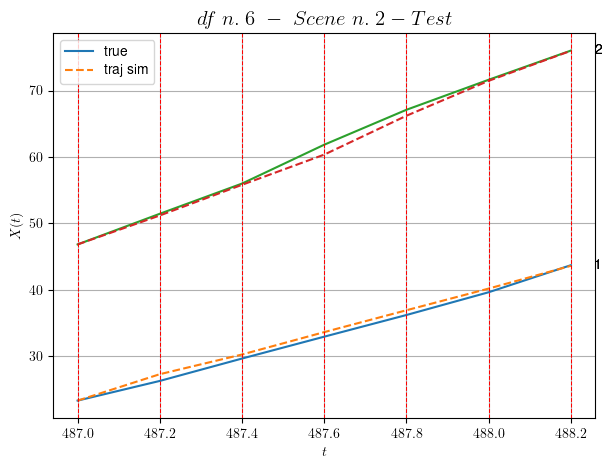

        For scene 2/18:
        * MSE = 0.4182561252058723
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/18


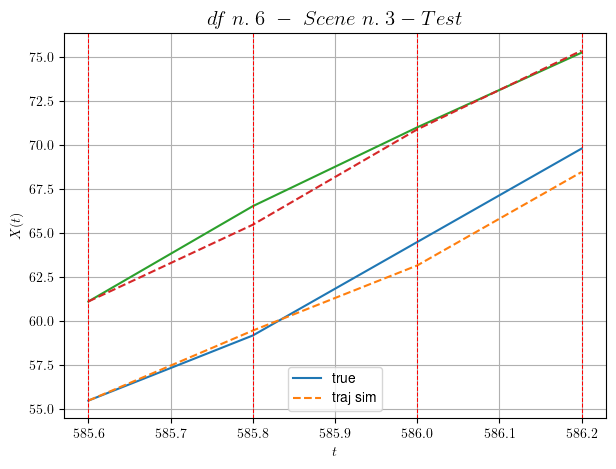

        For scene 3/18:
        * MSE = 0.5944916422818353
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/18


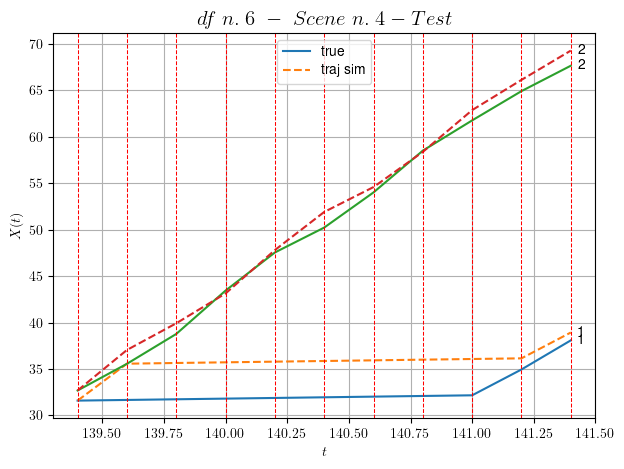

        For scene 4/18:
        * MSE = 6.205871820690699
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/18


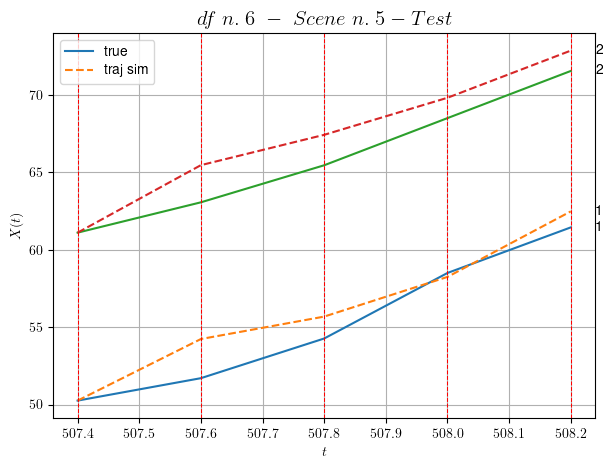

        For scene 5/18:
        * MSE = 2.2639227401217457
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/18


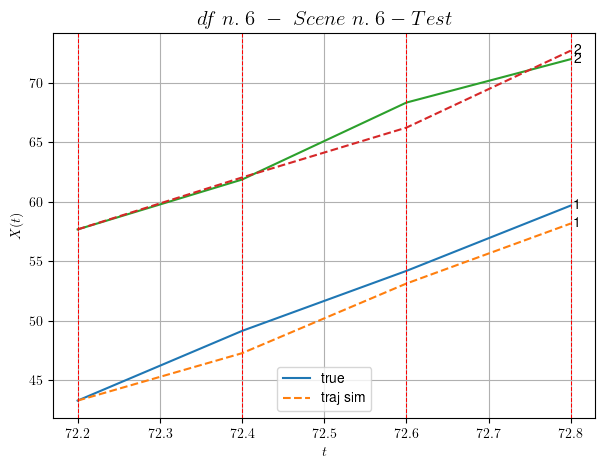

        For scene 6/18:
        * MSE = 1.4834526533583037
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/18


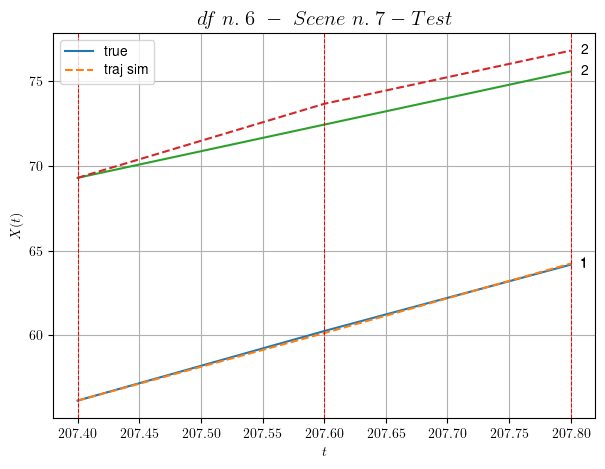

        For scene 7/18:
        * MSE = 0.5047784409455667
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/18


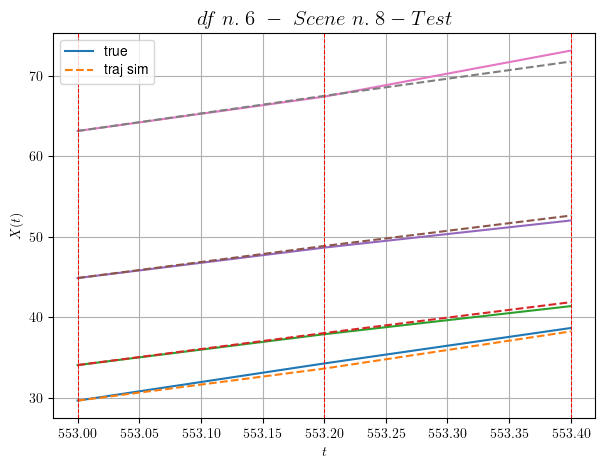

        For scene 8/18:
        * MSE = 0.25936161484222925
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/18


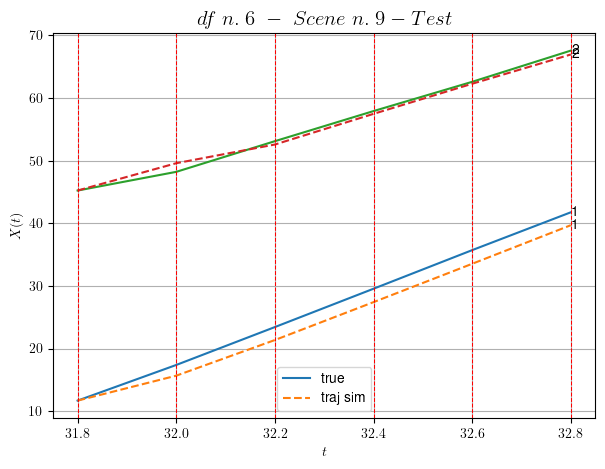

        For scene 9/18:
        * MSE = 1.9708169148620398
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/18


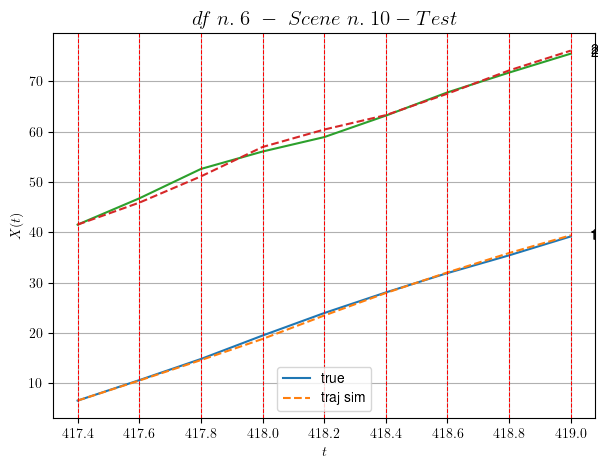

        For scene 10/18:
        * MSE = 0.4240549708710183
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/18


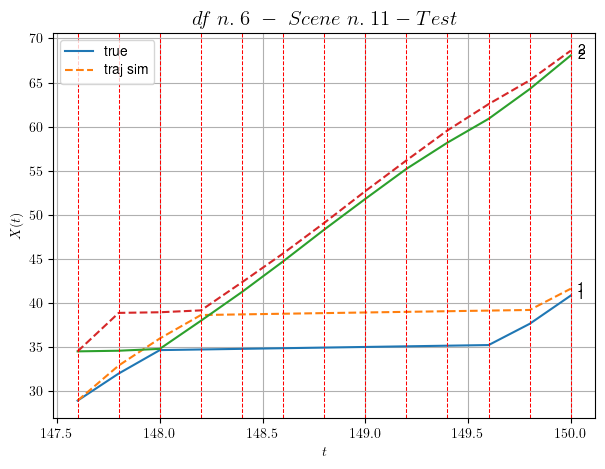

        For scene 11/18:
        * MSE = 6.732669619578721
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/18


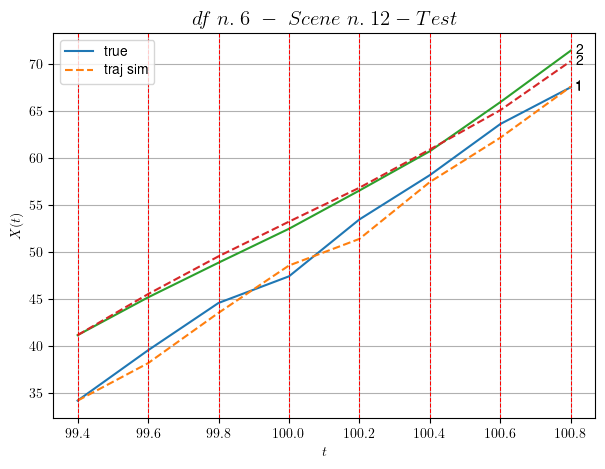

        For scene 12/18:
        * MSE = 0.905679188666726
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/18


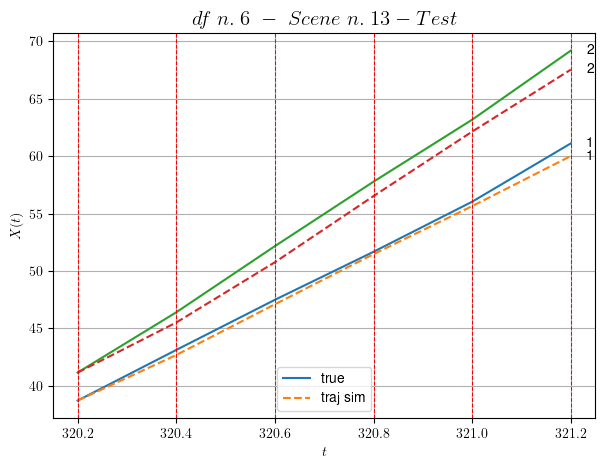

        For scene 13/18:
        * MSE = 0.826428293882057
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/18


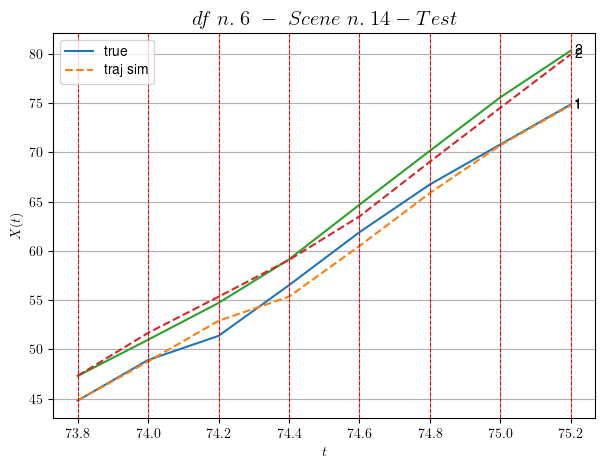

        For scene 14/18:
        * MSE = 0.701461498175645
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/18


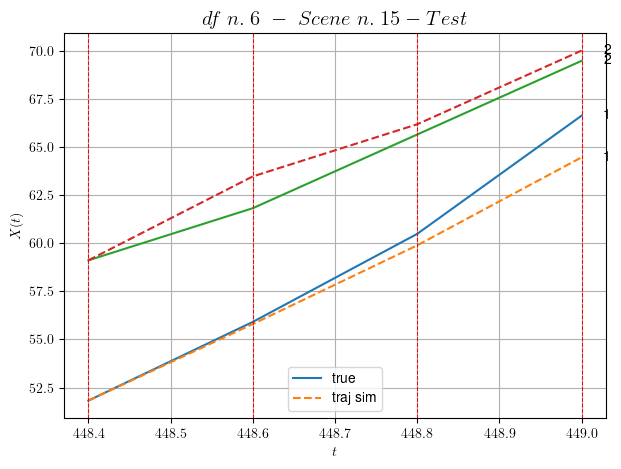

        For scene 15/18:
        * MSE = 1.0446757790681942
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/18


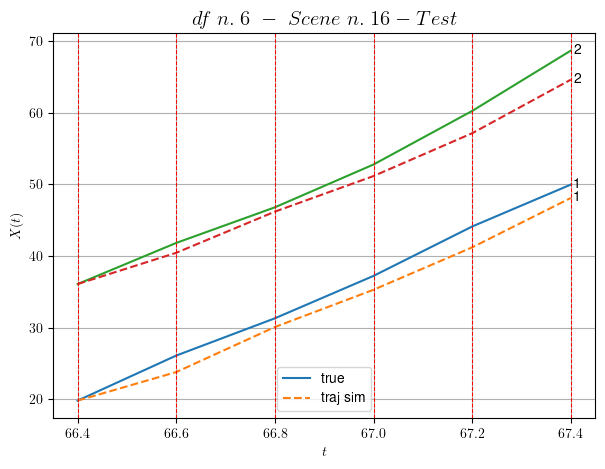

        For scene 16/18:
        * MSE = 4.454448963987625
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/18


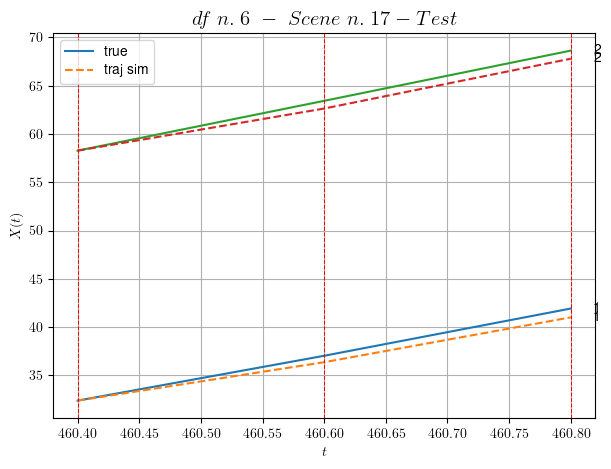

        For scene 17/18:
        * MSE = 0.4355717706999685
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/18


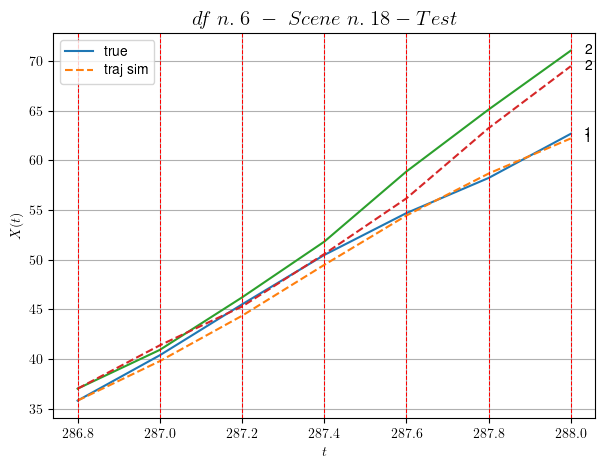

        For scene 18/18:
        * MSE = 1.3588775031206488
----------------------------------------------------------------------------------------------------


MSE test: 1.7415389884730113

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.464020138760305
          * MSE test: 1.7415389884730113
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 20 scenes, the remaining 10 to test the model.

Training step. (20 scenes)
DataFrame n.7. Scene n.1/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [60.56,61.56]


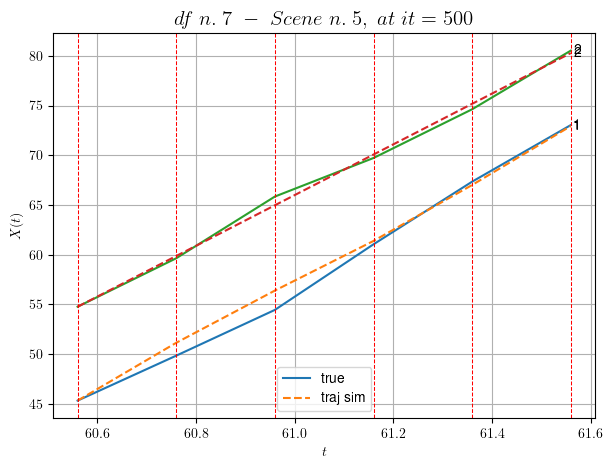

----------------------------------------------------------------------------------------------------
        For scene 1/20:
        * After LR finder: LR_NN=0.01 with mse=4.1657213745991415 at it=24
        * v0 = 25.52722016644284
        * MSE = 0.4439847156585192
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [177.76,178.56]


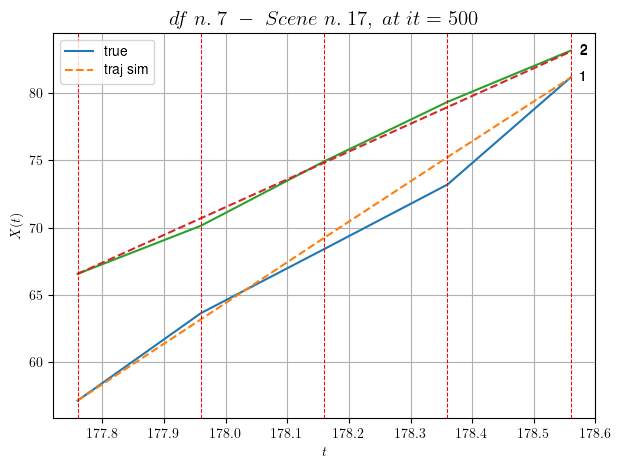

----------------------------------------------------------------------------------------------------
        For scene 2/20:
        * After LR finder: LR_NN=0.001 with mse=10.819782330698565 at it=24
        * v0 = 20.683526203706194
        * MSE = 0.5472946453958951
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [76.36,77.16]


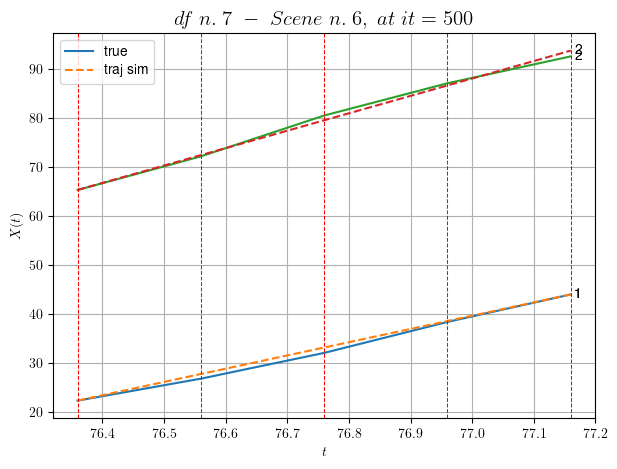

----------------------------------------------------------------------------------------------------
        For scene 3/20:
        * After LR finder: LR_NN=0.0005 with mse=3.7720066137824824 at it=24
        * v0 = 35.536767821833344
        * MSE = 0.4677706085687066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.96,155.56]


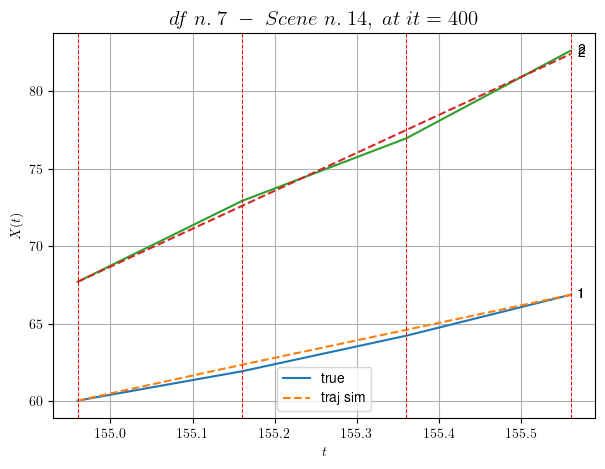

----------------------------------------------------------------------------------------------------
        For scene 4/20:
        * After LR finder: LR_NN=0.005 with mse=2.226884762583456 at it=24
        * v0 = 24.524878688521255
        * MSE = 0.09447846715465778
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [116.96,117.56]


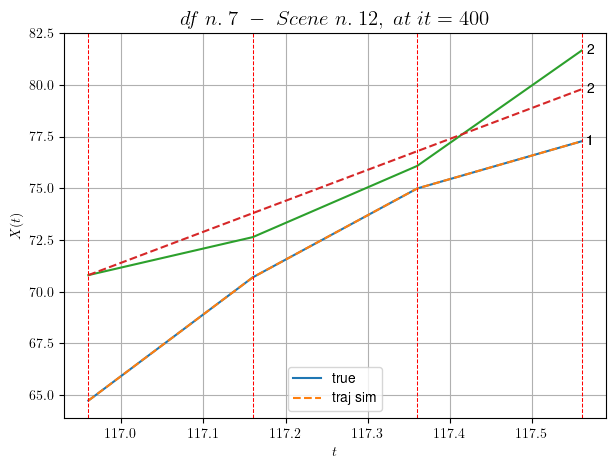

----------------------------------------------------------------------------------------------------
        For scene 5/20:
        * After LR finder: LR_NN=0.005 with mse=14.382834122050962 at it=24
        * v0 = 14.981640744091438
        * MSE = 0.6686026894362357
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.56,38.96]


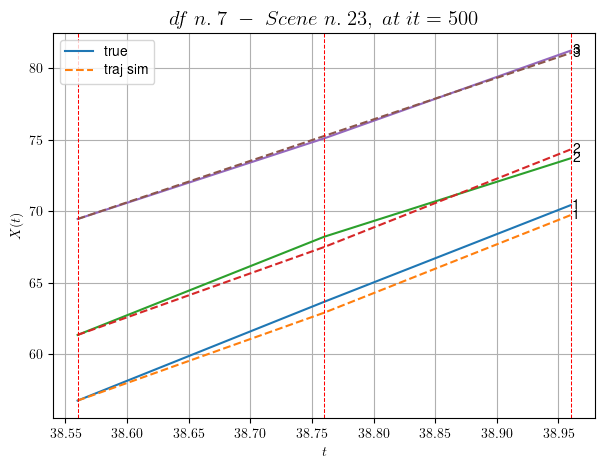

----------------------------------------------------------------------------------------------------
        For scene 6/20:
        * After LR finder: LR_NN=0.01 with mse=0.45643656398238736 at it=24
        * v0 = 28.99001059008483
        * MSE = 0.223930874097837
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [43.16,43.76]


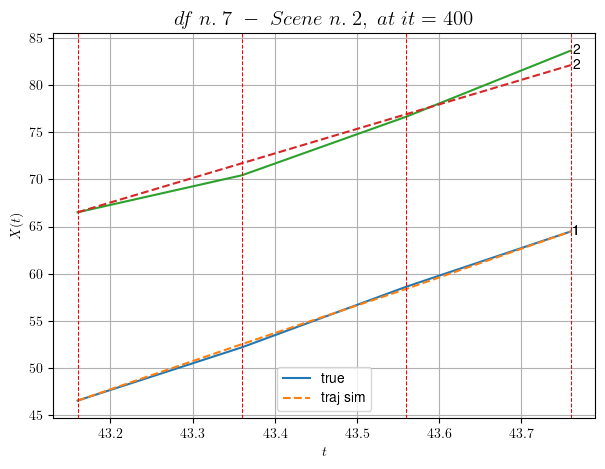

----------------------------------------------------------------------------------------------------
        For scene 7/20:
        * After LR finder: LR_NN=0.005 with mse=1.3135688560202272 at it=24
        * v0 = 25.959463575253302
        * MSE = 0.4611238646754337
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [44.96,46.36]


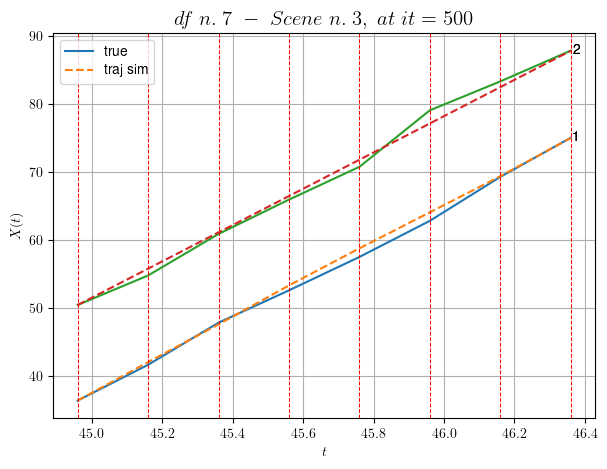

----------------------------------------------------------------------------------------------------
        For scene 8/20:
        * After LR finder: LR_NN=0.01 with mse=3.8746817743948645 at it=24
        * v0 = 26.657757035933475
        * MSE = 0.5715663659048706
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [162.76,163.16]


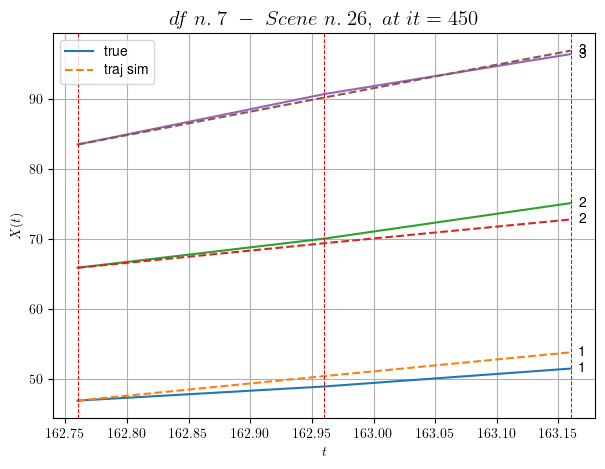

----------------------------------------------------------------------------------------------------
        For scene 9/20:
        * After LR finder: LR_NN=0.005 with mse=1.768050085970174 at it=24
        * v0 = 33.5145539133131
        * MSE = 1.549093111214361
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [51.36,52.36]


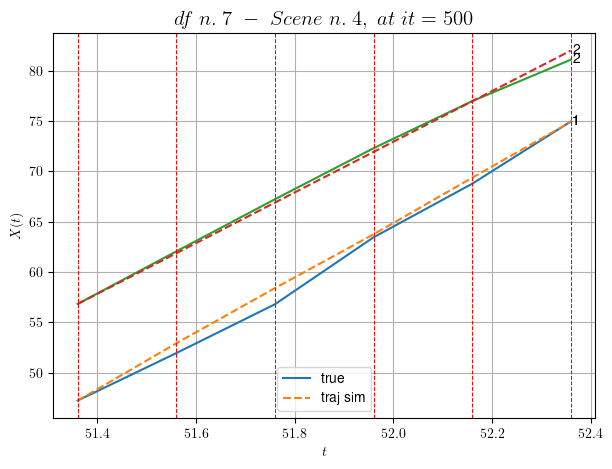

----------------------------------------------------------------------------------------------------
        For scene 10/20:
        * After LR finder: LR_NN=0.005 with mse=5.135235567635768 at it=24
        * v0 = 25.15874060713291
        * MSE = 0.4157686513333799
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [226.76,228.16]


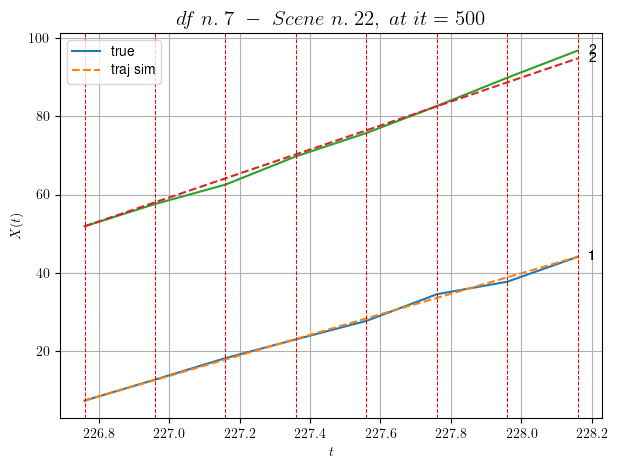

----------------------------------------------------------------------------------------------------
        For scene 11/20:
        * After LR finder: LR_NN=0.0005 with mse=1.1552071799660224 at it=24
        * v0 = 30.698361324533465
        * MSE = 0.7240147565202091
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [165.76,166.36]


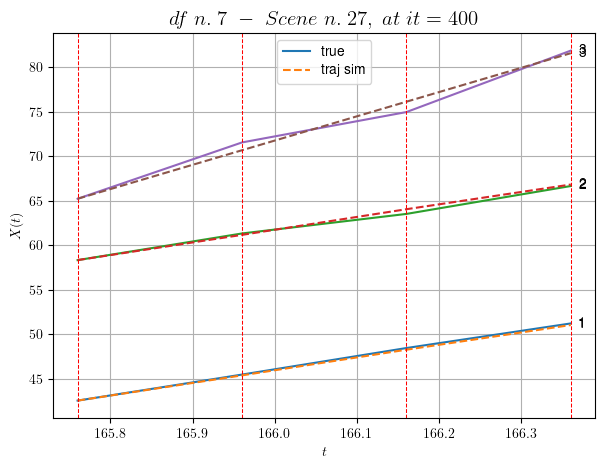

----------------------------------------------------------------------------------------------------
        For scene 12/20:
        * After LR finder: LR_NN=0.01 with mse=0.6337867664375791 at it=24
        * v0 = 27.262213356187985
        * MSE = 0.217252135611268
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [190.56,190.96]


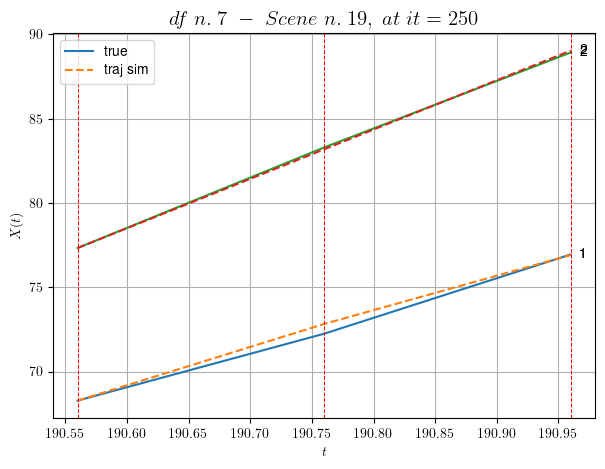

----------------------------------------------------------------------------------------------------
        For scene 13/20:
        * After LR finder: LR_NN=0.01 with mse=0.1403916813055018 at it=24
        * v0 = 29.283628125142897
        * MSE = 0.05735592334910068
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [166.56,167.36]


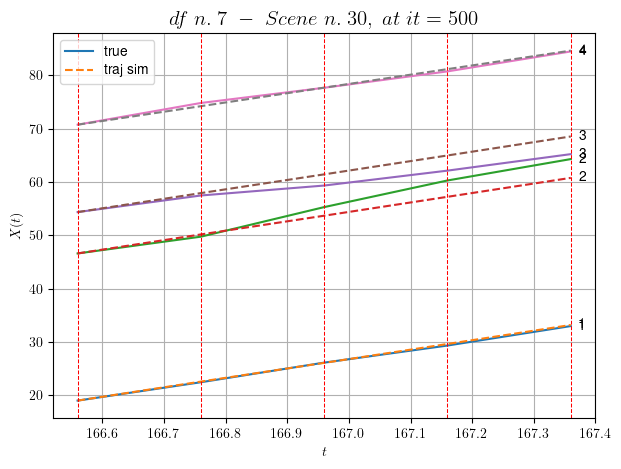

----------------------------------------------------------------------------------------------------
        For scene 14/20:
        * After LR finder: LR_NN=0.005 with mse=12.331319342494279 at it=24
        * v0 = 17.36863596906623
        * MSE = 2.4474206051436593
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [219.96,221.36]


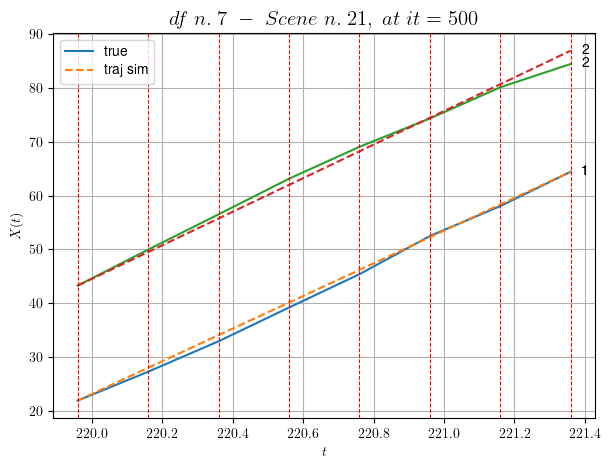

----------------------------------------------------------------------------------------------------
        For scene 15/20:
        * After LR finder: LR_NN=0.001 with mse=0.9063435025076136 at it=24
        * v0 = 31.22700758286223
        * MSE = 0.7228654942647765
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [86.96,87.56]


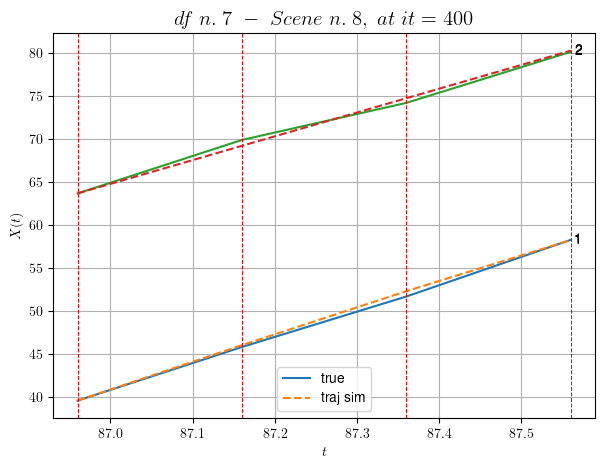

----------------------------------------------------------------------------------------------------
        For scene 16/20:
        * After LR finder: LR_NN=0.01 with mse=0.6925294293180623 at it=24
        * v0 = 27.63329479005907
        * MSE = 0.14839869005648684
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [110.96,112.36]


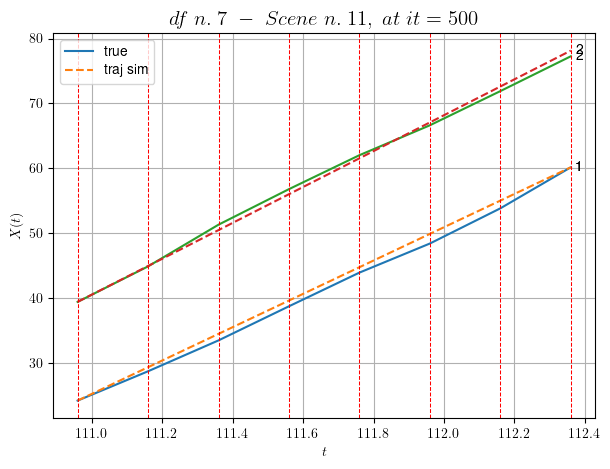

----------------------------------------------------------------------------------------------------
        For scene 17/20:
        * After LR finder: LR_NN=0.0005 with mse=2.7064065521875444 at it=24
        * v0 = 27.67625680745916
        * MSE = 0.5954754491293748
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


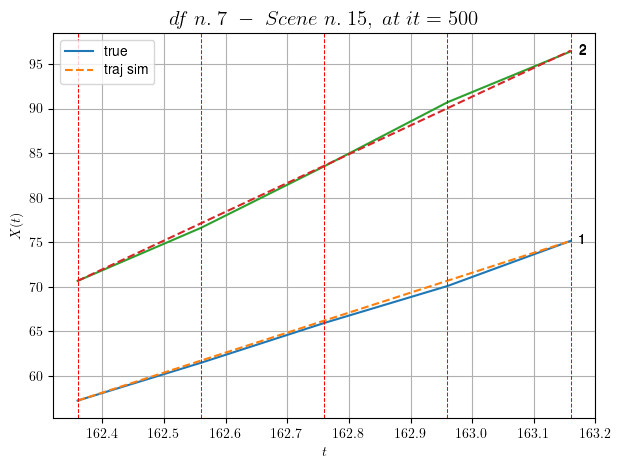

----------------------------------------------------------------------------------------------------
        For scene 18/20:
        * After LR finder: LR_NN=0.0005 with mse=0.87122059493313 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.12001428484752265
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


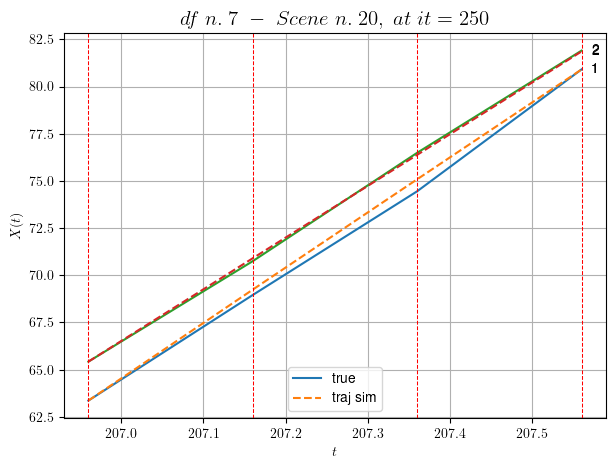

----------------------------------------------------------------------------------------------------
        For scene 19/20:
        * After LR finder: LR_NN=0.001 with mse=0.6336748881270198 at it=24
        * v0 = 27.399263722501857
        * MSE = 0.06446042859327956
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


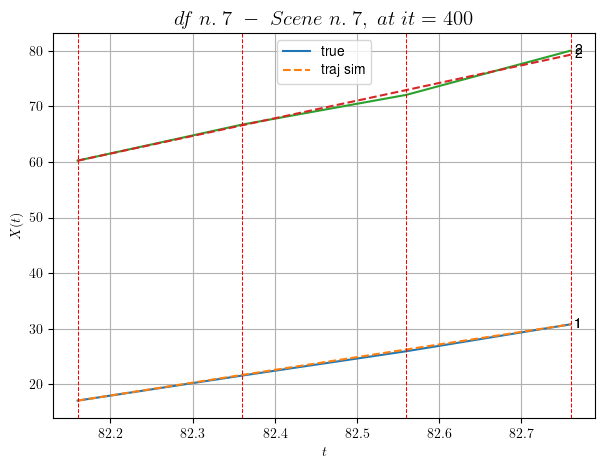

----------------------------------------------------------------------------------------------------
        For scene 20/20:
        * After LR finder: LR_NN=0.005 with mse=0.4548912453935803 at it=24
        * v0 = 31.745431021112278
        * MSE = 0.17696200833233283
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.5358916884643954
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (10 scenes)
DataFrame n.7. Scene n.1/10


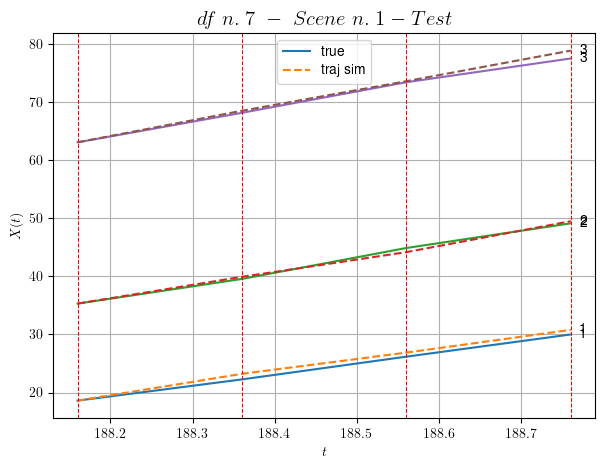

        For scene 1/10:
        * MSE = 0.40014003398175607
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/10


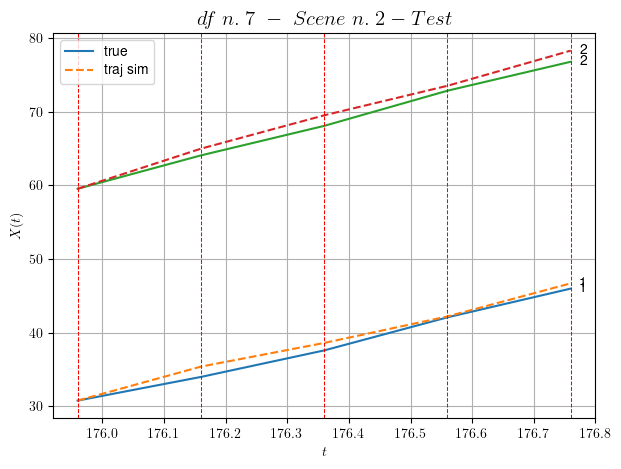

        For scene 2/10:
        * MSE = 0.9121972673858625
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/10


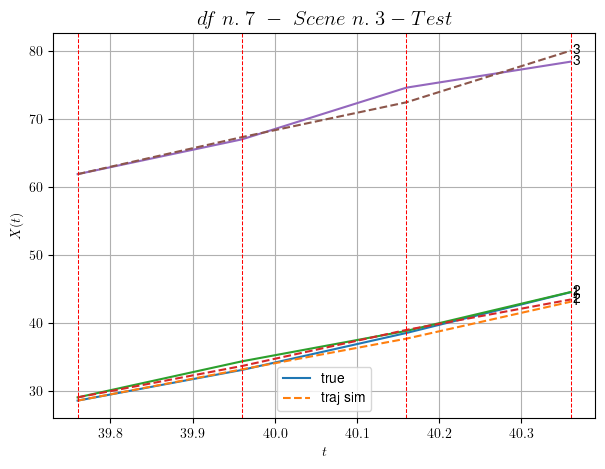

        For scene 3/10:
        * MSE = 0.9772318474505969
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/10


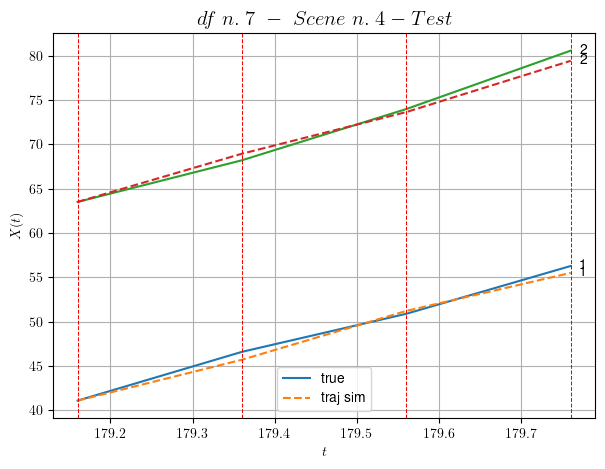

        For scene 4/10:
        * MSE = 0.43486666886859504
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/10


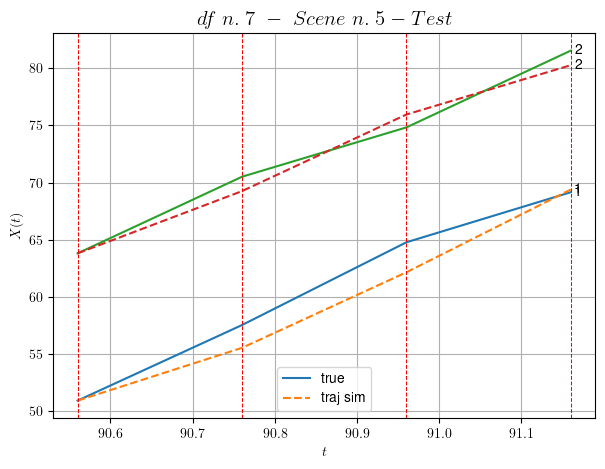

        For scene 5/10:
        * MSE = 1.9233539180363726
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/10


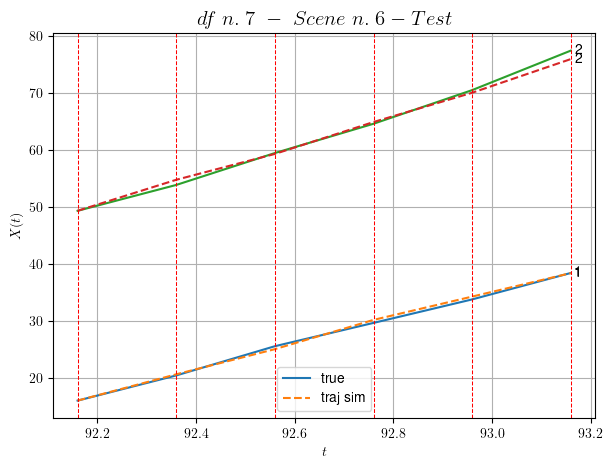

        For scene 6/10:
        * MSE = 0.3491851863088132
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/10


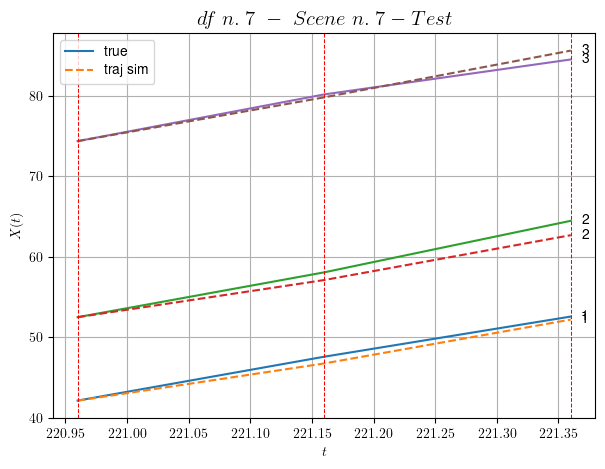

        For scene 7/10:
        * MSE = 0.6991920309725482
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/10


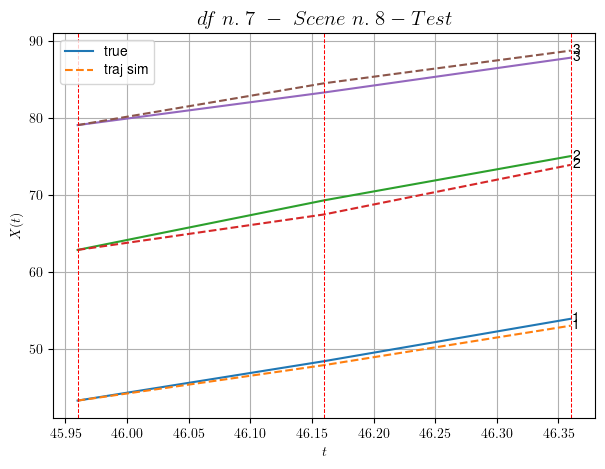

        For scene 8/10:
        * MSE = 0.8907136778098791
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/10


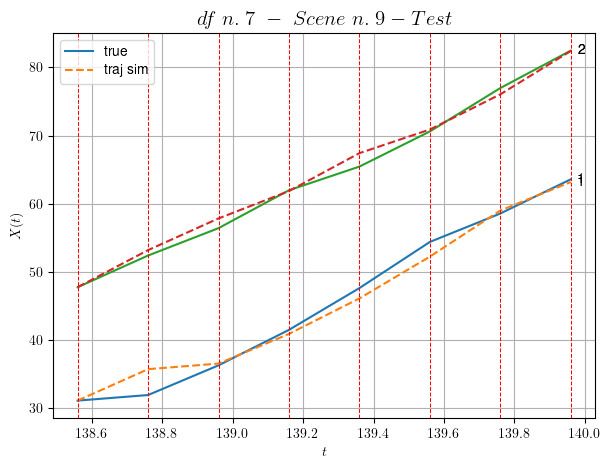

        For scene 9/10:
        * MSE = 1.8513500863181513
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/10


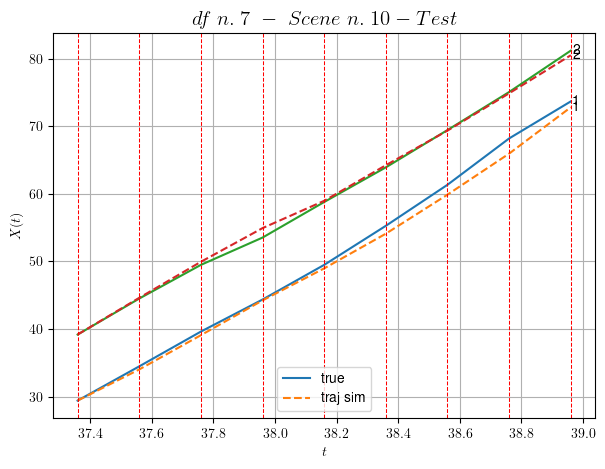

        For scene 10/10:
        * MSE = 0.7161613950581387
----------------------------------------------------------------------------------------------------


MSE test: 0.9154392112190713

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5358916884643954
          * MSE test: 0.9154392112190713
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 52 scenes, the remaining 27 to test the model.

Training step. (52 scenes)
DataFrame n.8. Scene n.1/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [574.24,575.04]


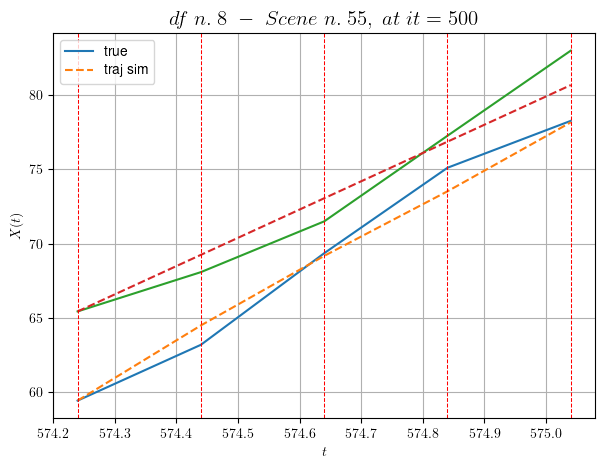

----------------------------------------------------------------------------------------------------
        For scene 1/52:
        * After LR finder: LR_NN=0.005 with mse=13.599159476594666 at it=24
        * v0 = 19.07774944355231
        * MSE = 1.362135433096158
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [194.44,194.84]


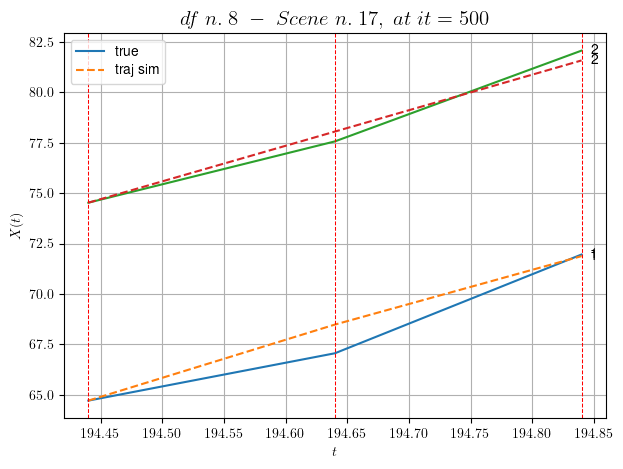

----------------------------------------------------------------------------------------------------
        For scene 2/52:
        * After LR finder: LR_NN=0.005 with mse=5.132680066602826 at it=24
        * v0 = 17.64870499817848
        * MSE = 0.40774014392534735
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [458.64,460.24]


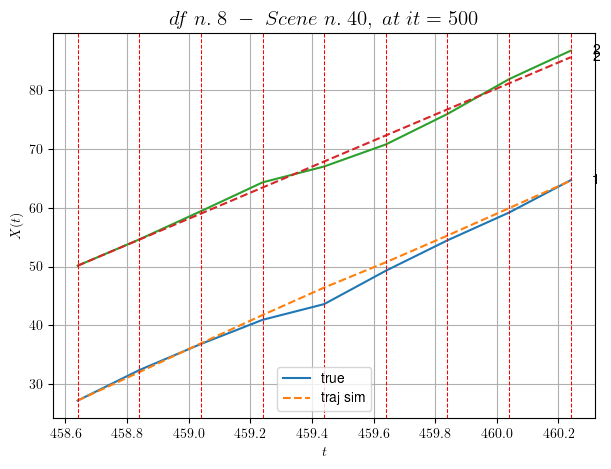

----------------------------------------------------------------------------------------------------
        For scene 3/52:
        * After LR finder: LR_NN=0.01 with mse=28.380840633472637 at it=24
        * v0 = 22.184785448498932
        * MSE = 1.007860487843137
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [587.44,587.84]


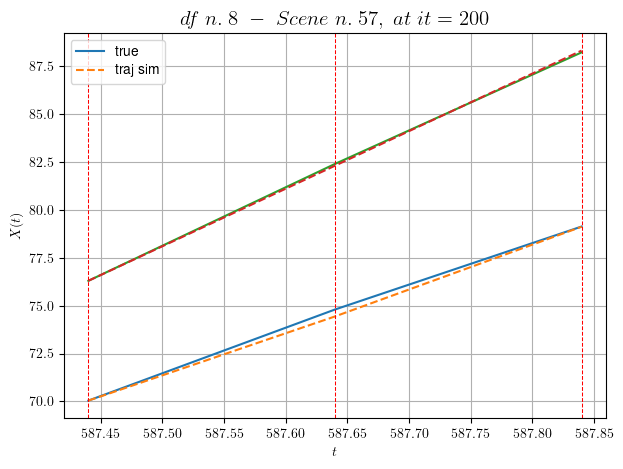

----------------------------------------------------------------------------------------------------
        For scene 4/52:
        * After LR finder: LR_NN=0.01 with mse=0.38027982927507925 at it=24
        * v0 = 30.037169893910686
        * MSE = 0.024351625134124776
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [256.44,257.24]


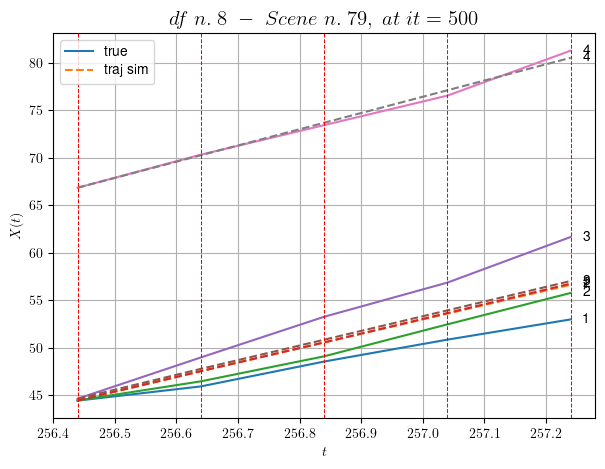

----------------------------------------------------------------------------------------------------
        For scene 5/52:
        * After LR finder: LR_NN=0.005 with mse=12.450525070280928 at it=24
        * v0 = 17.104258674666113
        * MSE = 3.5671398340960625
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [105.04,105.64]


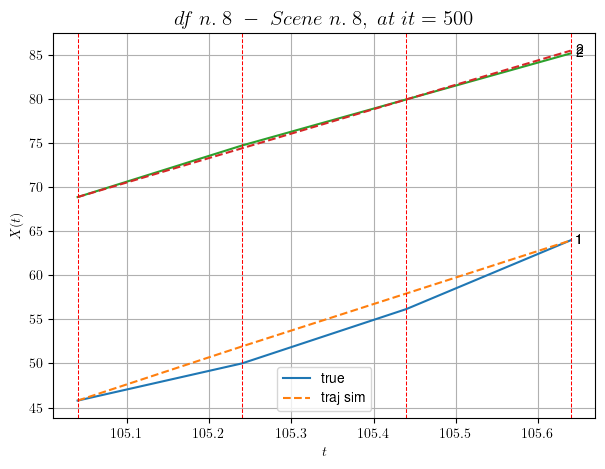

----------------------------------------------------------------------------------------------------
        For scene 6/52:
        * After LR finder: LR_NN=0.001 with mse=1.6127440881536144 at it=24
        * v0 = 27.6880246218235
        * MSE = 0.8523768041666804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.84,532.84]


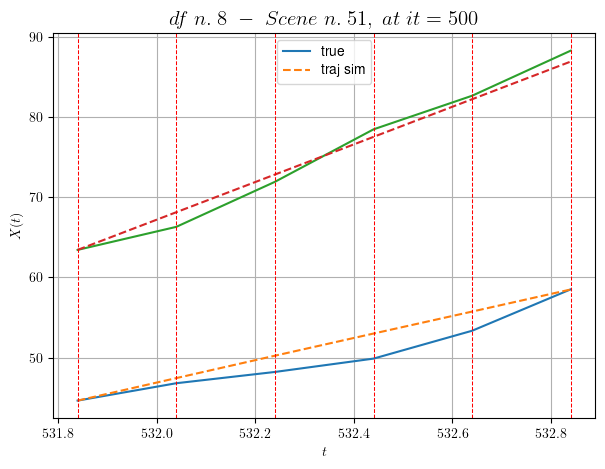

----------------------------------------------------------------------------------------------------
        For scene 7/52:
        * After LR finder: LR_NN=0.001 with mse=8.548745285420207 at it=24
        * v0 = 23.472410774642288
        * MSE = 2.2235611632006593
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [548.04,549.44]


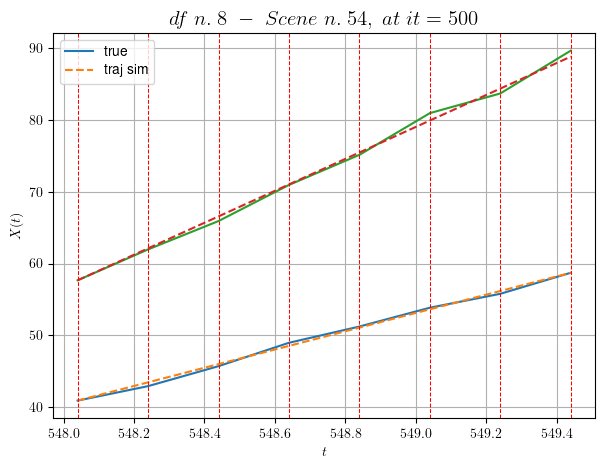

----------------------------------------------------------------------------------------------------
        For scene 8/52:
        * After LR finder: LR_NN=0.001 with mse=20.453676832929688 at it=24
        * v0 = 22.28422335728387
        * MSE = 0.2160513302940858
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/52
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [250.44,252.64]


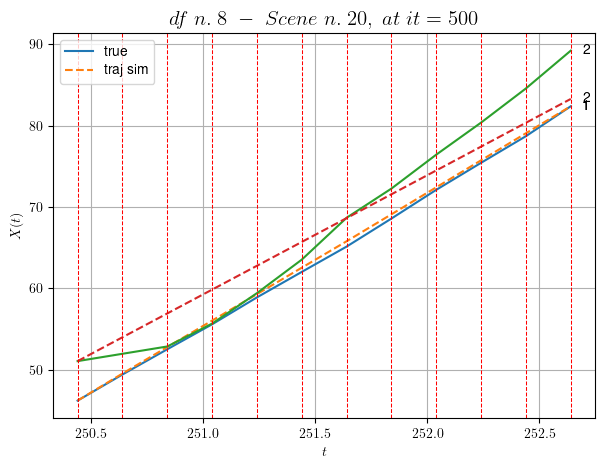

----------------------------------------------------------------------------------------------------
        For scene 9/52:
        * After LR finder: LR_NN=0.001 with mse=176.30955061567212 at it=24
        * v0 = 14.64482444851779
        * MSE = 4.131093139146329
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [227.04,227.84]


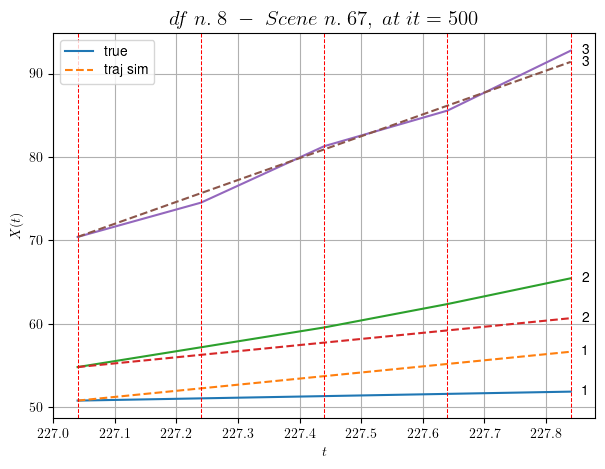

----------------------------------------------------------------------------------------------------
        For scene 10/52:
        * After LR finder: LR_NN=0.001 with mse=3.1480255481656343 at it=24
        * v0 = 26.24315546538644
        * MSE = 5.5497135612052135
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [319.44,320.44]


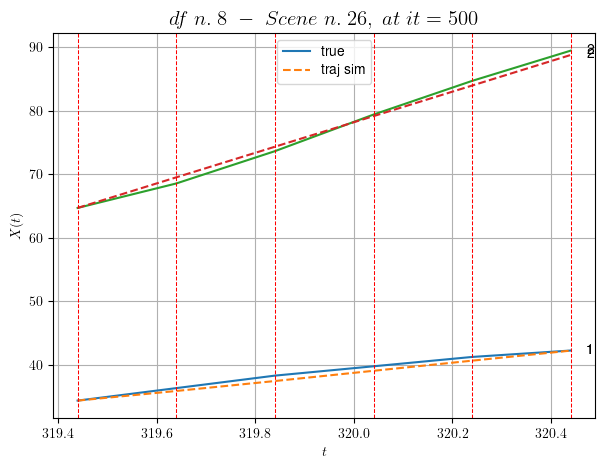

----------------------------------------------------------------------------------------------------
        For scene 11/52:
        * After LR finder: LR_NN=0.01 with mse=5.9039969389880005 at it=24
        * v0 = 24.072557838554268
        * MSE = 0.34737564411185246
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/52
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [496.44,498.84]


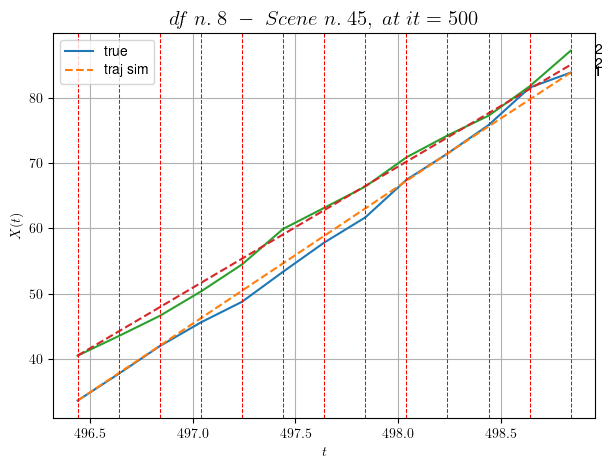

----------------------------------------------------------------------------------------------------
        For scene 12/52:
        * After LR finder: LR_NN=0.0005 with mse=126.91142684554892 at it=24
        * v0 = 18.54683152376548
        * MSE = 0.8100579441944311
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [176.24,176.64]


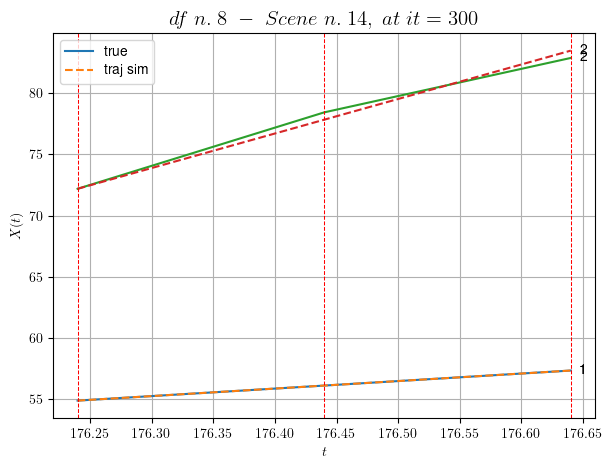

----------------------------------------------------------------------------------------------------
        For scene 13/52:
        * After LR finder: LR_NN=0.001 with mse=0.3061588314020677 at it=24
        * v0 = 28.209764281783194
        * MSE = 0.11948262179022769
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [477.84,478.84]


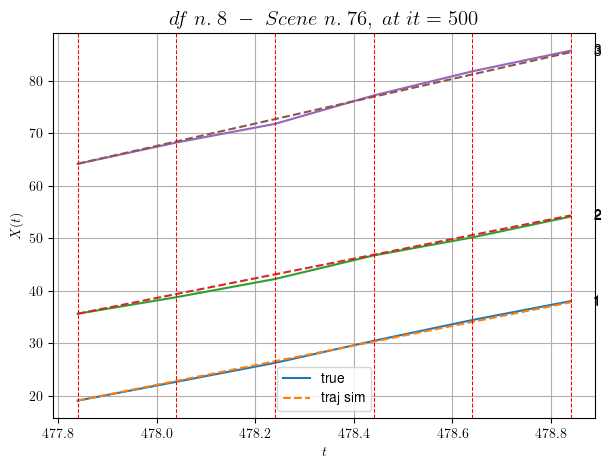

----------------------------------------------------------------------------------------------------
        For scene 14/52:
        * After LR finder: LR_NN=0.001 with mse=9.010202197619591 at it=24
        * v0 = 21.26815930217725
        * MSE = 0.16498224152211605
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [58.44,59.84]


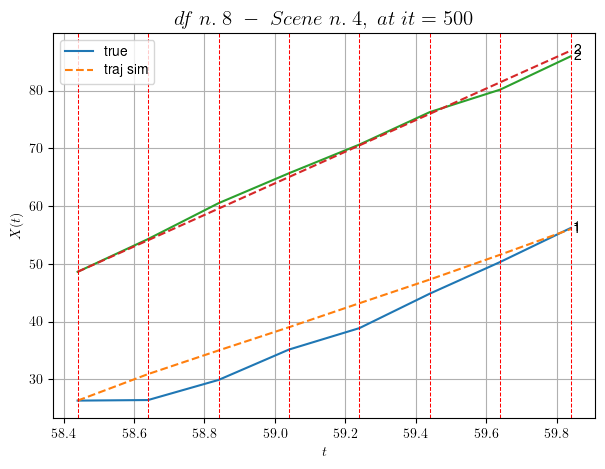

----------------------------------------------------------------------------------------------------
        For scene 15/52:
        * After LR finder: LR_NN=0.005 with mse=7.505245484814148 at it=24
        * v0 = 27.356016886559097
        * MSE = 4.694910734935504
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [197.84,198.64]


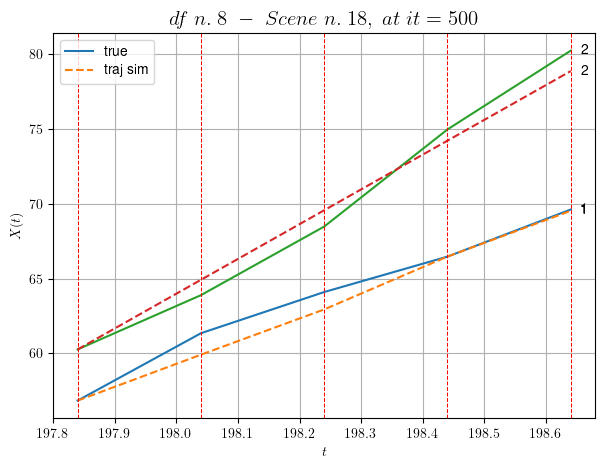

----------------------------------------------------------------------------------------------------
        For scene 16/52:
        * After LR finder: LR_NN=0.01 with mse=4.962250662426762 at it=24
        * v0 = 23.275091763732032
        * MSE = 0.6871914372641216
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [456.44,457.24]


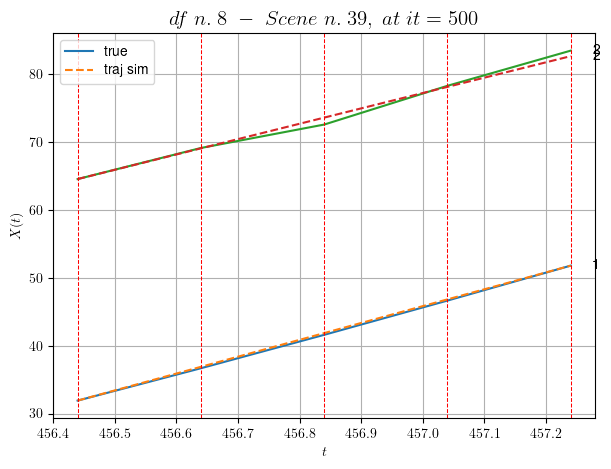

----------------------------------------------------------------------------------------------------
        For scene 17/52:
        * After LR finder: LR_NN=0.0005 with mse=6.17853987792658 at it=24
        * v0 = 22.637249688334062
        * MSE = 0.17810980185615177
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [116.04,116.44]


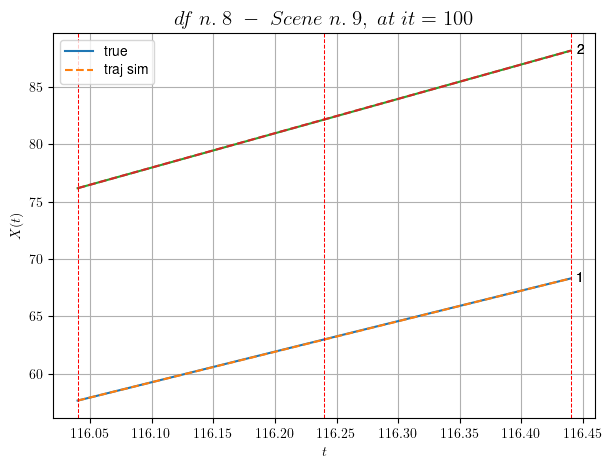

----------------------------------------------------------------------------------------------------
        For scene 18/52:
        * After LR finder: LR_NN=0.005 with mse=0.00038449816201937317 at it=24
        * v0 = 29.990567491625175
        * MSE = 8.03774717525214e-05
        * iterations = 100
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [225.24,226.24]


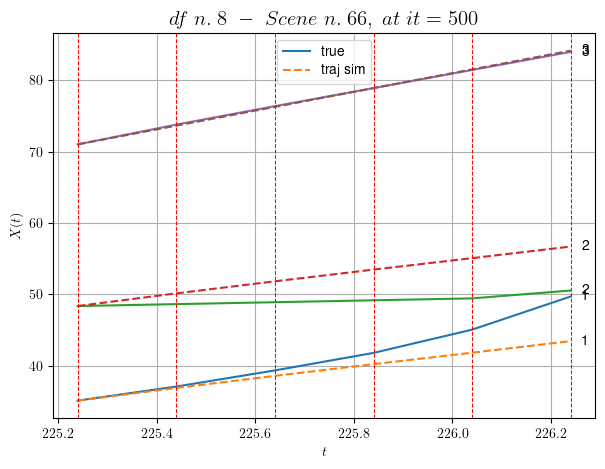

----------------------------------------------------------------------------------------------------
        For scene 19/52:
        * After LR finder: LR_NN=0.01 with mse=43.47923895843439 at it=24
        * v0 = 13.14368339870336
        * MSE = 8.429062744829965
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/52
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [101.04,103.04]


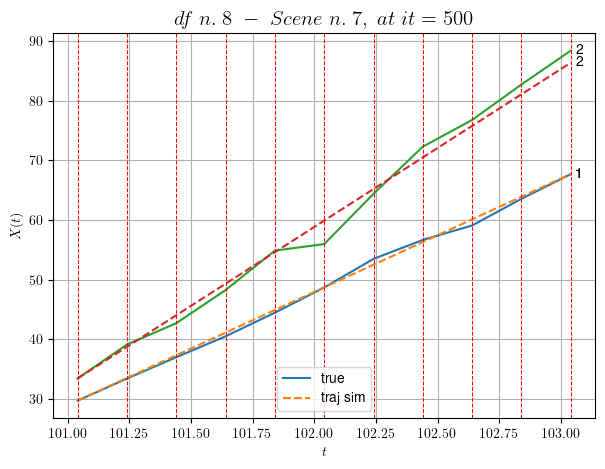

----------------------------------------------------------------------------------------------------
        For scene 20/52:
        * After LR finder: LR_NN=0.001 with mse=8.437119827814037 at it=24
        * v0 = 26.48969548240825
        * MSE = 1.4378564165981036
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [445.44,448.24]


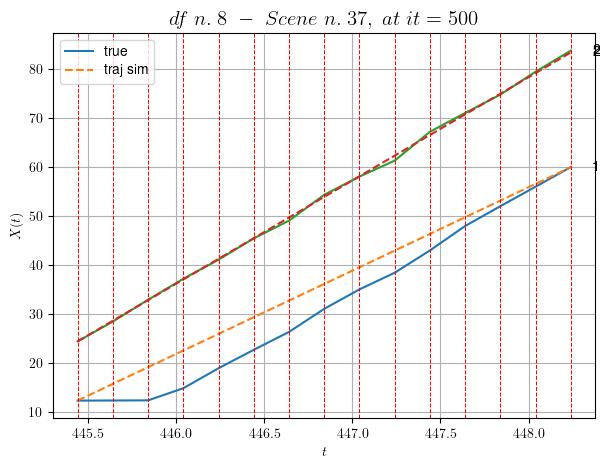

----------------------------------------------------------------------------------------------------
        For scene 21/52:
        * After LR finder: LR_NN=0.0005 with mse=109.26044398629716 at it=24
        * v0 = 21.04037373587041
        * MSE = 10.821251548060319
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [350.64,351.64]


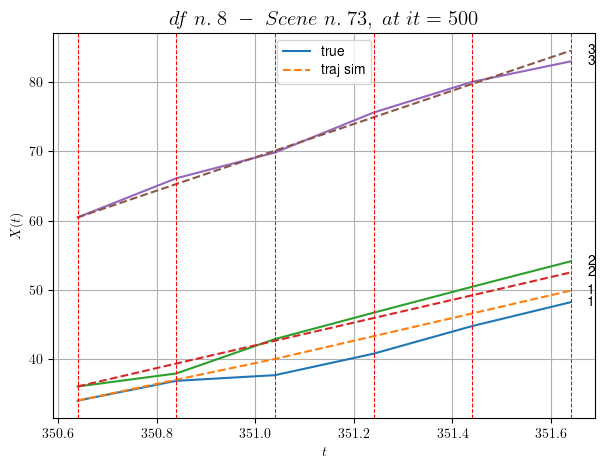

----------------------------------------------------------------------------------------------------
        For scene 22/52:
        * After LR finder: LR_NN=0.001 with mse=6.804291531113894 at it=24
        * v0 = 24.01755603165805
        * MSE = 1.5792029448407228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [36.44,37.04]


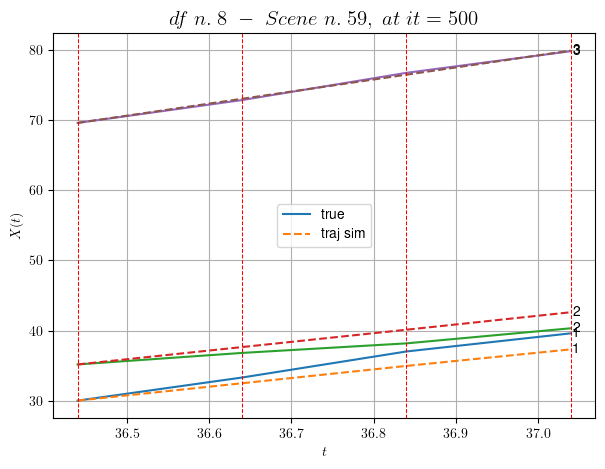

----------------------------------------------------------------------------------------------------
        For scene 23/52:
        * After LR finder: LR_NN=0.01 with mse=9.376780268156875 at it=24
        * v0 = 17.156795934620828
        * MSE = 1.6576491854267503
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [516.64,517.44]


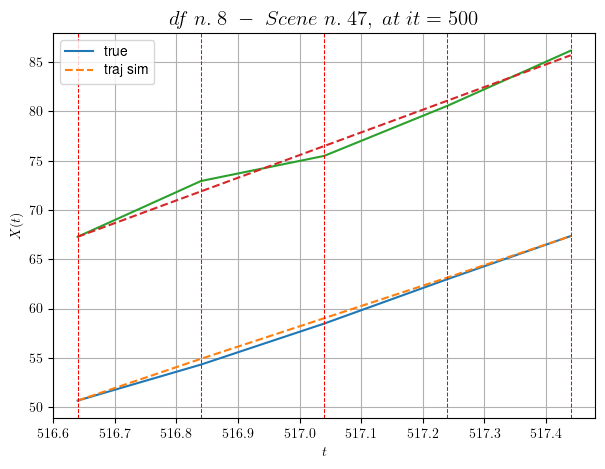

----------------------------------------------------------------------------------------------------
        For scene 24/52:
        * After LR finder: LR_NN=0.005 with mse=6.336067429788735 at it=24
        * v0 = 23.01946389183454
        * MSE = 0.3249419977840923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [593.04,594.44]


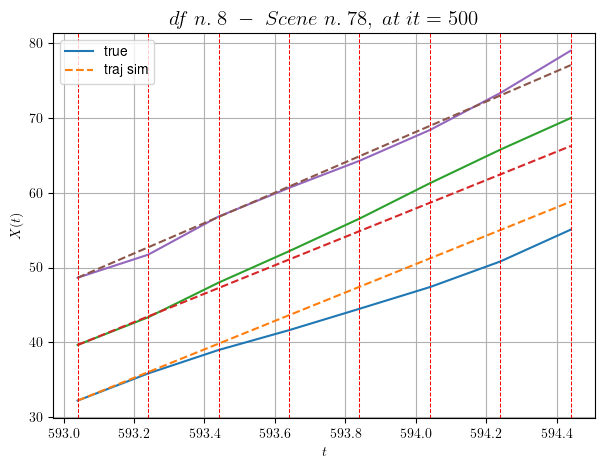

----------------------------------------------------------------------------------------------------
        For scene 25/52:
        * After LR finder: LR_NN=0.001 with mse=24.777117699704274 at it=24
        * v0 = 20.297836048725713
        * MSE = 4.213104763827437
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [190.84,191.84]


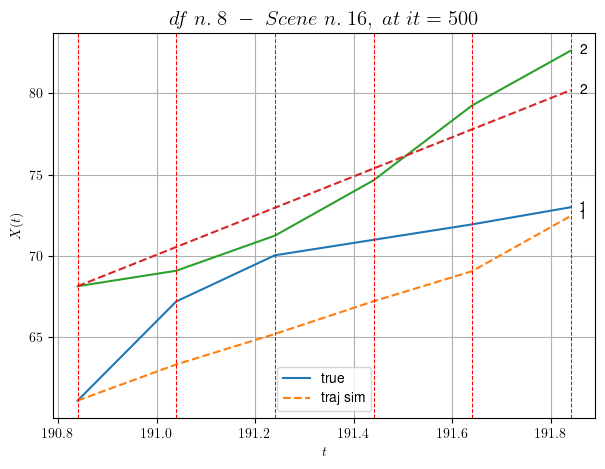

----------------------------------------------------------------------------------------------------
        For scene 26/52:
        * After LR finder: LR_NN=0.01 with mse=58.05811770361646 at it=24
        * v0 = 12.068548421445666
        * MSE = 6.217289409948895
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [327.84,329.64]


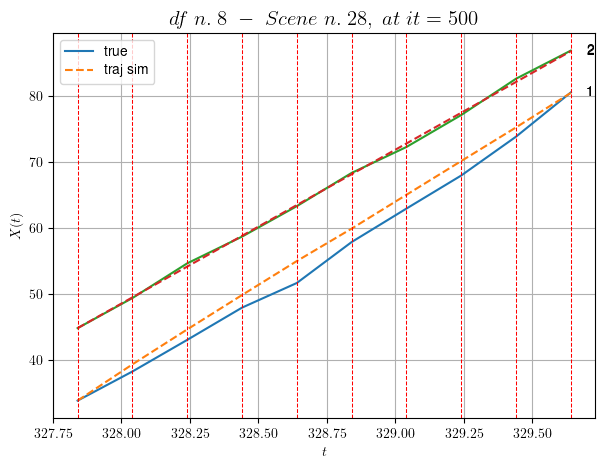

----------------------------------------------------------------------------------------------------
        For scene 27/52:
        * After LR finder: LR_NN=0.01 with mse=26.4300972832148 at it=24
        * v0 = 23.318084130194524
        * MSE = 1.2045743556058242
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [488.24,490.04]


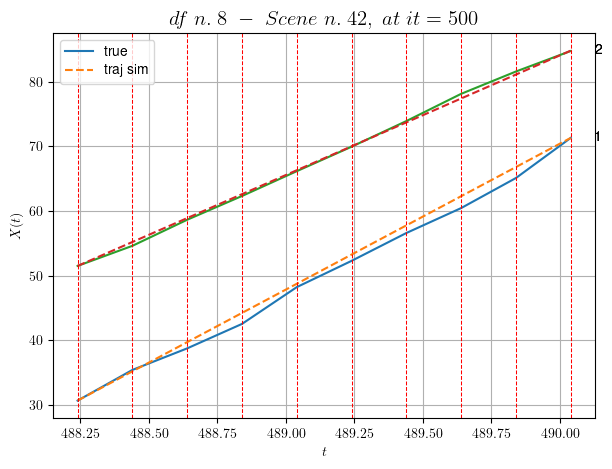

----------------------------------------------------------------------------------------------------
        For scene 28/52:
        * After LR finder: LR_NN=0.0005 with mse=74.21521611991199 at it=24
        * v0 = 18.5107995991639
        * MSE = 0.7003914856974149
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [323.44,325.04]


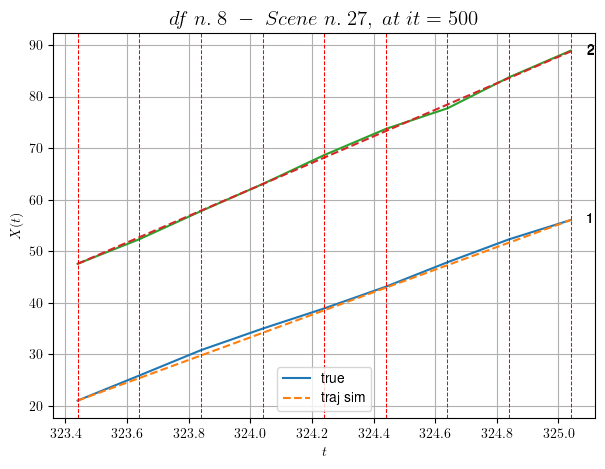

----------------------------------------------------------------------------------------------------
        For scene 29/52:
        * After LR finder: LR_NN=0.001 with mse=8.266595288029011 at it=24
        * v0 = 25.75837440986048
        * MSE = 0.2232873006841957
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [521.04,522.44]


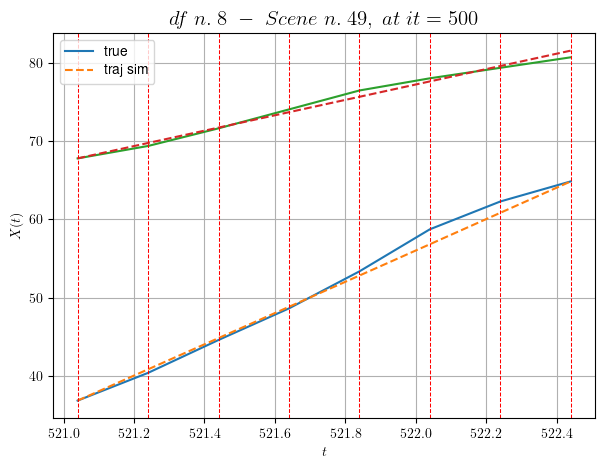

----------------------------------------------------------------------------------------------------
        For scene 30/52:
        * After LR finder: LR_NN=0.0005 with mse=143.5367359984407 at it=24
        * v0 = 9.856007983844798
        * MSE = 0.5139913774211988
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [313.24,313.64]


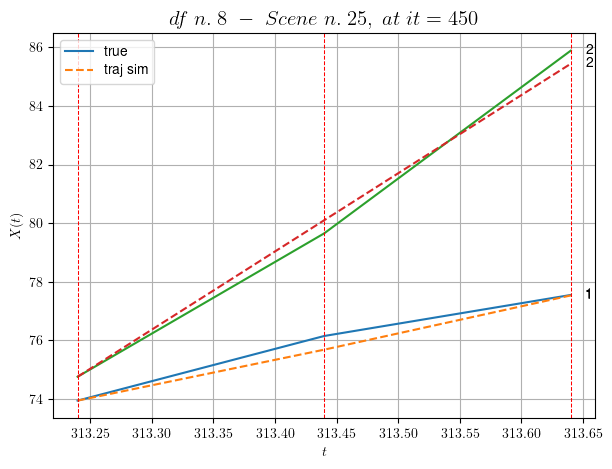

----------------------------------------------------------------------------------------------------
        For scene 31/52:
        * After LR finder: LR_NN=0.01 with mse=0.3365269205130168 at it=24
        * v0 = 26.698670162592517
        * MSE = 0.10121228869709446
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [494.44,495.84]


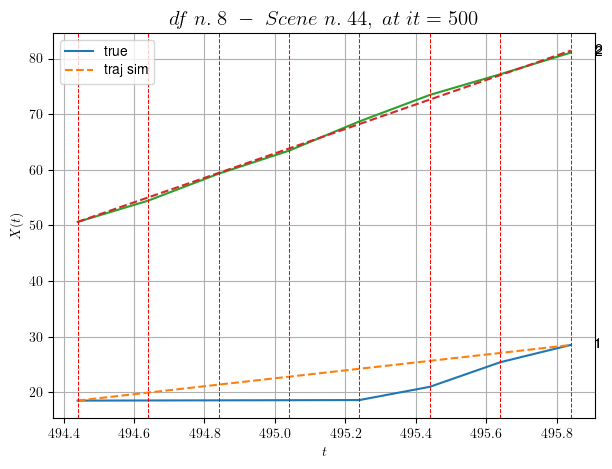

----------------------------------------------------------------------------------------------------
        For scene 32/52:
        * After LR finder: LR_NN=0.0005 with mse=25.580478587083153 at it=24
        * v0 = 22.008439992316802
        * MSE = 5.322909670286728
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [522.64,523.04]


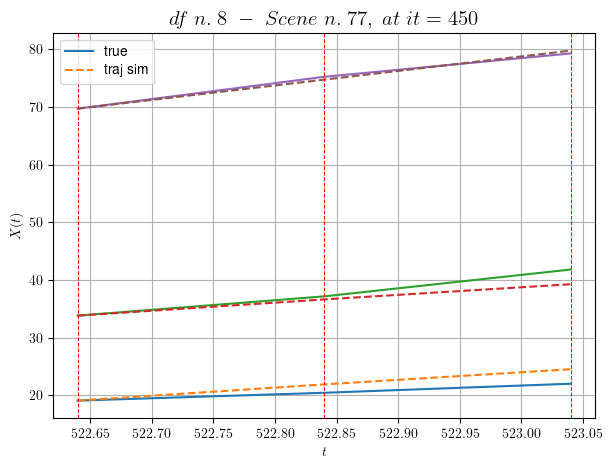

----------------------------------------------------------------------------------------------------
        For scene 33/52:
        * After LR finder: LR_NN=0.01 with mse=2.4216781208945473 at it=24
        * v0 = 25.1559738517065
        * MSE = 1.7466226247021641
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [592.84,594.44]


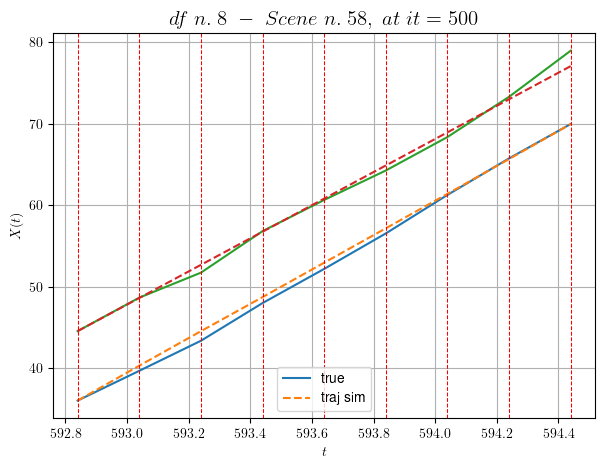

----------------------------------------------------------------------------------------------------
        For scene 34/52:
        * After LR finder: LR_NN=0.005 with mse=40.7406662482484 at it=24
        * v0 = 20.35405742351409
        * MSE = 0.413870131242417
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.24,154.84]


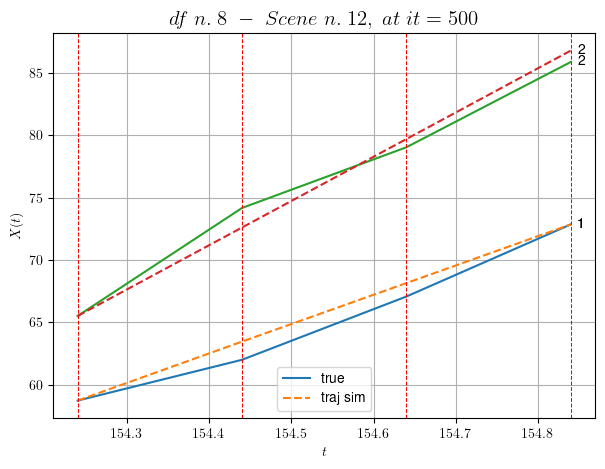

----------------------------------------------------------------------------------------------------
        For scene 35/52:
        * After LR finder: LR_NN=0.0005 with mse=2.2106269932077174 at it=24
        * v0 = 35.440393347036846
        * MSE = 0.8233195404200007
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [404.84,405.44]


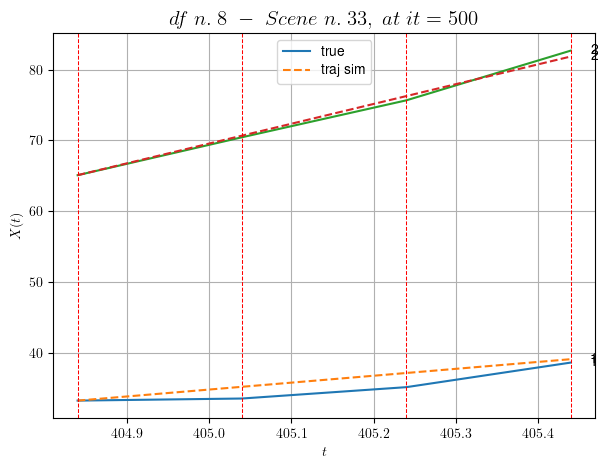

----------------------------------------------------------------------------------------------------
        For scene 36/52:
        * After LR finder: LR_NN=5e-05 with mse=0.7250490784458856 at it=24
        * v0 = 27.902766852719747
        * MSE = 1.0072364058369716
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [414.44,414.84]


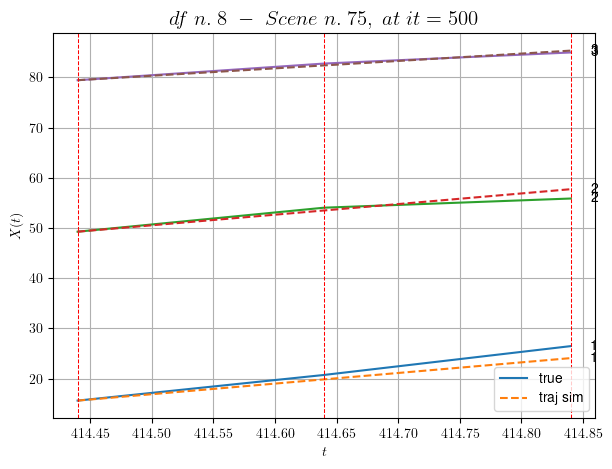

----------------------------------------------------------------------------------------------------
        For scene 37/52:
        * After LR finder: LR_NN=5e-05 with mse=6.058233537521193 at it=24
        * v0 = 14.740228637605592
        * MSE = 1.1688993236820944
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [50.24,51.04]


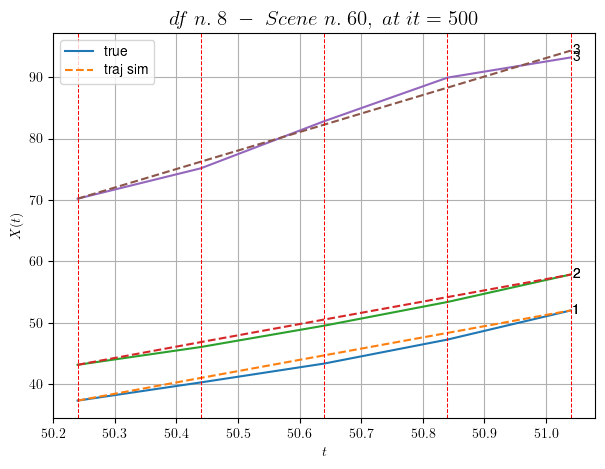

----------------------------------------------------------------------------------------------------
        For scene 38/52:
        * After LR finder: LR_NN=0.001 with mse=0.8267785578508487 at it=24
        * v0 = 30.157660974110723
        * MSE = 0.7410684992337896
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [215.24,216.24]


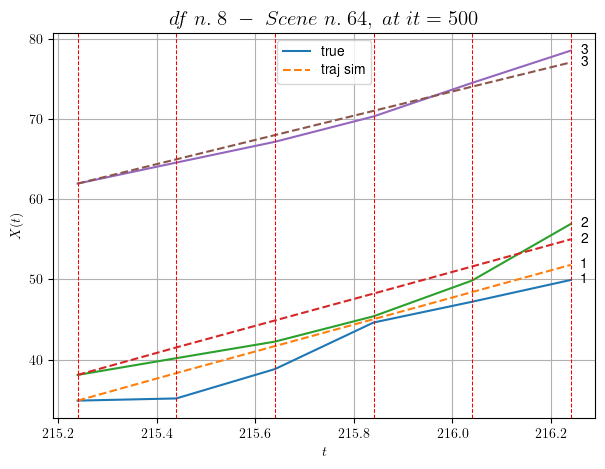

----------------------------------------------------------------------------------------------------
        For scene 39/52:
        * After LR finder: LR_NN=0.001 with mse=27.956424899201227 at it=24
        * v0 = 15.10068961055024
        * MSE = 2.7771807389445553
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [243.44,244.24]


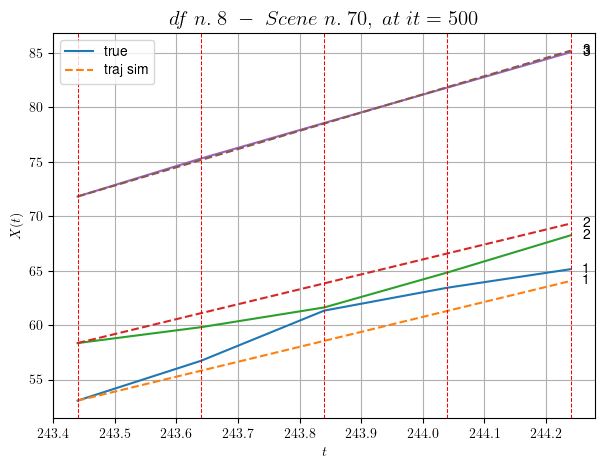

----------------------------------------------------------------------------------------------------
        For scene 40/52:
        * After LR finder: LR_NN=0.001 with mse=15.721840105060927 at it=24
        * v0 = 16.742914270051212
        * MSE = 1.6692953484327686
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [453.64,454.24]


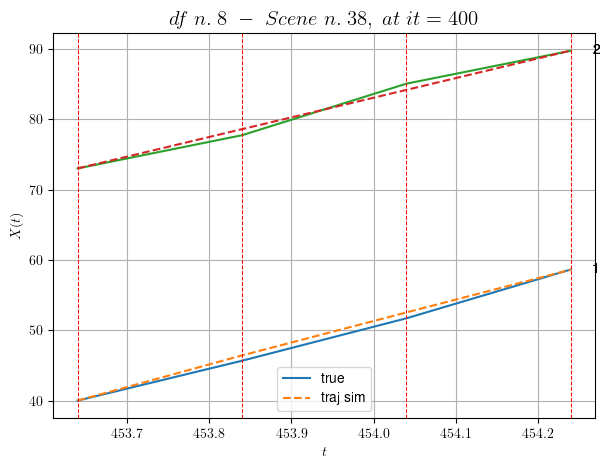

----------------------------------------------------------------------------------------------------
        For scene 41/52:
        * After LR finder: LR_NN=0.005 with mse=0.6634692615145125 at it=24
        * v0 = 27.920103287101238
        * MSE = 0.34496692085491515
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [366.64,369.44]


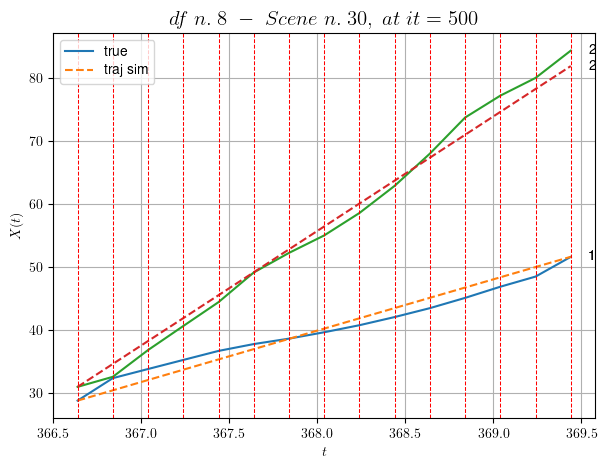

----------------------------------------------------------------------------------------------------
        For scene 42/52:
        * After LR finder: LR_NN=0.001 with mse=177.83877771718502 at it=24
        * v0 = 18.211190440756237
        * MSE = 1.9165310907652275
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [28.44,29.24]


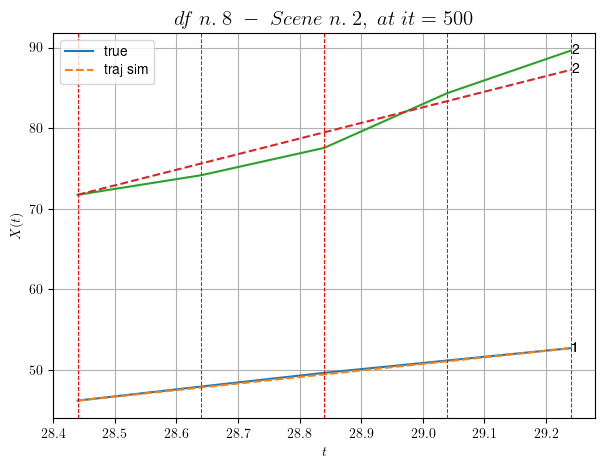

----------------------------------------------------------------------------------------------------
        For scene 43/52:
        * After LR finder: LR_NN=0.0001 with mse=11.80444057345824 at it=24
        * v0 = 19.374312728051596
        * MSE = 1.0829715463441094
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [545.44,545.84]


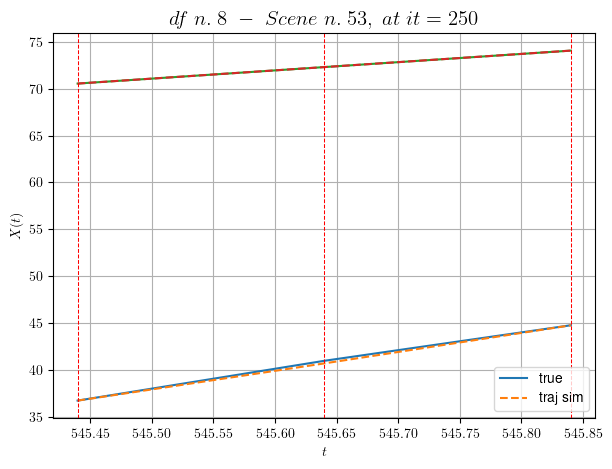

----------------------------------------------------------------------------------------------------
        For scene 44/52:
        * After LR finder: LR_NN=0.005 with mse=15.07607685578353 at it=24
        * v0 = 8.800949247285674
        * MSE = 0.012449331733291559
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [278.64,279.64]


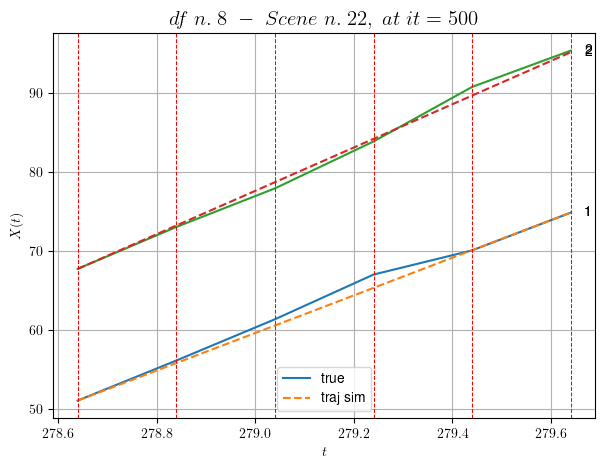

----------------------------------------------------------------------------------------------------
        For scene 45/52:
        * After LR finder: LR_NN=0.0005 with mse=1.5206316688031003 at it=24
        * v0 = 27.40725931573262
        * MSE = 0.46074197747813783
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


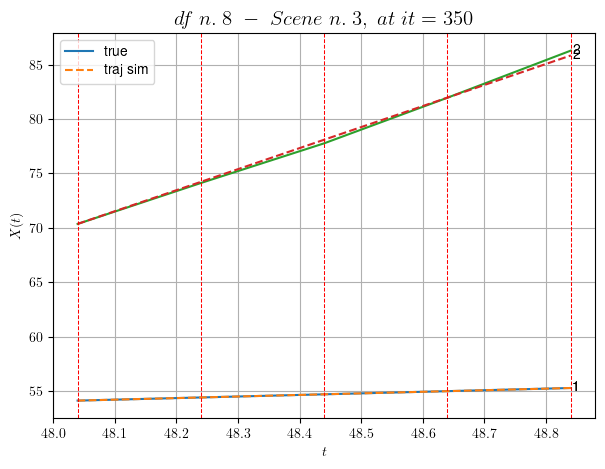

----------------------------------------------------------------------------------------------------
        For scene 46/52:
        * After LR finder: LR_NN=0.01 with mse=13.17856079107419 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.02887728133335341
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/52
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


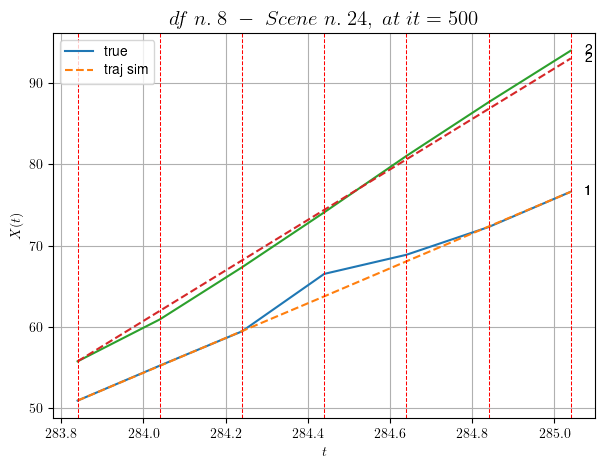

----------------------------------------------------------------------------------------------------
        For scene 47/52:
        * After LR finder: LR_NN=0.0005 with mse=1.6207819231428293 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.8521633234320041
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


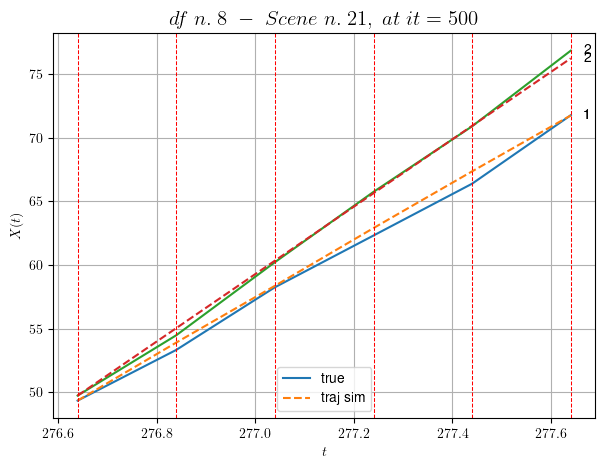

----------------------------------------------------------------------------------------------------
        For scene 48/52:
        * After LR finder: LR_NN=0.005 with mse=2.1777531800274494 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.18727788450568447
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


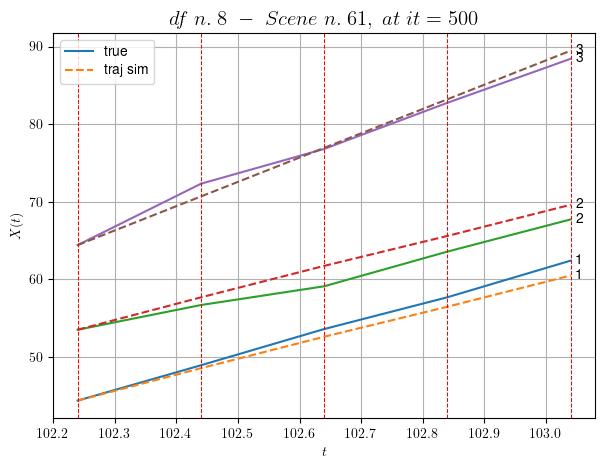

----------------------------------------------------------------------------------------------------
        For scene 49/52:
        * After LR finder: LR_NN=0.01 with mse=1.6574739610943239 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.7217738199275174
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


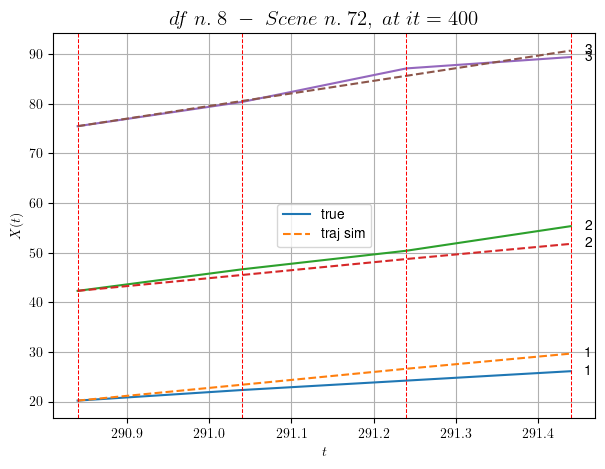

----------------------------------------------------------------------------------------------------
        For scene 50/52:
        * After LR finder: LR_NN=0.01 with mse=4.519868564798678 at it=24
        * v0 = 25.378250241035854
        * MSE = 3.3434052521431425
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


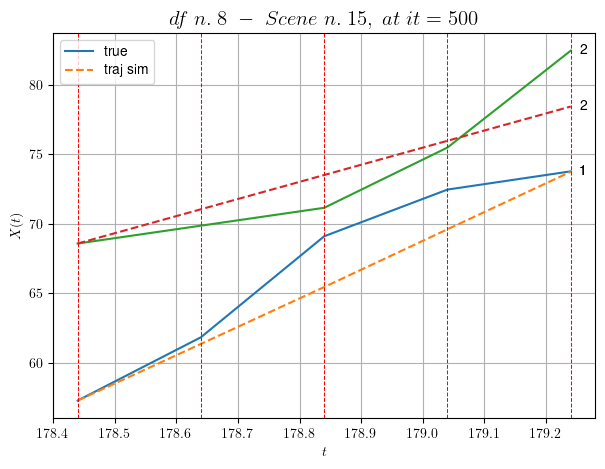

----------------------------------------------------------------------------------------------------
        For scene 51/52:
        * After LR finder: LR_NN=0.0005 with mse=36.38528825133201 at it=24
        * v0 = 12.30898288993207
        * MSE = 4.334348621285983
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


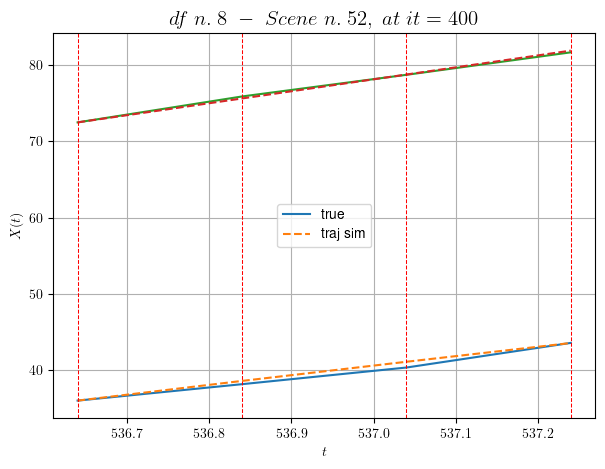

----------------------------------------------------------------------------------------------------
        For scene 52/52:
        * After LR finder: LR_NN=0.005 with mse=14.863197968858922 at it=24
        * v0 = 15.683354901822732
        * MSE = 0.10652760052930636
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 1.8044320591882719
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.8. Scene n.1/27


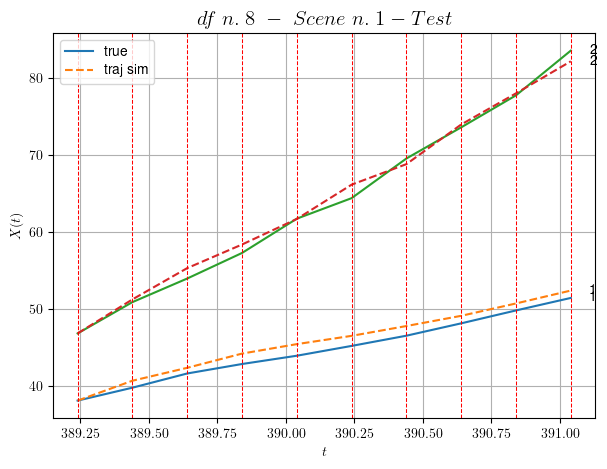

        For scene 1/27:
        * MSE = 1.0164579201664004
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/27


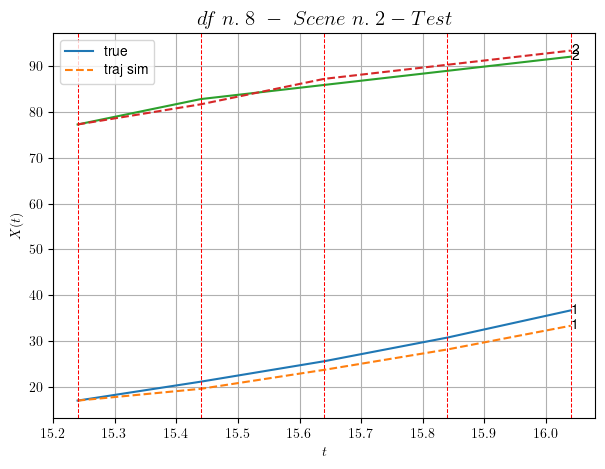

        For scene 2/27:
        * MSE = 3.06082005097206
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/27


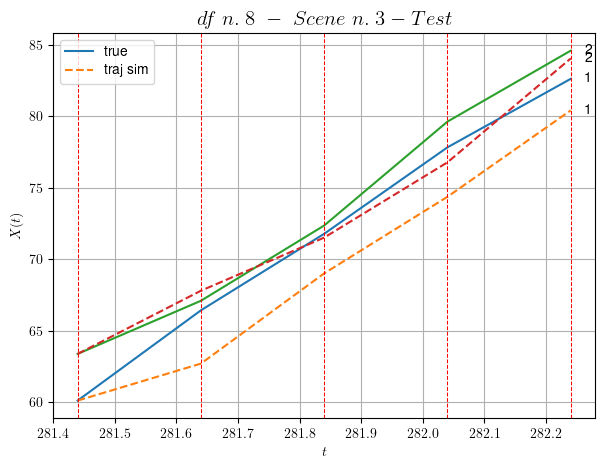

        For scene 3/27:
        * MSE = 4.790164250828536
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/27


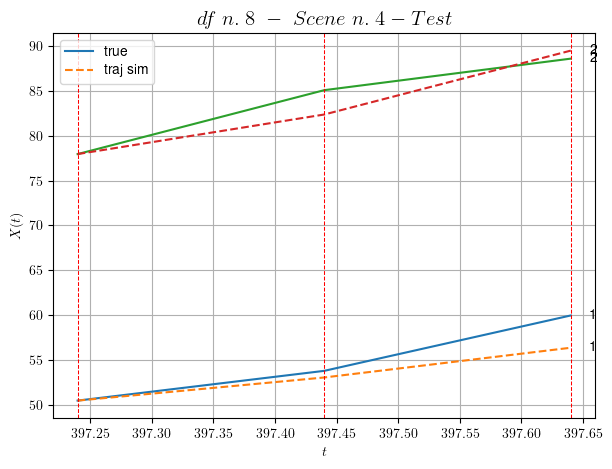

        For scene 4/27:
        * MSE = 3.615205837268343
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/27


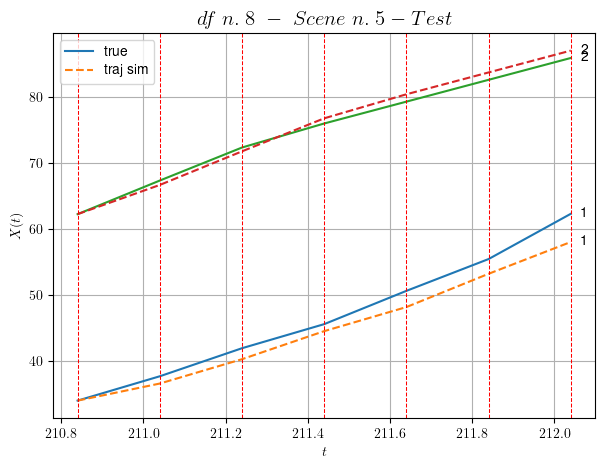

        For scene 5/27:
        * MSE = 2.807895313504469
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/27


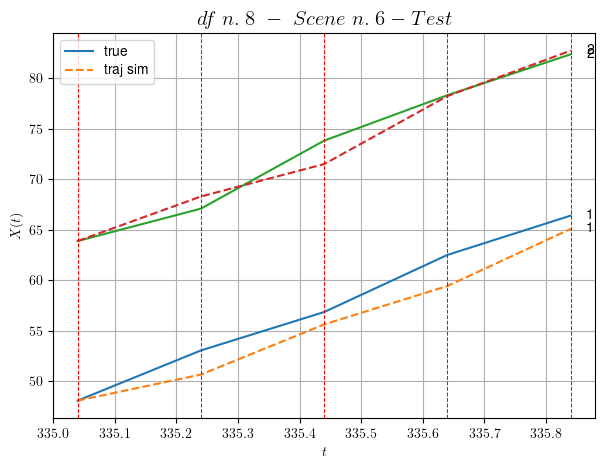

        For scene 6/27:
        * MSE = 2.540164727137207
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/27


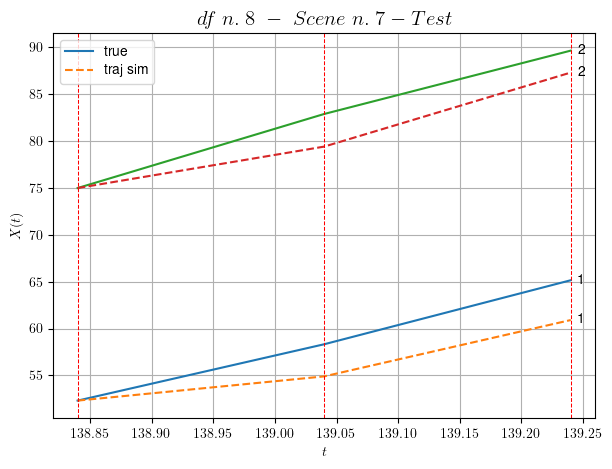

        For scene 7/27:
        * MSE = 7.871425520640698
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/27


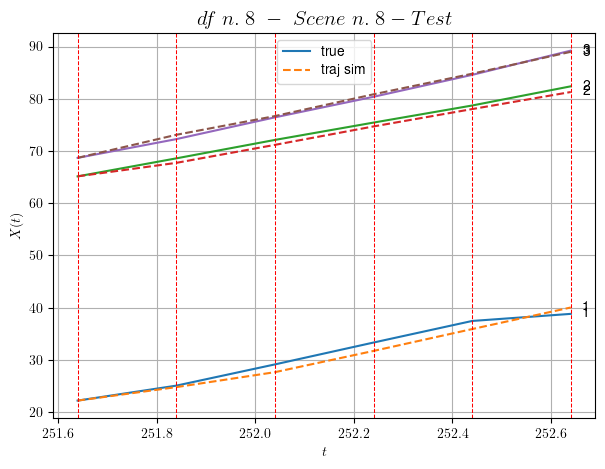

        For scene 8/27:
        * MSE = 0.7594388615612423
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/27


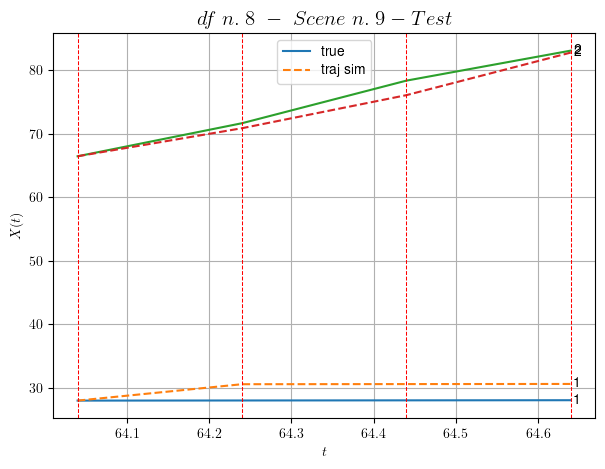

        For scene 9/27:
        * MSE = 3.200067270040641
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/27


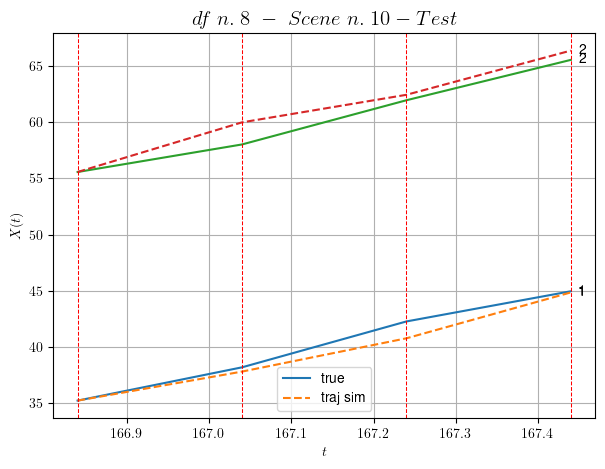

        For scene 10/27:
        * MSE = 0.897635164609632
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/27


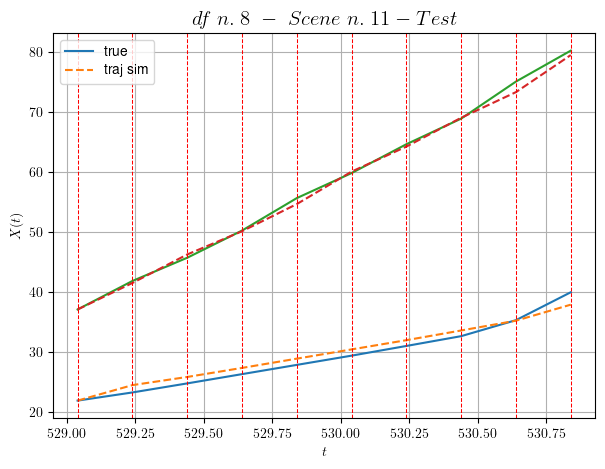

        For scene 11/27:
        * MSE = 0.8647055322094483
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/27


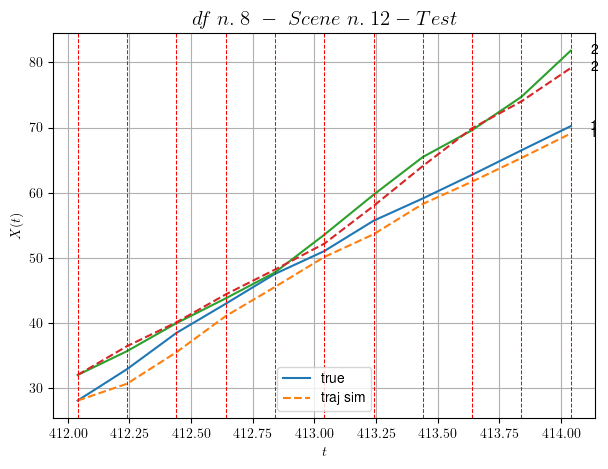

        For scene 12/27:
        * MSE = 2.1121817776672023
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/27


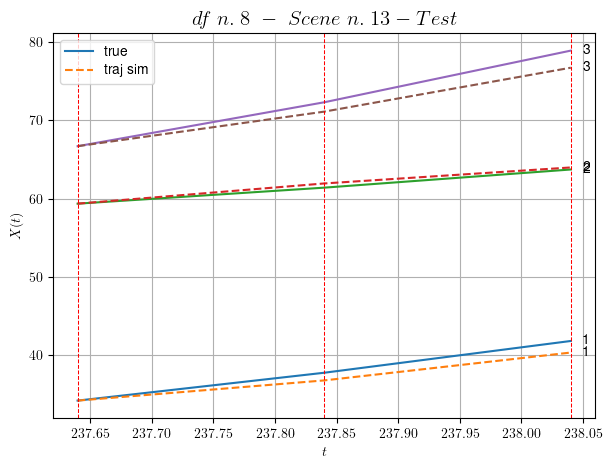

        For scene 13/27:
        * MSE = 1.0777646480075334
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/27


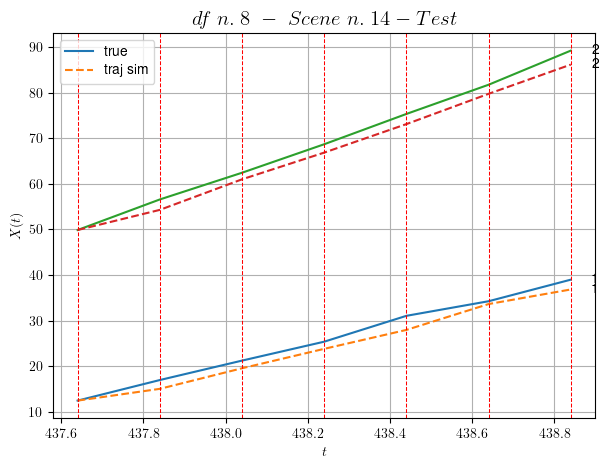

        For scene 14/27:
        * MSE = 3.7526575571229204
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/27


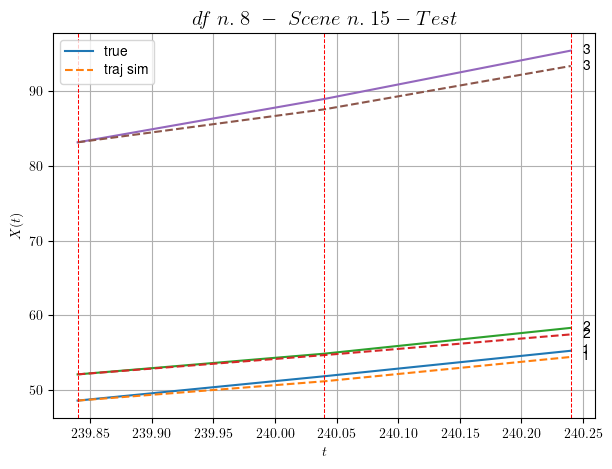

        For scene 15/27:
        * MSE = 0.9009780769610881
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/27


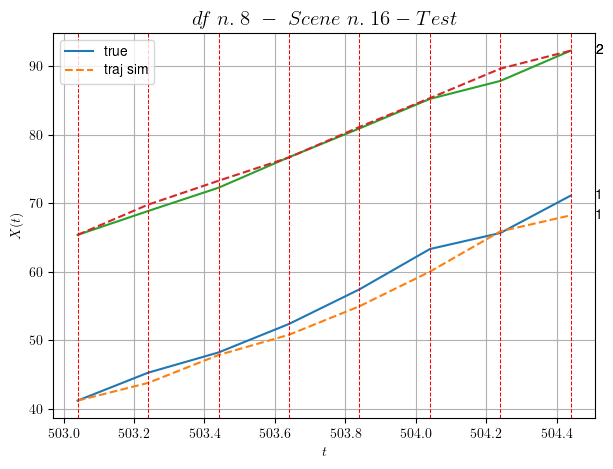

        For scene 16/27:
        * MSE = 2.213153366723258
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/27


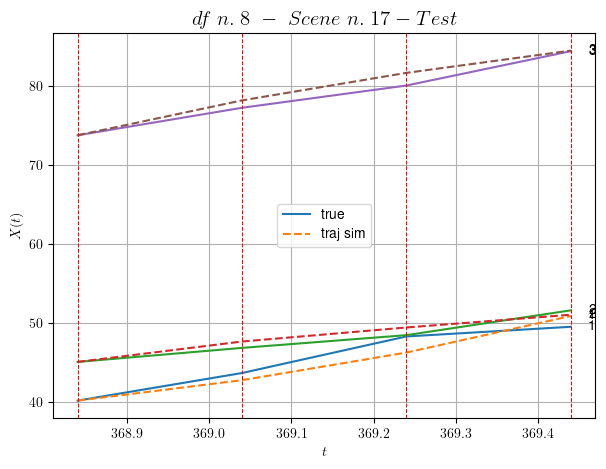

        For scene 17/27:
        * MSE = 1.0133769758567237
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/27


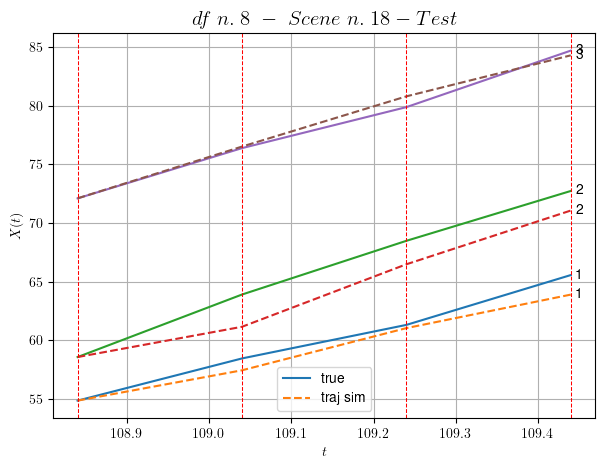

        For scene 18/27:
        * MSE = 1.603633826481019
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/27


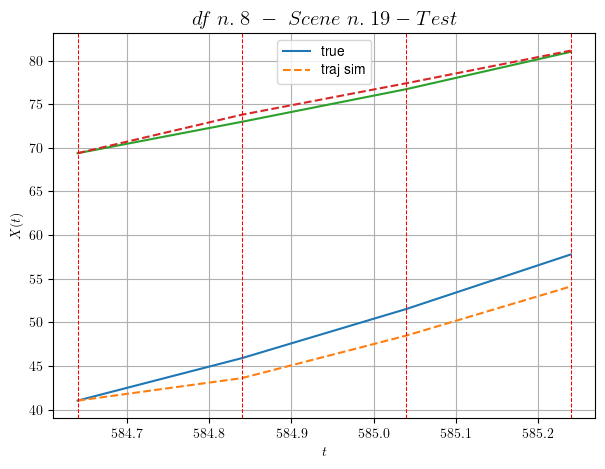

        For scene 19/27:
        * MSE = 3.6432264429613954
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/27


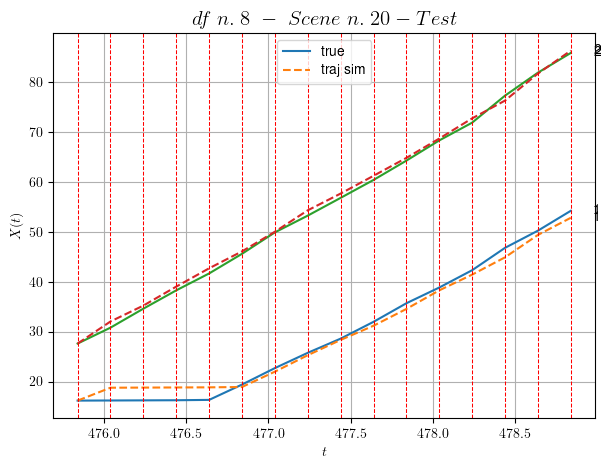

        For scene 20/27:
        * MSE = 1.405406468269236
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/27


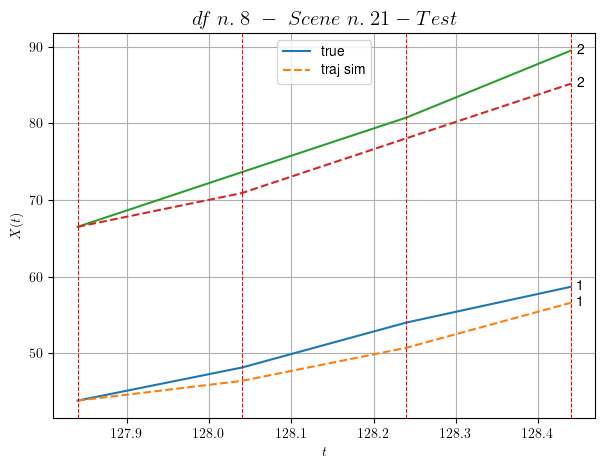

        For scene 21/27:
        * MSE = 6.470198706549002
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/27


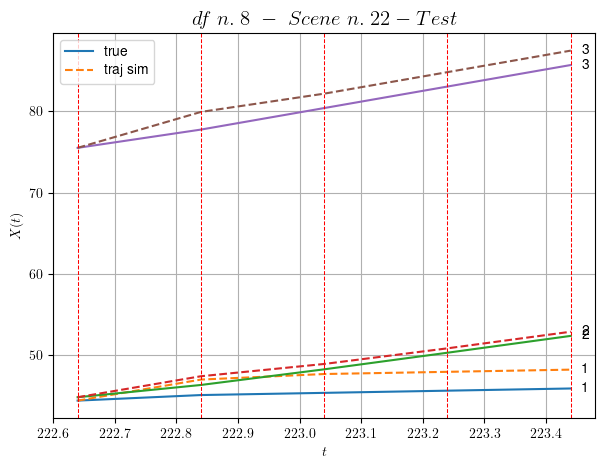

        For scene 22/27:
        * MSE = 2.396880744386919
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/27


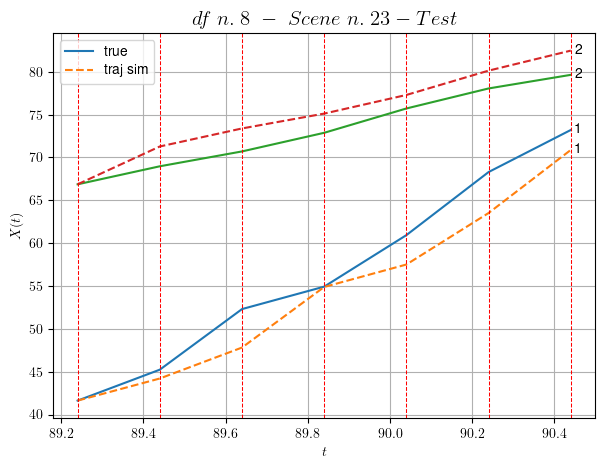

        For scene 23/27:
        * MSE = 6.686688949892889
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/27


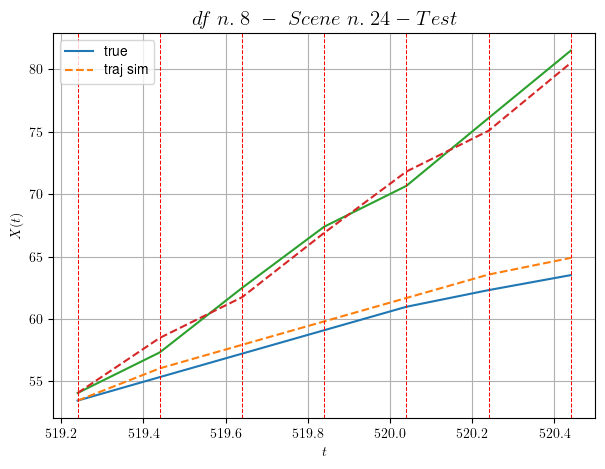

        For scene 24/27:
        * MSE = 0.7791062396130801
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/27


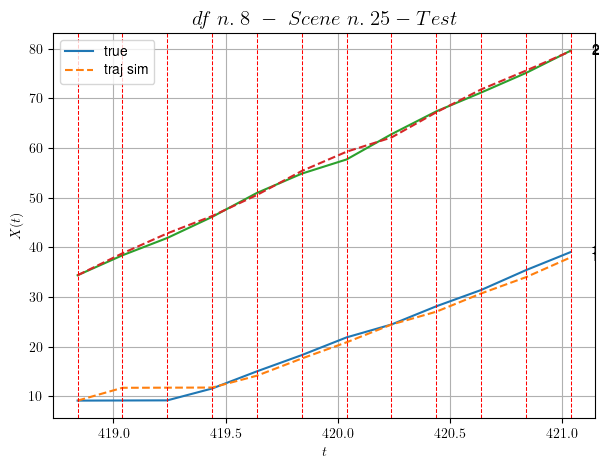

        For scene 25/27:
        * MSE = 1.0493628622958648
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/27


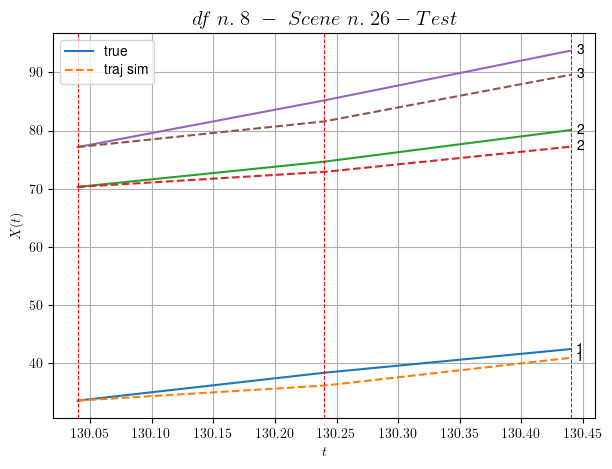

        For scene 26/27:
        * MSE = 5.421064113325799
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/27


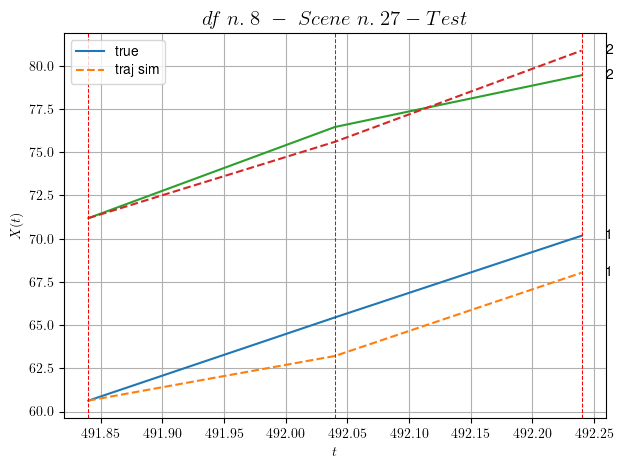

        For scene 27/27:
        * MSE = 2.0516372326244974
----------------------------------------------------------------------------------------------------


MSE test: 2.740788831025078

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.8044320591882719
          * MSE test: 2.740788831025078
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 22 scenes, the remaining 11 to test the model.

Training step. (22 scenes)
DataFrame n.9. Scene n.1/22
----------------------------------------------------------------------------------------------------
We have 18 time intervals inside [172.60,176.20]


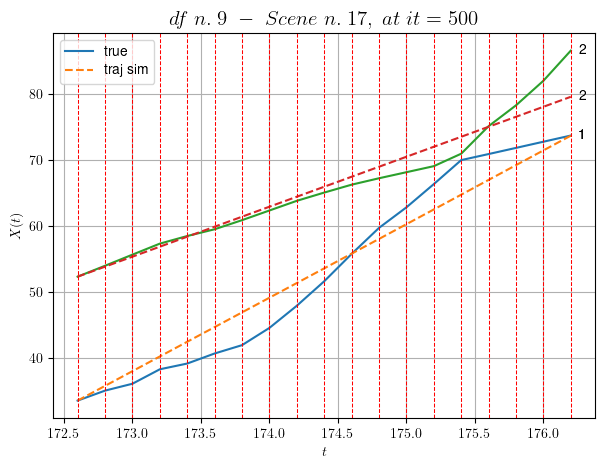

----------------------------------------------------------------------------------------------------
        For scene 1/22:
        * After LR finder: LR_NN=0.001 with mse=1106.6199471844554 at it=24
        * v0 = 7.579600948718926
        * MSE = 6.9885826040841055
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [57.80,58.20]


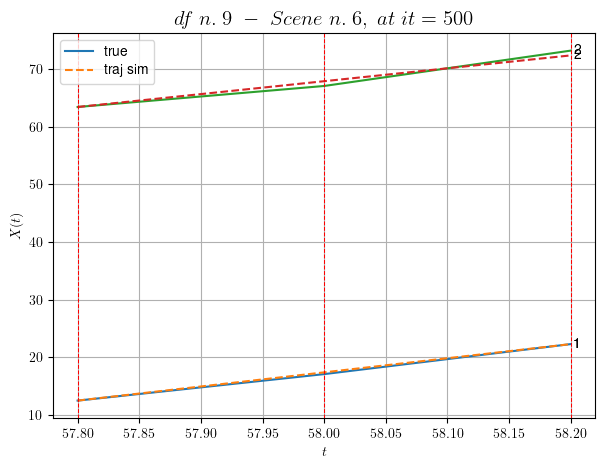

----------------------------------------------------------------------------------------------------
        For scene 2/22:
        * After LR finder: LR_NN=0.0001 with mse=19.572851268157592 at it=24
        * v0 = 22.38362165589532
        * MSE = 0.24153715634291367
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [155.40,156.40]


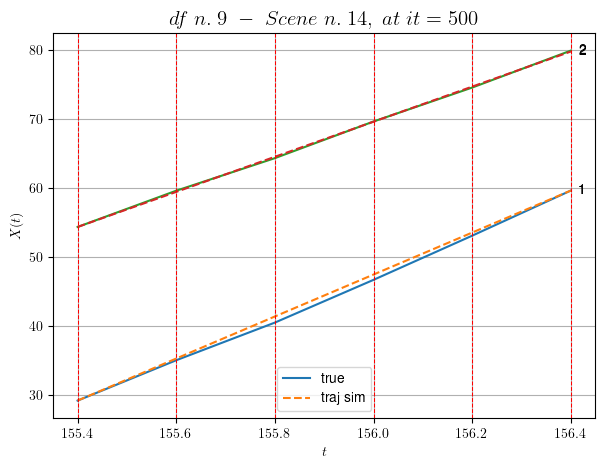

----------------------------------------------------------------------------------------------------
        For scene 3/22:
        * After LR finder: LR_NN=0.0005 with mse=3.9698205710315966 at it=24
        * v0 = 25.423521542136264
        * MSE = 0.14508276678429488
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [143.60,144.00]


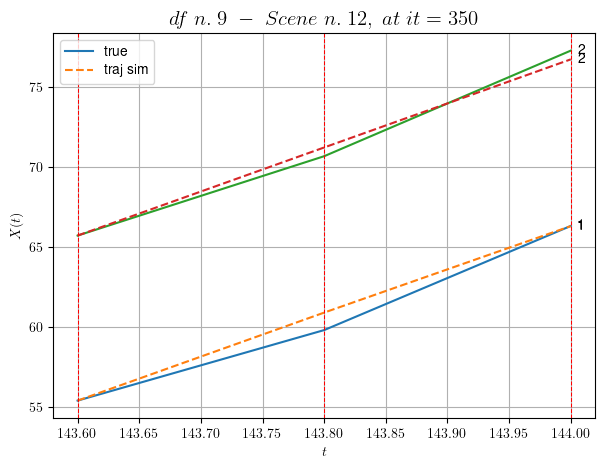

----------------------------------------------------------------------------------------------------
        For scene 4/22:
        * After LR finder: LR_NN=0.001 with mse=0.48597371870685957 at it=24
        * v0 = 27.47606791857426
        * MSE = 0.29145688116146873
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [5.40,6.00]


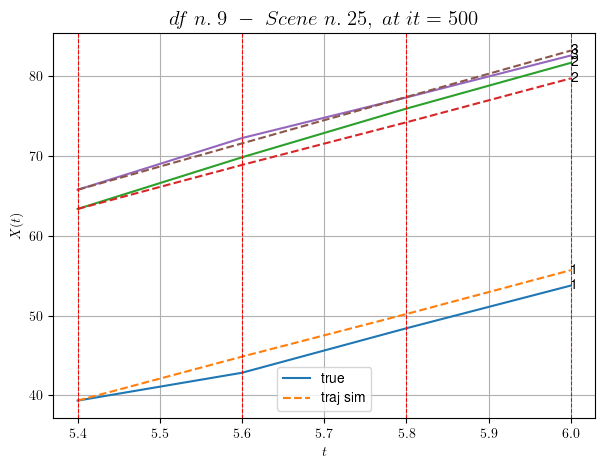

----------------------------------------------------------------------------------------------------
        For scene 5/22:
        * After LR finder: LR_NN=0.005 with mse=1.7448905964769204 at it=24
        * v0 = 29.081107080157118
        * MSE = 1.622097489041348
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.80,20.20]


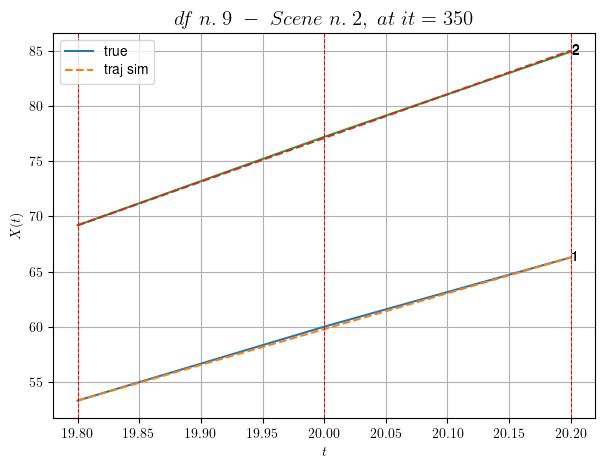

----------------------------------------------------------------------------------------------------
        For scene 6/22:
        * After LR finder: LR_NN=0.001 with mse=3.05250873046332 at it=24
        * v0 = 39.645705865284675
        * MSE = 0.011392819136439265
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [30.80,31.20]


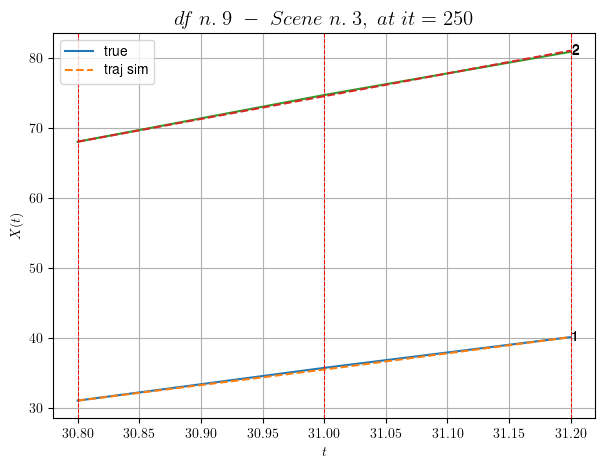

----------------------------------------------------------------------------------------------------
        For scene 7/22:
        * After LR finder: LR_NN=0.01 with mse=0.30677552000126296 at it=24
        * v0 = 32.535915603888625
        * MSE = 0.018356230607314332
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [119.20,119.60]


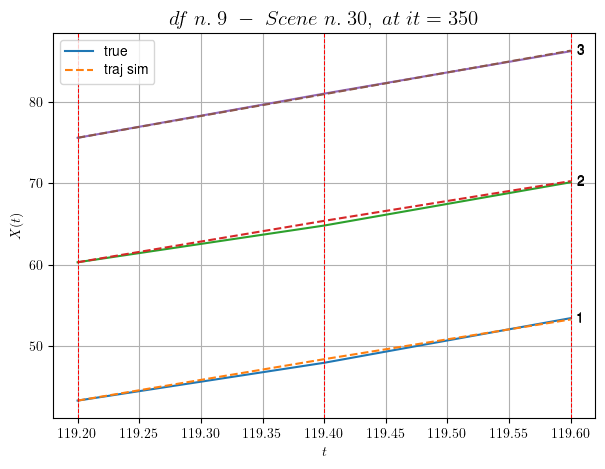

----------------------------------------------------------------------------------------------------
        For scene 8/22:
        * After LR finder: LR_NN=0.005 with mse=0.3531171637592701 at it=24
        * v0 = 26.73461342584417
        * MSE = 0.0649232195243623
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [36.60,37.60]


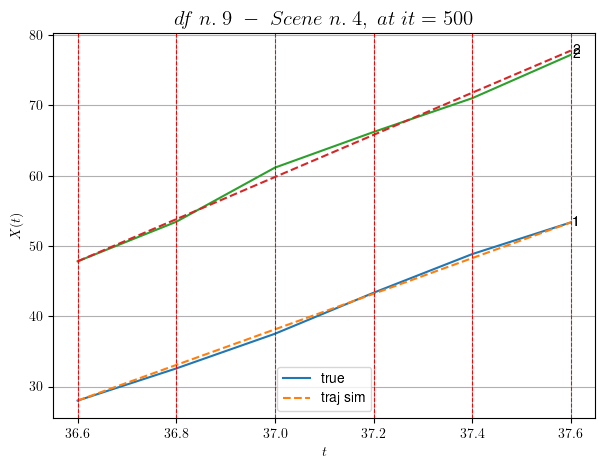

----------------------------------------------------------------------------------------------------
        For scene 9/22:
        * After LR finder: LR_NN=0.0005 with mse=0.28330267509050344 at it=24
        * v0 = 29.981948107113524
        * MSE = 0.33770608376027117
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [44.40,44.80]


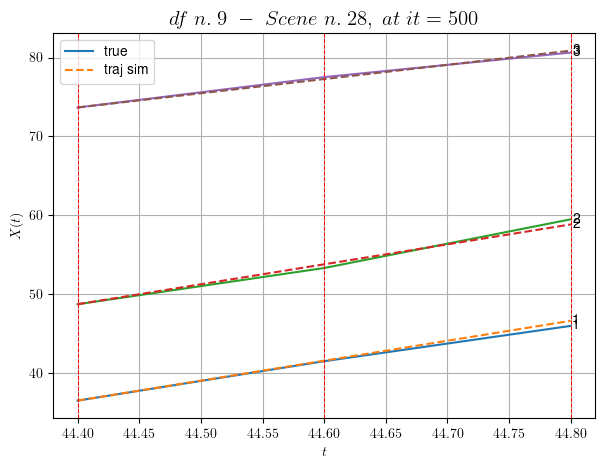

----------------------------------------------------------------------------------------------------
        For scene 10/22:
        * After LR finder: LR_NN=0.0001 with mse=30.01738527579595 at it=24
        * v0 = 18.01610672050865
        * MSE = 0.1309529224453199
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/22
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [225.20,226.00]


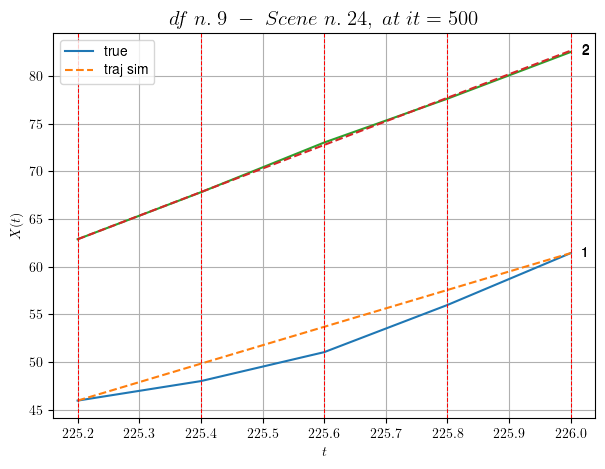

----------------------------------------------------------------------------------------------------
        For scene 11/22:
        * After LR finder: LR_NN=0.0001 with mse=4.507086256338347 at it=24
        * v0 = 24.737876605772872
        * MSE = 1.297629709150526
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [120.20,120.60]


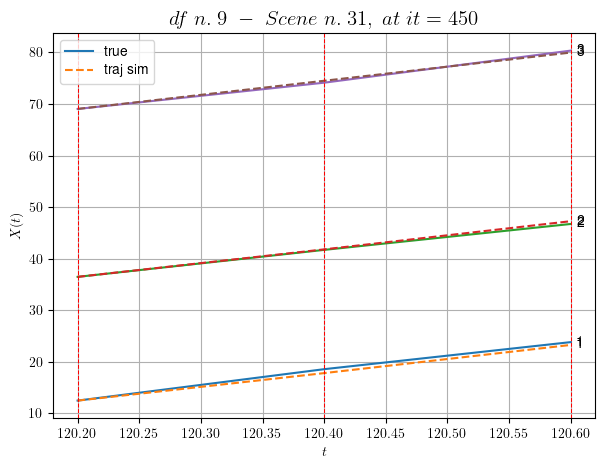

----------------------------------------------------------------------------------------------------
        For scene 12/22:
        * After LR finder: LR_NN=0.005 with mse=0.3568436839898608 at it=24
        * v0 = 27.348987837942744
        * MSE = 0.16142163052760714
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [219.80,220.20]


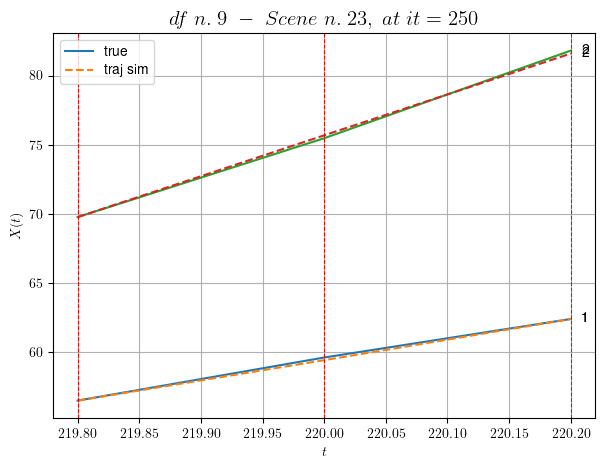

----------------------------------------------------------------------------------------------------
        For scene 13/22:
        * After LR finder: LR_NN=0.005 with mse=0.02802085767153123 at it=24
        * v0 = 29.5739937122531
        * MSE = 0.018525353710220942
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [191.20,192.20]


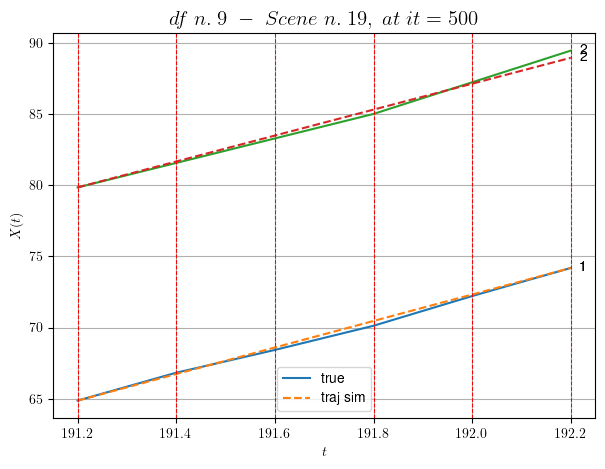

----------------------------------------------------------------------------------------------------
        For scene 14/22:
        * After LR finder: LR_NN=0.001 with mse=78.94275952725934 at it=24
        * v0 = 9.117095848783434
        * MSE = 0.04434133034794898
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [20.80,21.20]


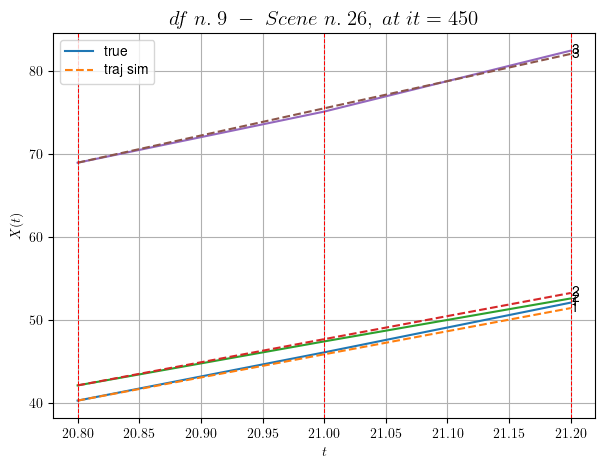

----------------------------------------------------------------------------------------------------
        For scene 15/22:
        * After LR finder: LR_NN=0.005 with mse=0.36932417321956024 at it=24
        * v0 = 32.73331102512599
        * MSE = 0.1451086738256653
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/22
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [82.40,84.00]


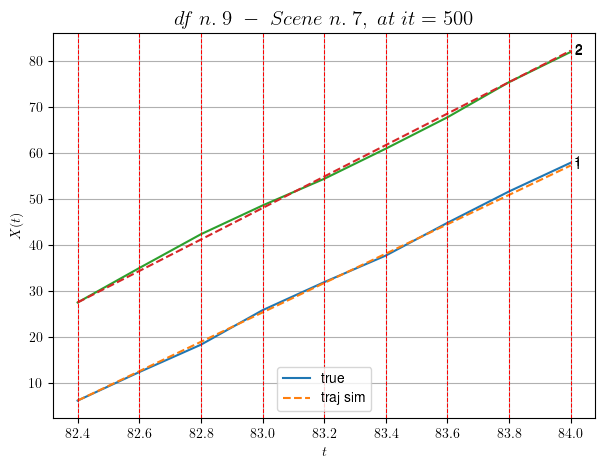

----------------------------------------------------------------------------------------------------
        For scene 16/22:
        * After LR finder: LR_NN=1e-05 with mse=7.81943335855781 at it=24
        * v0 = 34.29480154475966
        * MSE = 0.3067783907180264
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [197.60,198.80]


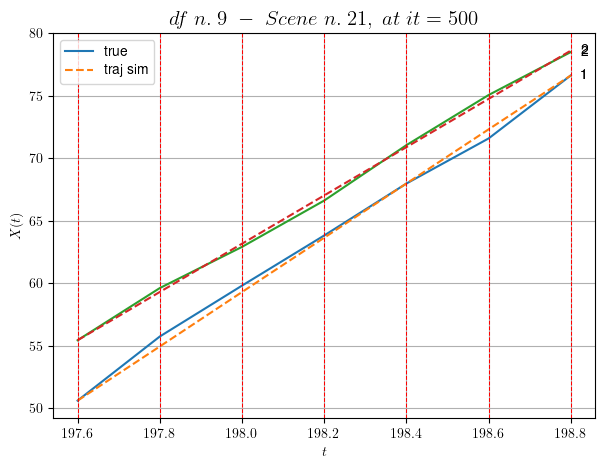

----------------------------------------------------------------------------------------------------
        For scene 17/22:
        * After LR finder: LR_NN=0.001 with mse=29.830056547587485 at it=24
        * v0 = 19.310295514409116
        * MSE = 0.13733914934580466
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [205.80,206.20]


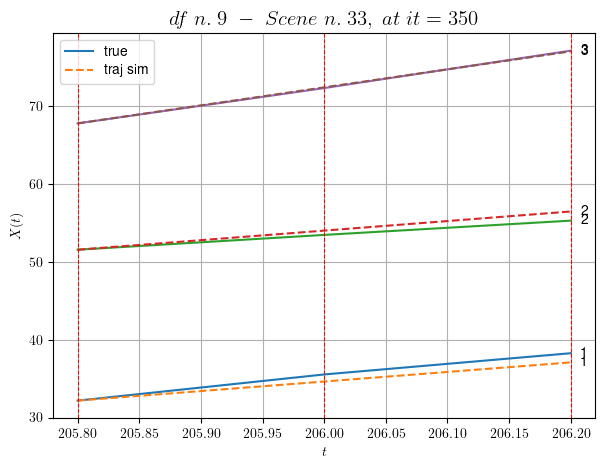

----------------------------------------------------------------------------------------------------
        For scene 18/22:
        * After LR finder: LR_NN=0.0005 with mse=1.367988360864062 at it=24
        * v0 = 23.1587006104452
        * MSE = 0.43535713305468665
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/22
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [117.00,118.40]


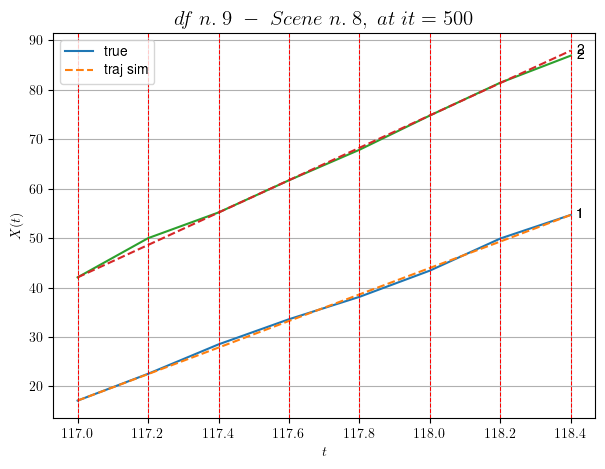

----------------------------------------------------------------------------------------------------
        For scene 19/22:
        * After LR finder: LR_NN=0.001 with mse=2.4802316703428446 at it=24
        * v0 = 32.746751311390014
        * MSE = 0.26652752893199017
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


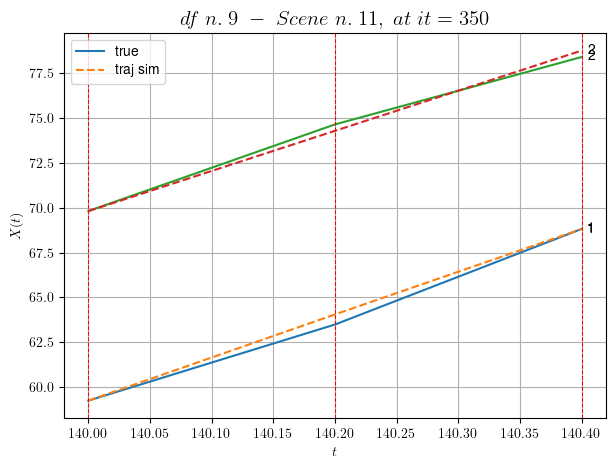

----------------------------------------------------------------------------------------------------
        For scene 20/22:
        * After LR finder: LR_NN=0.001 with mse=2.234594073854087 at it=24
        * v0 = 22.365188464686486
        * MSE = 0.09536057547772647
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


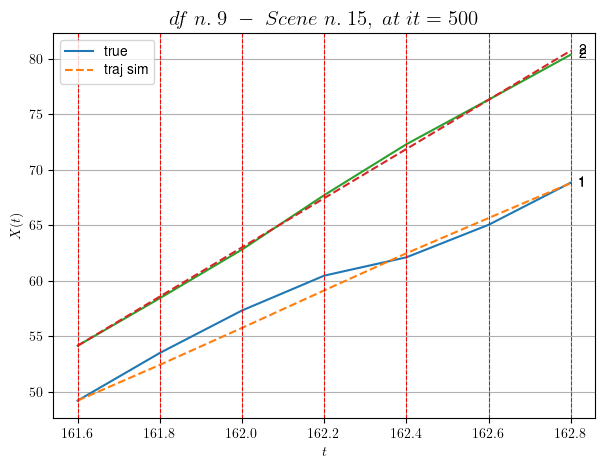

----------------------------------------------------------------------------------------------------
        For scene 21/22:
        * After LR finder: LR_NN=0.005 with mse=16.391473085525437 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.4436559298950883
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


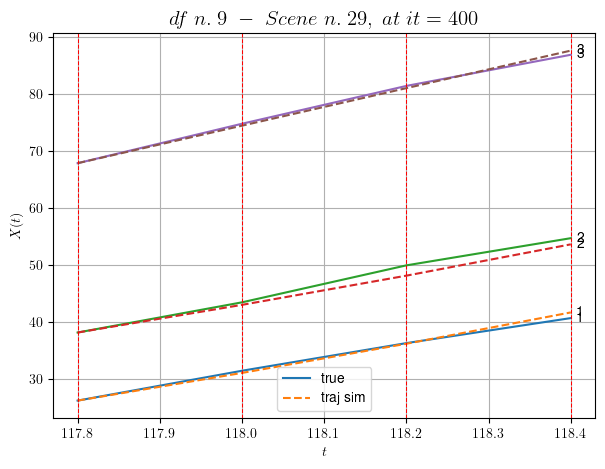

----------------------------------------------------------------------------------------------------
        For scene 22/22:
        * After LR finder: LR_NN=0.01 with mse=1.102860844374392 at it=24
        * v0 = 32.947821831319956
        * MSE = 0.5434202306406027
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.624888809477897
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (11 scenes)
DataFrame n.9. Scene n.1/11


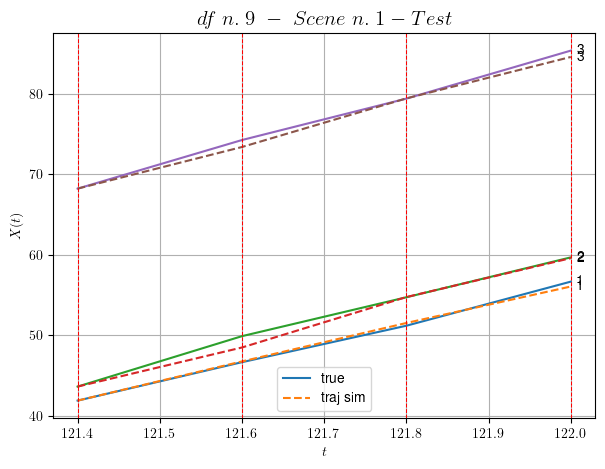

        For scene 1/11:
        * MSE = 0.32155852572673266
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/11


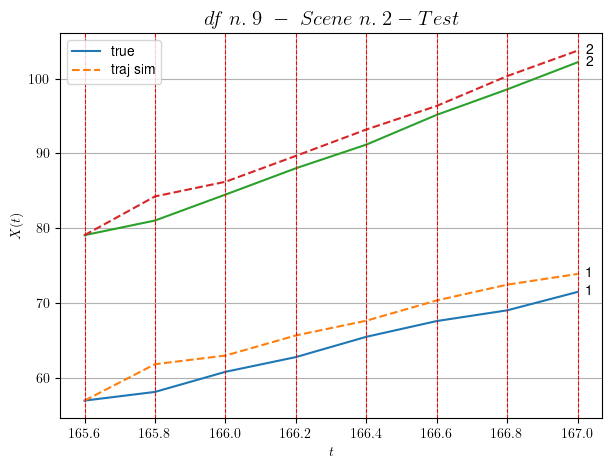

        For scene 2/11:
        * MSE = 5.227702834959027
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/11


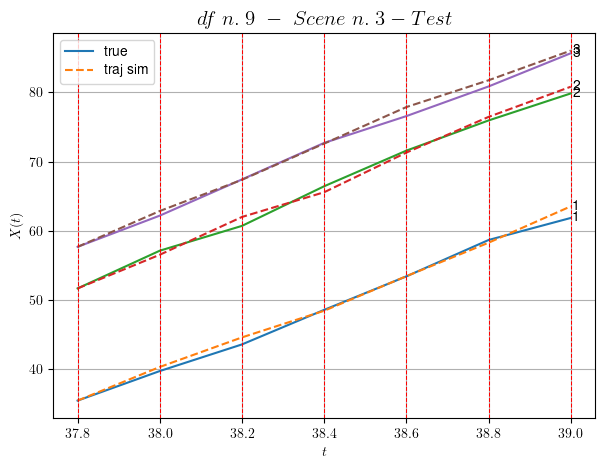

        For scene 3/11:
        * MSE = 0.5472975323946695
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/11


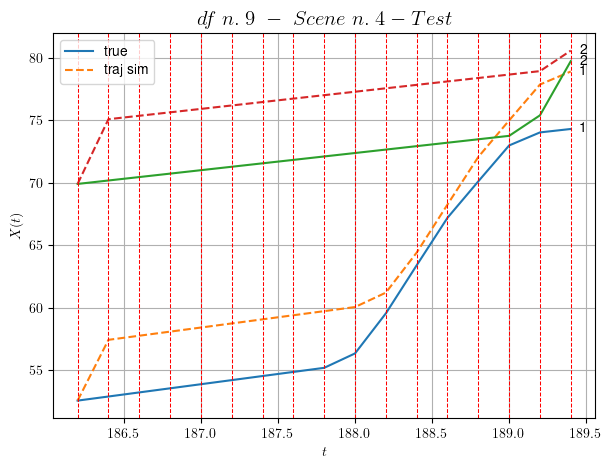

        For scene 4/11:
        * MSE = 16.947561471853703
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/11


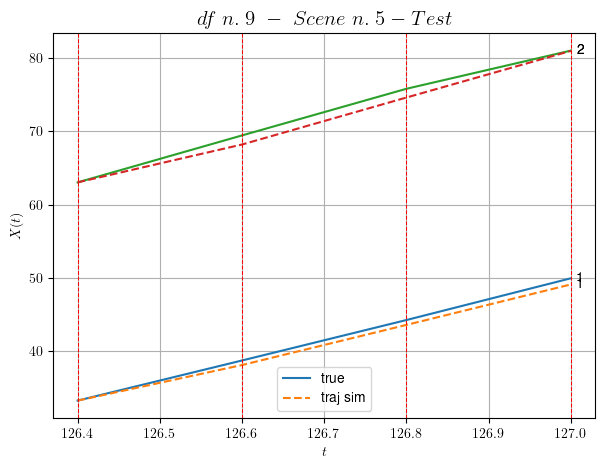

        For scene 5/11:
        * MSE = 0.5640507805343307
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/11


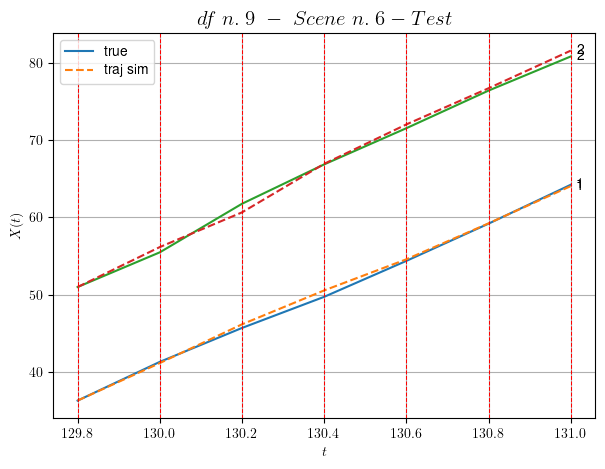

        For scene 6/11:
        * MSE = 0.258626897889154
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/11


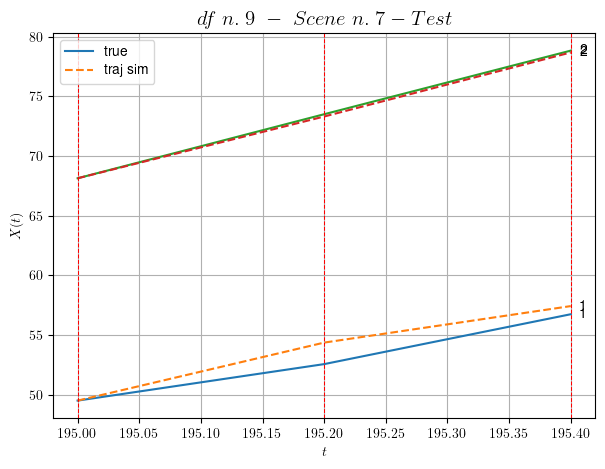

        For scene 7/11:
        * MSE = 0.6289531368692337
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/11


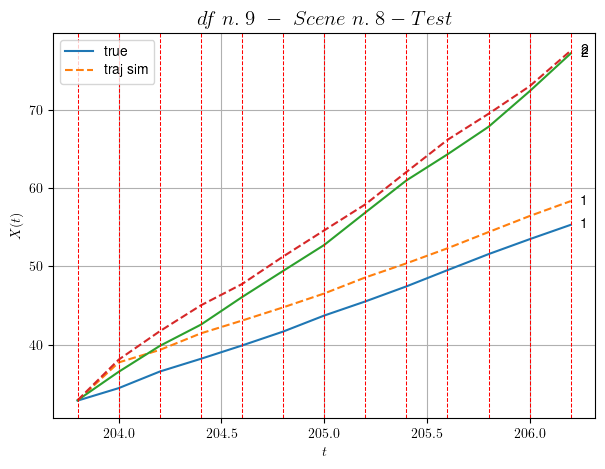

        For scene 8/11:
        * MSE = 5.33130716295994
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/11


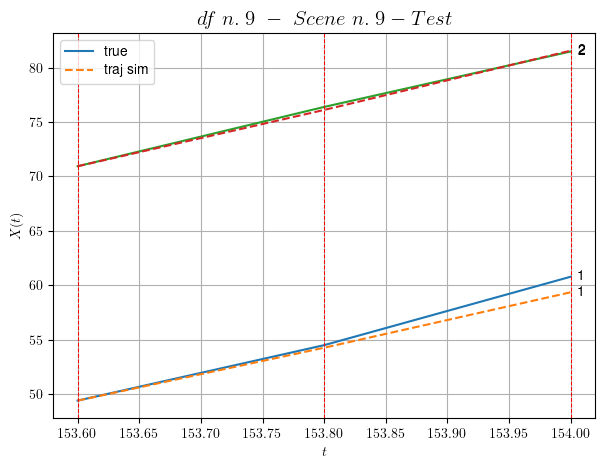

        For scene 9/11:
        * MSE = 0.36368068397697334
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/11


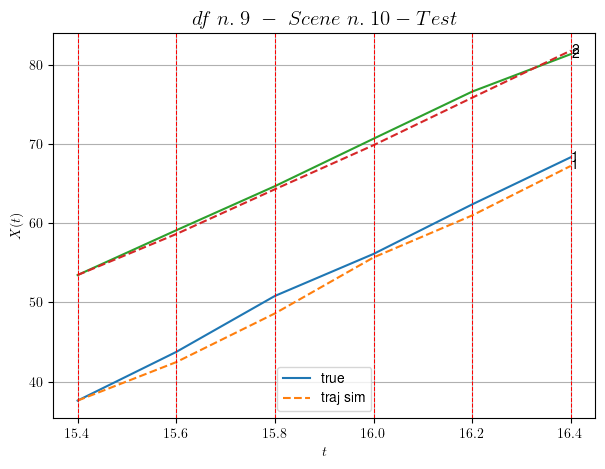

        For scene 10/11:
        * MSE = 0.974581170731508
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/11


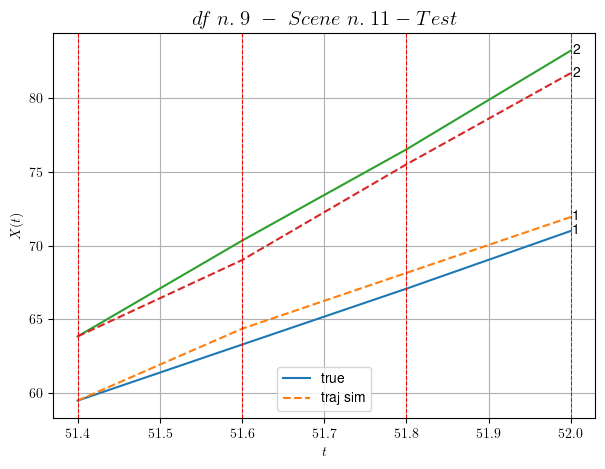

        For scene 11/11:
        * MSE = 1.0344074173925208
----------------------------------------------------------------------------------------------------


MSE test: 2.927247965026163

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.624888809477897
          * MSE test: 2.927247965026163
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 49 scenes, the remaining 25 to test the model.

Training step. (49 scenes)
DataFrame n.10. Scene n.1/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [81.72,82.52]


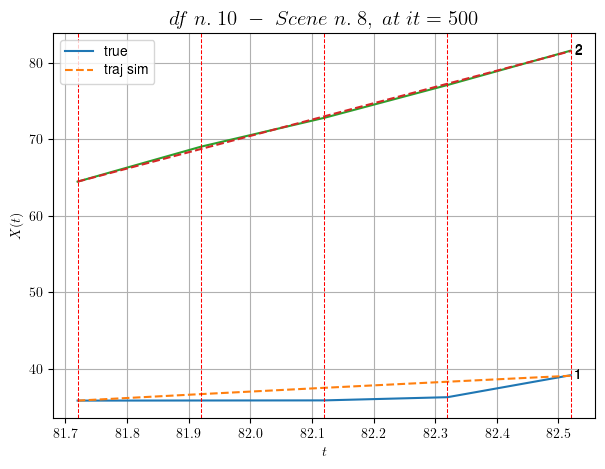

----------------------------------------------------------------------------------------------------
        For scene 1/49:
        * After LR finder: LR_NN=0.005 with mse=9.82080306255789 at it=24
        * v0 = 21.36406302671324
        * MSE = 0.7549913185962002
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [194.52,195.12]


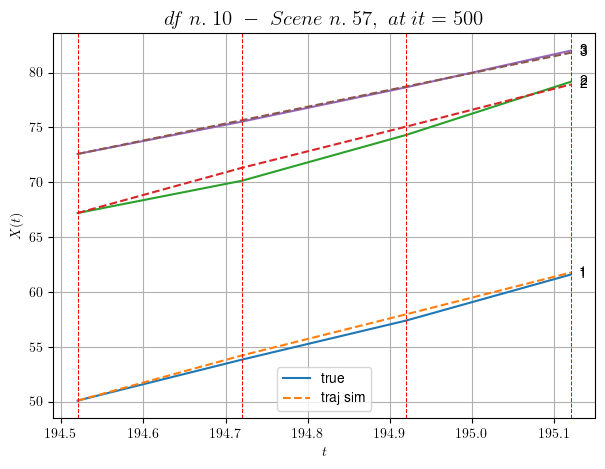

----------------------------------------------------------------------------------------------------
        For scene 2/49:
        * After LR finder: LR_NN=0.01 with mse=10.132200740672316 at it=24
        * v0 = 15.385046662986253
        * MSE = 0.21100521890877555
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [450.52,452.12]


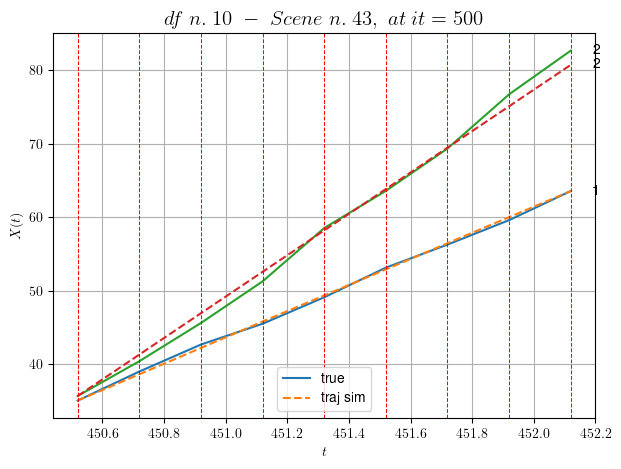

----------------------------------------------------------------------------------------------------
        For scene 3/49:
        * After LR finder: LR_NN=0.001 with mse=1.4402935973529891 at it=24
        * v0 = 28.147396988326644
        * MSE = 0.5499170692096227
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [305.72,306.12]


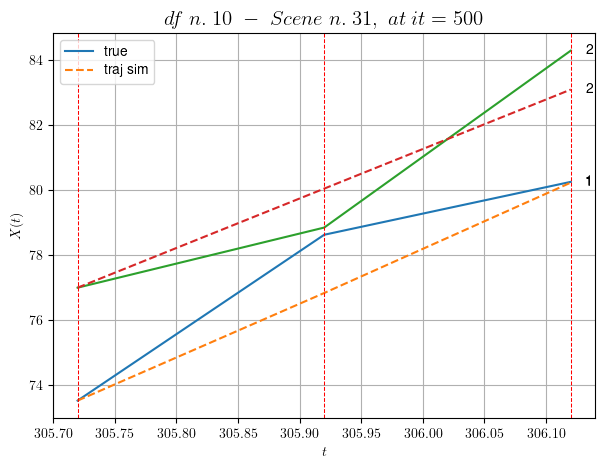

----------------------------------------------------------------------------------------------------
        For scene 4/49:
        * After LR finder: LR_NN=0.001 with mse=7.64998684226534 at it=24
        * v0 = 15.228607183509867
        * MSE = 0.9771544503532753
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [502.92,504.52]


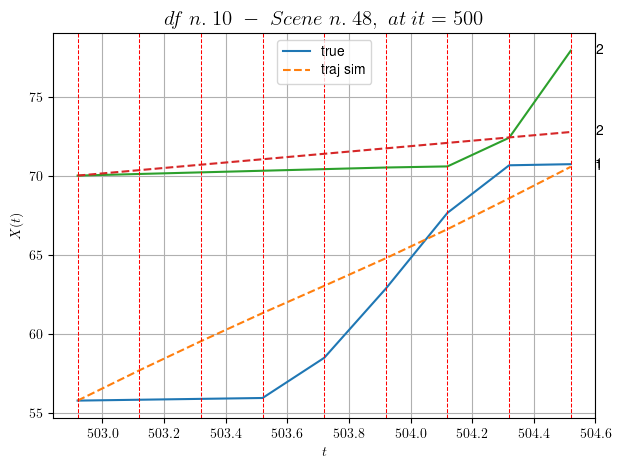

----------------------------------------------------------------------------------------------------
        For scene 5/49:
        * After LR finder: LR_NN=0.005 with mse=356.11709012803976 at it=24
        * v0 = 1.7269359387544192
        * MSE = 5.543268301227045
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [569.72,570.72]


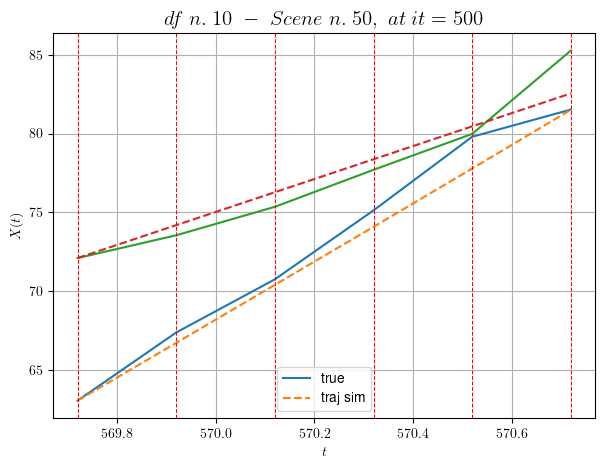

----------------------------------------------------------------------------------------------------
        For scene 6/49:
        * After LR finder: LR_NN=0.001 with mse=66.62726594249365 at it=24
        * v0 = 10.439737963467937
        * MSE = 1.2129929205188796
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/49
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [201.32,203.12]


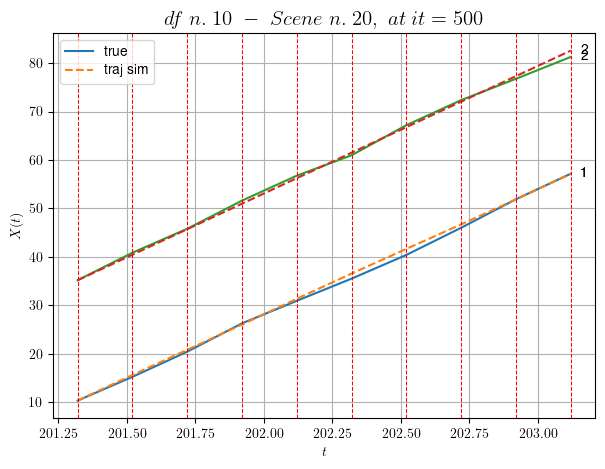

----------------------------------------------------------------------------------------------------
        For scene 7/49:
        * After LR finder: LR_NN=0.01 with mse=8.701498363052803 at it=24
        * v0 = 26.32009816116289
        * MSE = 0.2953731775755569
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [236.52,237.12]


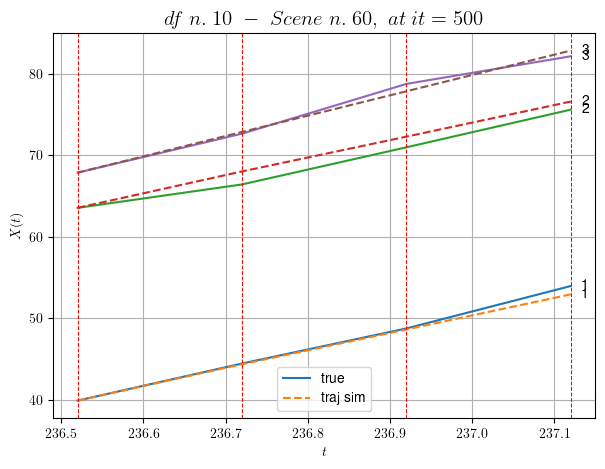

----------------------------------------------------------------------------------------------------
        For scene 8/49:
        * After LR finder: LR_NN=0.005 with mse=1.9128532843040535 at it=24
        * v0 = 24.94426075613369
        * MSE = 0.6329348142473126
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [275.92,277.12]


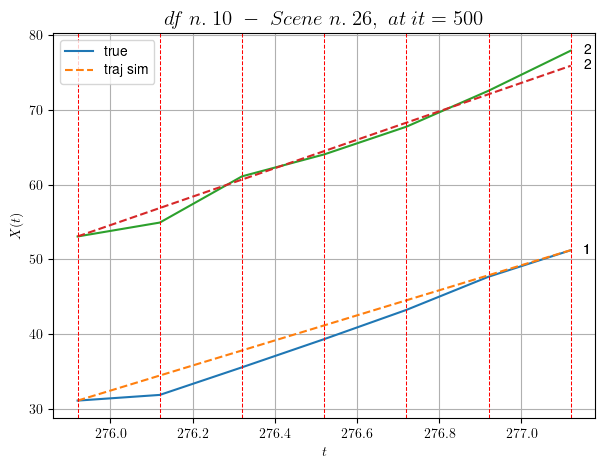

----------------------------------------------------------------------------------------------------
        For scene 9/49:
        * After LR finder: LR_NN=5e-05 with mse=29.59194277981298 at it=24
        * v0 = 19.051410226526524
        * MSE = 1.838853793175884
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [414.72,415.72]


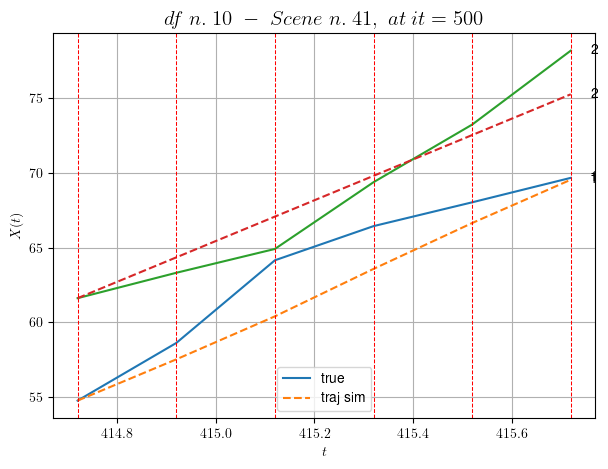

----------------------------------------------------------------------------------------------------
        For scene 10/49:
        * After LR finder: LR_NN=0.005 with mse=46.975614436118654 at it=24
        * v0 = 13.66608716334115
        * MSE = 3.3745087514629297
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [116.72,118.32]


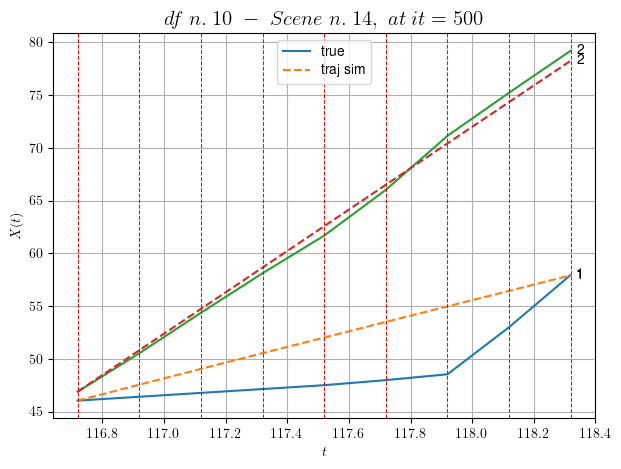

----------------------------------------------------------------------------------------------------
        For scene 11/49:
        * After LR finder: LR_NN=0.001 with mse=53.70557044807162 at it=24
        * v0 = 19.612707397568297
        * MSE = 6.940085353969041
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/49
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [71.72,73.12]


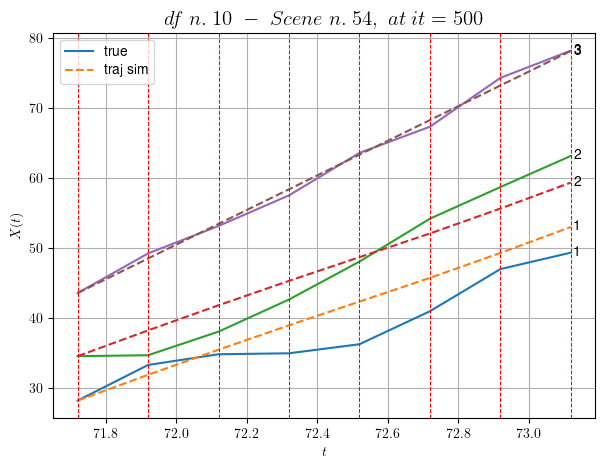

----------------------------------------------------------------------------------------------------
        For scene 12/49:
        * After LR finder: LR_NN=0.005 with mse=11.932199487529154 at it=24
        * v0 = 24.696180100224275
        * MSE = 6.5370545187651805
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [41.32,41.92]


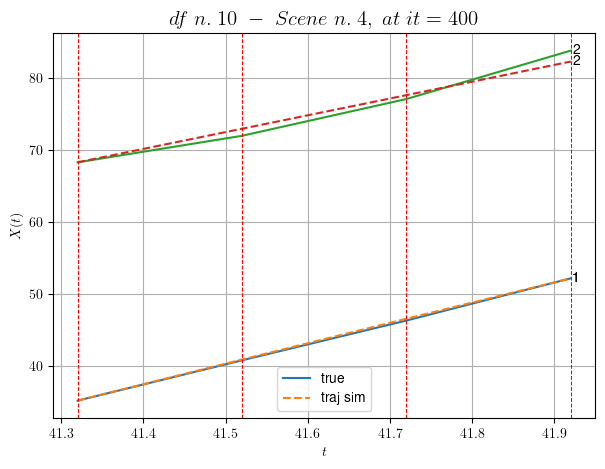

----------------------------------------------------------------------------------------------------
        For scene 13/49:
        * After LR finder: LR_NN=0.005 with mse=2.7837276129685296 at it=24
        * v0 = 23.270817814815587
        * MSE = 0.3991398306765291
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [182.72,183.52]


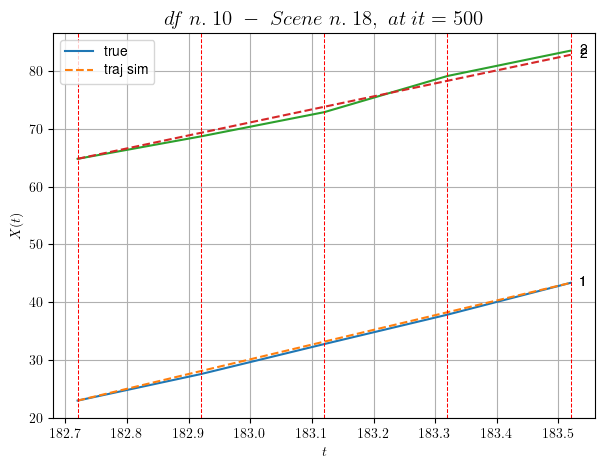

----------------------------------------------------------------------------------------------------
        For scene 14/49:
        * After LR finder: LR_NN=0.001 with mse=6.191373762770773 at it=24
        * v0 = 22.50226017911476
        * MSE = 0.28257016808826363
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [410.32,410.72]


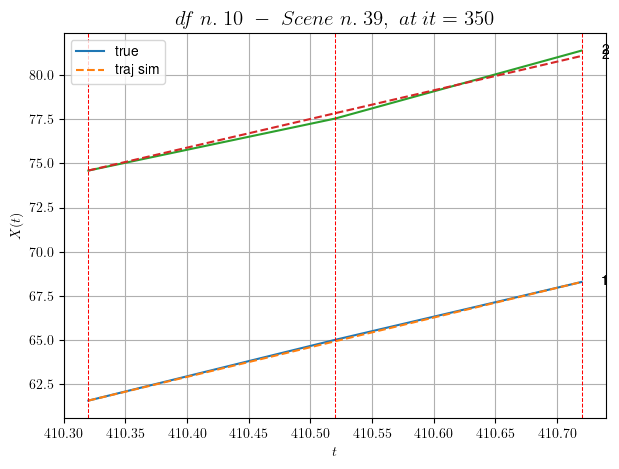

----------------------------------------------------------------------------------------------------
        For scene 15/49:
        * After LR finder: LR_NN=0.0005 with mse=6.05665056193774 at it=24
        * v0 = 16.24852213679542
        * MSE = 0.0285539967160857
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [85.72,87.32]


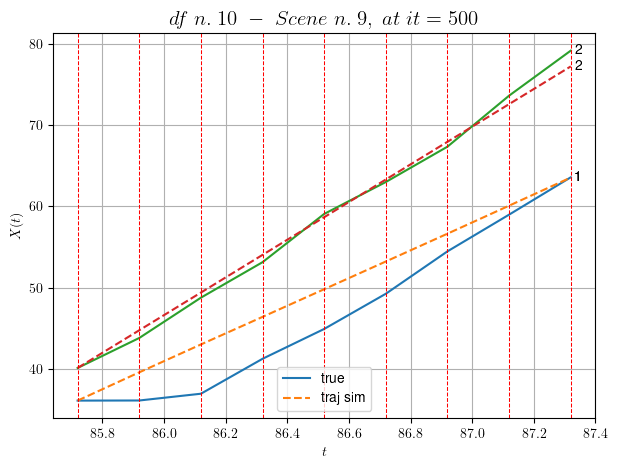

----------------------------------------------------------------------------------------------------
        For scene 16/49:
        * After LR finder: LR_NN=0.001 with mse=20.194157071690505 at it=24
        * v0 = 23.19995130380224
        * MSE = 6.970796181994014
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [210.12,210.52]


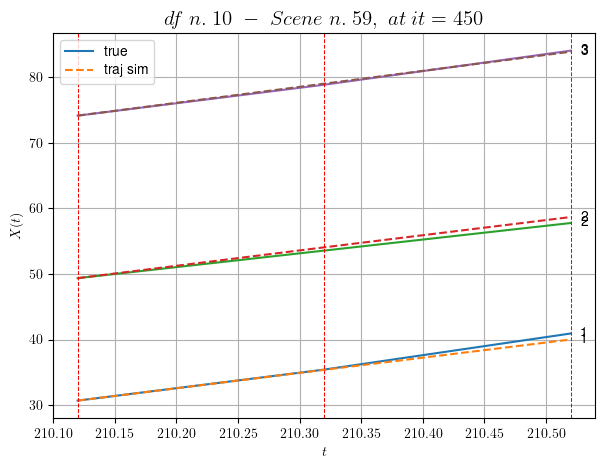

----------------------------------------------------------------------------------------------------
        For scene 17/49:
        * After LR finder: LR_NN=0.005 with mse=1.0317378079882085 at it=24
        * v0 = 24.382900546980373
        * MSE = 0.21857303755076427
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.92,65.92]


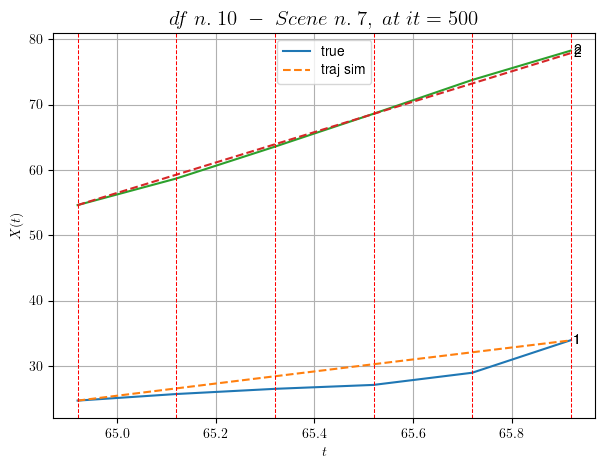

----------------------------------------------------------------------------------------------------
        For scene 18/49:
        * After LR finder: LR_NN=0.001 with mse=9.333216662060034 at it=24
        * v0 = 23.262500294243573
        * MSE = 2.08896051439649
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [401.52,402.32]


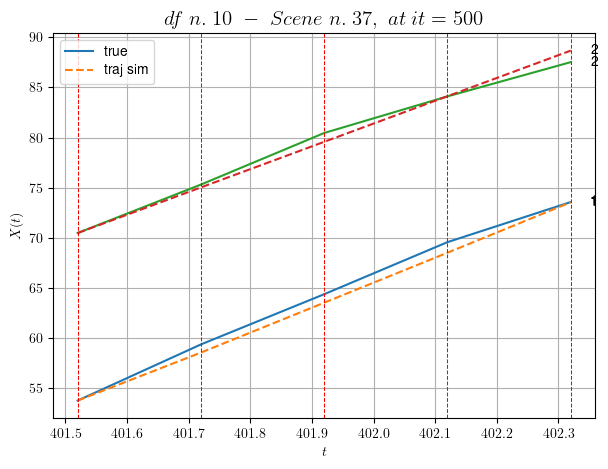

----------------------------------------------------------------------------------------------------
        For scene 19/49:
        * After LR finder: LR_NN=0.005 with mse=7.7520782537811 at it=24
        * v0 = 22.73262095038761
        * MSE = 0.46442837096088907
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [376.92,377.52]


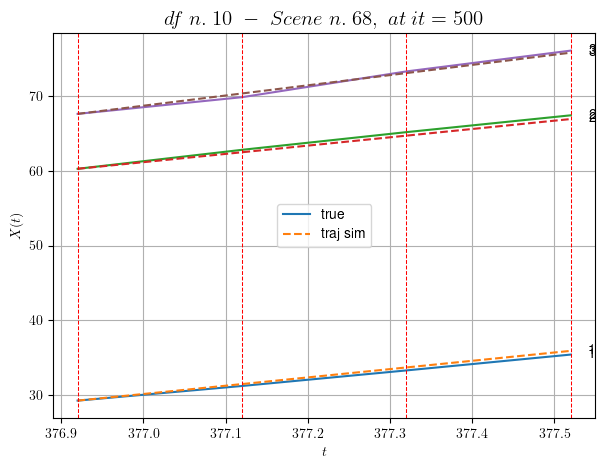

----------------------------------------------------------------------------------------------------
        For scene 20/49:
        * After LR finder: LR_NN=0.01 with mse=12.203877977775328 at it=24
        * v0 = 13.629666231204533
        * MSE = 0.11430915260256298
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [120.92,121.52]


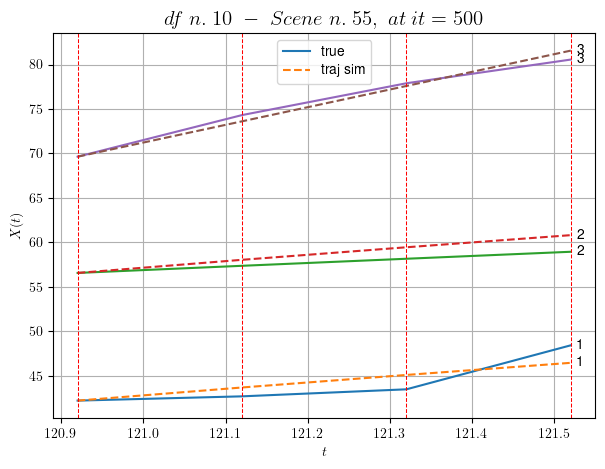

----------------------------------------------------------------------------------------------------
        For scene 21/49:
        * After LR finder: LR_NN=0.005 with mse=6.585169314673254 at it=24
        * v0 = 19.87543626344988
        * MSE = 1.2165210642105153
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/49
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [496.52,499.32]


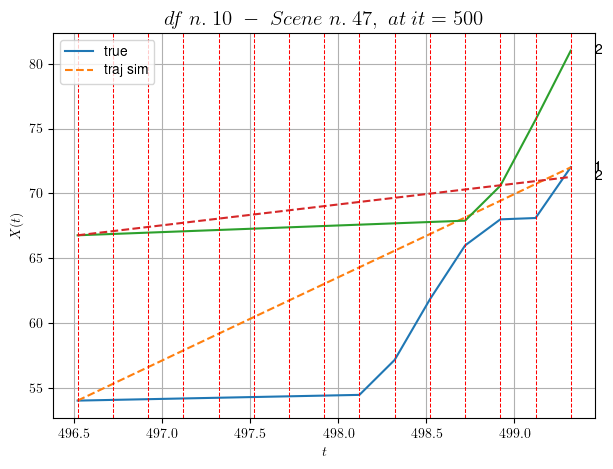

----------------------------------------------------------------------------------------------------
        For scene 22/49:
        * After LR finder: LR_NN=0.001 with mse=1070.8894563213507 at it=24
        * v0 = 1.6060119985537928
        * MSE = 18.197408811793327
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [342.92,343.32]


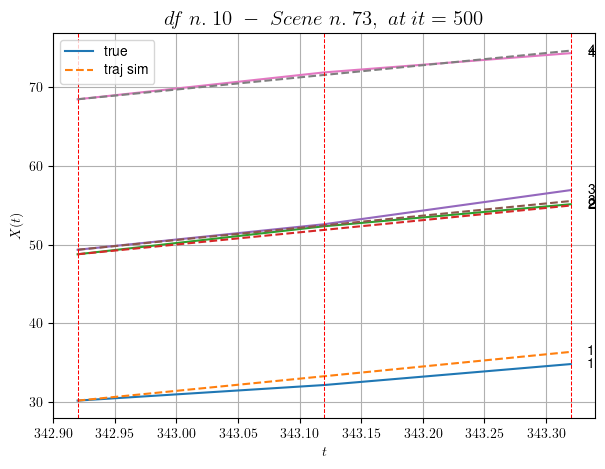

----------------------------------------------------------------------------------------------------
        For scene 23/49:
        * After LR finder: LR_NN=0.0005 with mse=7.301296583815743 at it=24
        * v0 = 15.471537794287507
        * MSE = 0.5048780024985404
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [139.92,140.32]


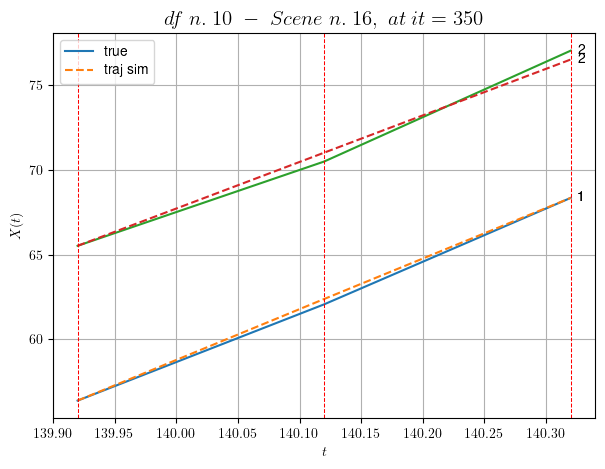

----------------------------------------------------------------------------------------------------
        For scene 24/49:
        * After LR finder: LR_NN=0.001 with mse=4.867044440447738 at it=24
        * v0 = 27.422660991971203
        * MSE = 0.09839871149483055
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [282.72,283.52]


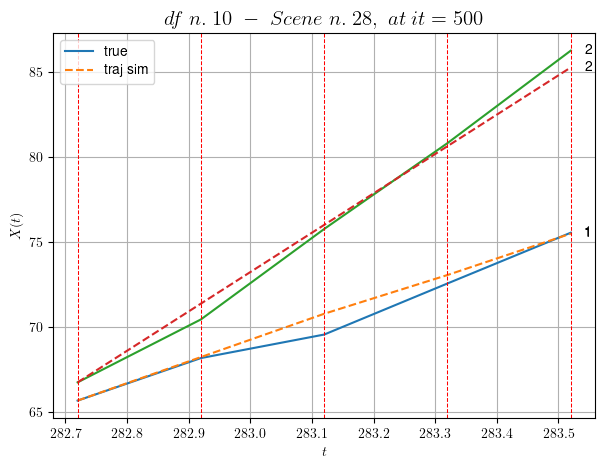

----------------------------------------------------------------------------------------------------
        For scene 25/49:
        * After LR finder: LR_NN=0.01 with mse=5.038169730946725 at it=24
        * v0 = 23.180355370996622
        * MSE = 0.3622617574175823
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [438.12,438.52]


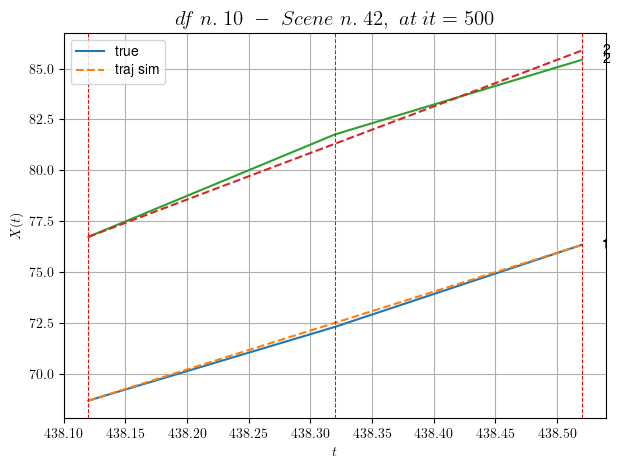

----------------------------------------------------------------------------------------------------
        For scene 26/49:
        * After LR finder: LR_NN=0.0001 with mse=1.986732917163351 at it=24
        * v0 = 22.869527063595935
        * MSE = 0.07499592912863368
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [279.52,279.92]


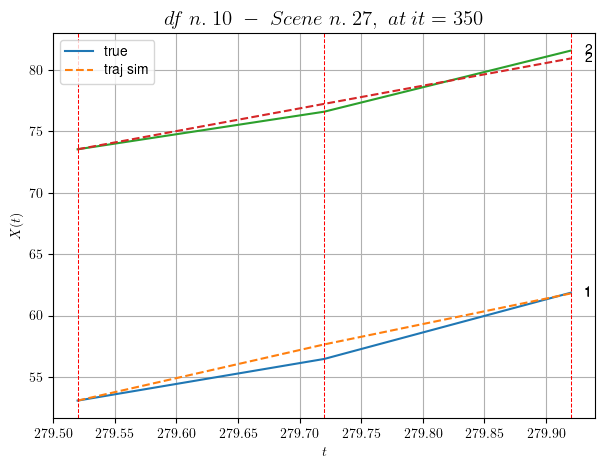

----------------------------------------------------------------------------------------------------
        For scene 27/49:
        * After LR finder: LR_NN=0.005 with mse=4.320272832824993 at it=24
        * v0 = 18.485445285464657
        * MSE = 0.36718754986801216
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.32,542.52]


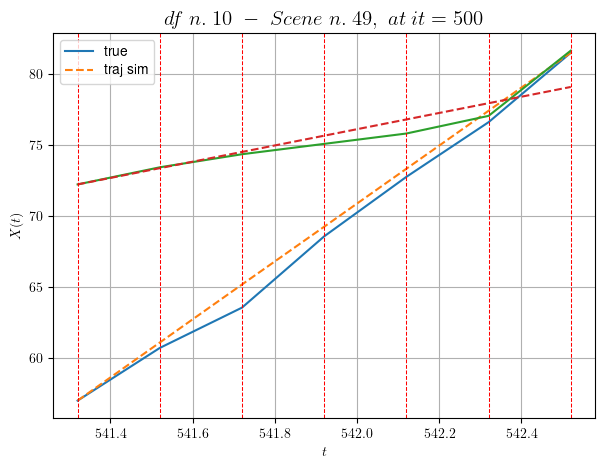

----------------------------------------------------------------------------------------------------
        For scene 28/49:
        * After LR finder: LR_NN=0.0005 with mse=150.58857402576837 at it=24
        * v0 = 5.721147250846573
        * MSE = 0.9087196653639438
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [264.12,264.92]


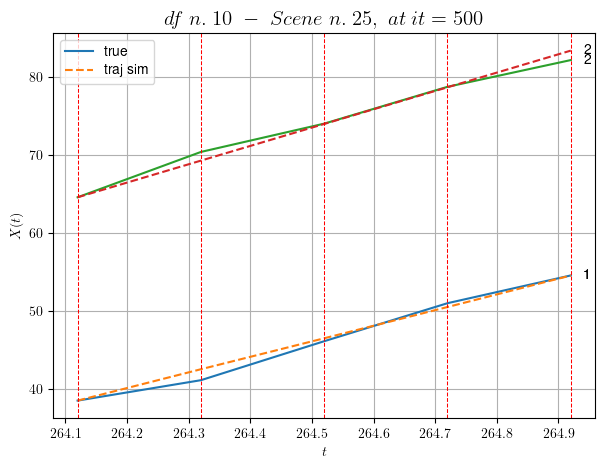

----------------------------------------------------------------------------------------------------
        For scene 29/49:
        * After LR finder: LR_NN=0.001 with mse=6.597468710433446 at it=24
        * v0 = 23.452291910892892
        * MSE = 0.5039298584444059
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [321.12,321.92]


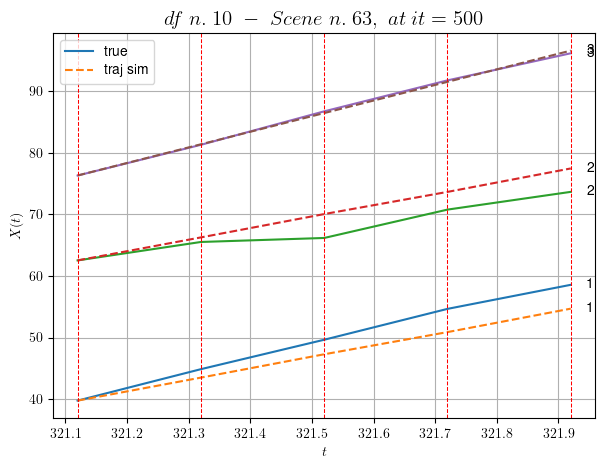

----------------------------------------------------------------------------------------------------
        For scene 30/49:
        * After LR finder: LR_NN=0.005 with mse=6.869639896995032 at it=24
        * v0 = 25.32842863555317
        * MSE = 5.011849174977969
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [370.92,372.12]


In [ ]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [ ]:
get_stats(model_trained)

## Plot

### Leading velocity $v_{0}$

In [ ]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [ ]:
Nx = 10
Nt = 100
T = 0.5

In [ ]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

In [ ]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [ ]:
y_pred

In [ ]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [ ]:
Nx = 100
Nt = 100
T = 0.5

In [ ]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

In [ ]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [ ]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [ ]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension